# MultiOmics RNA + ATAC for Chao dataset (MORNAATACC) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACC_3 notebook**

<hr>

Related paper : [Mimitou et al. (2020)](https://www.biorxiv.org/content/10.1101/2020.09.08.286914v1)

This notebook starts after reads alignment made by cellranger-arc2 for multiomics data.

Samples have been aggregate using cellranger-arcs aggregate without read normalization

Data used in this notebook :

In [ ]:
#/Castelo_Branco/NGSDATA/EAE_multiomics_EAMM_250521/Processed_data/ARC2
#/Castelo_Branco/NGSDATA/EAE_late_multiomics_CZ_030721/Processed_data
#only the filtered_feature_bc_matrix repositories, atac_fragments.tsv.gz and atac_fragments.tsv.gz.tbi

#/Castelo_Branco/NGSDATA/Datasets_from_literature

#Memory needed for a full run : 120Gb

In [17]:
#Early1          = P21208_1003_EAE_ARC
#PeakCtrl2       = P21208_1004_EAE_ARC
#Peak2           = P21208_1005_EAE_ARC
#LateCtrl1       = MORNAATACC_1002 (P21520_1002)
#Late1           = MORNAATACC_1003 (P21520_1003)
#Early2          = P23605_1001
#EarlyCtrl2      = P23605_1002
#Peak3           = P23605_1003
#PeakCtrl3       = P23605_1004
#EarlyCtrl3      = P24115_1001
#EarlyFemale3    = P24115_1002
#EarlyMale3      = P24115_1003
#Late2           = P25316_1001
#LateCtrl2       = P25316_1002
#Late3           = P25316_1003
#LateCtrl3       = P25316_1004
#PeakMale4        = P27208_1001
#PeakFemale4      = P27208_1002
#LateMale4        = P27208_1003
#LateFemale4      = P27208_1004
#Naive1           = P26203_1003
#Naive2           = P26203_1004

## 0. Environment status

In [1]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [2]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [3]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              16
On-line CPU(s) list: 0-15
Thread(s) per core:  1
Core(s) per socket:  8
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               63
Model name:          Intel(R) Xeon(R) CPU E5-2630 v3 @ 2.40GHz
Stepping:            2
CPU MHz:             1206.591
CPU max MHz:         3200.0000
CPU min MHz:         1200.0000
BogoMIPS:            4799.57
Virtualization:      VT-x
L1d cache:           512 KiB
L1i cache:           512 KiB
L2 cache:            4 MiB
L3 cache:            40 MiB
NUMA node0 CPU(s):   0-7
NUMA node1 CPU(s):   8-15
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_tsc

In [4]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

257675


In [5]:
apt list --installed

Listing... Done
adduser/focal,now 3.118ubuntu2 all [installed]
apt-transport-https/focal-security,now 2.0.2ubuntu0.2 all [installed]
apt/focal-security,now 2.0.2ubuntu0.2 amd64 [installed]
autoconf/focal,now 2.69-11.1 all [installed,automatic]
automake/focal,now 1:1.16.1-4ubuntu6 all [installed,automatic]
autotools-dev/focal,now 20180224.1 all [installed,automatic]
base-files/focal,now 11ubuntu5 amd64 [installed]
base-passwd/focal,now 3.5.47 amd64 [installed]
bash/focal,now 5.0-6ubuntu1 amd64 [installed,upgradable to: 5.0-6ubuntu1.2]
binutils-common/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
binutils-x86-64-linux-gnu/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
binutils/focal-security,now 2.34-6ubuntu1.3 amd64 [installed,automatic]
bsdutils/focal,now 1:2.34-0.1ubuntu9 amd64 [installed,upgradable to: 1:2.34-0.1ubuntu9.3]
build-essential/focal,now 12.8ubuntu1 amd64 [installed]
bzip2/focal,now 1.0.8-2 amd64 [installed,automatic]
ca-certificates-java/f

In [7]:
pip list

Package              Version             
-------------------- --------------------
anndata              0.8.0               
ansiwrap             0.8.4               
anyio                3.6.1               
argon2-cffi          21.3.0              
argon2-cffi-bindings 21.2.0              
asttokens            2.0.5               
attrs                21.4.0              
Babel                2.10.3              
backcall             0.2.0               
bash-kernel          0.7.2               
beautifulsoup4       4.11.1              
bleach               5.0.1               
calysto-bash         0.2.2               
certifi              2019.11.28          
cffi                 1.15.1              
chardet              3.0.4               
click                8.1.3               
cycler               0.11.0              
Cython               0.29.26             
dbus-python          1.2.16              
debugpy              1.6.0               
decorator            5.1.1        

In [8]:
jupyter --version

Selected Jupyter core packages...
IPython          : 8.4.0
ipykernel        : 6.15.0
ipywidgets       : 7.7.1
jupyter_client   : 7.3.4
jupyter_core     : 4.10.0
jupyter_server   : 1.17.0
jupyterlab       : 3.1.17
nbclient         : 0.5.13
nbconvert        : 6.4.4
nbformat         : 5.4.0
notebook         : 6.4.12
qtconsole        : 5.3.1
traitlets        : 5.3.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(mlbench)
library(caret)
library(e1071)
library(ggplot2)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(patchwork)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(circlize)
library(scales)
library(lisi)
library(corrplot)

#Multicore
library(future)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

#Doublet determination
#Cannot be installed through conda
library(DoubletFinder)

library(textclean)
library(mclust)

#ArchR
library(ArchR)
library(TxDb.Mmusculus.UCSC.mm10.knownGene)

library(muscat)
library(SingleCellExperiment)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

Attaching SeuratObject

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: S4Vectors


Attaching package: ‘S4Vectors’


The following objects are masked from ‘package:base’:

    I, expand.grid, unname


Loading required package: IRanges

Loading required package: GenomeInfoDb

Loading requir

In [2]:
sessionInfo()

R version 4.2.3 (2023-03-15)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.9.0
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.9.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] EnhancedVolcano_1.16.0                   
 [2] DESeq2_1.38.3                            
 [3] Matrix.utils_0.9.8                       
 [4] limma_3.54.2                             
 [5] UpSetR_1.4.0                             
 [6] scater_1.26.1                            
 [7] scuttle_1.8.4                            
 [8] Sing

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, slot = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = slot == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = GetAssayData(object = object, slot = slot))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", slot,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", slot, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = GetAssayData(object = object, slot = slot)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#B0BFB0
#8FA38F
#6E876E
#536553
#374337

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

In [6]:
names_Naive <- c("Naive1", "Naive2")
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "Early2", "EarlyMale3", "EarlyFemale3")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4")

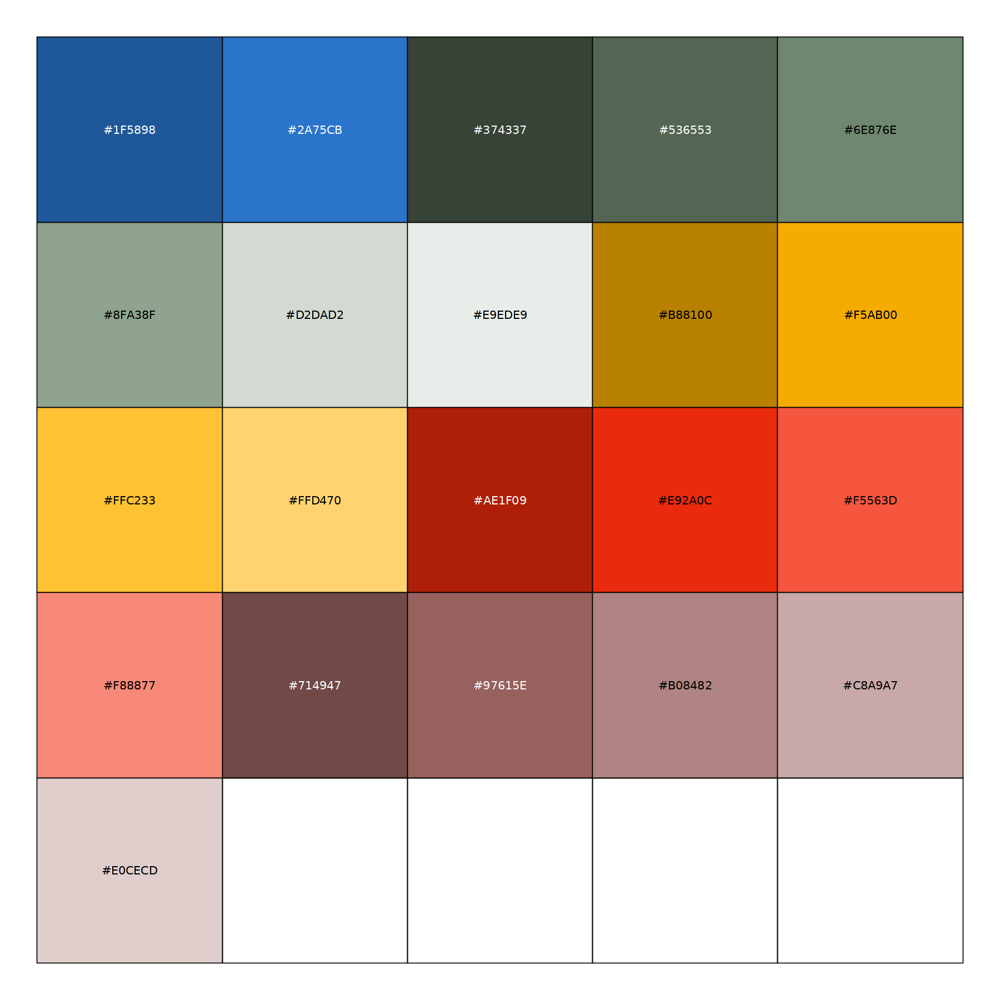

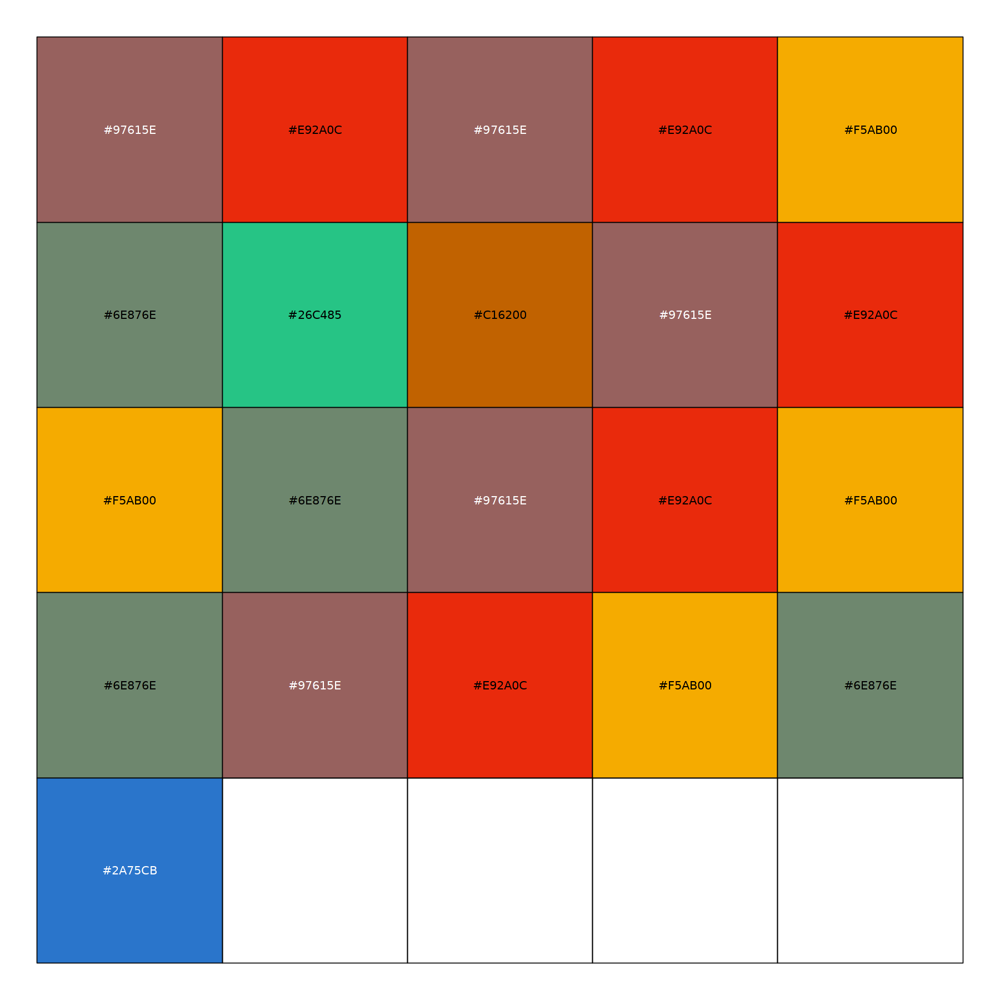

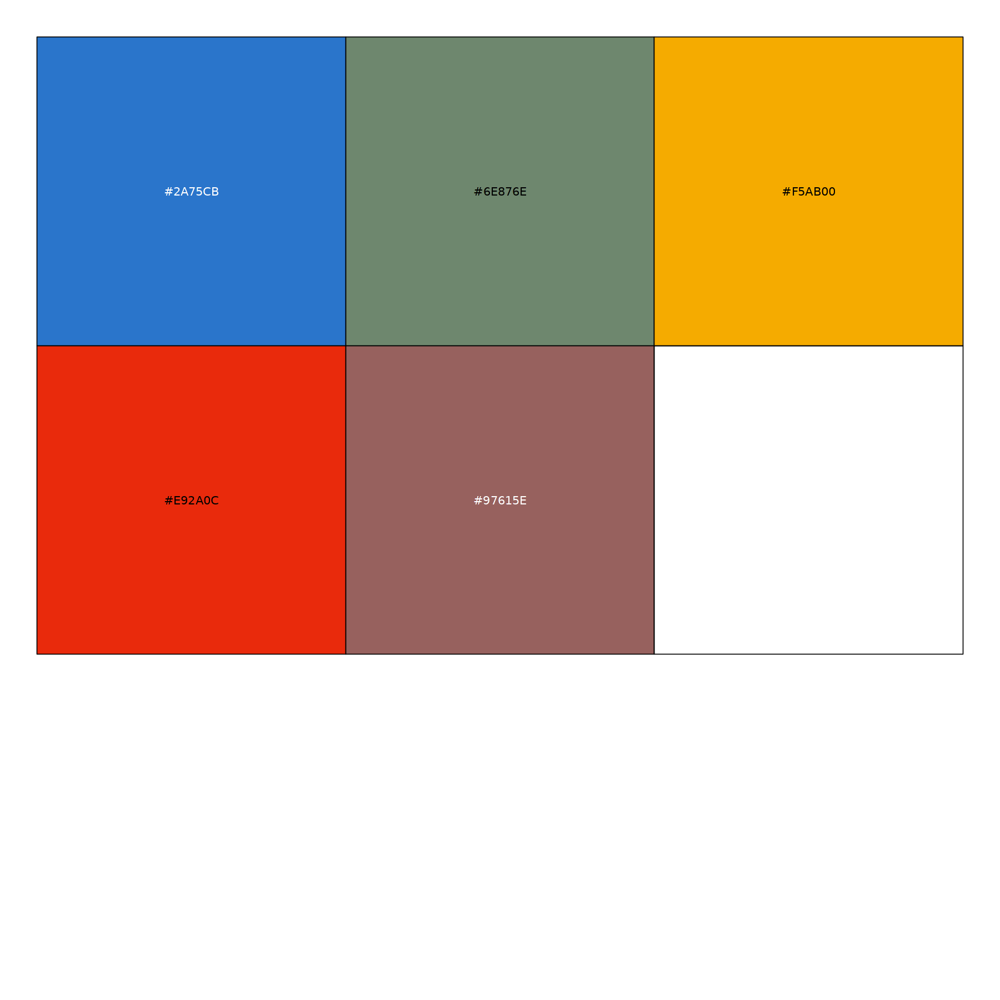

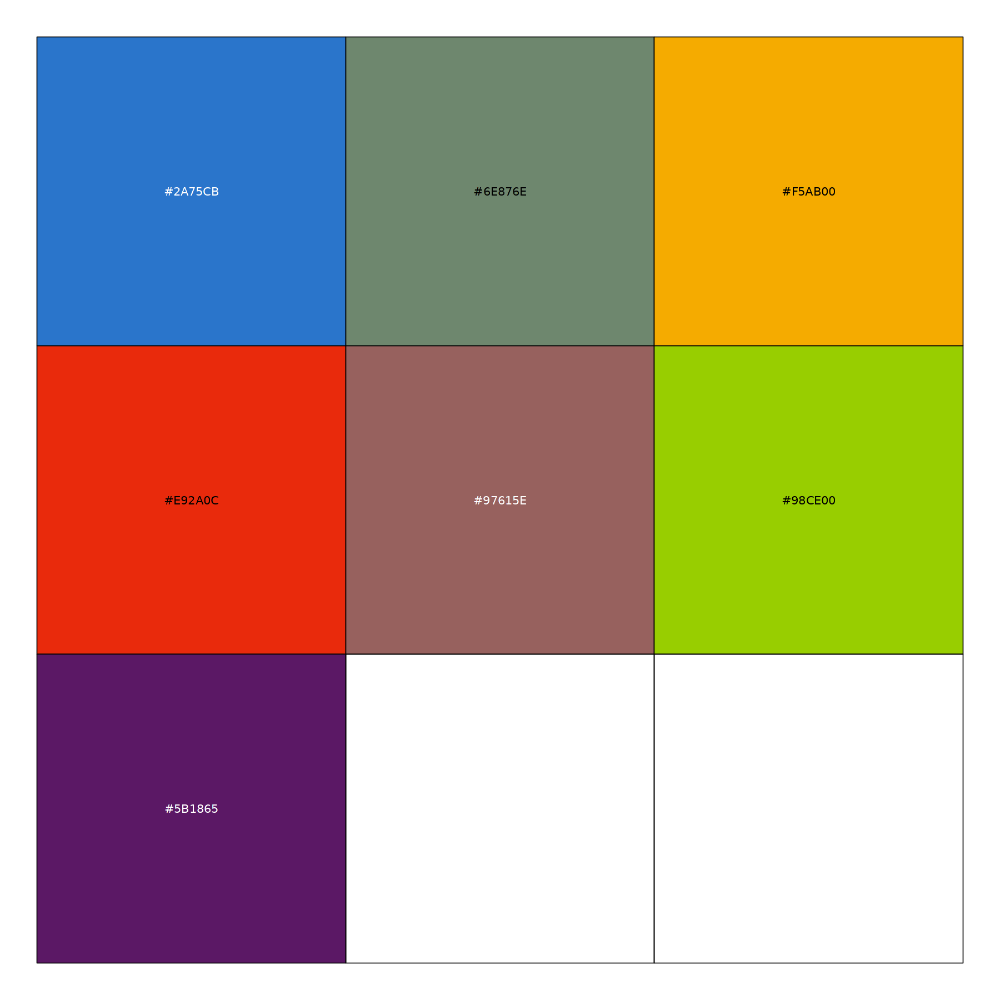

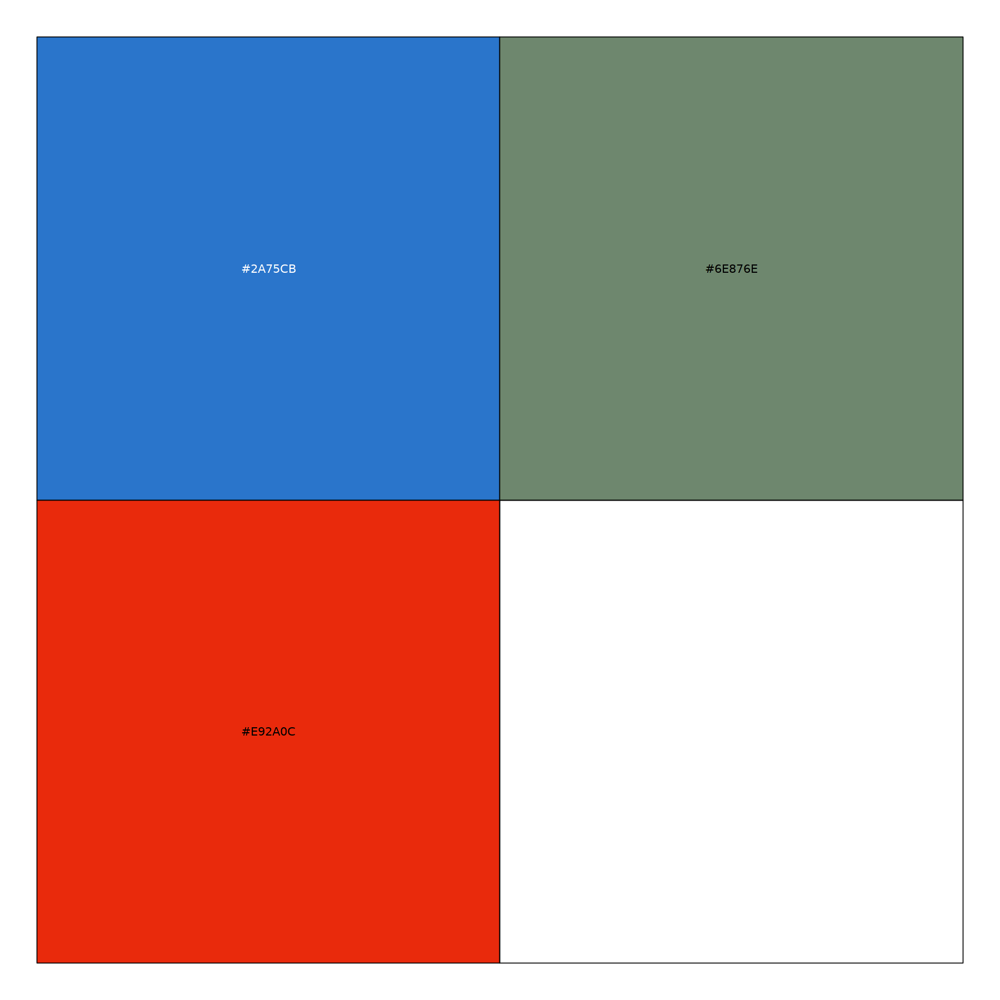

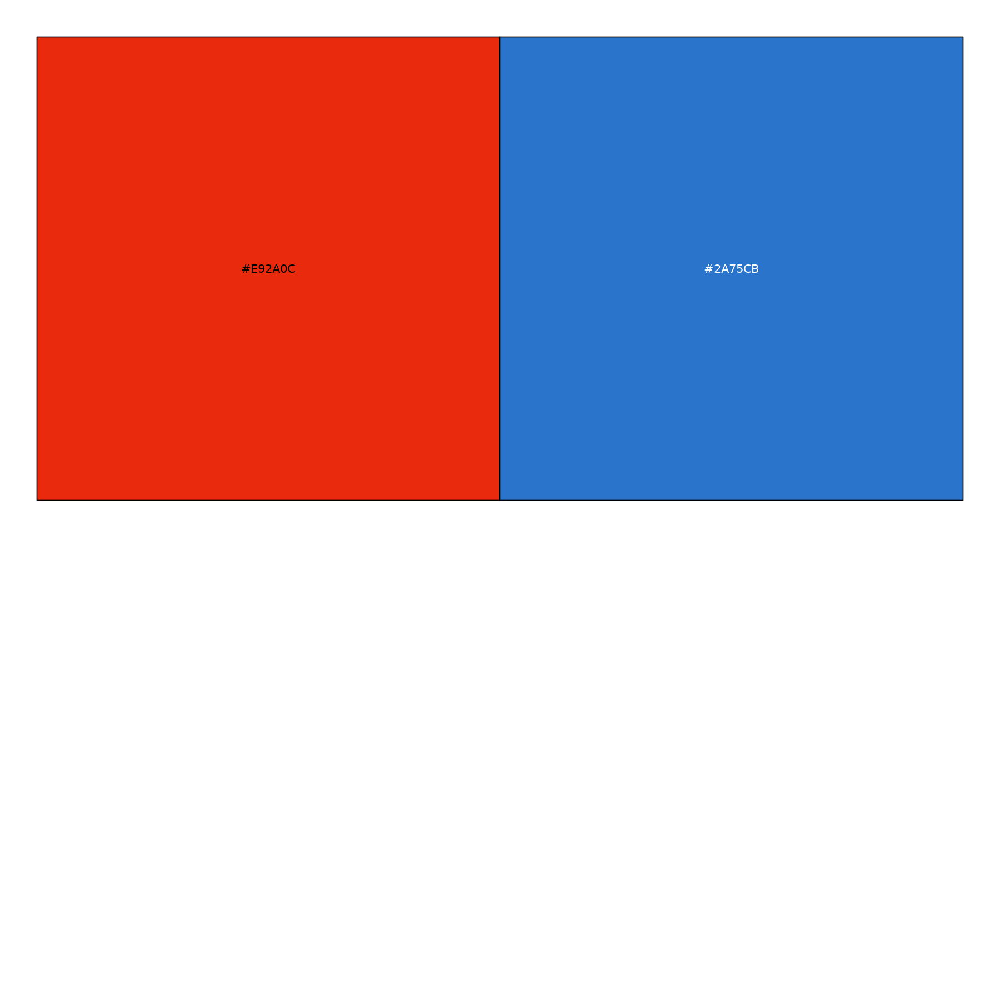

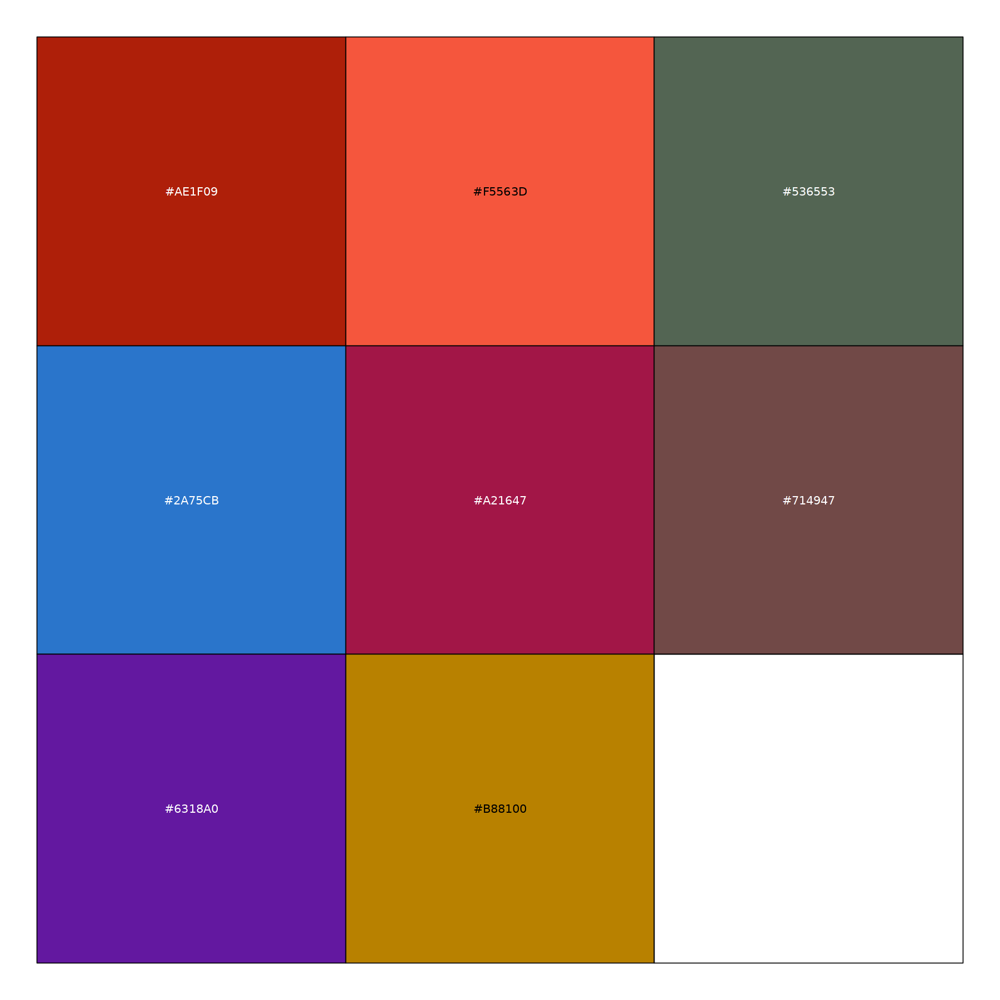

In [42]:
orig.ident_colors <- c("#1F5898", "#2A75CB", "#374337", "#536553", "#6E876E", "#8FA38F", "#D2DAD2", "#E9EDE9", "#B88100", "#F5AB00", "#FFC233", "#FFD470", "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD")
names(orig.ident_colors) <- c("Naive1", "Naive2", "EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3", "Early1", "Early2", "EarlyMale3", "EarlyFemale3", "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Late1", "Late2","Late3", "LateMale4", "LateFemale4")
show_col(orig.ident_colors)
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#2A75CB")
names(orig.ident_colors_contrast) <- c("Naive1", "Naive2", "EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3", "Early1", "Early2", "EarlyMale3", "EarlyFemale3", "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Late1", "Late2","Late3", "LateMale4", "LateFemale4")
show_col(orig.ident_colors_contrast)

orig.ident_merge_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Naive", "Ctrl", "Early", "Peak", "Late")
show_col(orig.ident_merge_colors)

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00", "#5B1865")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6", "B7")
show_col(batch_colors)

model_colors <- c("#2A75CB", "#6E876E", "#E92A0C")
names(model_colors) <- c("Naive", "Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#E92A0C", "#2A75CB")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("F", "M")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

immuneAll_colors <- c("lightgrey", "blue", "orange", "red")
names(immuneAll_colors) <- c("None", "RNA", "GenePromAcc", "Both")
#show_col(immuneAll_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

debris_colors <- duo_colors
names(debris_colors) <- c("Percoll", "Debris")

cellType_colors <- c("#AE1F09", "#F5563D", "#536553", "#2A75CB", "#A21647", "#714947", "#6318A0", "#B88100")
names(cellType_colors) <- c("OPC", "COP", "MOL", "Astro", "Epen", "Micro", "Neuron", "Peric")
show_col(cellType_colors)

In [8]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [9]:
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC.rds"))

In [10]:
MORNAATACC@meta.data <- readRDS(paste0(OS_path_outputs, "MORNAATACC_annot_CHAO.rds"))

## 3. Gender analysis

### 3.1 Gender plots

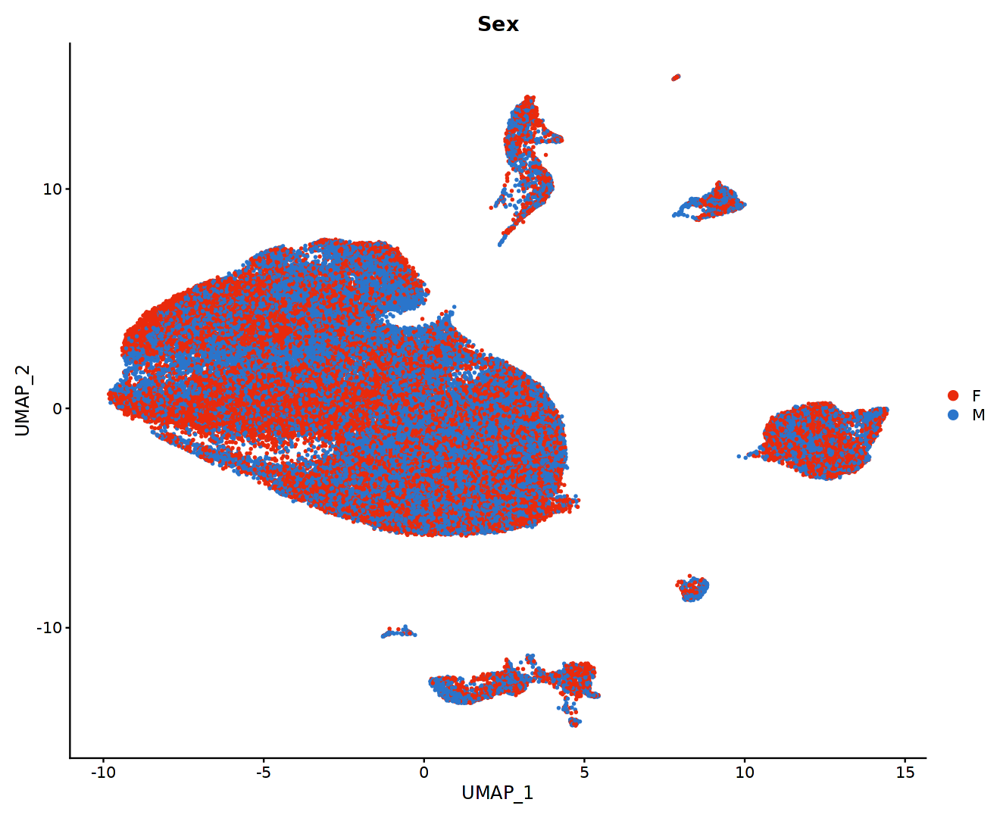

In [11]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Sex", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE)

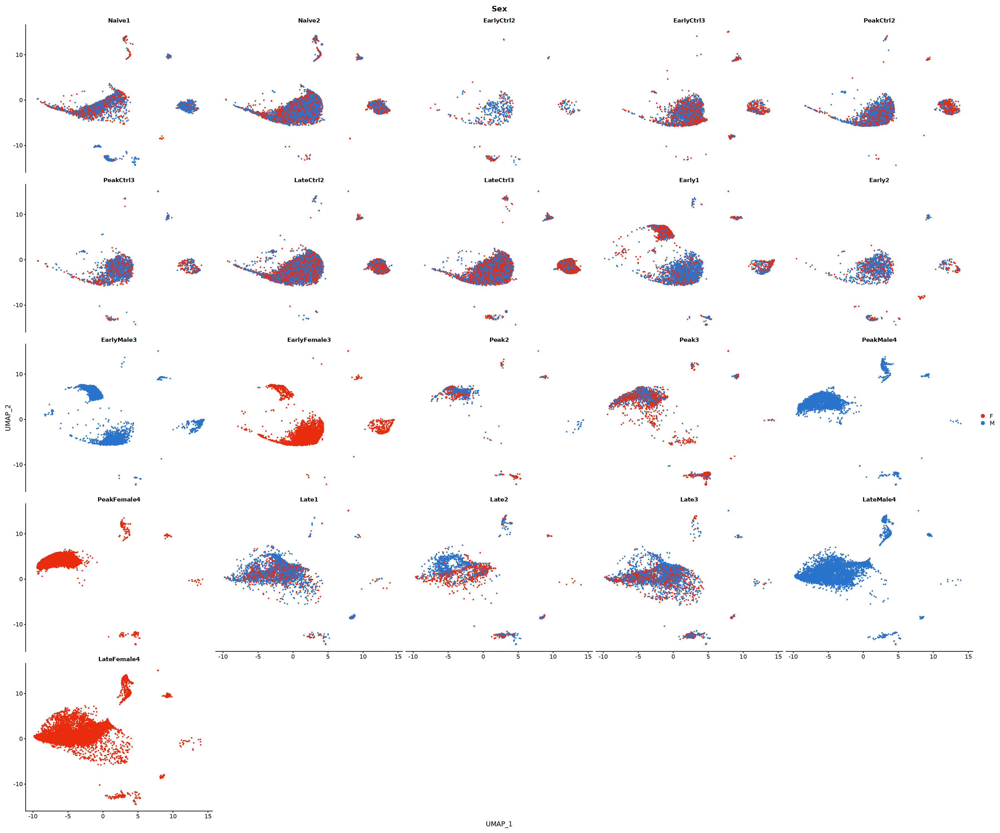

In [12]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Sex", split.by="orig.ident", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols=sex_colors, ncol=5, pt.size=0.5, label=FALSE)

In [13]:
t <- table(Cluster=MORNAATACC$seurat_clusters_RNA, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

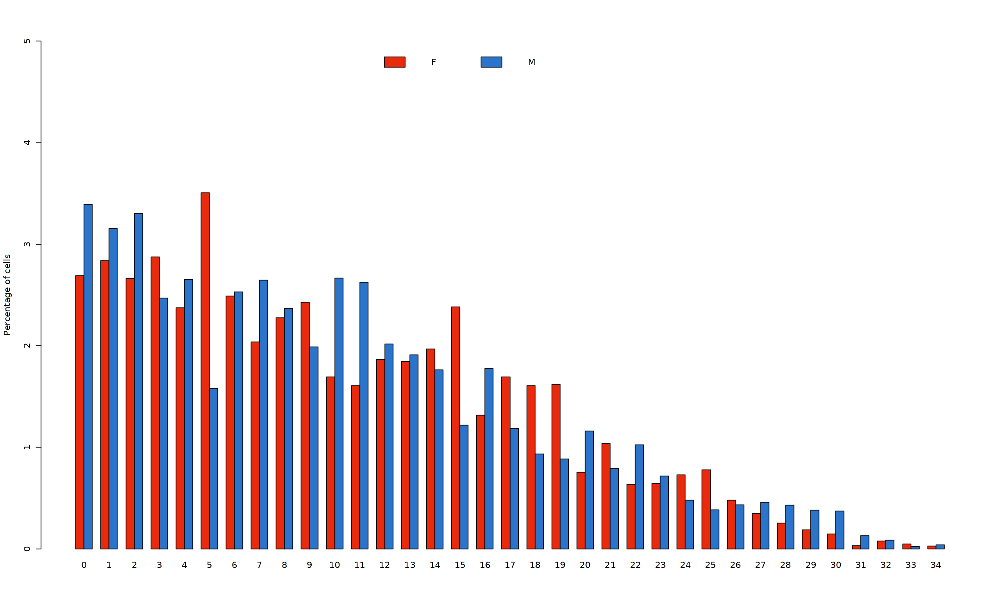

In [14]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent)))-1, 1, f = ceiling)), col = sex_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

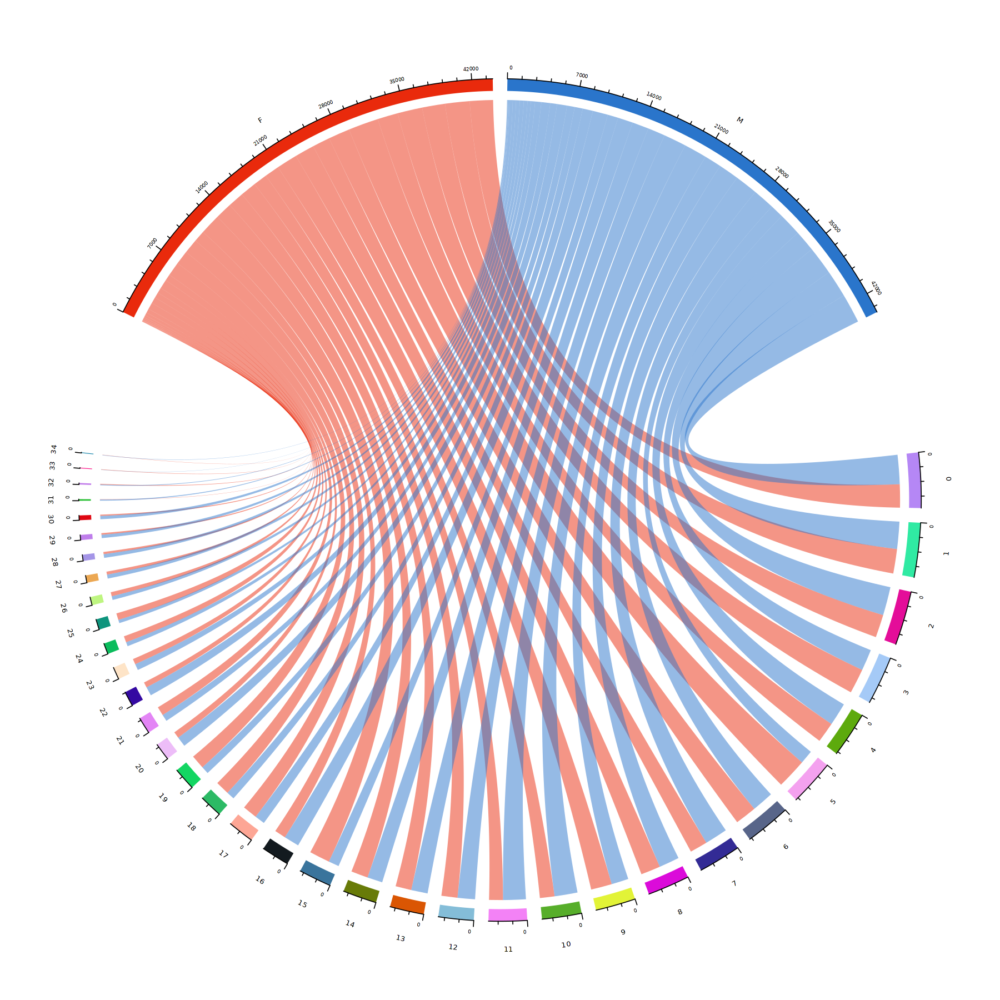

In [15]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$seurat_clusters_RNA))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=rev(sex_colors))

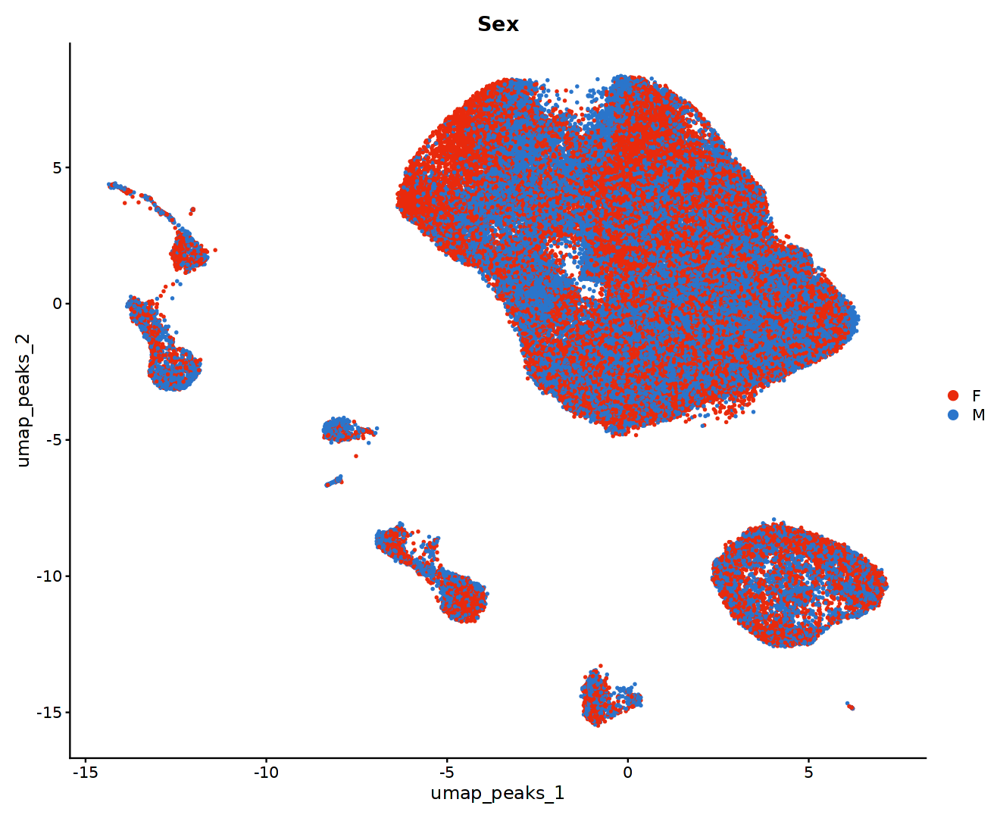

In [16]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Sex", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE)

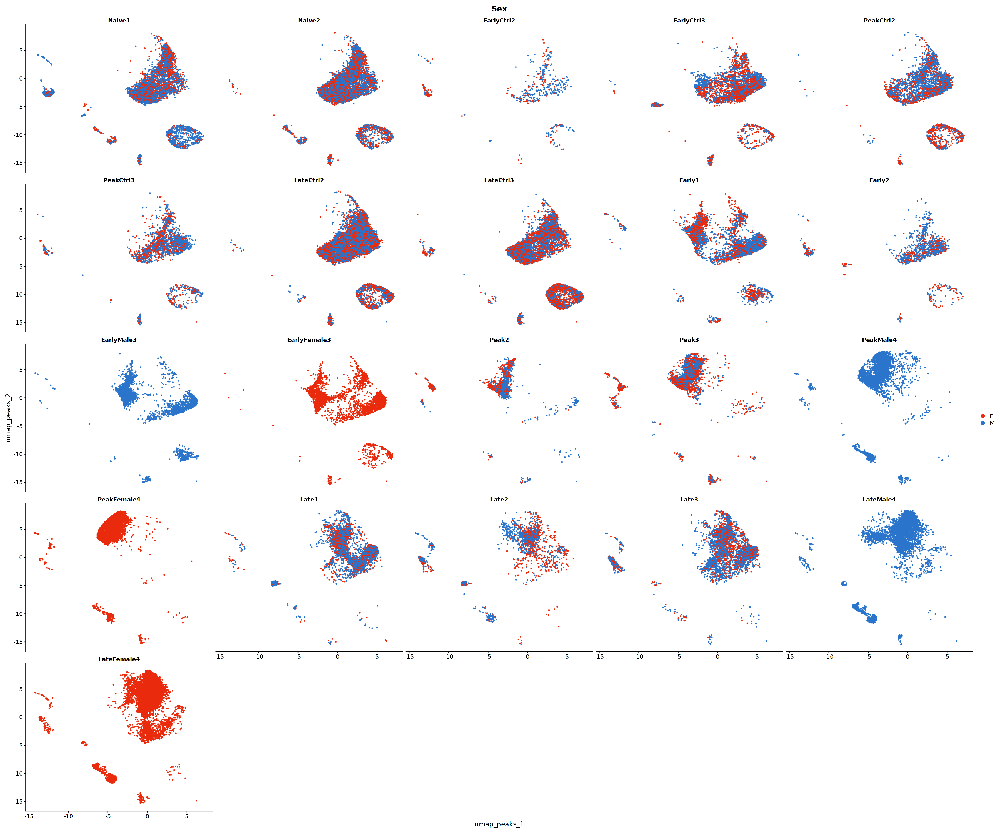

In [17]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Sex", split.by="orig.ident", reduction="umap_peaks", shuffle=TRUE, seed=seed, cols=sex_colors, ncol=5, pt.size=0.5, label=FALSE)

In [18]:
t <- table(Cluster=MORNAATACC$seurat_clusters_peaks, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

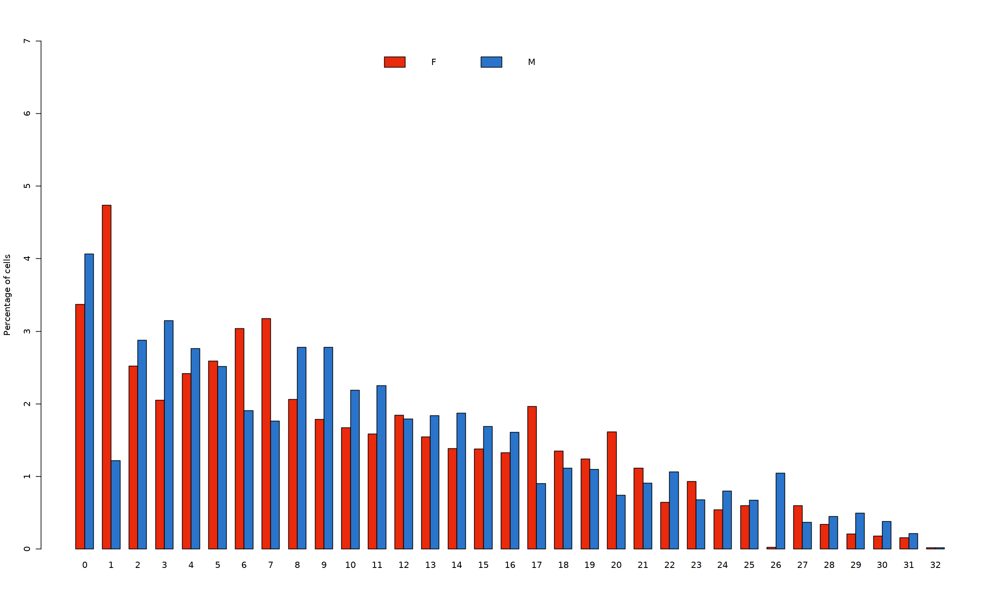

In [19]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = sex_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

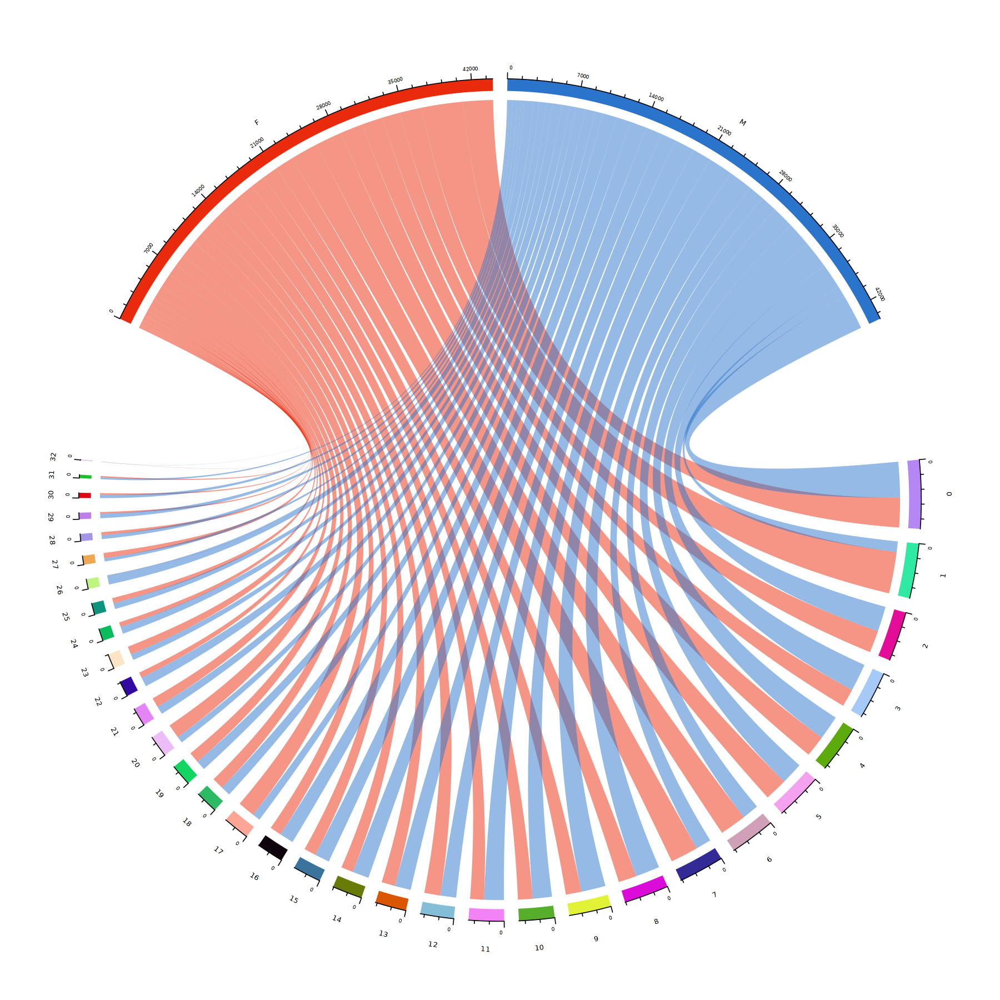

In [20]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$seurat_clusters_peaks))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=rev(sex_colors))

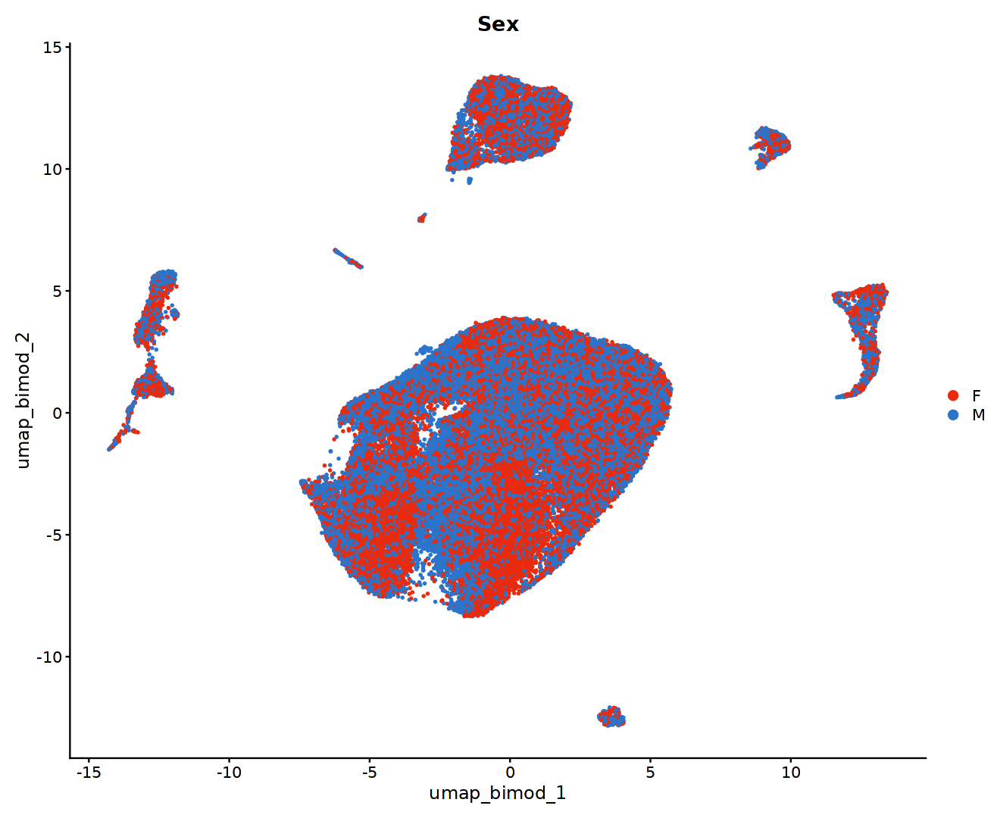

In [21]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC, group.by="Sex", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


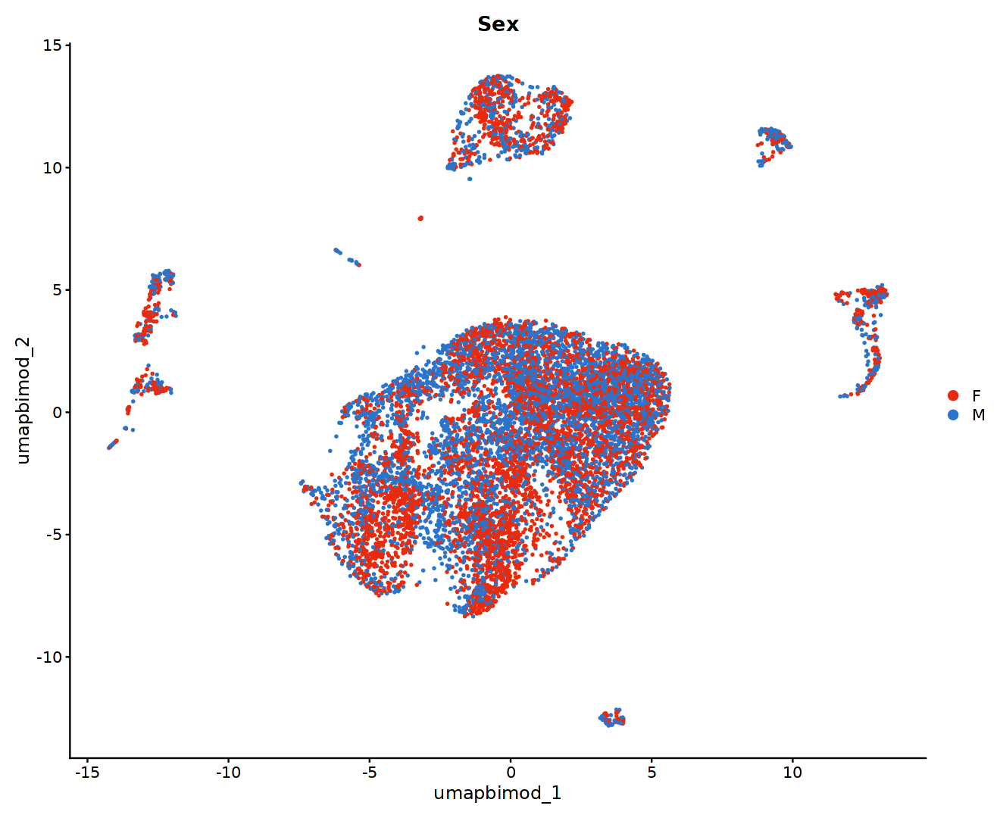

In [22]:
#Each timepoint has the same number of cells
options(repr.plot.width=11, repr.plot.height=9)
Idents(MORNAATACC) <- "Sex"
DimPlot(subset(MORNAATACC, downsample = 5000), group.by="Sex", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=sex_colors, pt.size=0.5, label=FALSE)

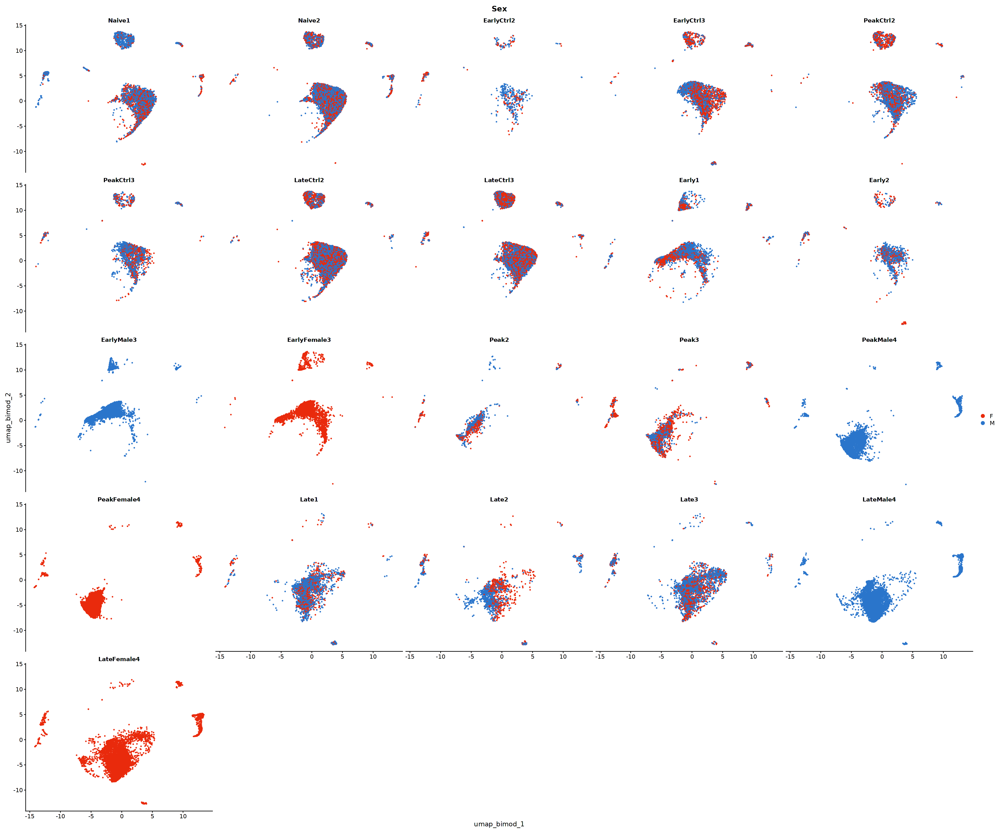

In [23]:
options(repr.plot.width=30, repr.plot.height=25)
DimPlot(MORNAATACC, group.by="Sex", split.by="orig.ident", reduction="umap_BiMod", shuffle=TRUE, seed=seed, cols=sex_colors, ncol=5, pt.size=0.5, label=FALSE)

In [24]:
t <- table(Cluster=MORNAATACC$seurat_clusters_BiMod, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

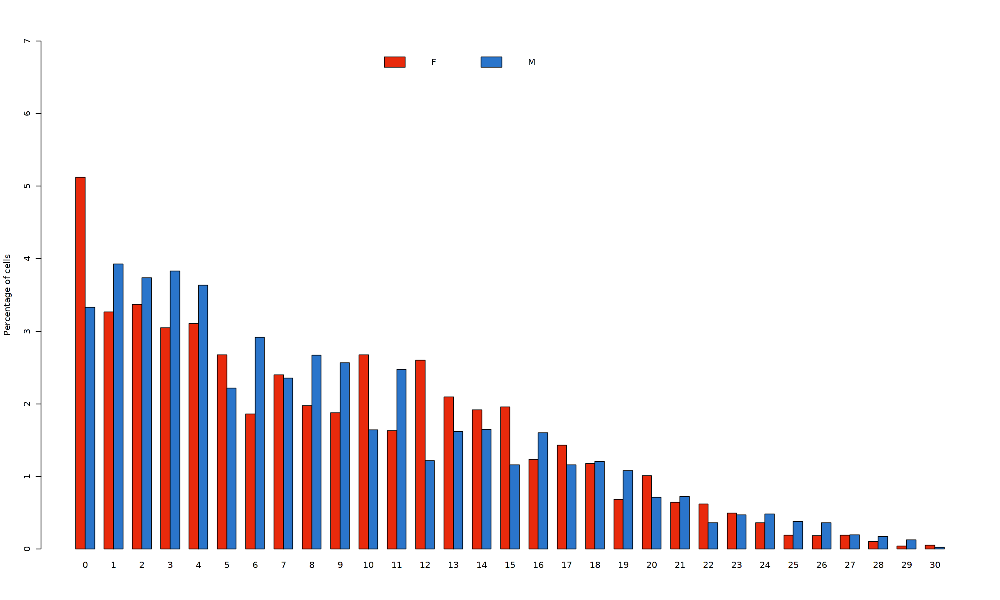

In [25]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent)))-1, 1, f = ceiling)), col = sex_colors, args.legend = list(bty = "n", x = "top", ncol = 3))

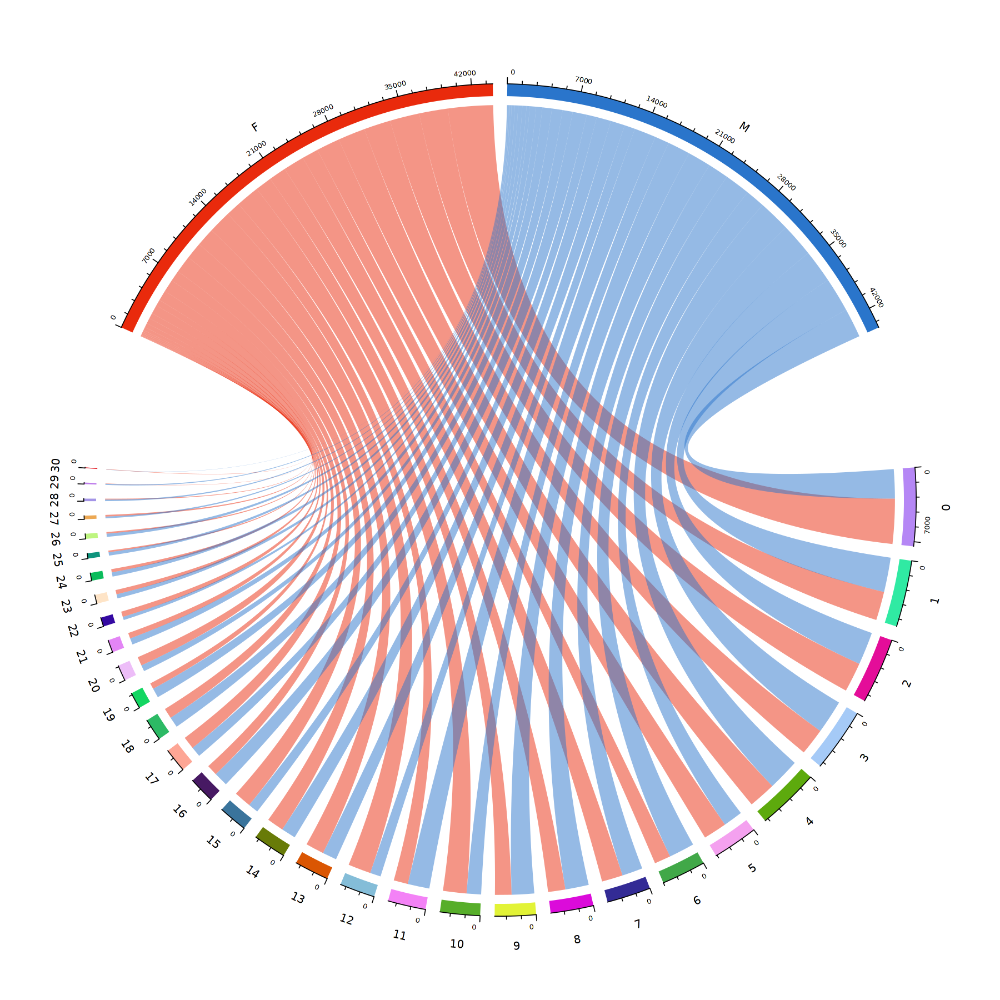

In [26]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$seurat_clusters_BiMod))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 1.2)
chordDiagram(mat, big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=rev(sex_colors))

In [27]:
t <- table(Cluster=MORNAATACC$cellType, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

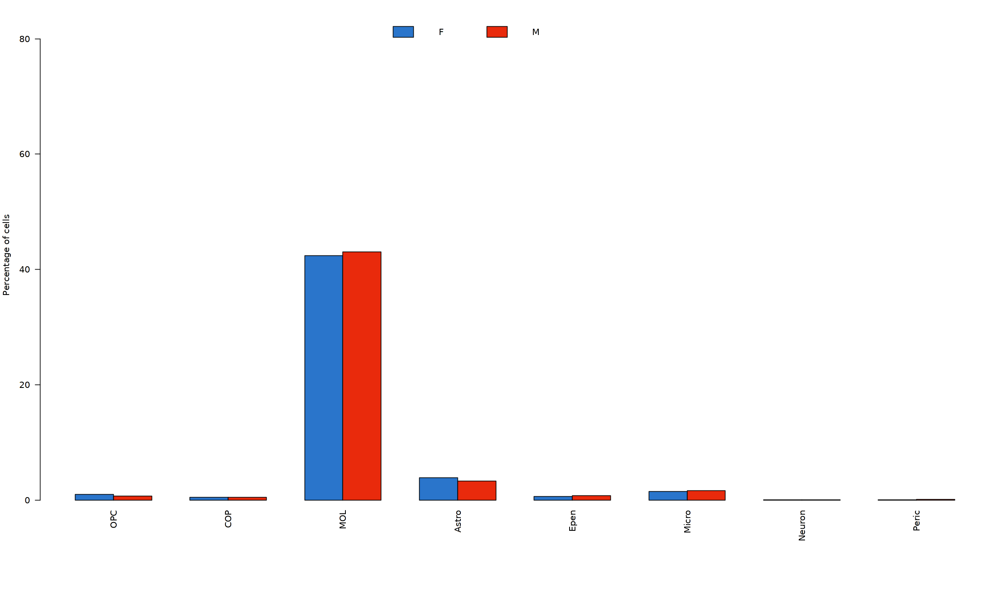

In [28]:
options(repr.plot.width=20, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

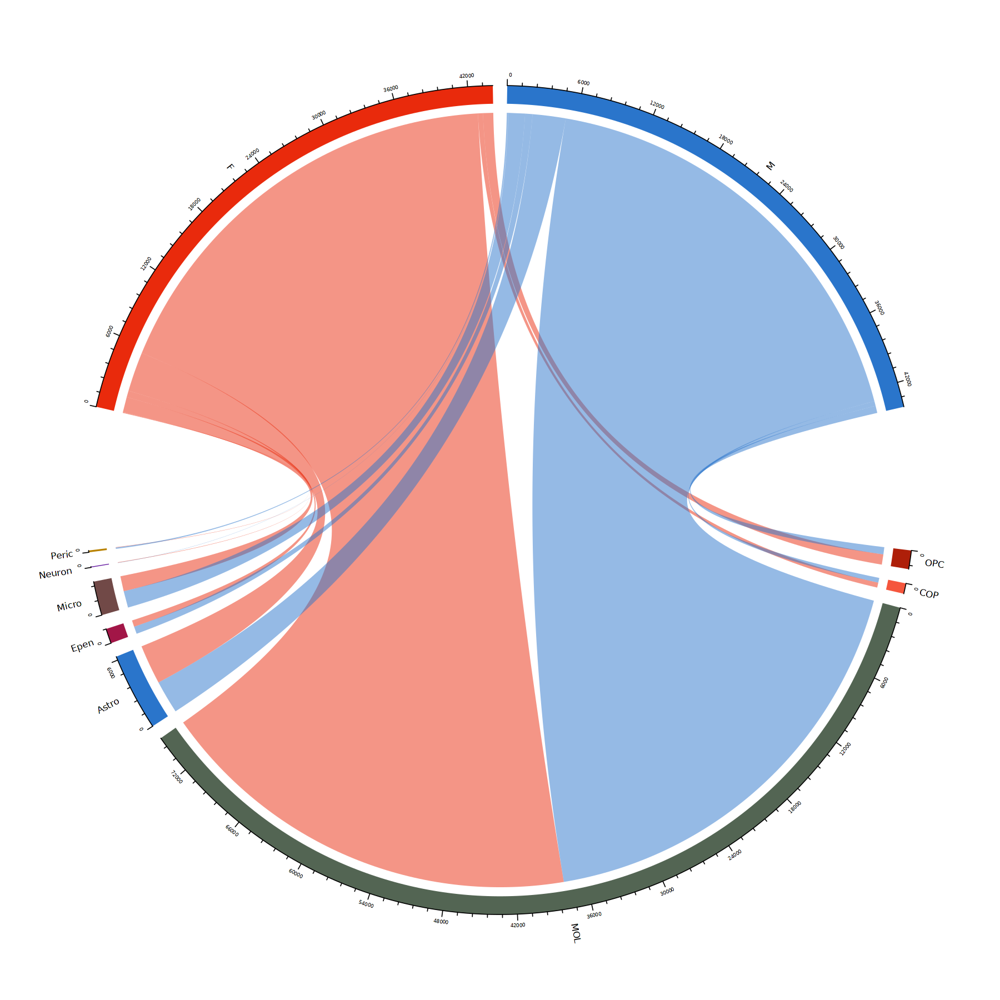

In [43]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$cellType))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(cellType_colors), names(sex_colors)), grid.col=c(rev(sex_colors),cellType_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [44]:
t <- table(Cluster=MORNAATACC$orig.ident, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

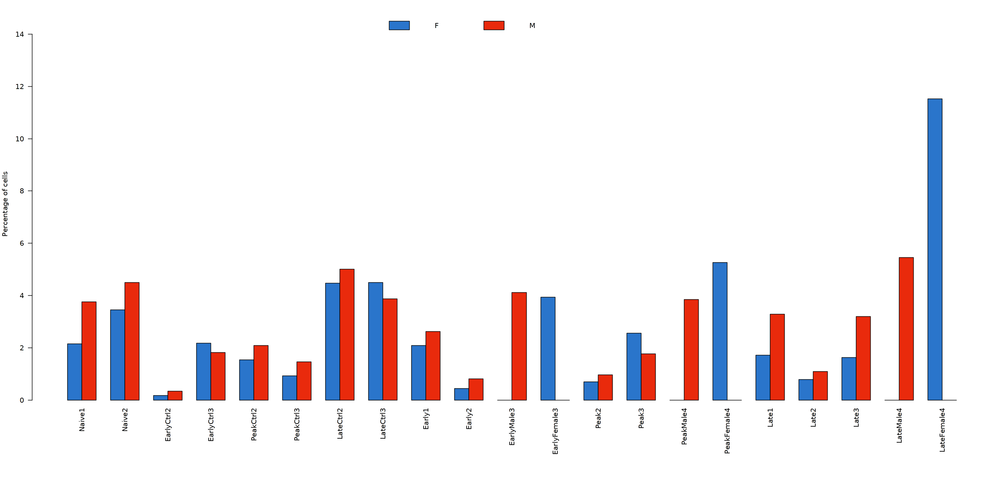

In [45]:
options(repr.plot.width=25, repr.plot.height=12)
par(mar=c(10,4,1,1))
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 5, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3), las=2)

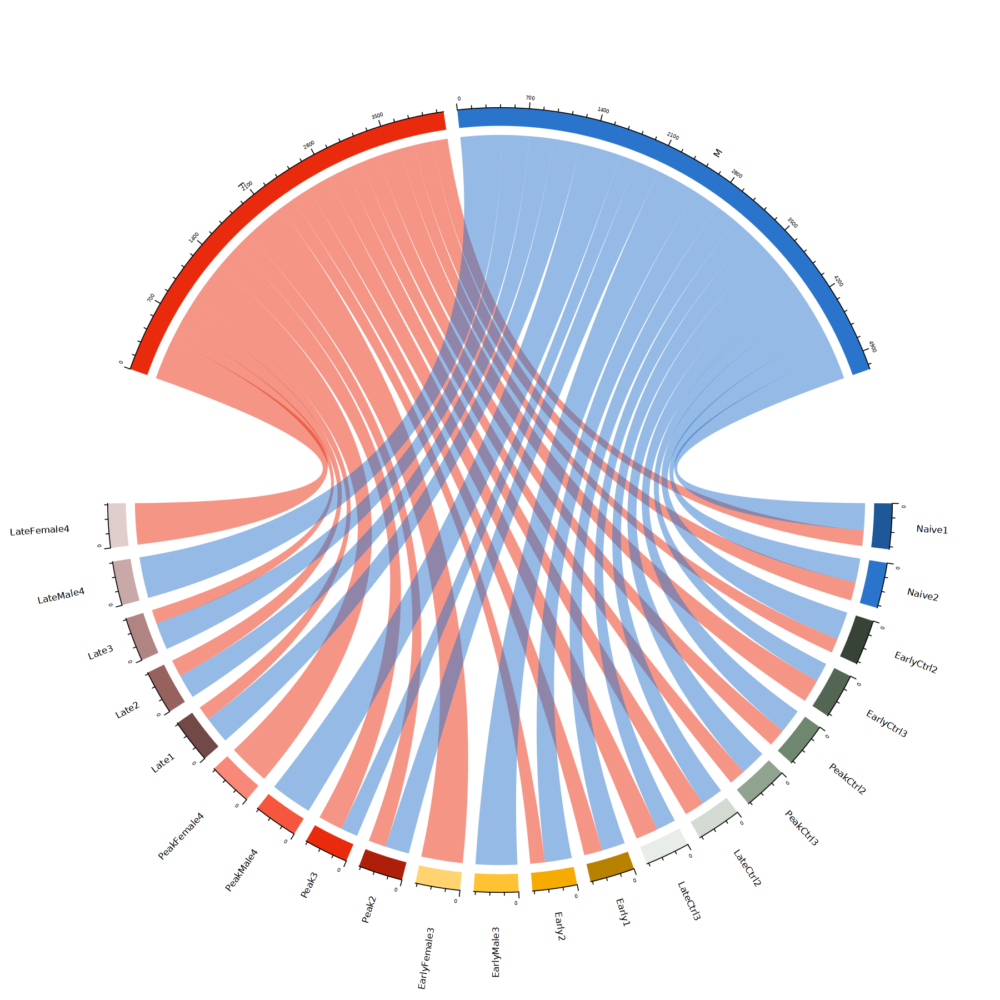

In [46]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$orig.ident))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_colors), names(sex_colors)), grid.col=c(rev(sex_colors),orig.ident_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.5, 0.5))}, bg.border = NA)

In [47]:
t <- table(Cluster=MORNAATACC$orig.ident_merge, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

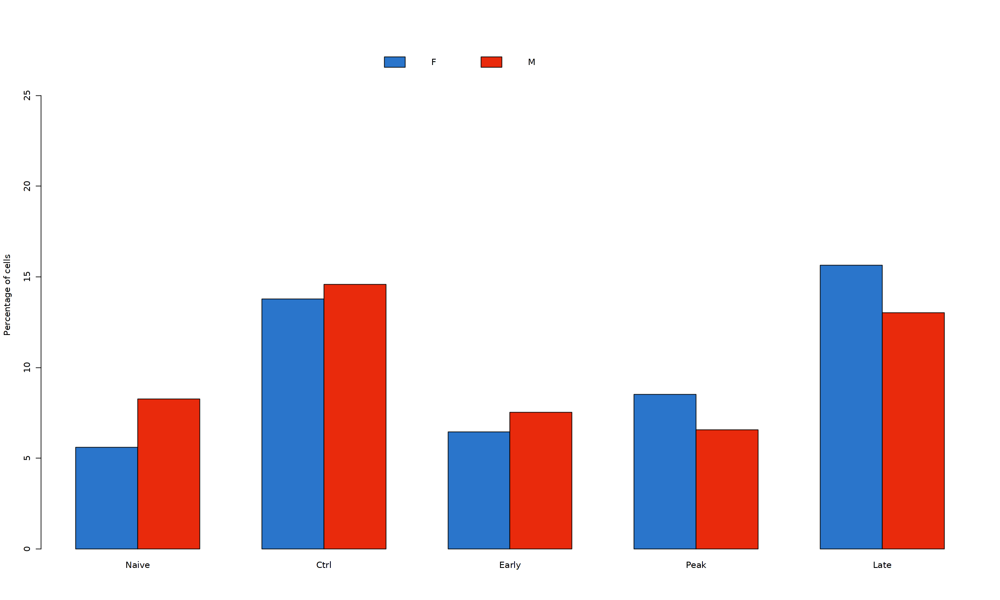

In [48]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

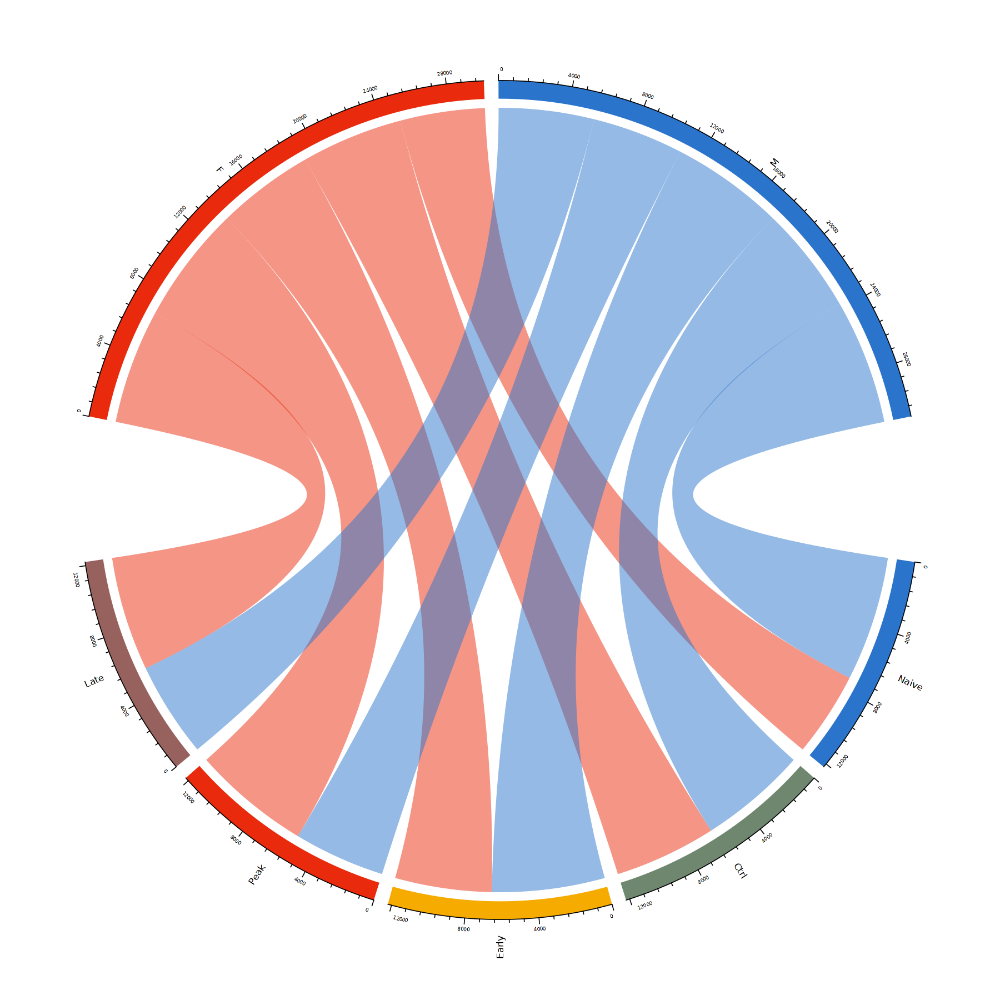

In [49]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$orig.ident_merge))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(orig.ident_merge_colors), names(sex_colors)), grid.col=c(rev(sex_colors),orig.ident_merge_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [50]:
t <- table(Cluster=MORNAATACC$model, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

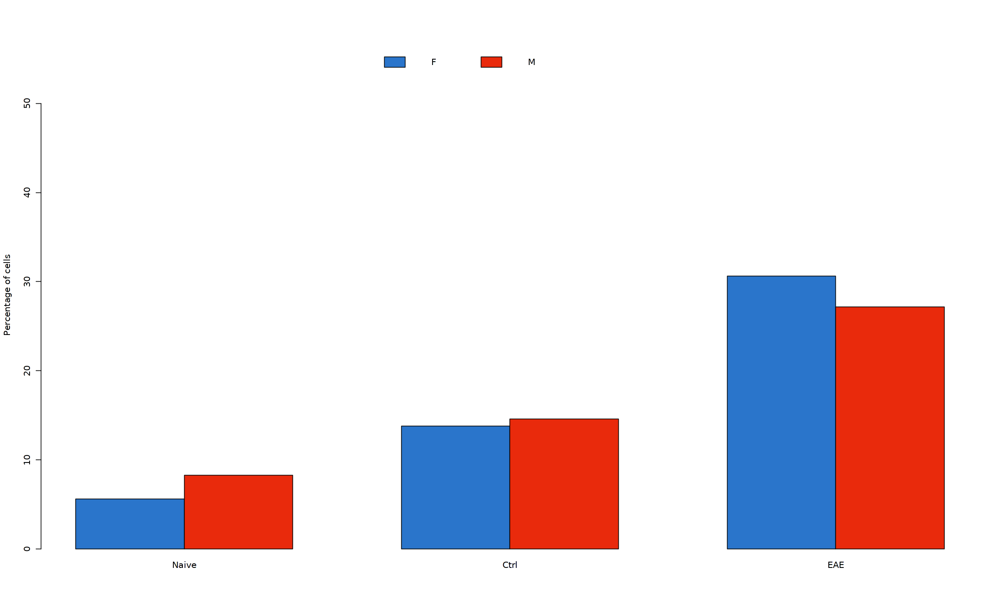

In [51]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

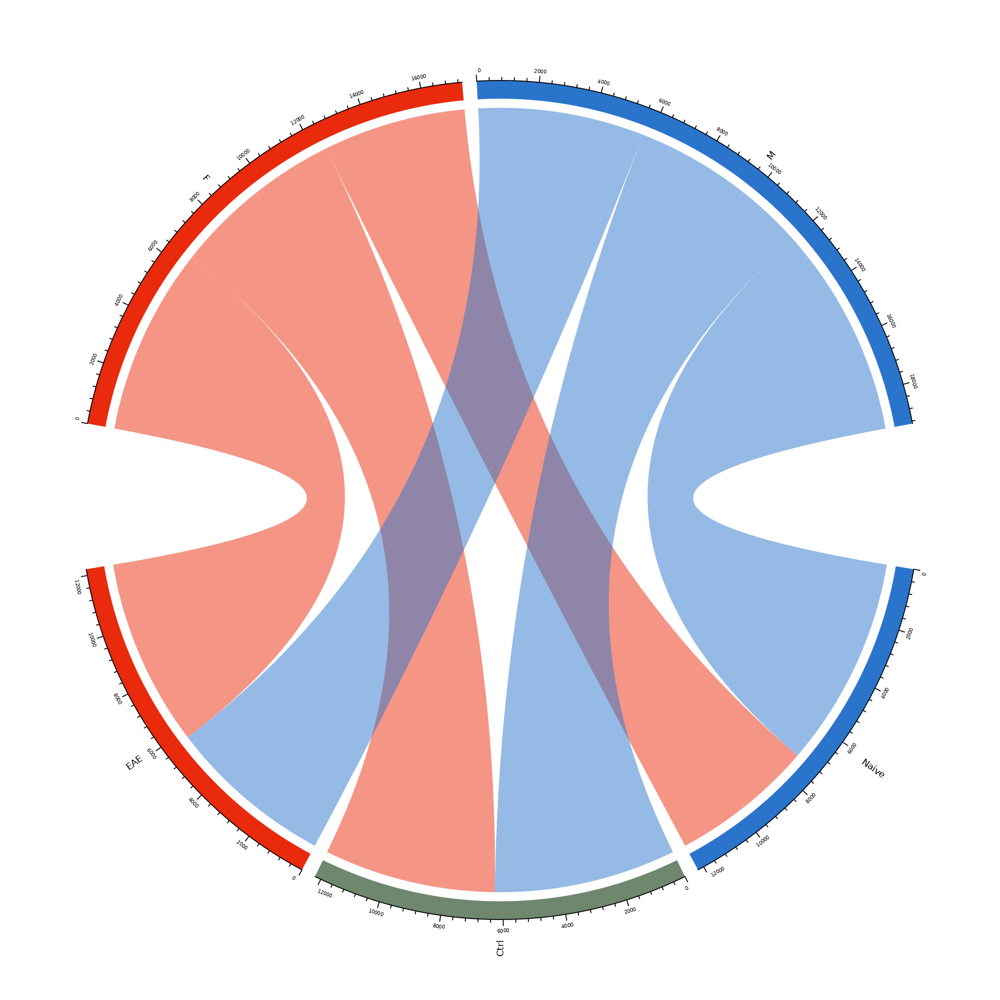

In [52]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$model))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
for (col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(model_colors), names(sex_colors)), grid.col=c(rev(sex_colors),model_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

In [53]:
t <- table(Cluster=MORNAATACC$Immune, Batch=MORNAATACC@meta.data[["Sex"]])
t <- t[,names(sex_colors)]
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)

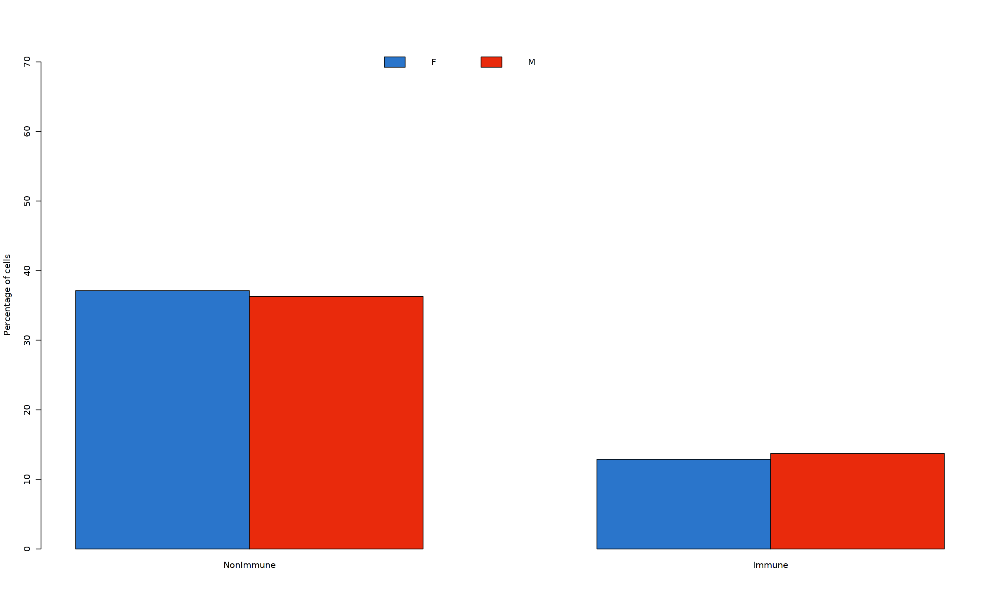

In [54]:
options(repr.plot.width=20, repr.plot.height=12)
barplot(t(t_percent), beside=TRUE, xlab = "", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(rowSums(t_percent))), 1, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

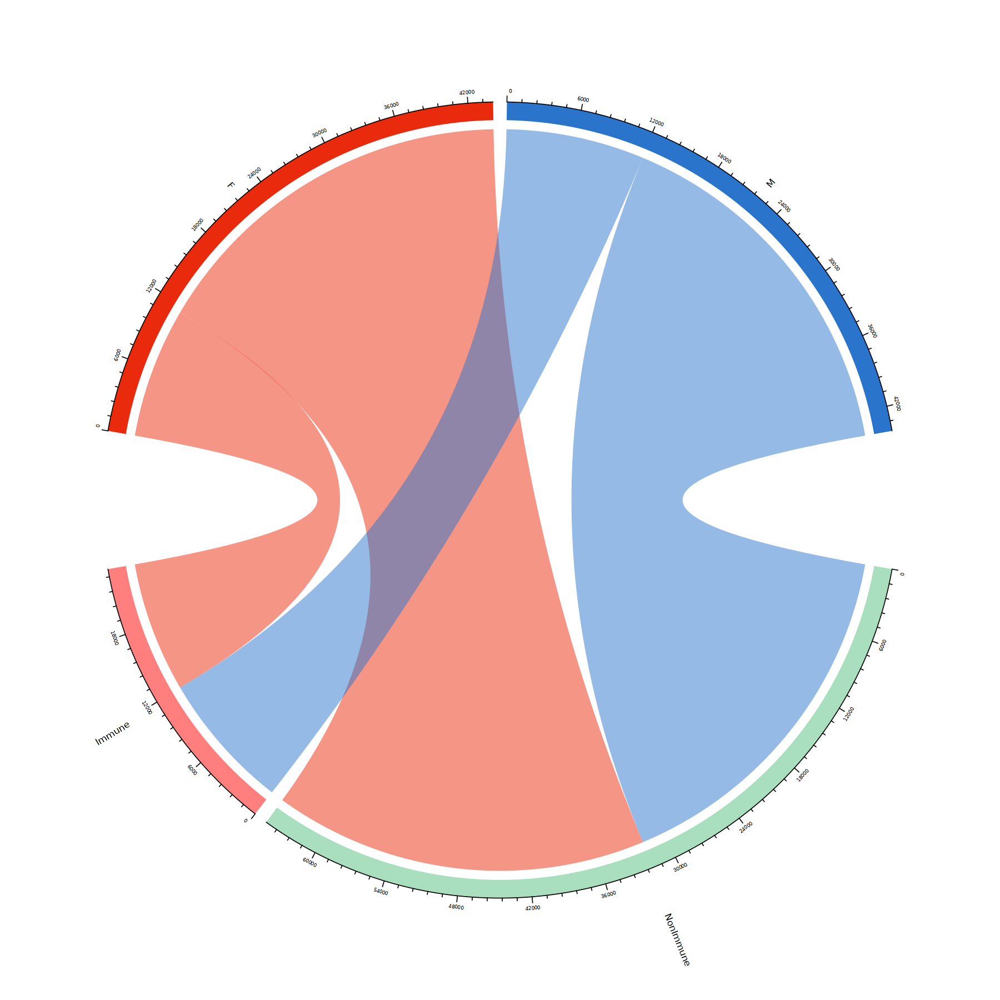

In [55]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(MORNAATACC@meta.data$Sex, MORNAATACC@meta.data$Immune))
for (row in 1:nrow(mat)) mat[row,] <- as.integer(mat[row,]/(sum(mat[row,])/min(rowSums(mat))))
circos.clear()
par(cex = 0.8)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(names(immune_colors), names(sex_colors)), grid.col=c(rev(sex_colors),immune_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.7, 0.5))}, bg.border = NA)

### 3.2 Gender DGE

In [56]:
DefaultAssay(MORNAATACC) <- "RNA"

#### 3.2.1 Naive

In [57]:
timepoint <- "Naive"
name_timepoint <- names_Naive

In [58]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


In [59]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [60]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |======================================================================| 100%


In [61]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [62]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [63]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [64]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Naive1F Naive1M Naive2F Naive2M
  OPC         56      27      95      88
  COP         18       6      51      37
  MOL       1613    2324    2520    3610
  Astro       95     476     301     376
  Epen        14      61      56      82
  Micro       78     508      10       4
  Neuron       0       0       0       0
  Peric       24     104       2       0

In [65]:
table(tmp$cellType, tmp$Sex)

        
            F    M
  OPC     151  115
  COP      69   43
  MOL    4133 5934
  Astro   396  852
  Epen     70  143
  Micro    88  512
  Neuron    0    0
  Peric    26  104

In [66]:
table(tmp$orig.ident_Sex, tmp$Sex)

         
             F    M
  Naive1F 1898    0
  Naive1M    0 3506
  Naive2F 3035    0
  Naive2M    0 4197

In [67]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [68]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = TRUE)

In [69]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [70]:
kids <- kids[names(kids)!="Neuron"]

In [71]:
kids
sids

OPC     COP     MOL   Astro    Epen   Micro   Peric 
  "OPC"   "COP"   "MOL" "Astro"  "Epen" "Micro" "Peric"

Naive1F   Naive1M   Naive2F   Naive2M 
"Naive1F" "Naive1M" "Naive2F" "Naive2M"

In [72]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


Naive1F Naive1M Naive2F Naive2M 
   1898    3506    3035    4197 

sample_id,group_id,n_cells
<fct>,<fct>,<dbl>
Naive1F,F,1898
Naive1M,M,3506
Naive2F,F,3035
Naive2M,M,4197


In [73]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [74]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [75]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [76]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro:Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:46208] 0 2 4 5 6 7 8 9 10 11 ...
  .. ..@ p       : int [1:5] 0 11032 22824 34523 46208
  .. ..@ Dim     : int [1:2] 12256 4
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:12256] "Xkr4" "Gm1992" "Gm19938" "Rp1" ...
  .. .. ..$ : chr [1:4] "Naive1F" "Naive1M" "Naive2F" "Naive2M"
  .. ..@ x       : num [1:46208] 29 1 11 17 24 39 32 76 8 276 ...
  .. ..@ factors : list()
 $ COP  :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:38542] 0 2 4 5 6 8 9 11 12 13 ...
  .. ..@ p       : int [1:5] 0 9730 16304 27666 38542
  .. ..@ Dim     : int [1:2] 12256 4
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:12256] "Xkr4" "Gm1992" "Gm19938" "Rp1" ...
  .. .. ..$ : chr [1:4] "Naive1F" "Naive1M" "Naive2F" "Naive2M"
  .. ..@ x       : num [1:38542] 33 3 2 6 26 6 23 593 45 2 ...
  .. ..@ factors : list()
 $ Epen :Formal class 'dgCMatrix' [package "Matrix"] with 6 slo

In [77]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
            F    M
  OPC     151  115
  COP      69   43
  MOL    4133 5934
  Astro   396  852
  Epen     70  143
  Micro    88  512
  Neuron    0    0
  Peric    26  104

In [78]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Naive1F Naive1M Naive2F Naive2M
  OPC         56      27      95      88
  COP         18       6      51      37
  MOL       1613    2324    2520    3610
  Astro       95     476     301     376
  Epen        14      61      56      82
  Micro       78     508      10       4
  Neuron       0       0       0       0
  Peric       24     104       2       0

In [79]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [80]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [81]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id) 

Joining with `by = join_by(sample_id)`


In [82]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [83]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro" "COP"   "Epen"  "MOL"   "Micro" "OPC"   "Peric"

In [84]:
HVGs.list <- list()

##### 3.2.1.1 MOL

In [85]:
cluster_choice <- "MOL"

In [86]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [87]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [88]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [89]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [90]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,MOL,Naive1F,F
Naive1M,MOL,Naive1M,M
Naive2F,MOL,Naive2F,F
Naive2M,MOL,Naive2M,M


In [91]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [92]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [93]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

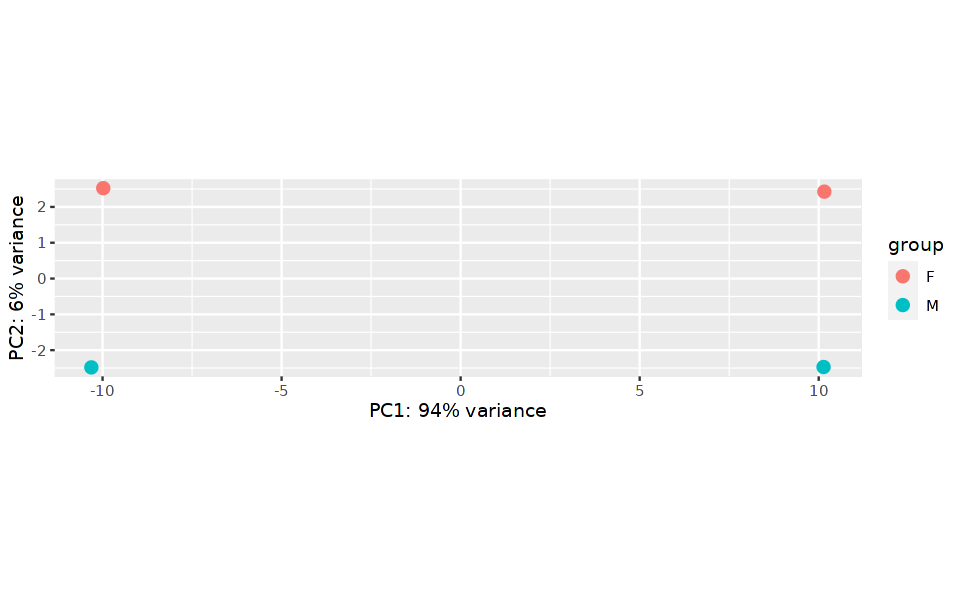

In [94]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [95]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

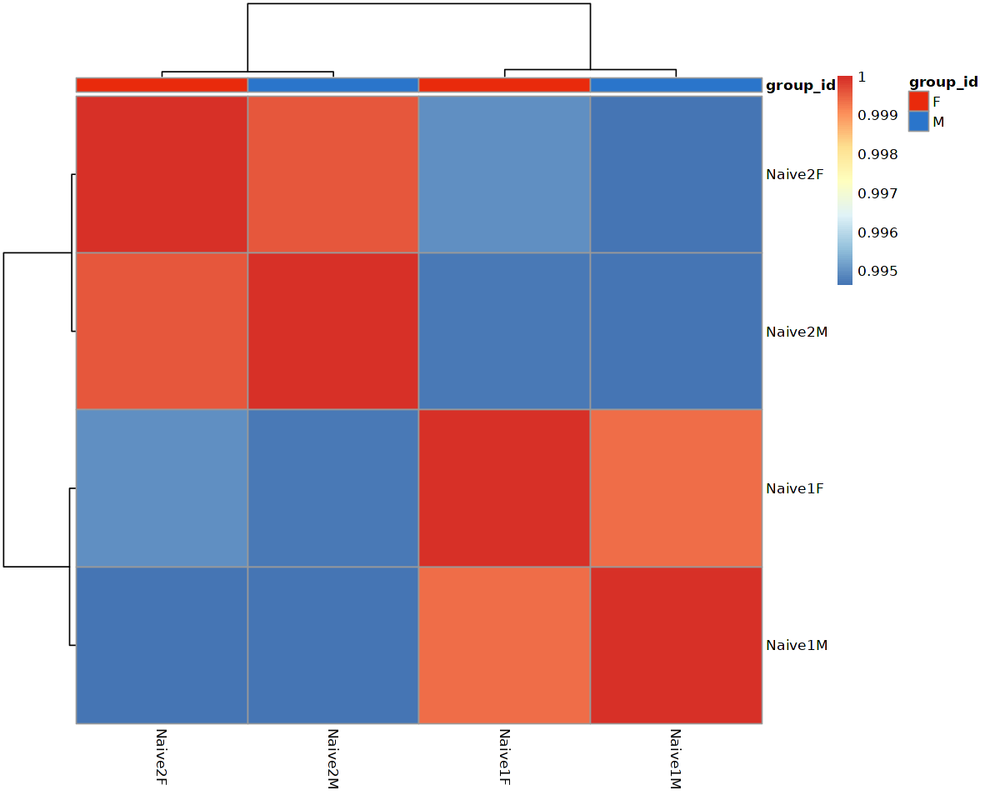

In [96]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [97]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [98]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


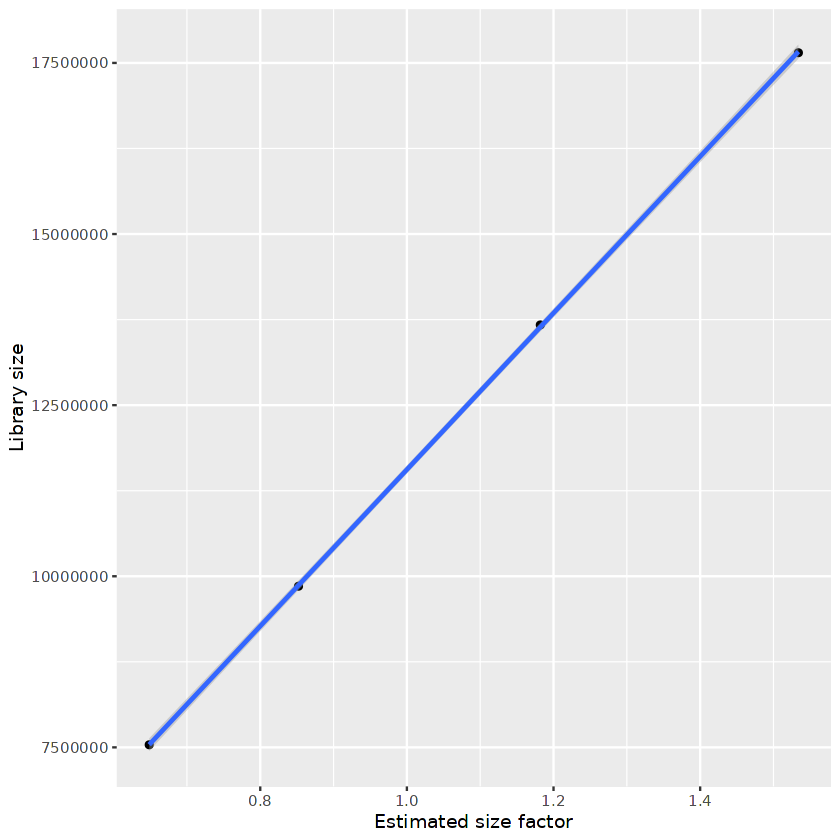

In [99]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [100]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,MOL,Naive1F,F,0.6485325
Naive1M,MOL,Naive1M,M,0.8521946
Naive2F,MOL,Naive2F,F,1.1819265
Naive2M,MOL,Naive2M,M,1.5339960


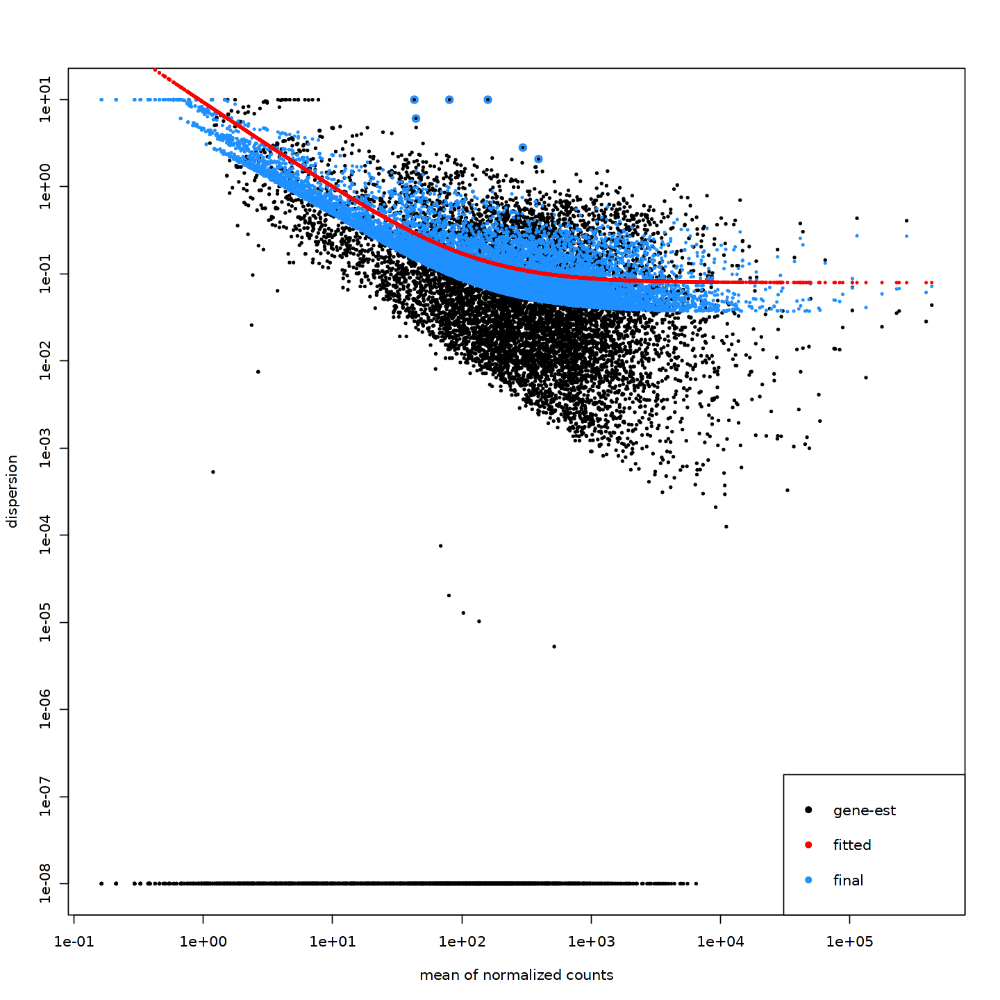

In [101]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [102]:
condition1 = "M"
condition2 = "F"

In [103]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [104]:
summary(res)


out of 12231 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.033%
LFC < 0 (down)     : 2, 0.016%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



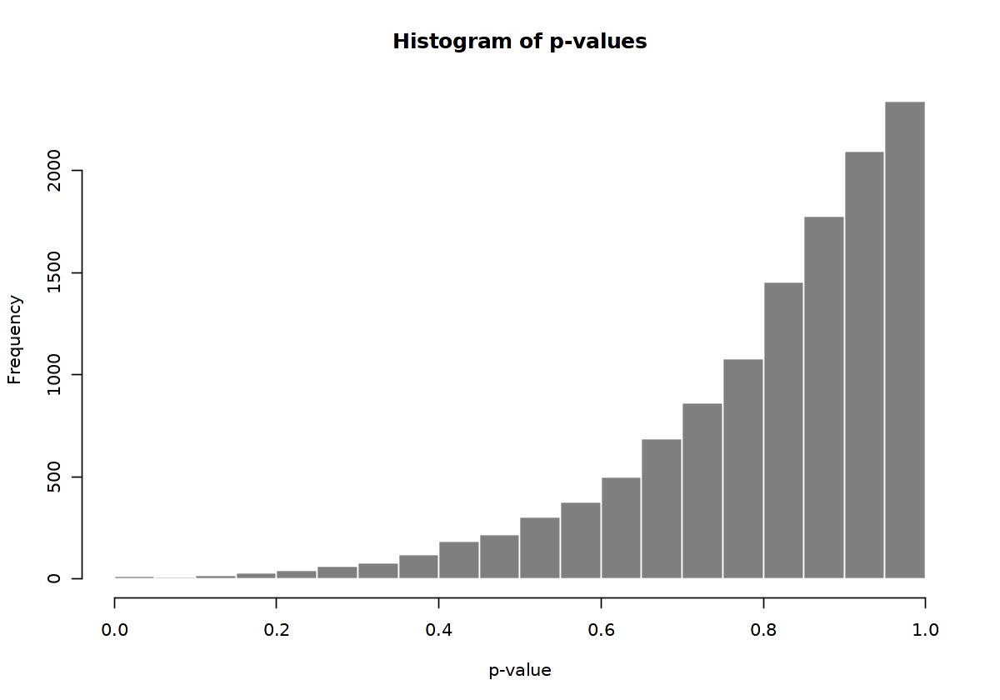

In [105]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

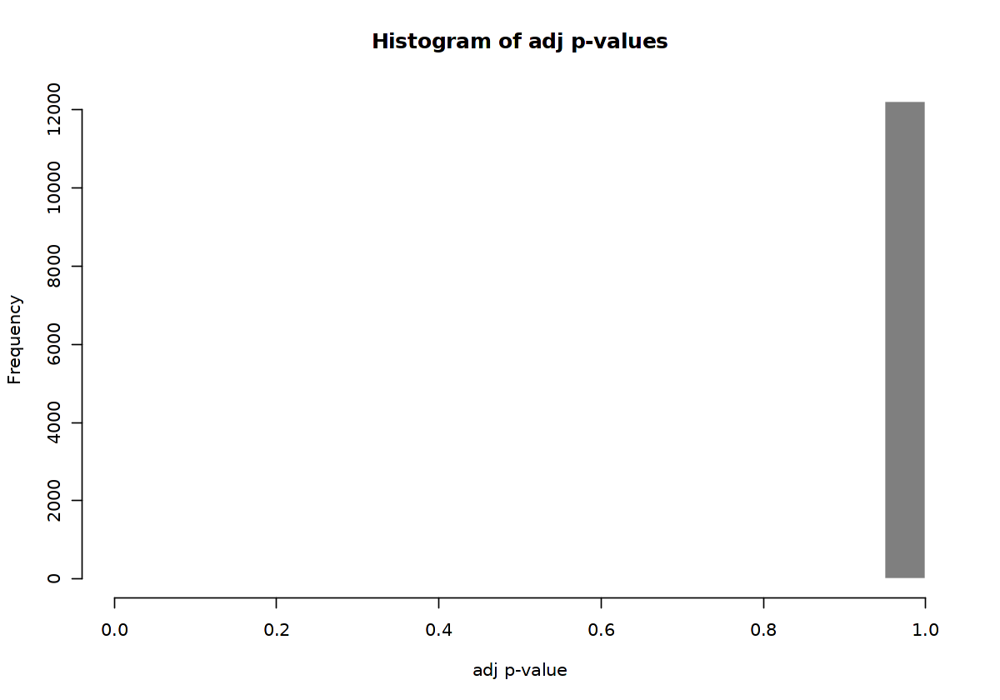

In [106]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

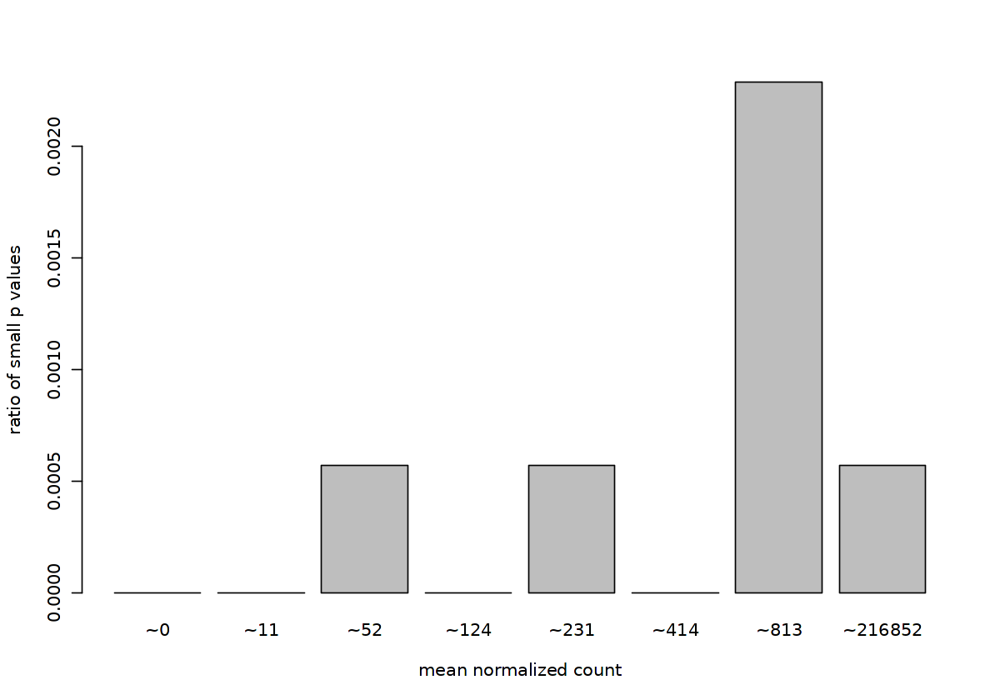

In [107]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

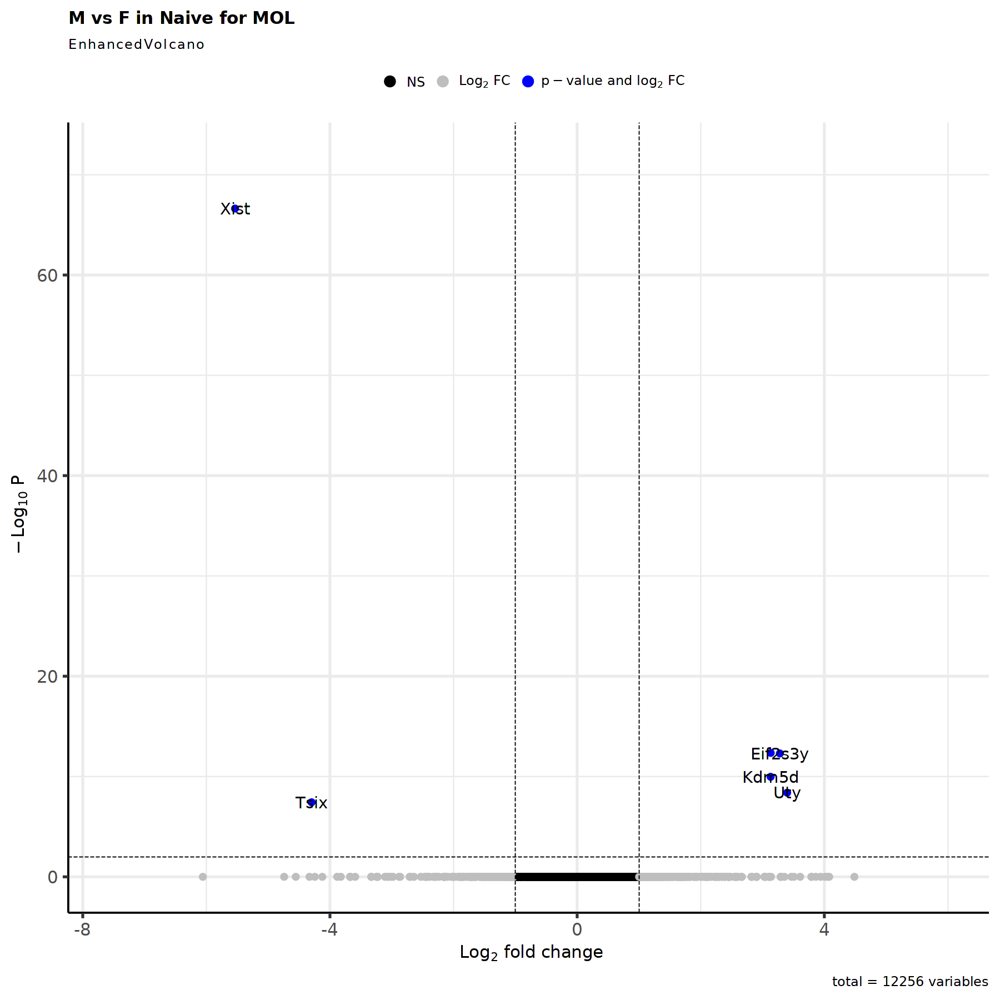

In [108]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [109]:
res <- res[complete.cases(res$padj),]

In [110]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [111]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     6387.120       -5.53541  0.309711 -17.87281 1.92077e-71 2.34929e-67
Tsix      892.213       -4.29674  0.639371  -6.72026 1.81406e-11 3.69795e-08
Uty       745.148        3.39834  0.481433   7.05880 1.67945e-12 4.10826e-09
Eif2s3y   556.685        3.27995  0.396102   8.28056 1.22593e-16 4.99811e-13
Ddx3y     659.845        3.13252  0.375443   8.34352 7.21136e-17 4.41010e-13
Kdm5d     272.527        3.13081  0.413132   7.57824 3.50282e-14 1.07107e-10

In [112]:
nrow(res_filtered)

[1] 6

In [113]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [114]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [115]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [116]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


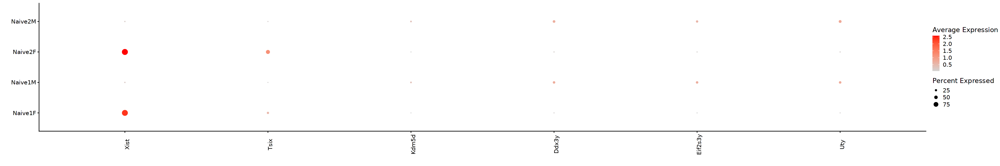

In [117]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

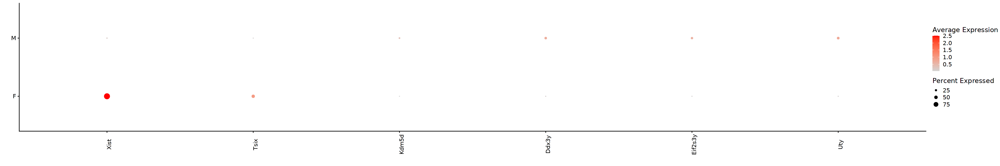

In [118]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [119]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.2 OPC

In [120]:
cluster_choice <- "OPC"

In [121]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [122]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [123]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [124]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [125]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,OPC,Naive1F,F
Naive1M,OPC,Naive1M,M
Naive2F,OPC,Naive2F,F
Naive2M,OPC,Naive2M,M


In [126]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [127]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [128]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

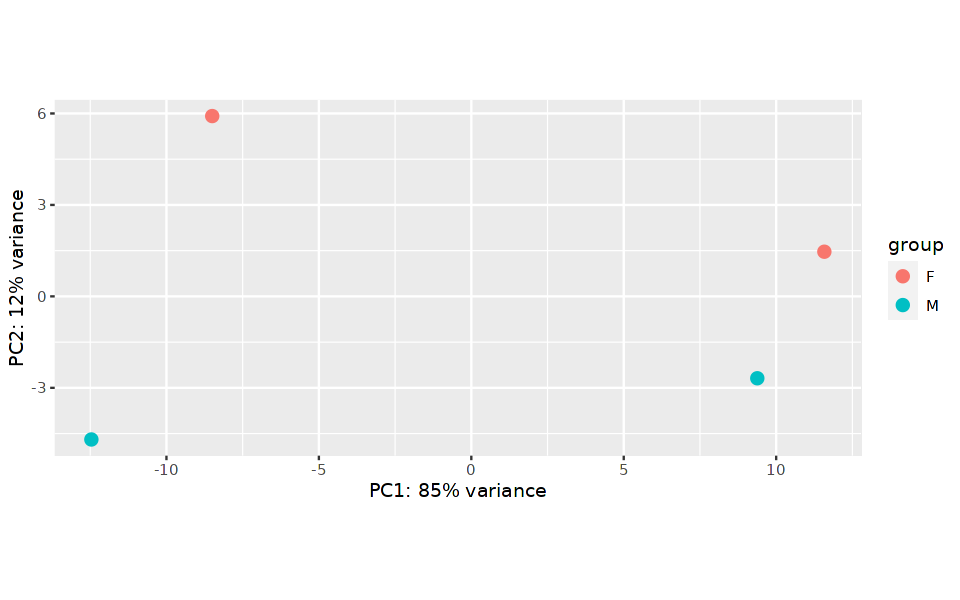

In [129]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [130]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

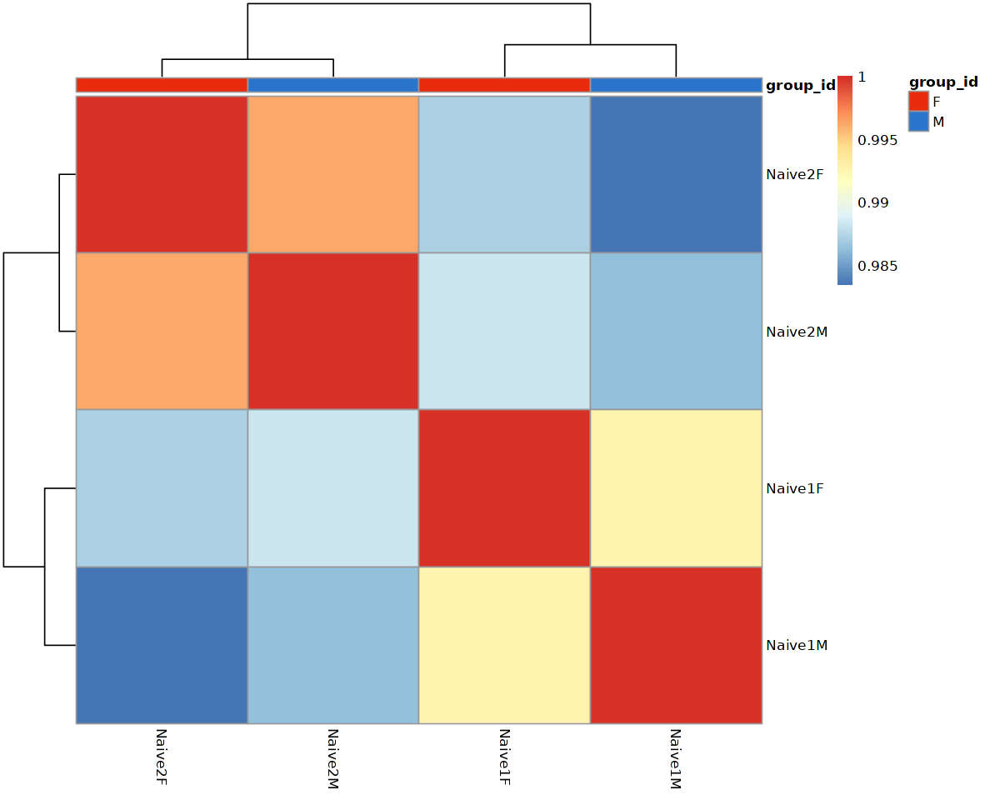

In [131]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [132]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [133]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


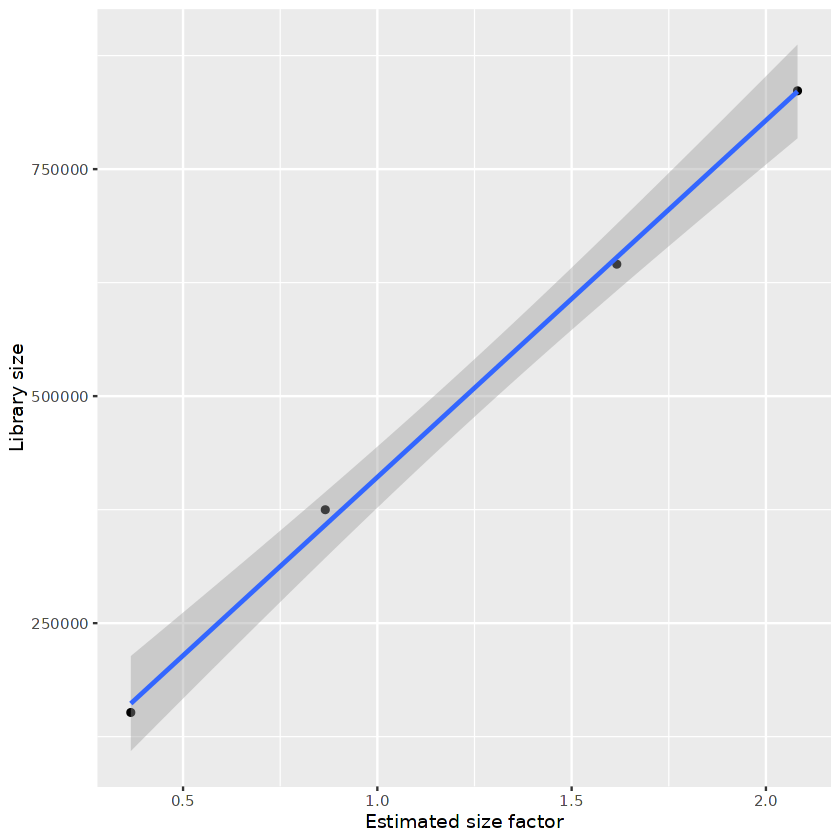

In [134]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [135]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,OPC,Naive1F,F,0.8660254
Naive1M,OPC,Naive1M,M,0.3654957
Naive2F,OPC,Naive2F,F,2.0813276
Naive2M,OPC,Naive2M,M,1.6162315


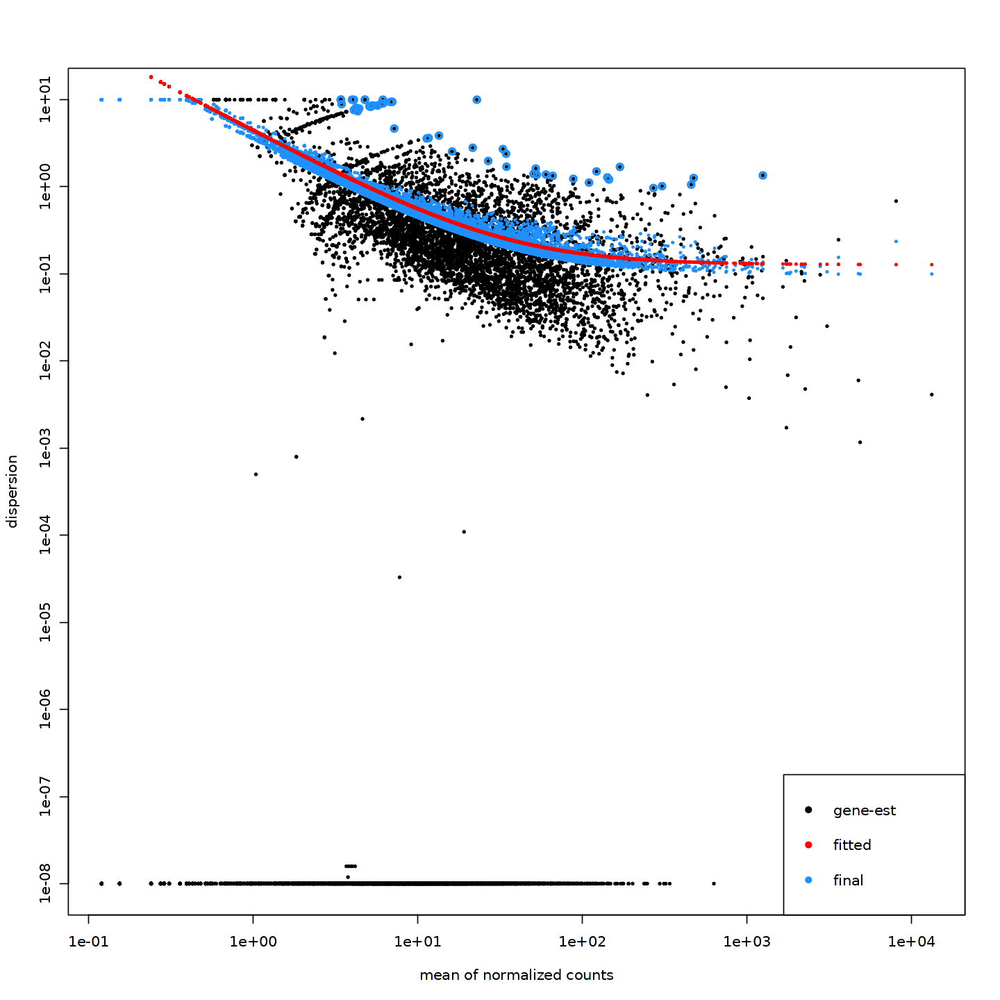

In [136]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [137]:
condition1 = "M"
condition2 = "F"

In [138]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [139]:
summary(res)


out of 11935 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 2, 0.017%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



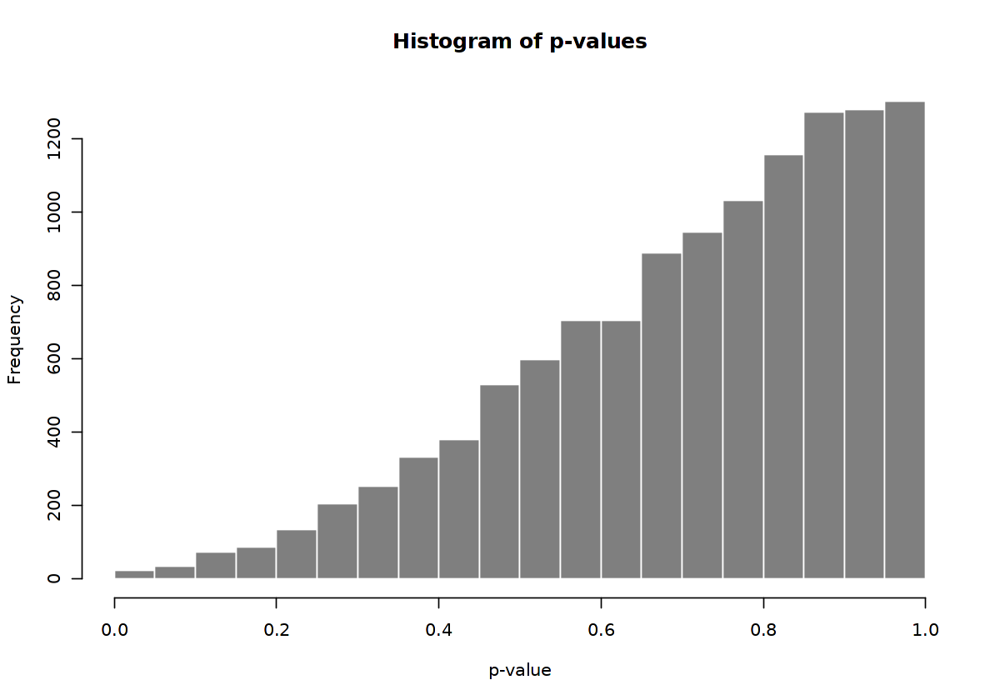

In [140]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

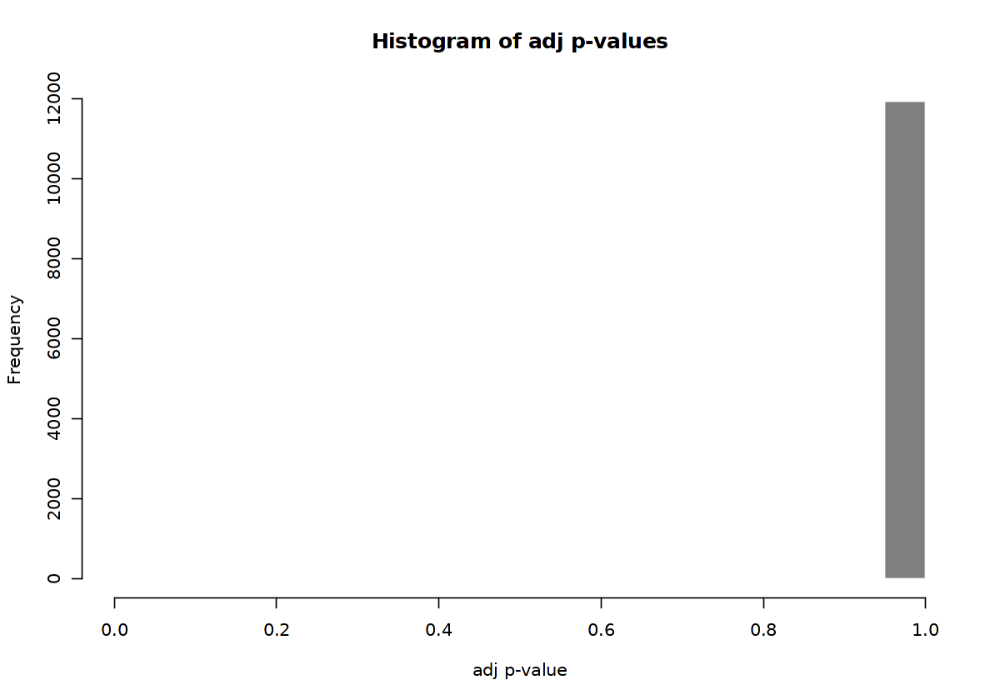

In [141]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

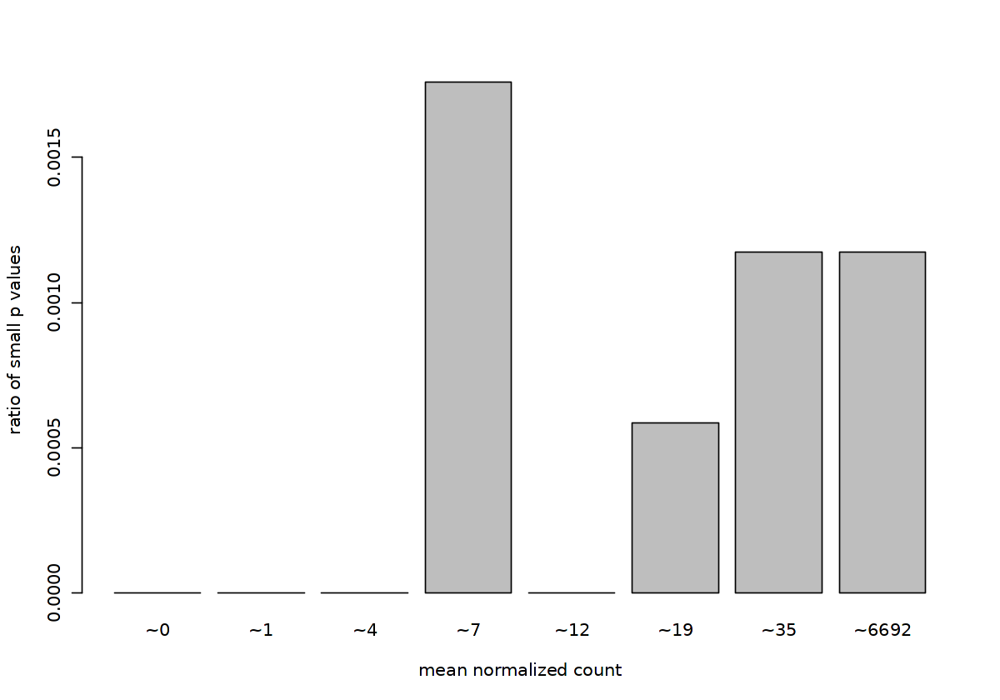

In [142]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

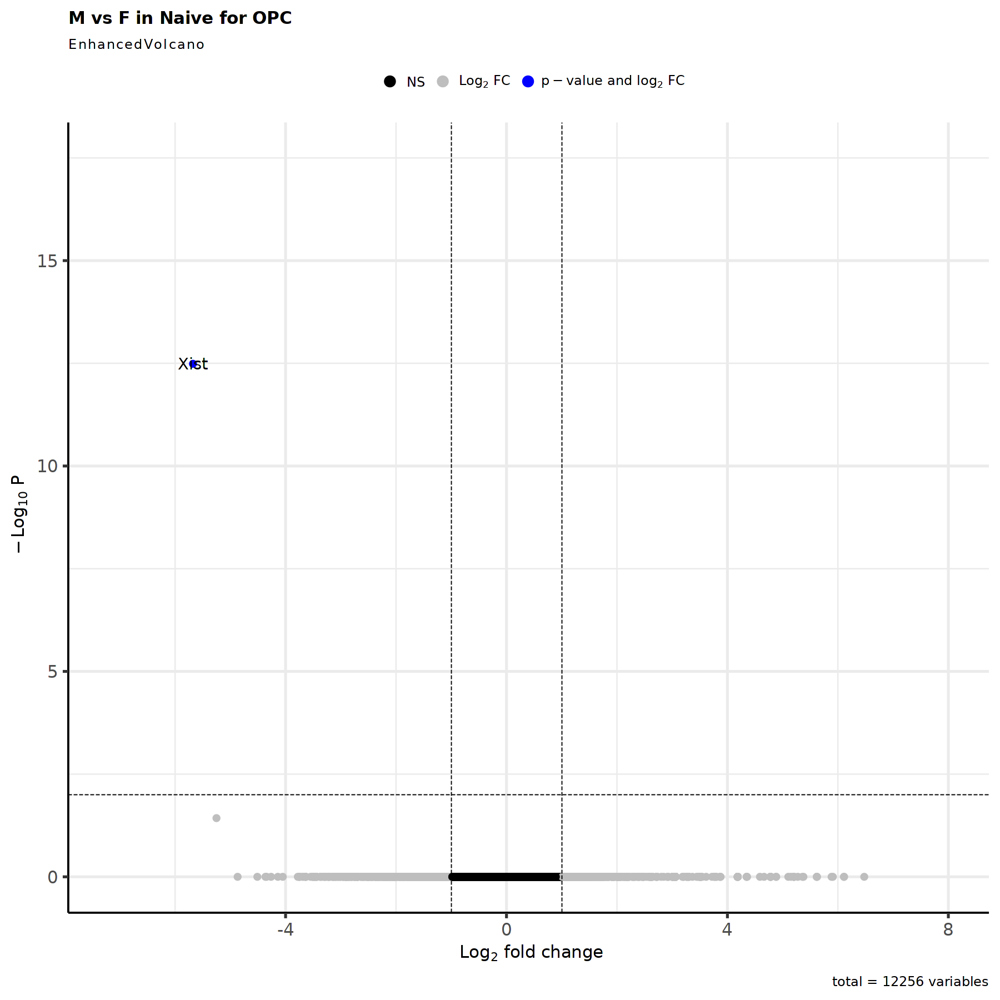

In [143]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [144]:
res <- res[complete.cases(res$padj),]

In [145]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [146]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   264.699       -5.67666  0.671177  -8.45776 2.72558e-17 3.25298e-13

In [147]:
nrow(res_filtered)

[1] 1

In [148]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [149]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [150]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [151]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


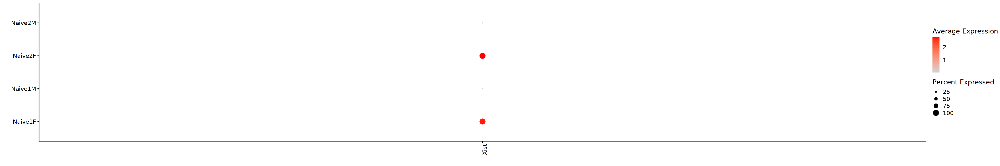

In [152]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

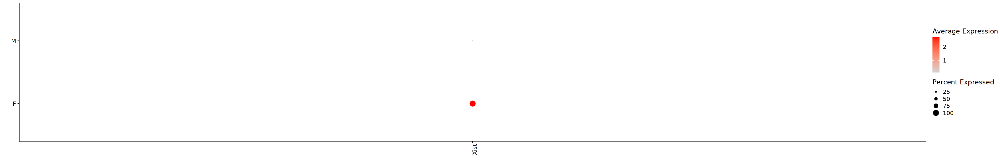

In [153]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [154]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.3 Micro

In [155]:
cluster_choice <- "Micro"

In [156]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Naive2M 
      4

In [157]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [158]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [159]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [160]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,Micro,Naive1F,F
Naive1M,Micro,Naive1M,M
Naive2F,Micro,Naive2F,F


In [161]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [162]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [163]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

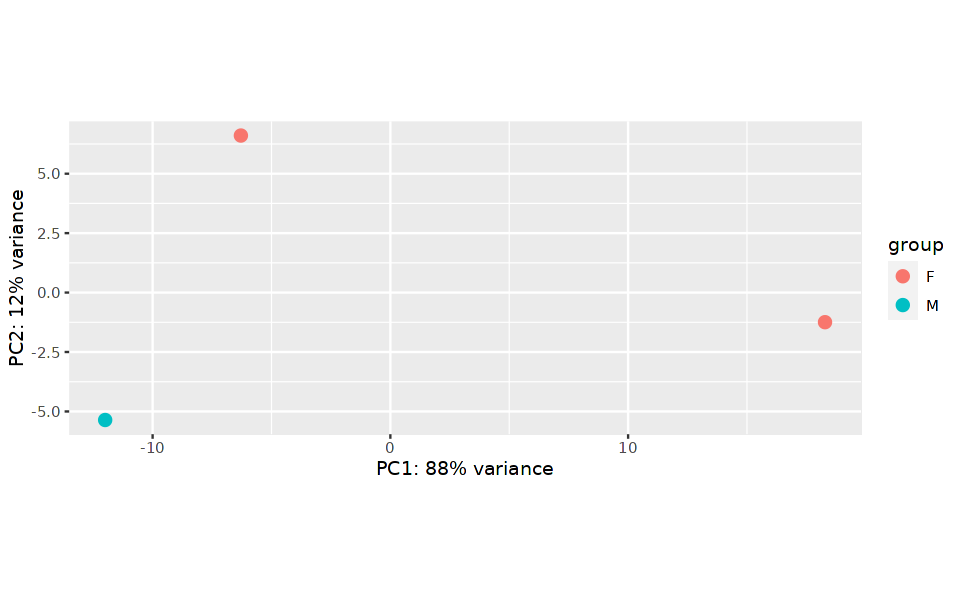

In [164]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [165]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

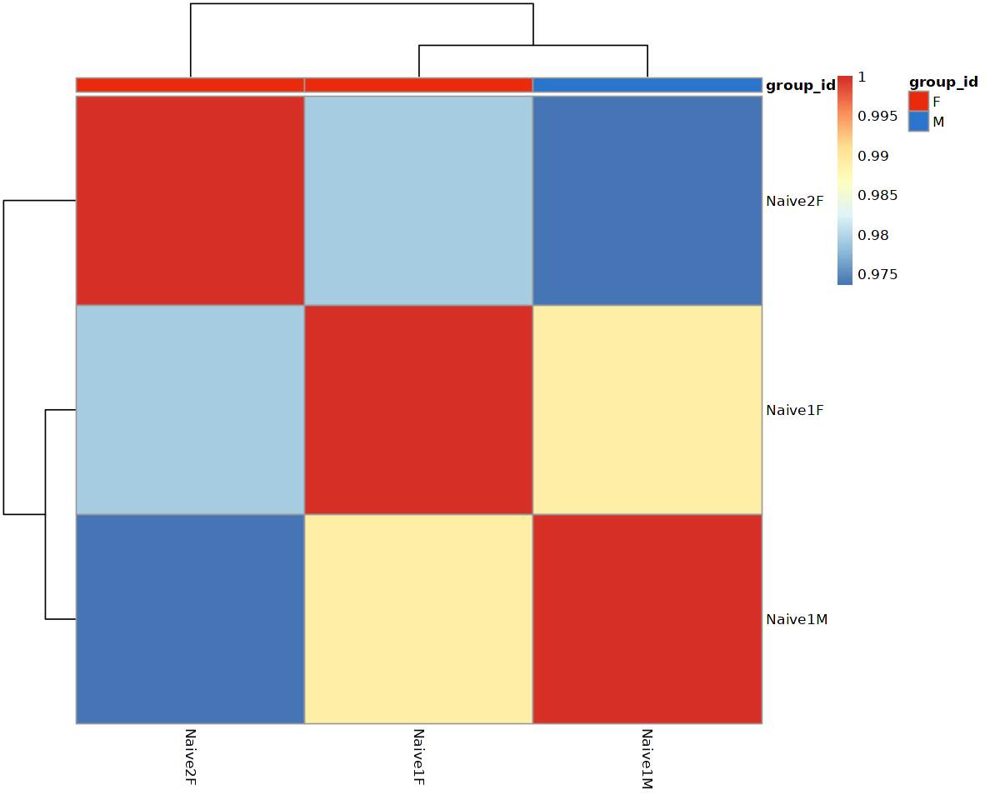

In [166]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [167]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [168]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


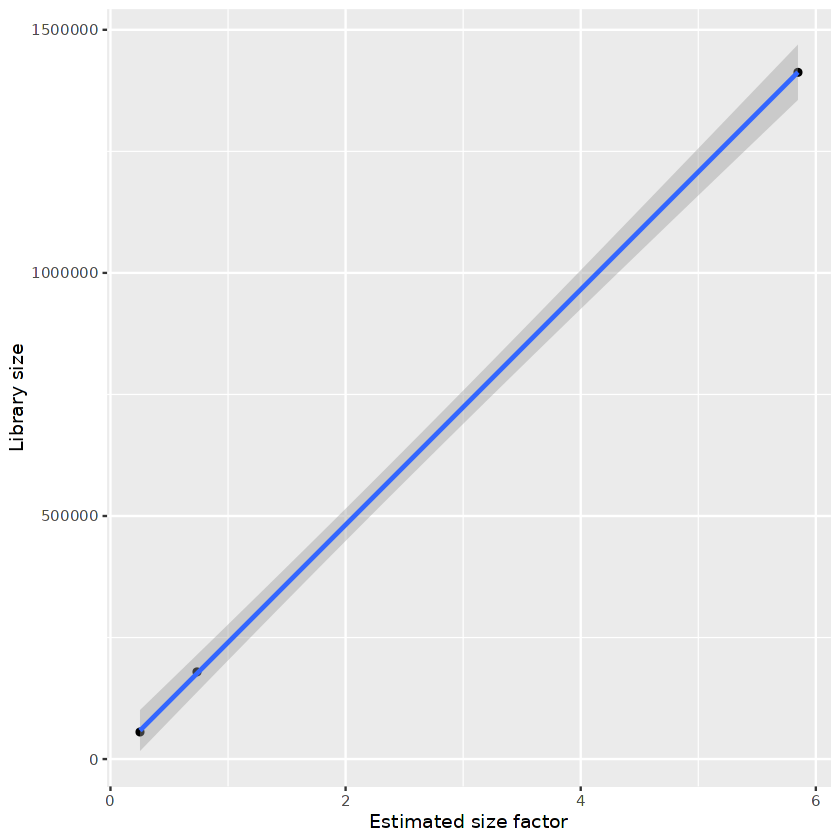

In [169]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [170]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,Micro,Naive1F,F,0.7359768
Naive1M,Micro,Naive1M,M,5.8480355
Naive2F,Micro,Naive2F,F,0.2511001


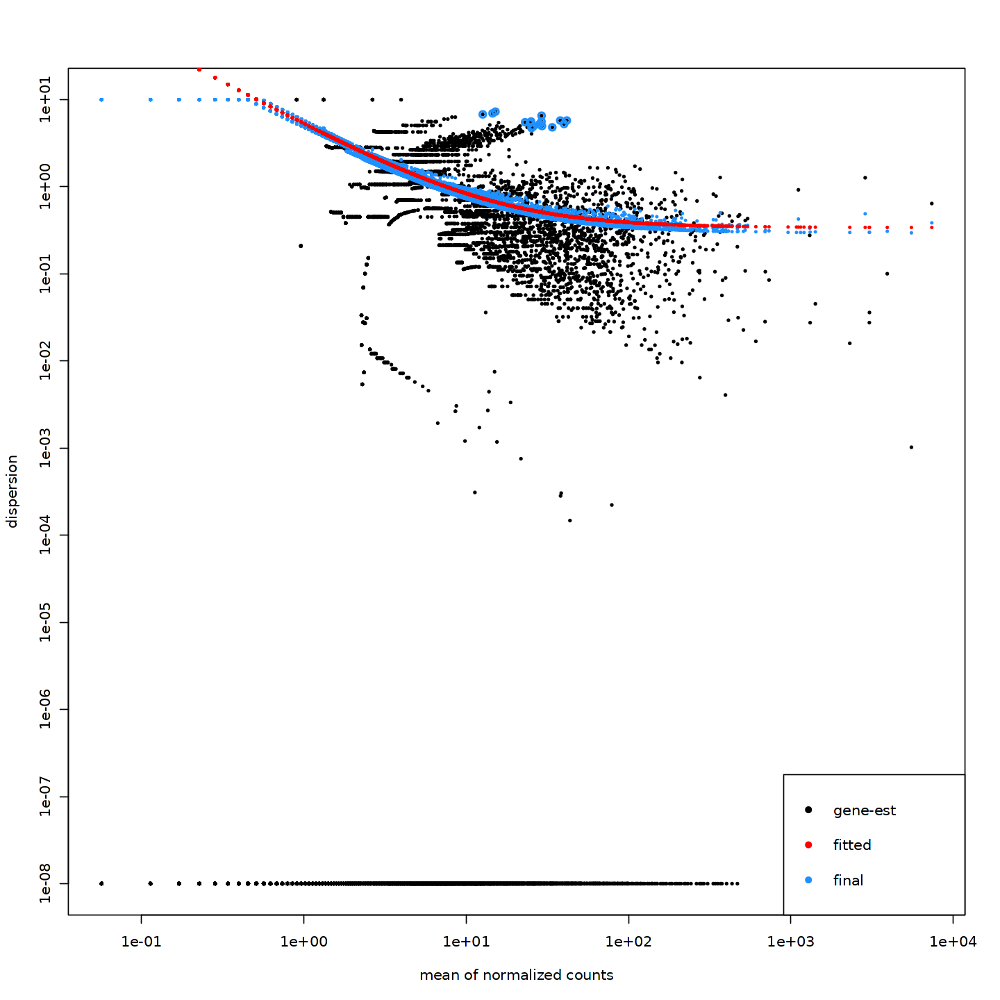

In [171]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [172]:
condition1 = "M"
condition2 = "F"

In [173]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [174]:
summary(res)


out of 11786 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.0085%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



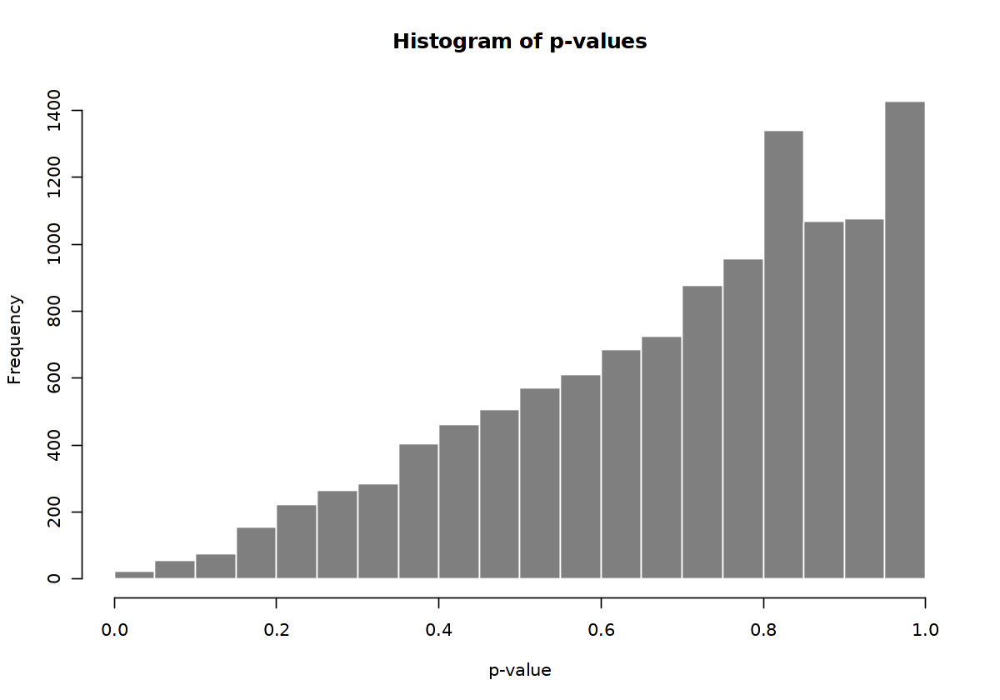

In [175]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

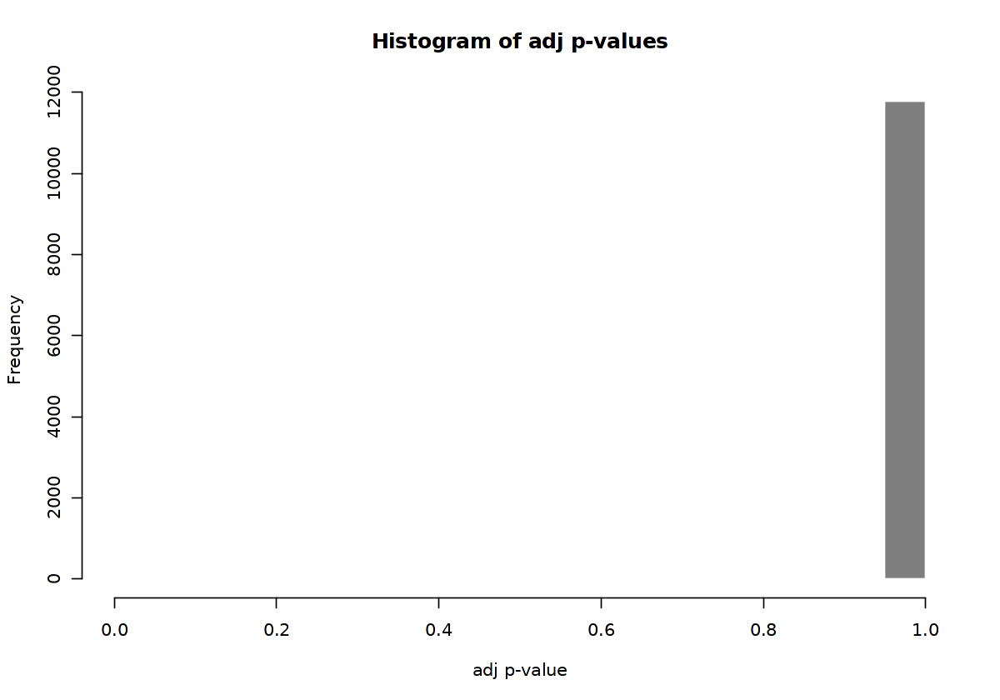

In [176]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

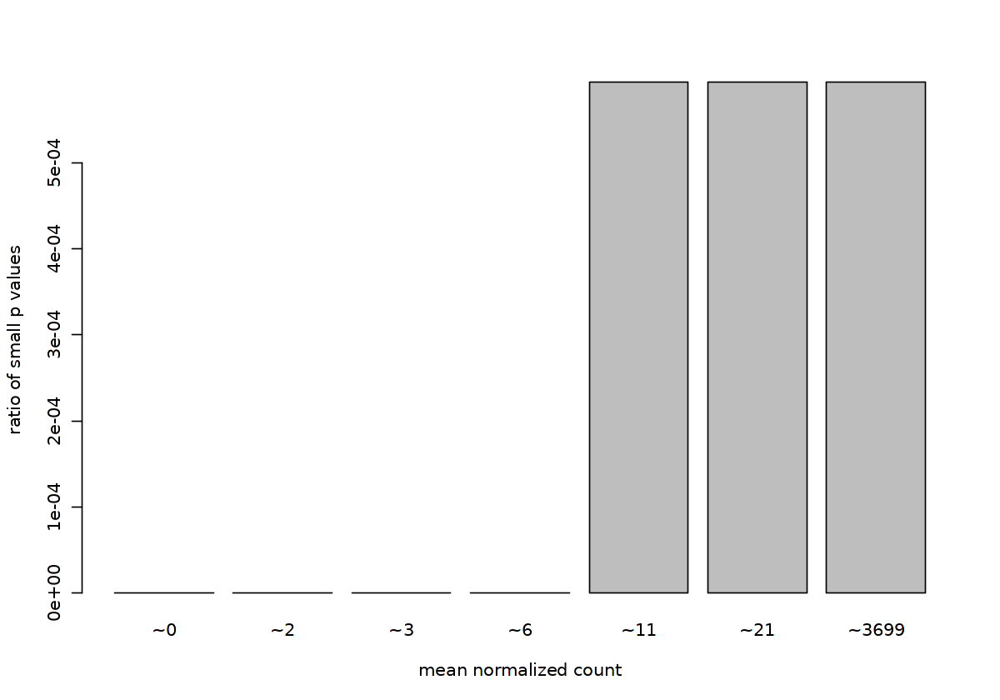

In [177]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

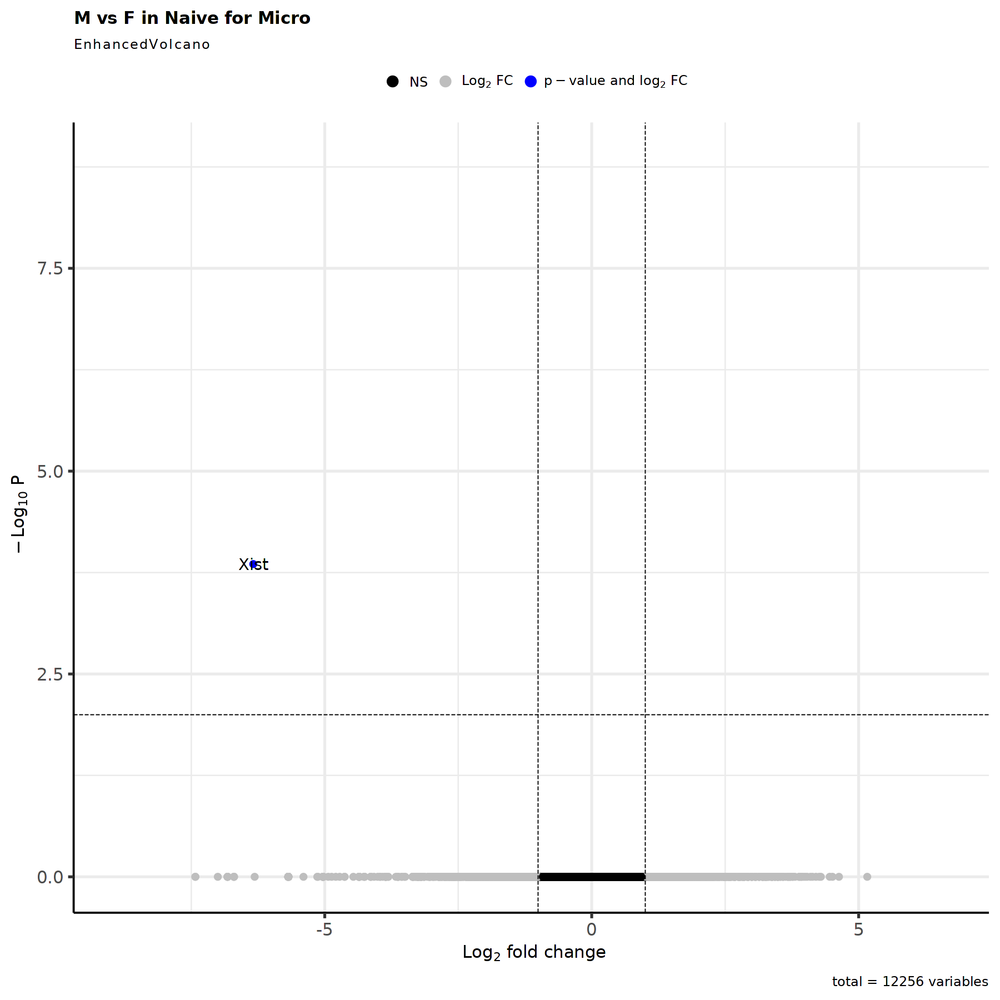

In [178]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [179]:
res <- res[complete.cases(res$padj),]

In [180]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [181]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   140.039       -6.33932   1.11182  -5.70176 1.18574e-08 0.000139752

In [182]:
nrow(res_filtered)

[1] 1

In [183]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [184]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [185]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [186]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


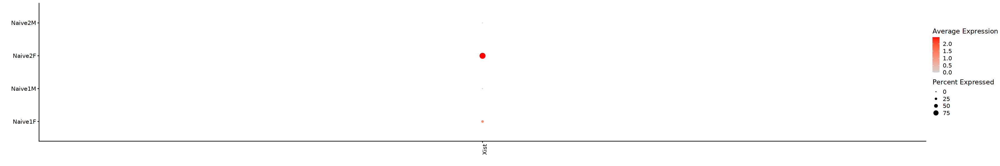

In [187]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

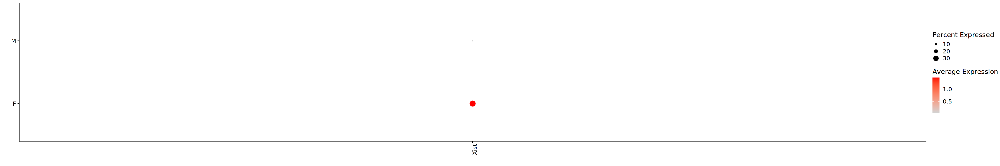

In [188]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [189]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.4 Astro

In [190]:
cluster_choice <- "Astro"

In [191]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [192]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [193]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [194]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [195]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Naive1F,Astro,Naive1F,F
Naive1M,Astro,Naive1M,M
Naive2F,Astro,Naive2F,F
Naive2M,Astro,Naive2M,M


In [196]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [197]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [198]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

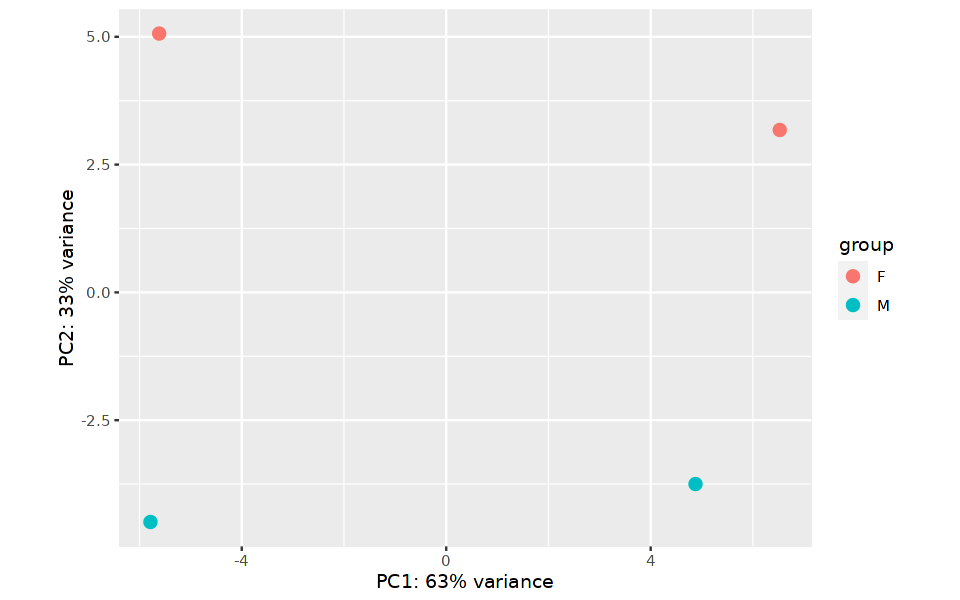

In [199]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [200]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

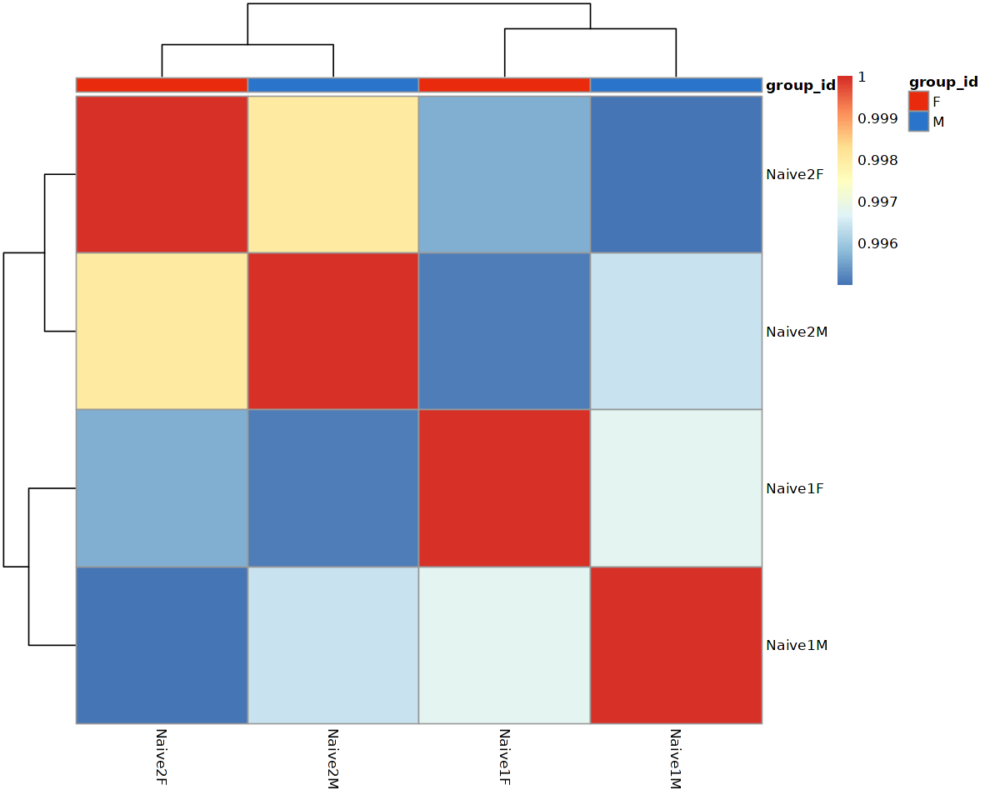

In [201]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [202]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [203]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


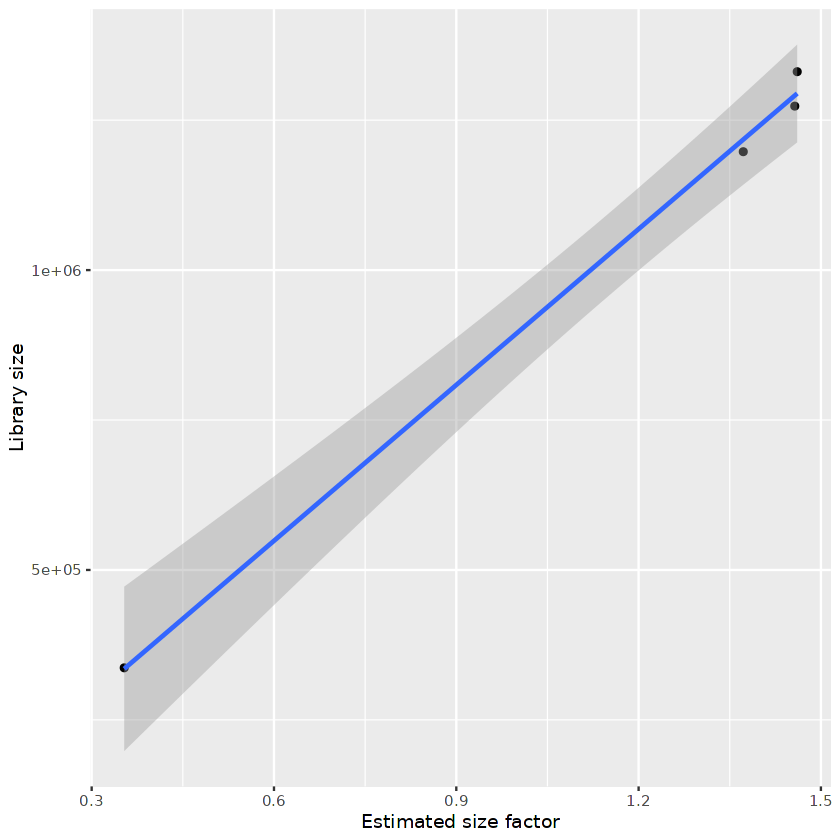

In [204]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [205]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Naive1F,Astro,Naive1F,F,0.3535534
Naive1M,Astro,Naive1M,M,1.4610056
Naive2F,Astro,Naive2F,F,1.3722265
Naive2M,Astro,Naive2M,M,1.4569799


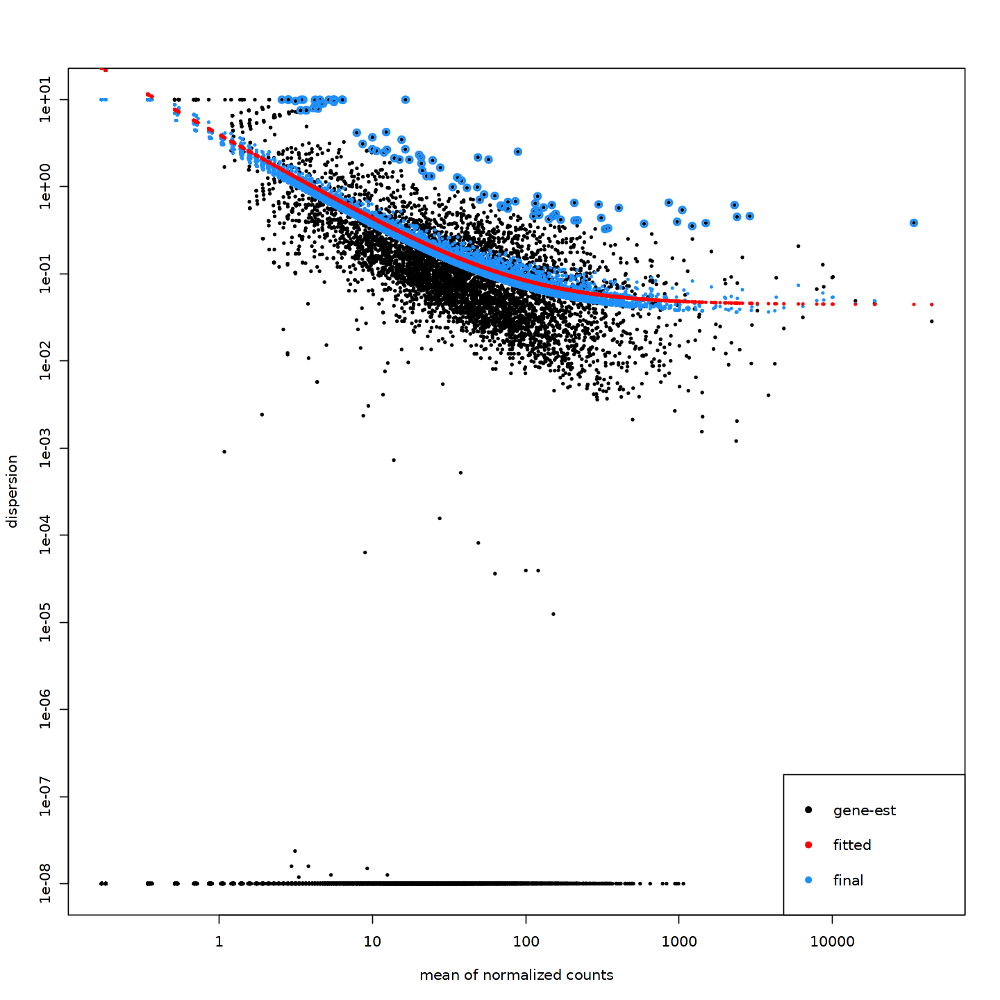

In [206]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [207]:
condition1 = "M"
condition2 = "F"

In [208]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [209]:
summary(res)


out of 12108 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 1, 0.0083%
LFC < 0 (down)     : 1, 0.0083%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



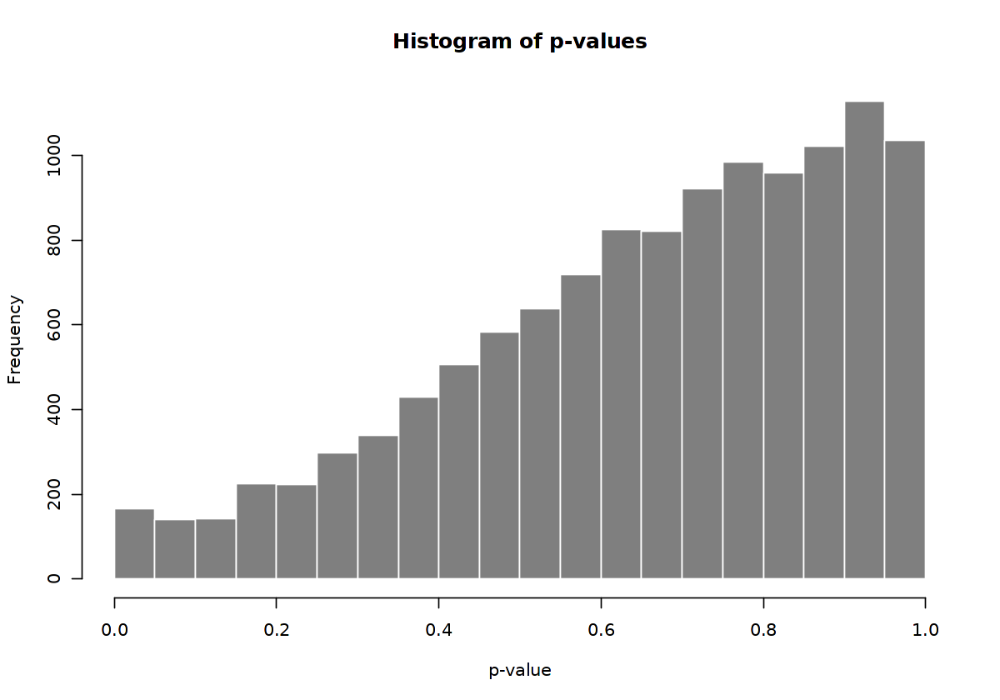

In [210]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

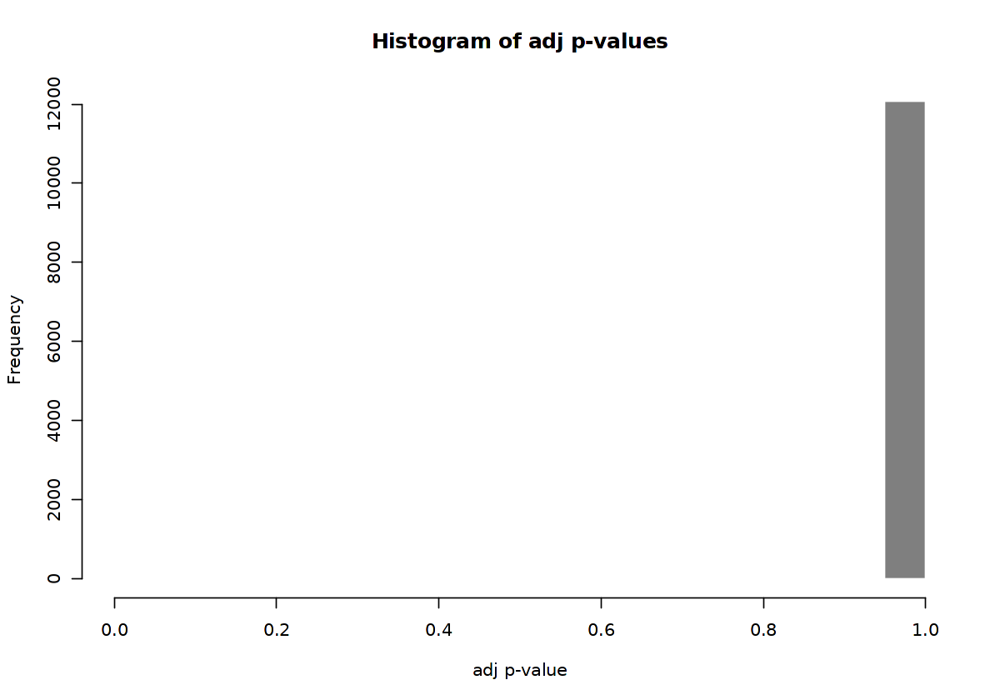

In [211]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

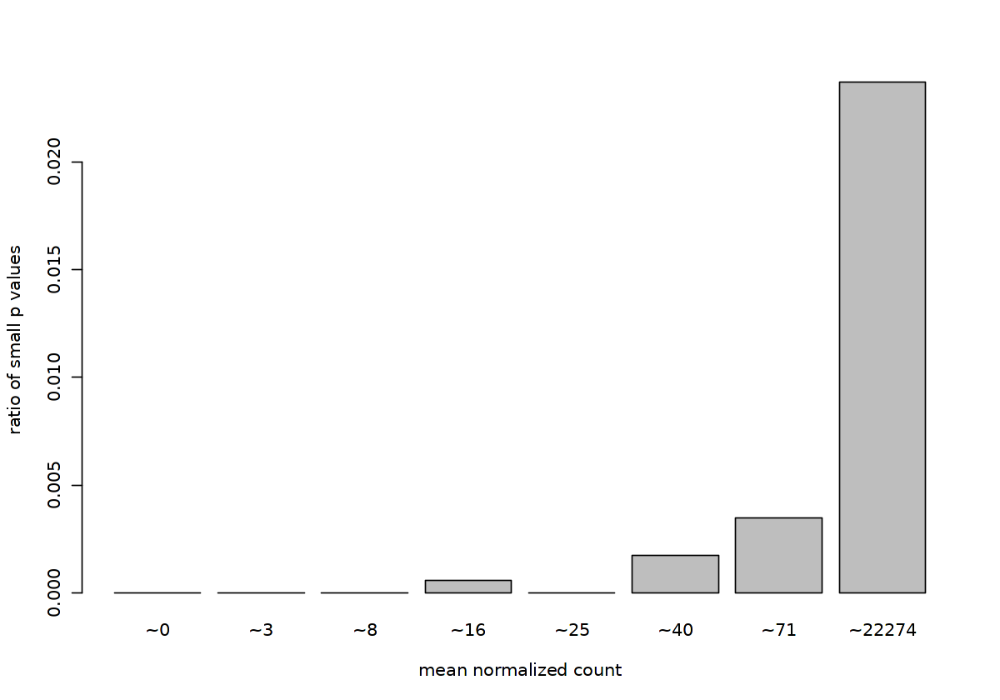

In [212]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

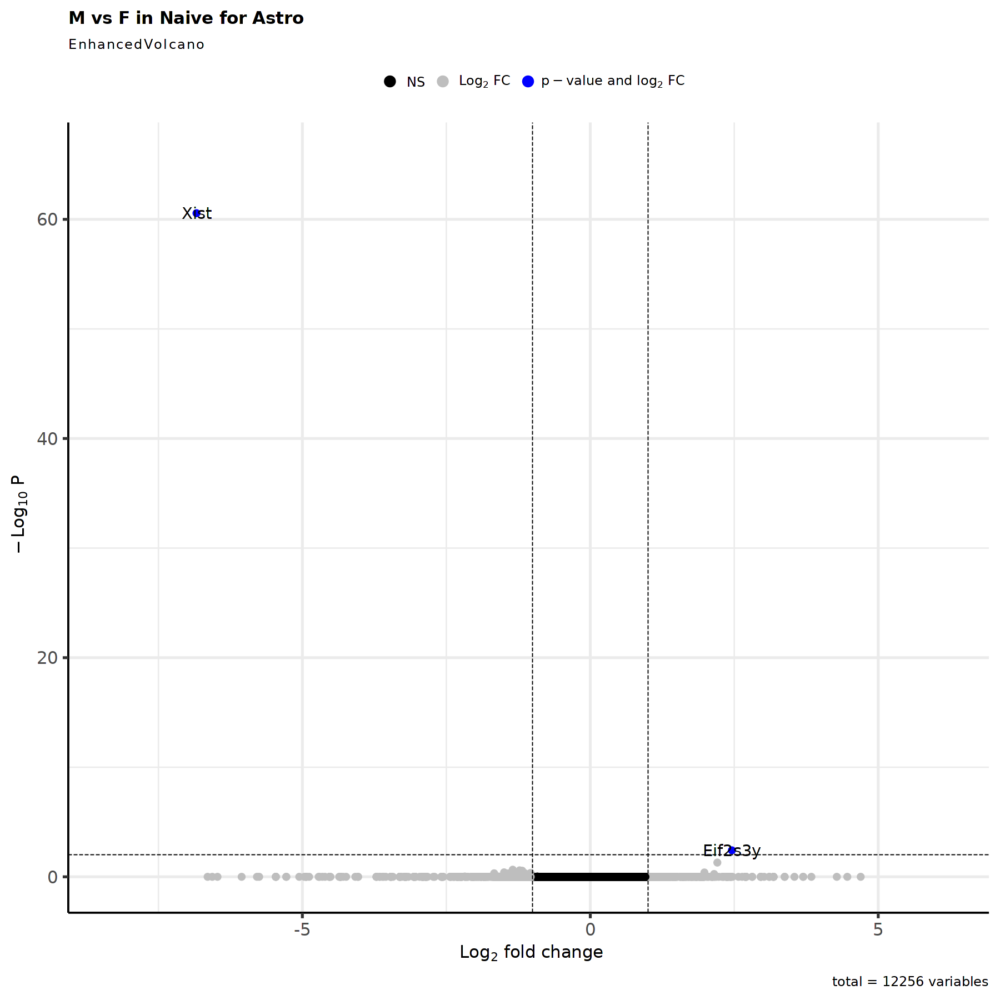

In [213]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [214]:
res <- res[complete.cases(res$padj),]

In [215]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [216]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 2 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     828.5393       -6.83851  0.400493 -17.07523 2.26929e-65 2.74765e-61
Eif2s3y   96.2337        2.45896  0.493716   4.98053 6.34115e-07 3.83893e-03

In [217]:
nrow(res_filtered)

[1] 2

In [218]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [219]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [220]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [221]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


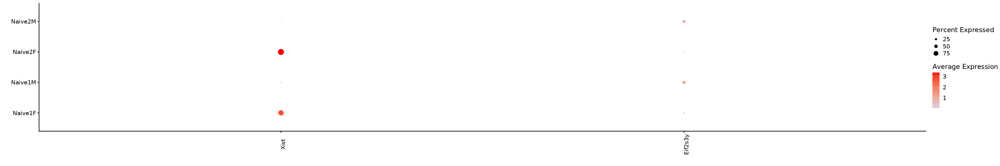

In [222]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

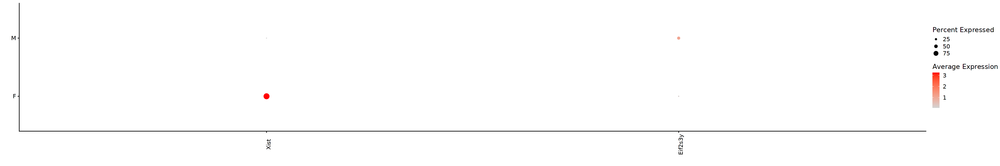

In [223]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [224]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.1.5 Summary

In [225]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

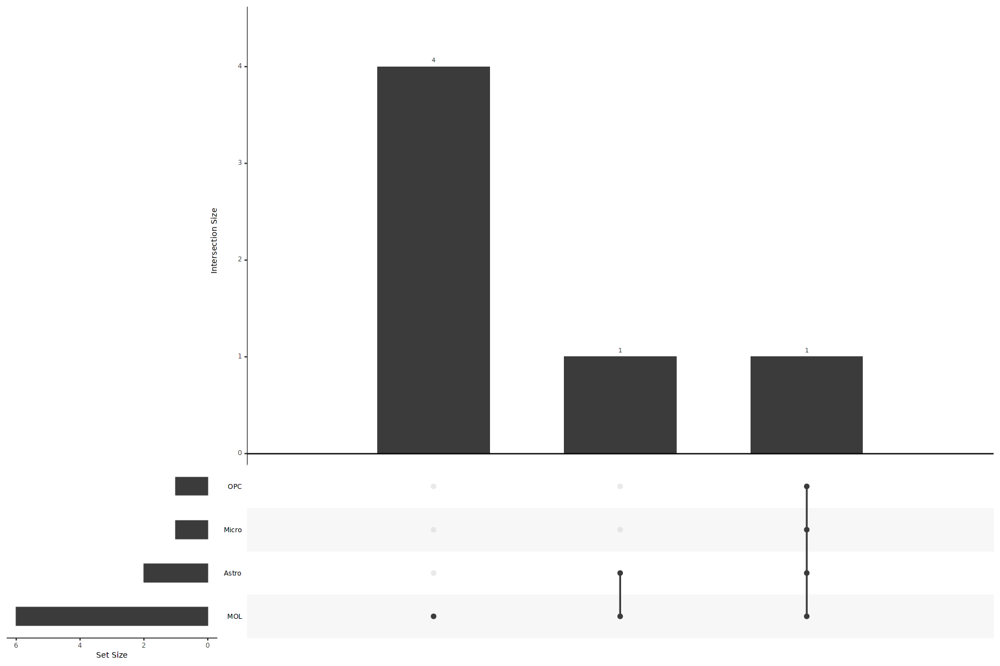

In [226]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [227]:
HVF <- unique(unlist(HVGs.list))

In [228]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [229]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [230]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [231]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [232]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [233]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [234]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [235]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"`aes_string()` was deprecated in ggplot2 3.0.0.
ℹ Please use tidy evaluation idioms with `aes()`.
ℹ See also `vignette("ggplot2-in-packages")` for more information."
Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


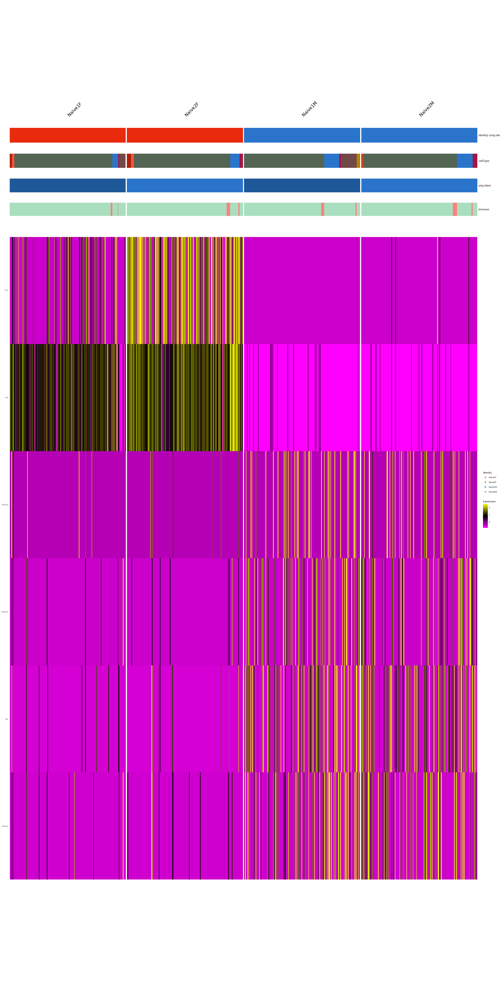

In [236]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    slot = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [237]:
sample_names <- levels(tmp$orig.ident_Sex)

In [238]:
Idents(object = tmp) <- "Sex"

In [239]:
gene_list <- HVF

In [240]:
tmp_markers <- data.frame(matrix(ncol=length(names(sub_timepoint_Sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sub_timepoint_Sex_colors)))))

In [241]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_Sex == names(sub_timepoint_Sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [242]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [243]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [244]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

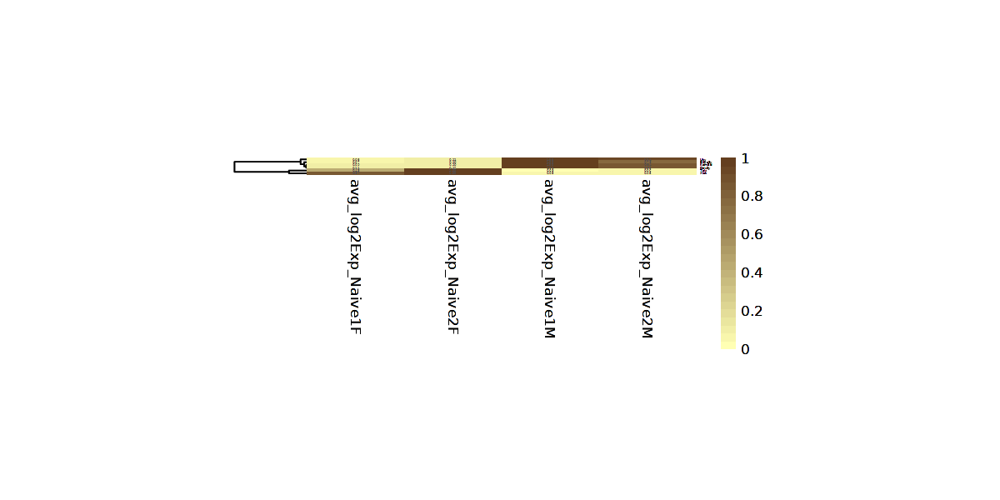

In [245]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [246]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [247]:
gene_list <- gene_list[ph$tree_row$order]

In [248]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [249]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [250]:
matrix <- tmp_markers_mean

In [251]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

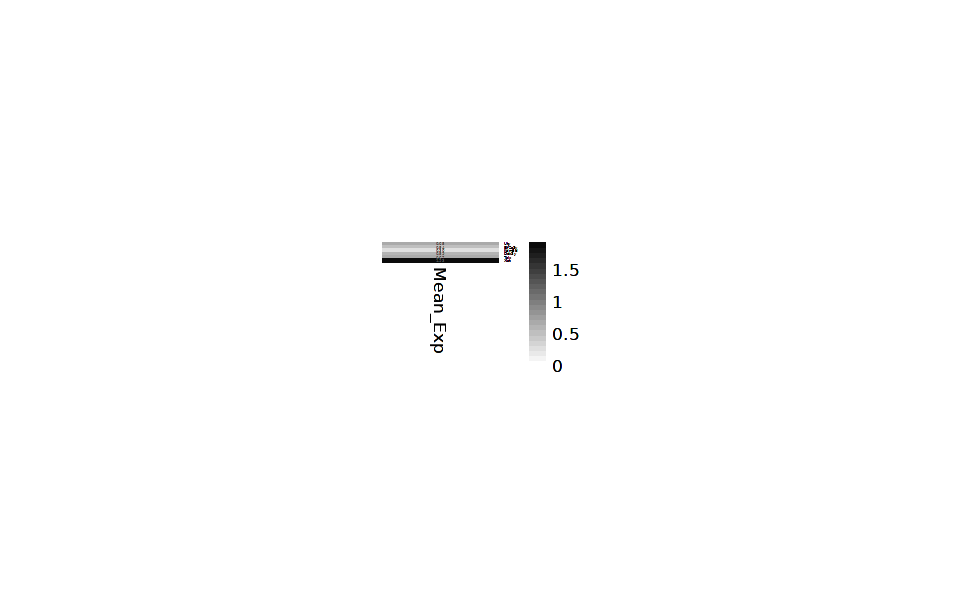

In [252]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [253]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [254]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [255]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

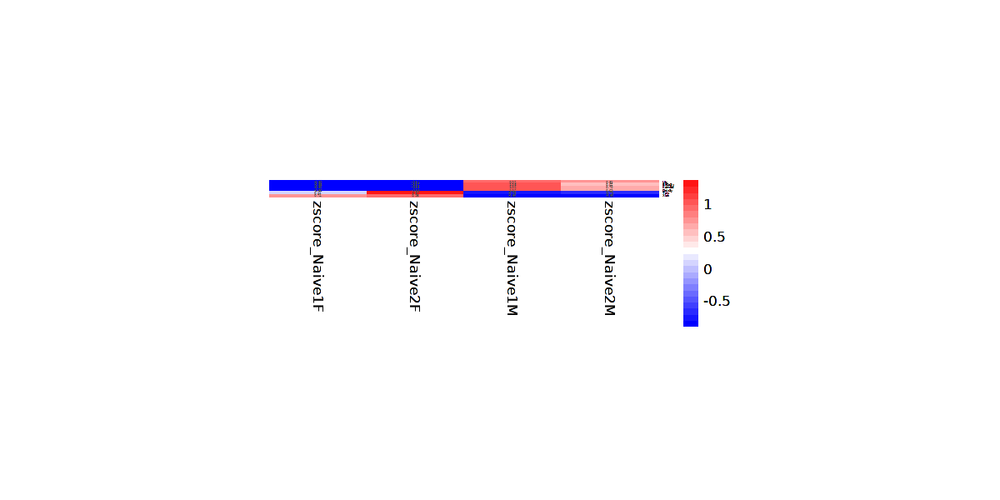

In [256]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [257]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [258]:
gene_list <- HVF

In [259]:
tmp_markers <- data.frame(matrix(ncol=length(names(sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sex_colors)))))

In [260]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = Sex == names(sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [261]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [262]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [263]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

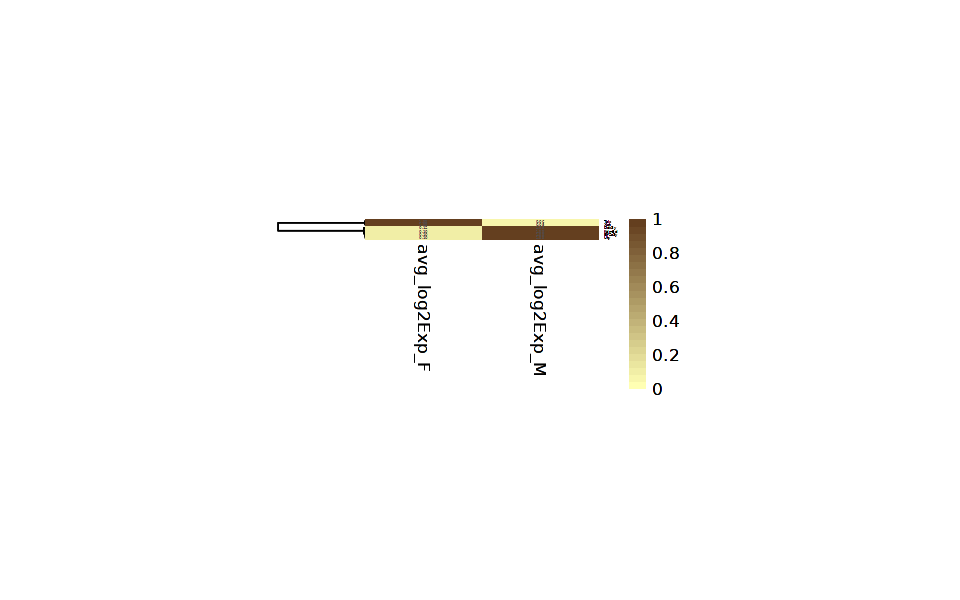

In [264]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [265]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [266]:
gene_list <- gene_list[ph$tree_row$order]

In [267]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [268]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [269]:
matrix <- tmp_markers_mean

In [270]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

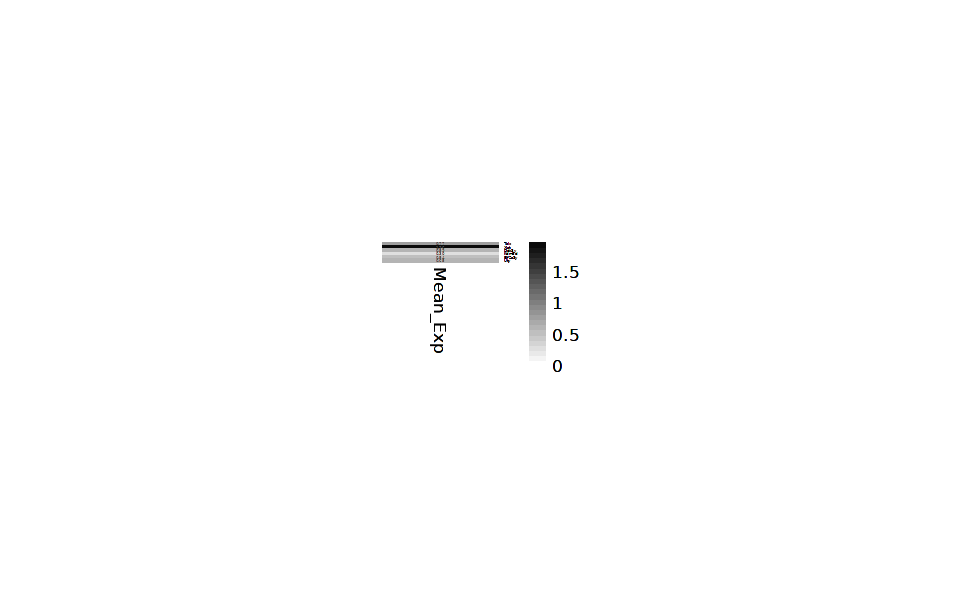

In [271]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [272]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [273]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [274]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

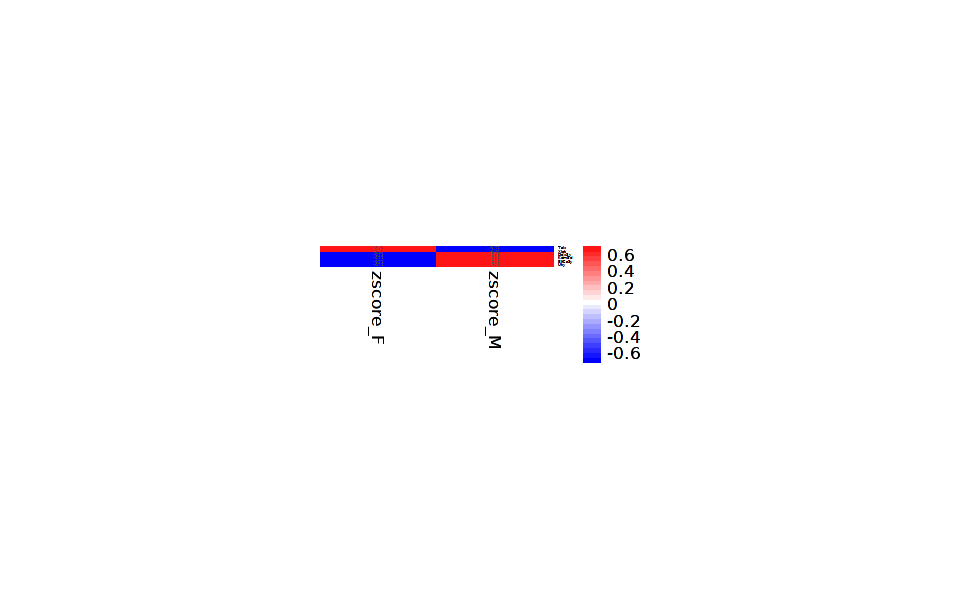

In [275]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [276]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.2 Ctrl

In [277]:
timepoint <- "Ctrl"
name_timepoint <- names_Ctrl

In [278]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


In [279]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [280]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [281]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [282]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [283]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [284]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M LateCtrl2F LateCtrl2M LateCtrl3F
  OPC              0           2           1           0          6         13         21
  COP              0           0           1           1          0          2          3
  MOL             83         245        1597        1536       3266       4131       2630
  Astro           24          37         221         107        609        464       1150
  Epen             2           3          62          41         52         54         97
  Micro           40          27           5           3          7          7         56
  Neuron           0           0          23           7          0          2          2
  Peric            2           1           0           1          1          0          0
        
         LateCtrl3M PeakCtrl2F PeakCtrl2M PeakCtrl3F PeakCtrl3M
  OPC            11          4          6          3          1
  COP             1          1          1   

In [285]:
table(tmp$cellType, tmp$Sex)

        
             F     M
  OPC       35    33
  COP        5     5
  MOL     9207 11582
  Astro   2481  1612
  Epen     242   246
  Micro    134   113
  Neuron    27    11
  Peric      3     5

In [286]:
table(tmp$orig.ident_Sex, tmp$Sex)

             
                 F    M
  EarlyCtrl2F  151    0
  EarlyCtrl2M    0  315
  EarlyCtrl3F 1910    0
  EarlyCtrl3M    0 1696
  LateCtrl2F  3941    0
  LateCtrl2M     0 4673
  LateCtrl3F  3959    0
  LateCtrl3M     0 3616
  PeakCtrl2F  1356    0
  PeakCtrl2M     0 1949
  PeakCtrl3F   817    0
  PeakCtrl3M     0 1358

In [287]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [288]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = TRUE)

In [289]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [290]:
kids <- kids[names(kids)!="Neuron"]

In [291]:
kids
sids

OPC     COP     MOL   Astro    Epen   Micro   Peric 
  "OPC"   "COP"   "MOL" "Astro"  "Epen" "Micro" "Peric"

EarlyCtrl2F   EarlyCtrl2M   EarlyCtrl3F   EarlyCtrl3M    LateCtrl2F    LateCtrl2M    LateCtrl3F 
"EarlyCtrl2F" "EarlyCtrl2M" "EarlyCtrl3F" "EarlyCtrl3M"  "LateCtrl2F"  "LateCtrl2M"  "LateCtrl3F" 
   LateCtrl3M    PeakCtrl2F    PeakCtrl2M    PeakCtrl3F    PeakCtrl3M 
 "LateCtrl3M"  "PeakCtrl2F"  "PeakCtrl2M"  "PeakCtrl3F"  "PeakCtrl3M"

In [292]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M  LateCtrl2F  LateCtrl2M  LateCtrl3F  LateCtrl3M 
        151         315        1910        1696        3941        4673        3959        3616 
 PeakCtrl2F  PeakCtrl2M  PeakCtrl3F  PeakCtrl3M 
       1356        1949         817        1358 

sample_id,group_id,n_cells
<fct>,<fct>,<dbl>
EarlyCtrl2F,F,151
EarlyCtrl2M,M,315
EarlyCtrl3F,F,1910
EarlyCtrl3M,M,1696
LateCtrl2F,F,3941
LateCtrl2M,M,4673
LateCtrl3F,F,3959
LateCtrl3M,M,3616
PeakCtrl2F,F,1356


In [293]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [294]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [295]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [296]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 8
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:141982] 3 4 5 6 7 8 9 11 13 15 ...
  .. ..@ p       : int [1:13] 0 8184 18065 30386 42082 54978 67782 80819 93640 106317 ...
  .. ..@ Dim     : int [1:2] 13284 12
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:13284] "Xkr4" "Gm1992" "Gm19938" "Mrpl15" ...
  .. .. ..$ : chr [1:12] "EarlyCtrl2F" "EarlyCtrl2M" "EarlyCtrl3F" "EarlyCtrl3M" ...
  .. ..@ x       : num [1:141982] 1 1 7 12 2 1 2 8 5 5 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:17806] 10 11 27 63 73 77 93 113 144 154 ...
  .. ..@ p       : int [1:8] 0 760 2986 8282 13319 16244 16895 17806
  .. ..@ Dim     : int [1:2] 13284 7
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:13284] "Xkr4" "Gm1992" "Gm19938" "Mrpl15" ...
  .. .. ..$ : chr [1:7] "EarlyCtrl3F" "EarlyCtrl3M" "LateCtrl2M" "LateCtrl3F" ...
  .. ..@ x       : num [1:17806] 4 1 1 1 2 1 2 1 

In [297]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
             F     M
  OPC       35    33
  COP        5     5
  MOL     9207 11582
  Astro   2481  1612
  Epen     242   246
  Micro    134   113
  Neuron    27    11
  Peric      3     5

In [298]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M LateCtrl2F LateCtrl2M LateCtrl3F
  OPC              0           2           1           0          6         13         21
  COP              0           0           1           1          0          2          3
  MOL             83         245        1597        1536       3266       4131       2630
  Astro           24          37         221         107        609        464       1150
  Epen             2           3          62          41         52         54         97
  Micro           40          27           5           3          7          7         56
  Neuron           0           0          23           7          0          2          2
  Peric            2           1           0           1          1          0          0
        
         LateCtrl3M PeakCtrl2F PeakCtrl2M PeakCtrl3F PeakCtrl3M
  OPC            11          4          6          3          1
  COP             1          1          1   

In [299]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [300]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [301]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id) 

Joining with `by = join_by(sample_id)`


In [302]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [303]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [304]:
HVGs.list <- list()

##### 3.2.2.1 MOL

In [305]:
cluster_choice <- "MOL"

In [306]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [307]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [308]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [309]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [310]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
EarlyCtrl2F,MOL,EarlyCtrl2F,F
EarlyCtrl2M,MOL,EarlyCtrl2M,M
EarlyCtrl3F,MOL,EarlyCtrl3F,F
EarlyCtrl3M,MOL,EarlyCtrl3M,M
LateCtrl2F,MOL,LateCtrl2F,F
LateCtrl2M,MOL,LateCtrl2M,M
LateCtrl3F,MOL,LateCtrl3F,F
LateCtrl3M,MOL,LateCtrl3M,M
PeakCtrl2F,MOL,PeakCtrl2F,F


In [311]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [312]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [313]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

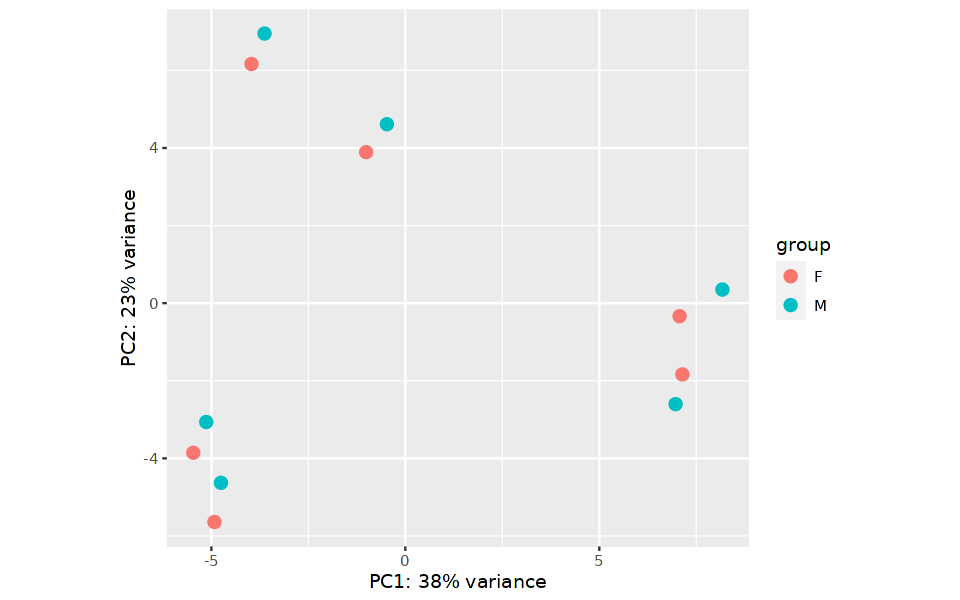

In [314]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [315]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

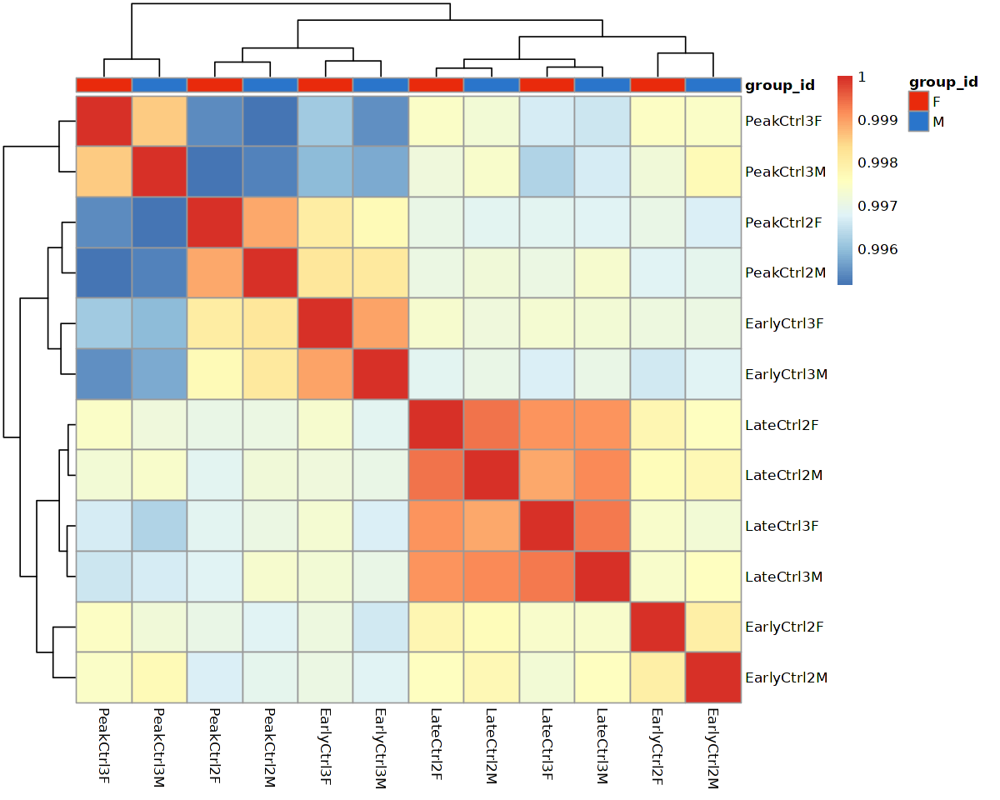

In [316]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [317]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [318]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


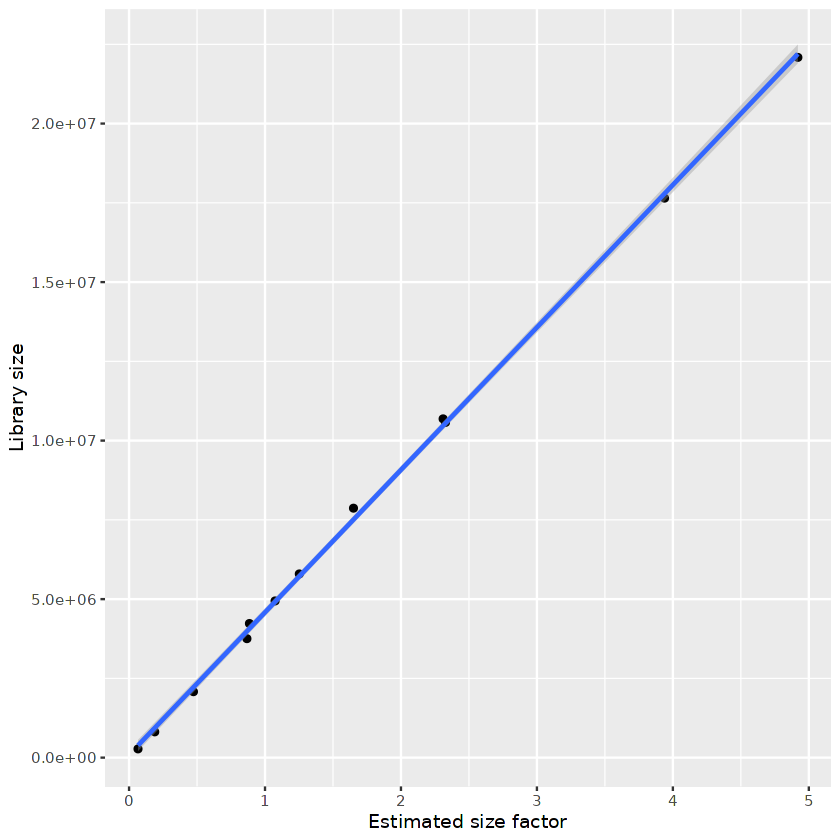

In [319]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [320]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
EarlyCtrl2F,MOL,EarlyCtrl2F,F,0.0658405
EarlyCtrl2M,MOL,EarlyCtrl2M,M,0.1888894
EarlyCtrl3F,MOL,EarlyCtrl3F,F,1.0740499
EarlyCtrl3M,MOL,EarlyCtrl3M,M,1.2522076
LateCtrl2F,MOL,LateCtrl2F,F,3.9388385
LateCtrl2M,MOL,LateCtrl2M,M,4.9194535
LateCtrl3F,MOL,LateCtrl3F,F,2.3099747
LateCtrl3M,MOL,LateCtrl3M,M,2.3277870
PeakCtrl2F,MOL,PeakCtrl2F,F,0.8854044


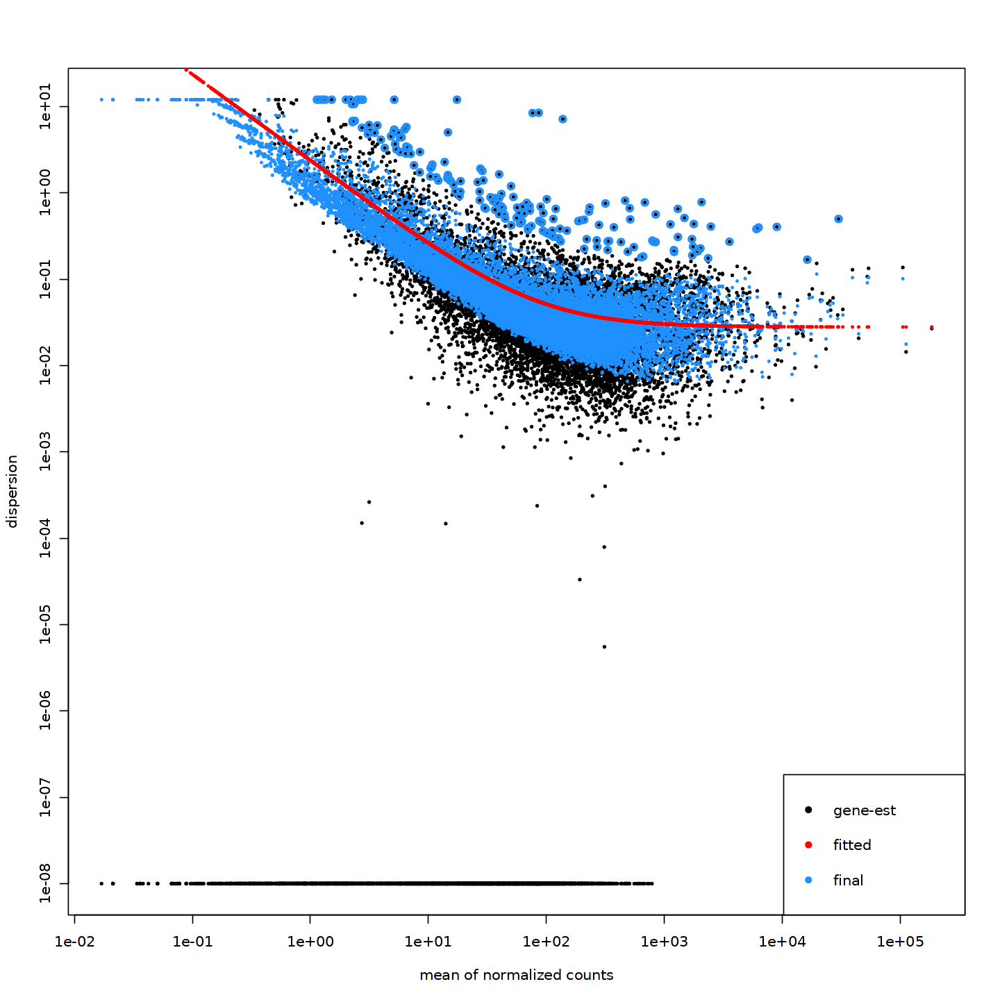

In [321]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [322]:
condition1 = "M"
condition2 = "F"

In [323]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [324]:
summary(res)


out of 13272 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.03%
LFC < 0 (down)     : 3, 0.023%
outliers [1]       : 22, 0.17%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



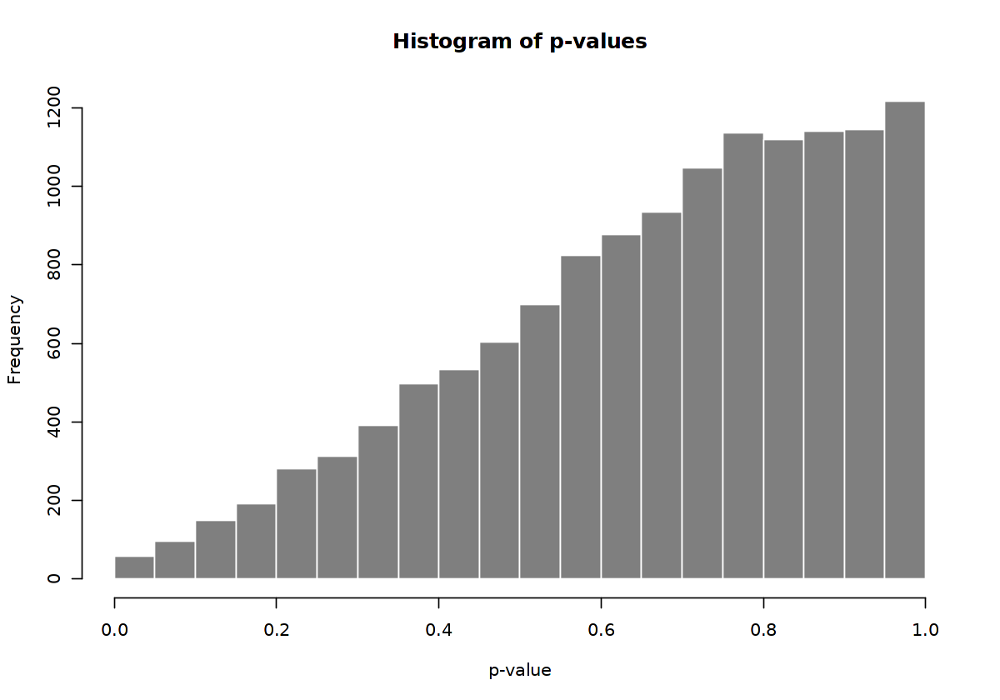

In [325]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

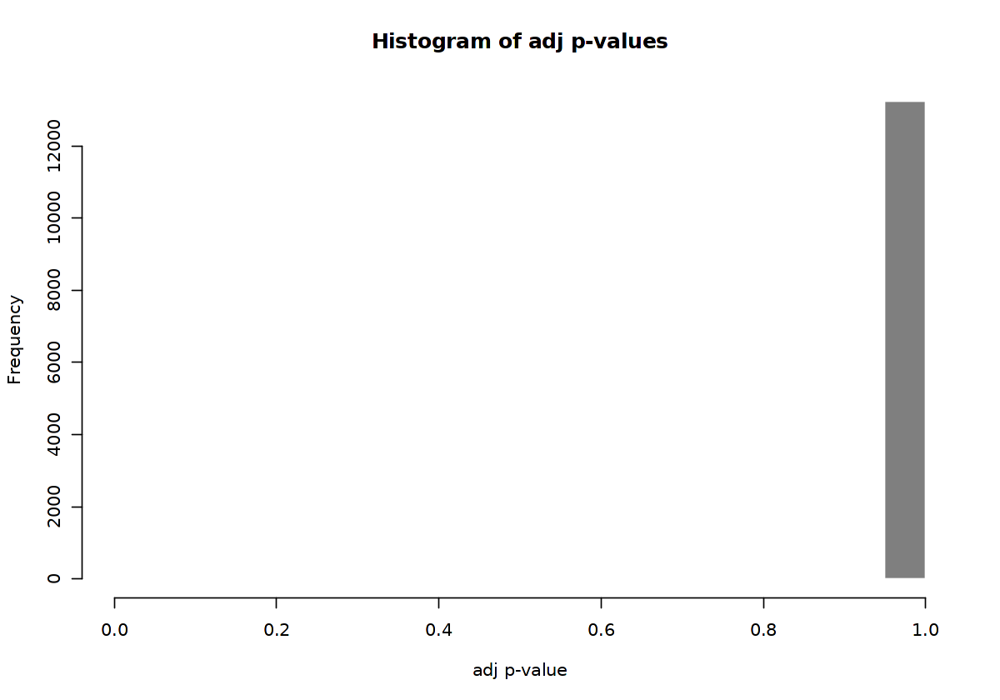

In [326]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

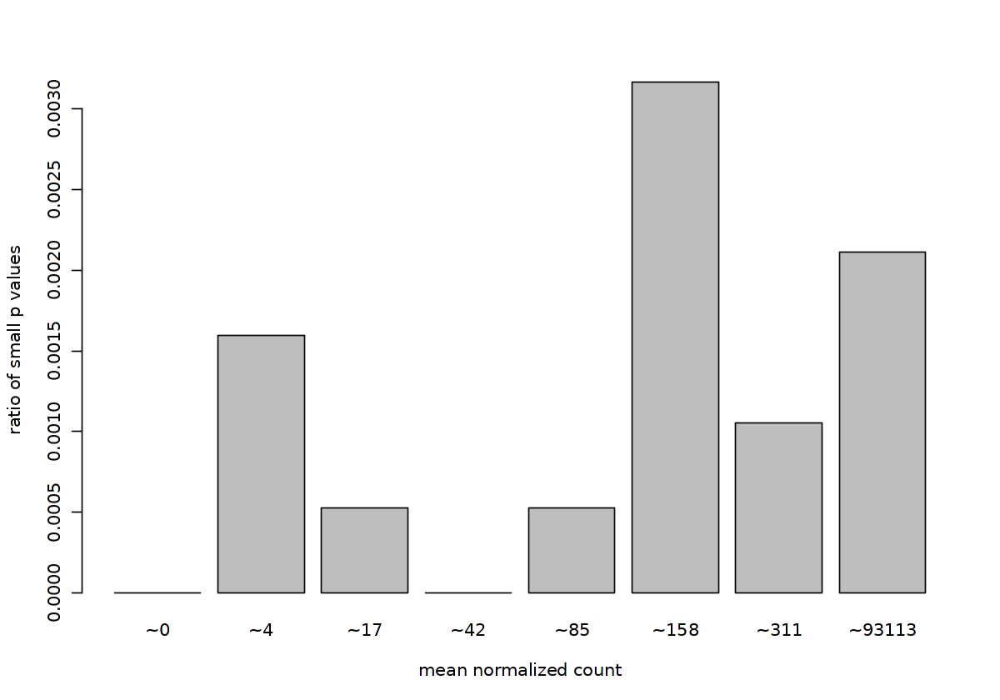

In [327]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

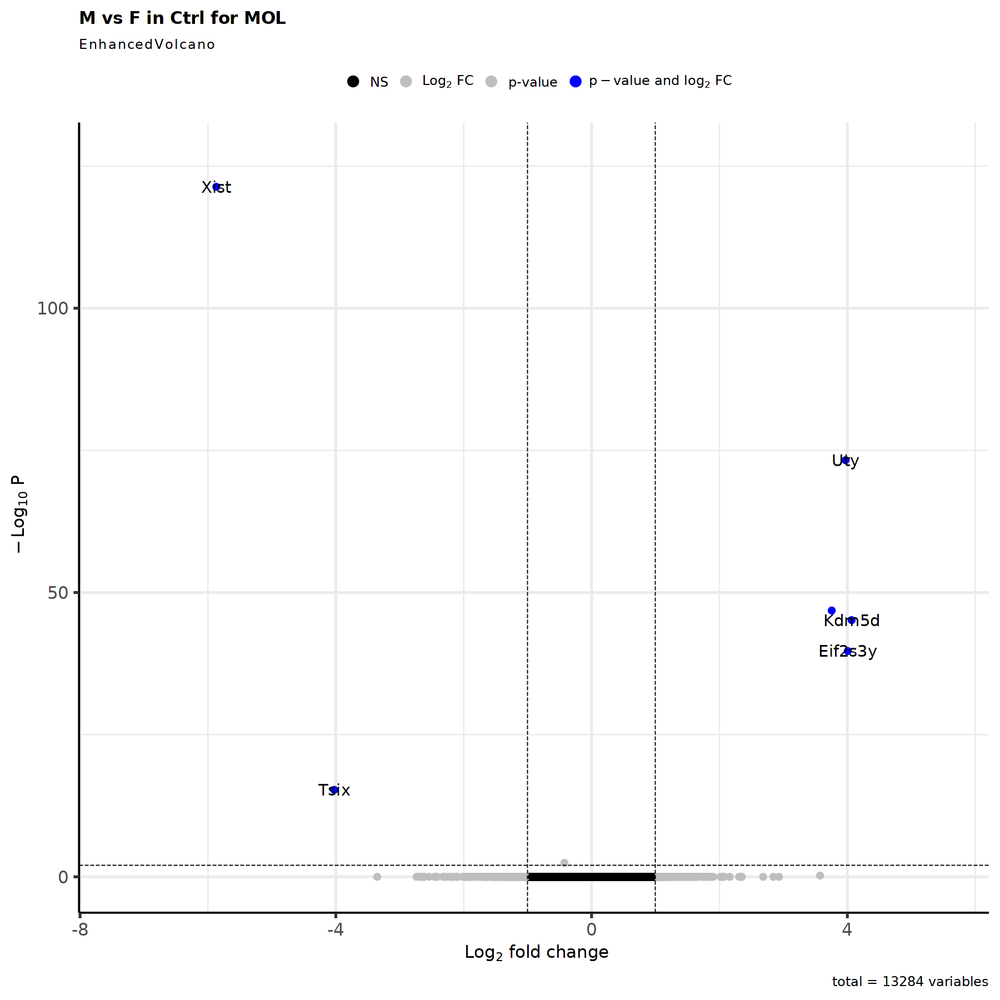

In [328]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [329]:
res <- res[complete.cases(res$padj),]

In [330]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [331]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat       pvalue         padj
        <numeric>      <numeric> <numeric> <numeric>    <numeric>    <numeric>
Xist    2695.2329       -5.86876  0.245597 -23.89587 3.38143e-126 4.48039e-122
Kdm5d     81.1136        4.06739  0.275321  14.77328  2.17834e-49  7.21576e-46
Tsix     794.0043       -4.02457  0.447320  -8.99708  2.31805e-19  5.11904e-16
Eif2s3y  179.4383        4.00692  0.288524  13.88763  7.52826e-44  1.99499e-40
Uty      249.1144        3.97285  0.212752  18.67362  8.11633e-78  5.37707e-74
Ddx3y    184.4980        3.75588  0.249521  15.05234  3.33215e-51  1.47170e-47

In [332]:
nrow(res_filtered)

[1] 6

In [333]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [334]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [335]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [336]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


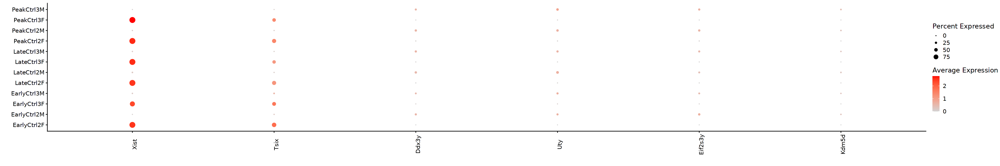

In [337]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

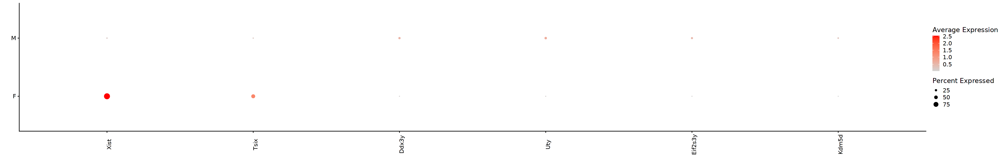

In [338]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [339]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.2 OPC

In [340]:
cluster_choice <- "OPC"

In [341]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

EarlyCtrl2F EarlyCtrl2M EarlyCtrl3F EarlyCtrl3M  PeakCtrl2F  PeakCtrl3F  PeakCtrl3M 
          0           2           1           0           4           3           1

In [342]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [343]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [344]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [345]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
LateCtrl2F,OPC,LateCtrl2F,F
LateCtrl2M,OPC,LateCtrl2M,M
LateCtrl3F,OPC,LateCtrl3F,F
LateCtrl3M,OPC,LateCtrl3M,M
PeakCtrl2M,OPC,PeakCtrl2M,M


In [346]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [347]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [348]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

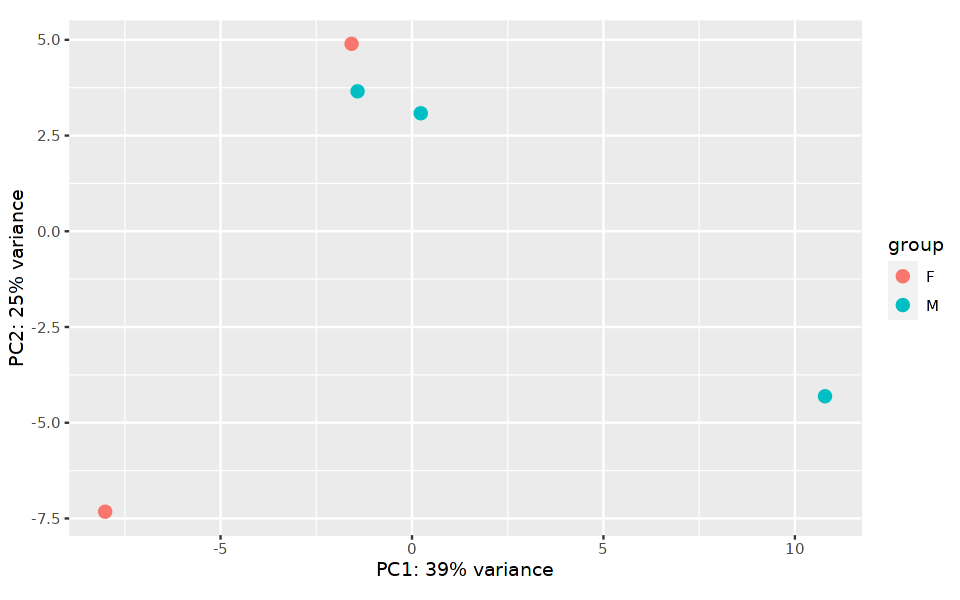

In [349]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [350]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

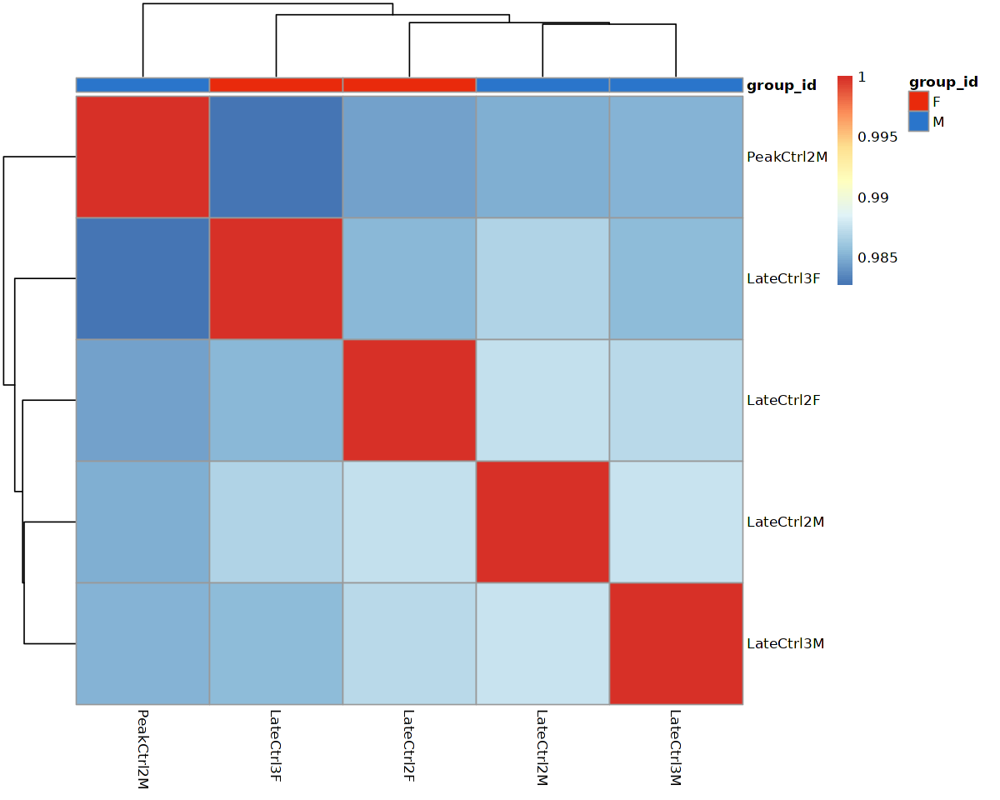

In [351]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [352]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing



In [353]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


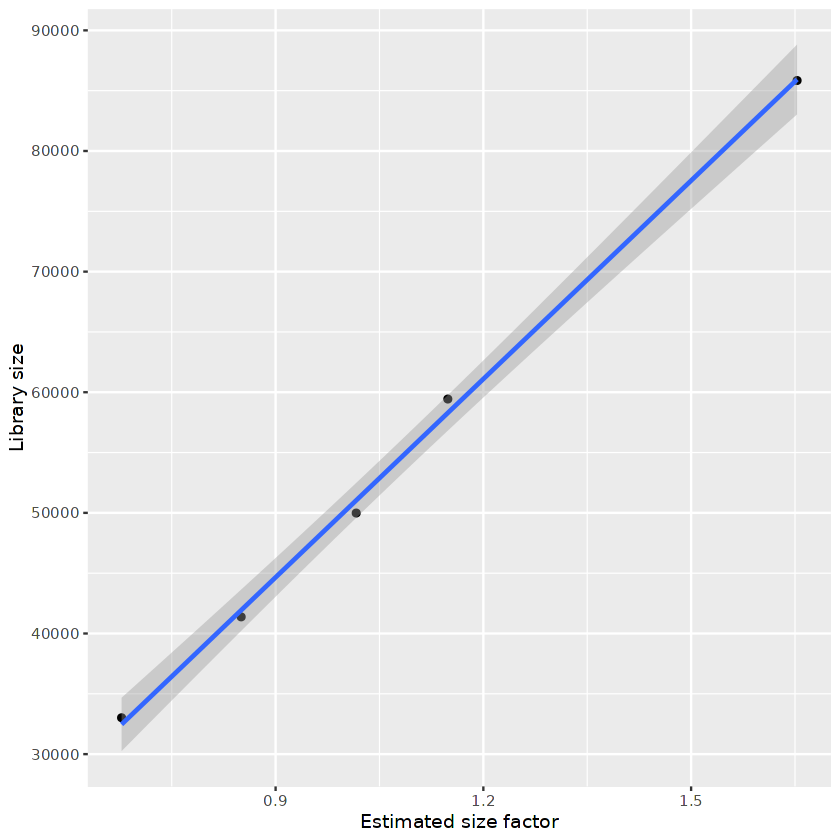

In [354]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [355]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
LateCtrl2F,OPC,LateCtrl2F,F,1.0163970
LateCtrl2M,OPC,LateCtrl2M,M,1.6530392
LateCtrl3F,OPC,LateCtrl3F,F,1.1486984
LateCtrl3M,OPC,LateCtrl3M,M,0.8502830
PeakCtrl2M,OPC,PeakCtrl2M,M,0.6776109


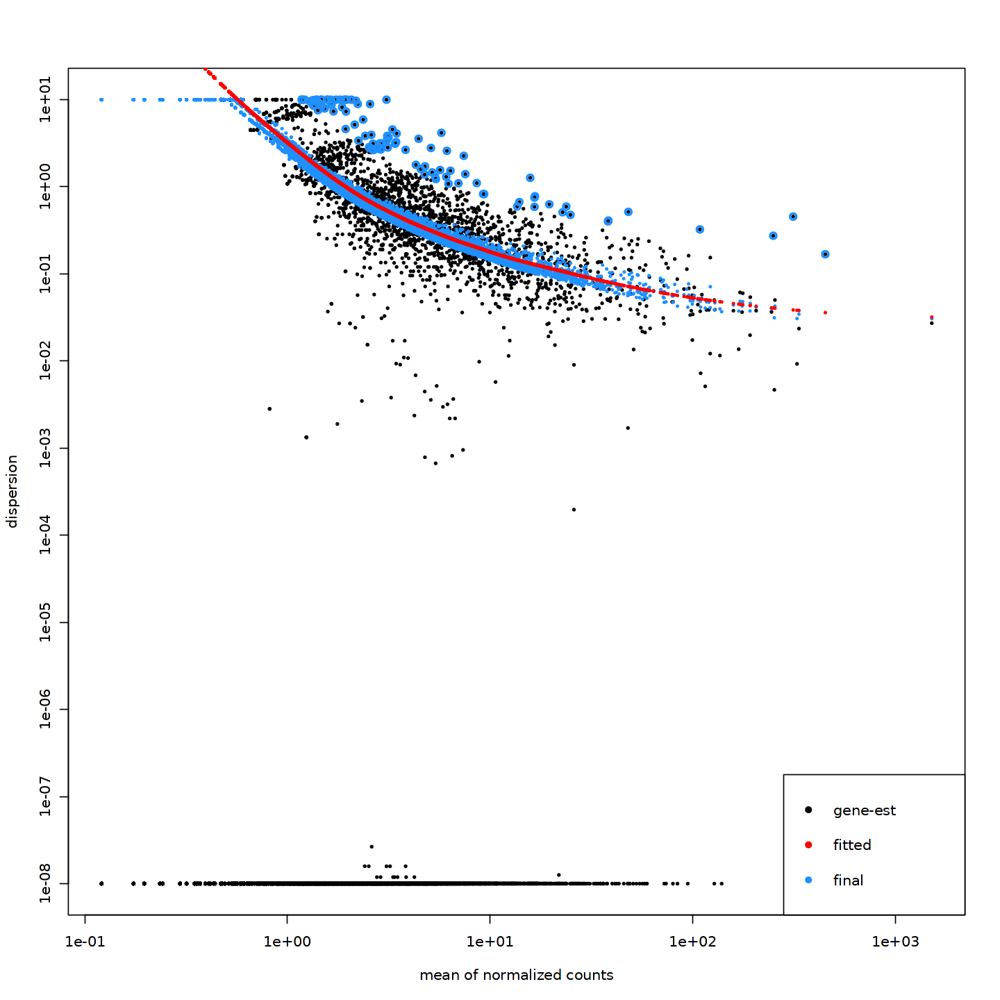

In [356]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [357]:
condition1 = "M"
condition2 = "F"

In [358]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [359]:
summary(res)


out of 11670 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.0086%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



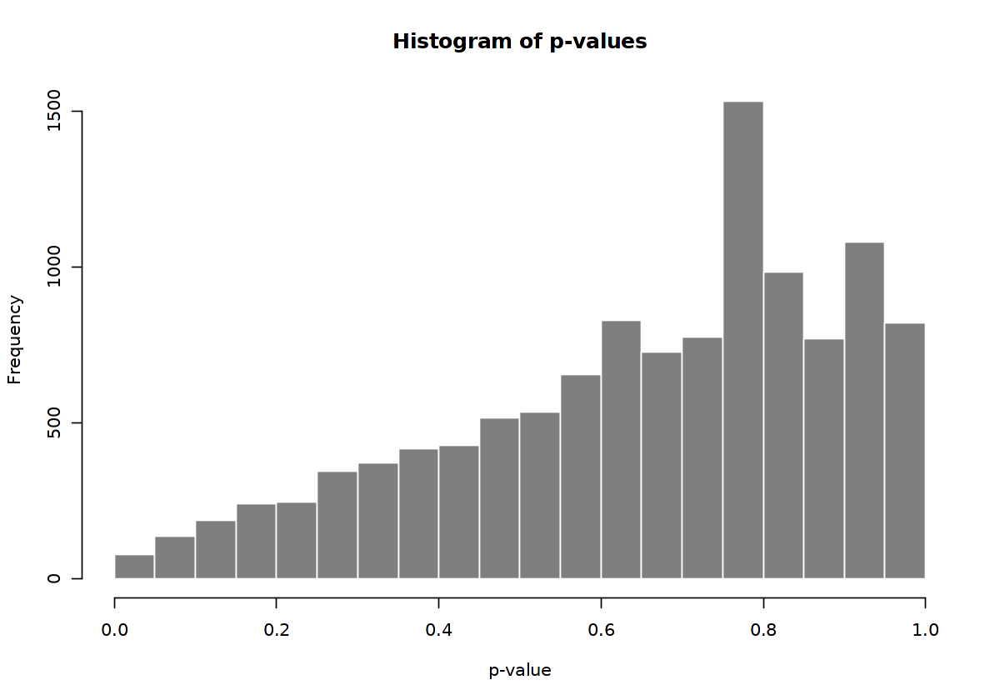

In [360]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

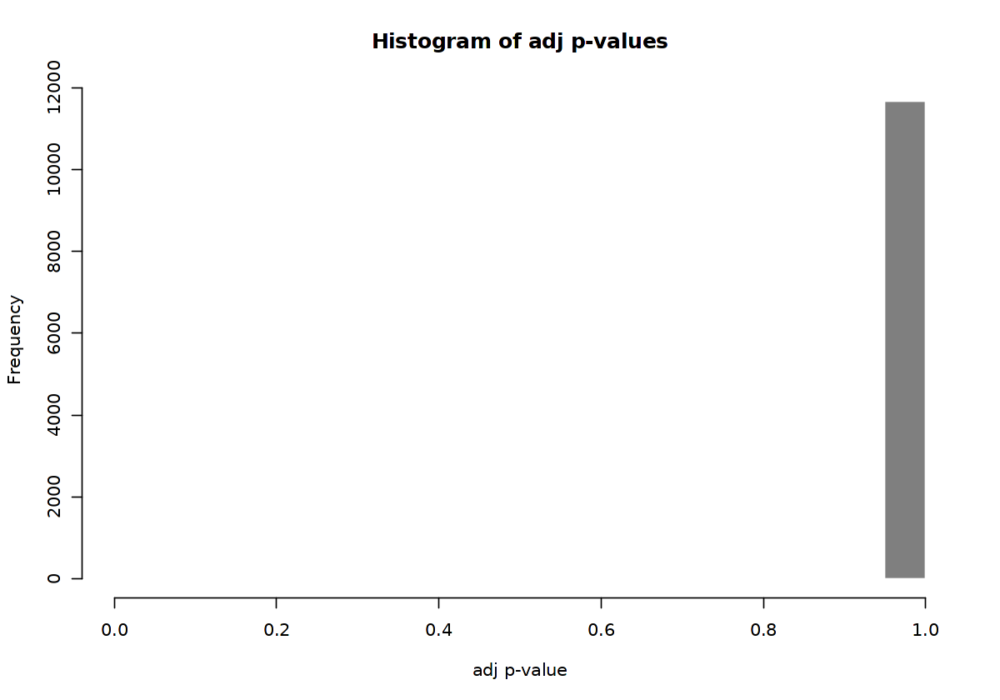

In [361]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

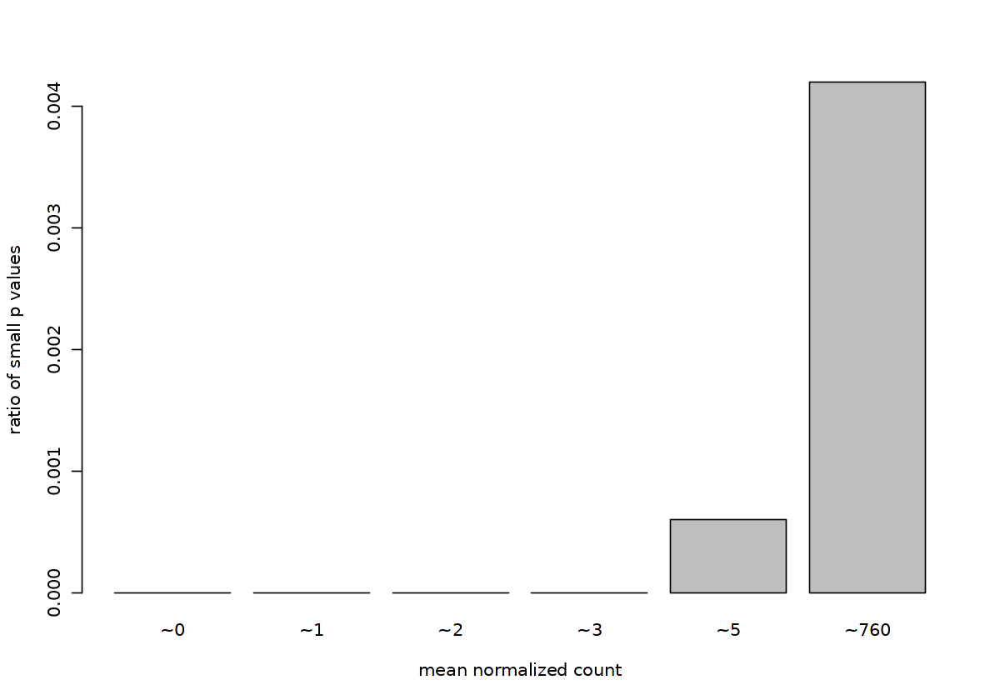

In [362]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

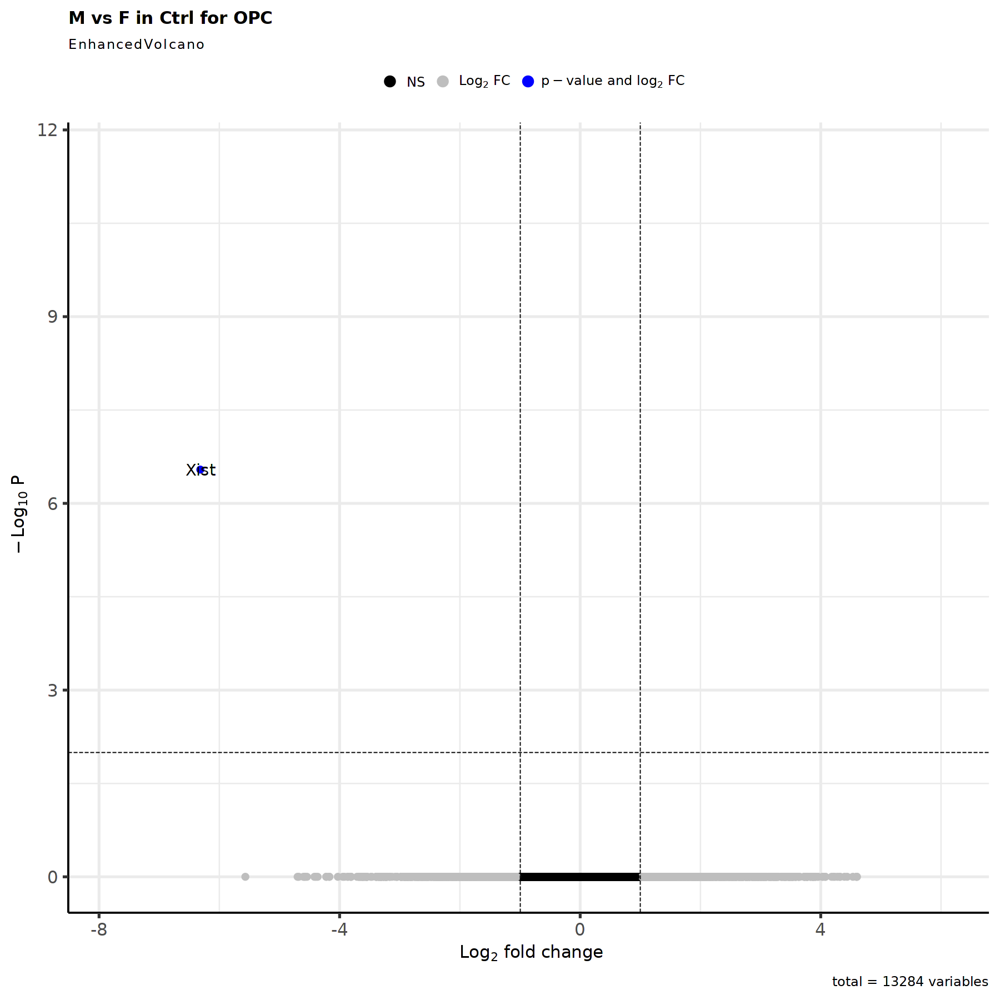

In [363]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [364]:
res <- res[complete.cases(res$padj),]

In [365]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [366]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   29.4289       -6.31597  0.946089  -6.67588 2.45752e-11 2.86793e-07

In [367]:
nrow(res_filtered)

[1] 1

In [368]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [369]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [370]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [371]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


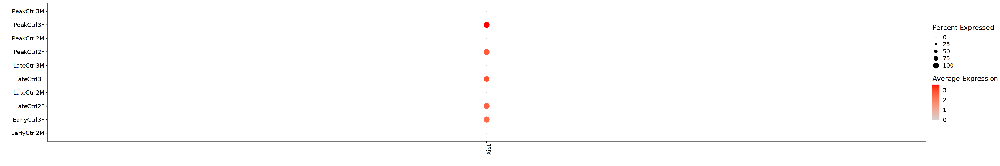

In [372]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

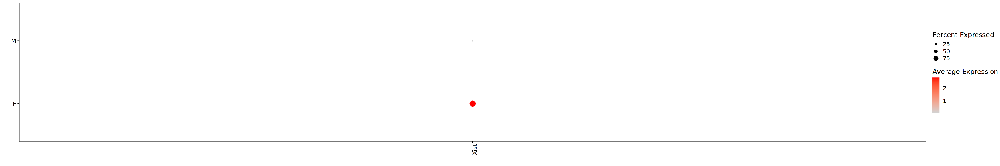

In [373]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [374]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.3 Micro

In [375]:
cluster_choice <- "Micro"

In [376]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

EarlyCtrl3F EarlyCtrl3M  PeakCtrl2F  PeakCtrl2M 
          5           3           3           3

In [377]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [378]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [379]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [380]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
EarlyCtrl2F,Micro,EarlyCtrl2F,F
EarlyCtrl2M,Micro,EarlyCtrl2M,M
LateCtrl2F,Micro,LateCtrl2F,F
LateCtrl2M,Micro,LateCtrl2M,M
LateCtrl3F,Micro,LateCtrl3F,F
LateCtrl3M,Micro,LateCtrl3M,M
PeakCtrl3F,Micro,PeakCtrl3F,F
PeakCtrl3M,Micro,PeakCtrl3M,M


In [381]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [382]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [383]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

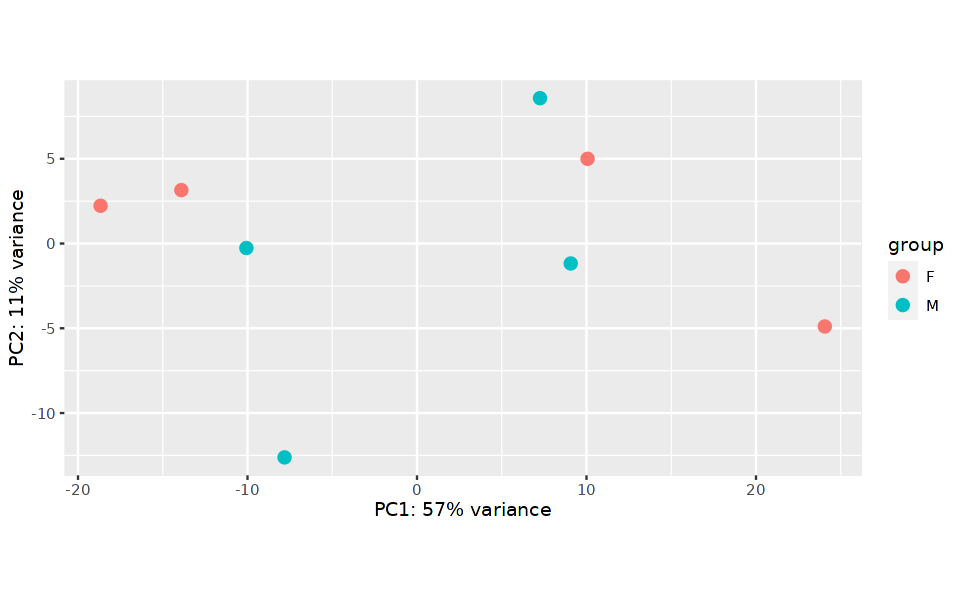

In [384]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [385]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

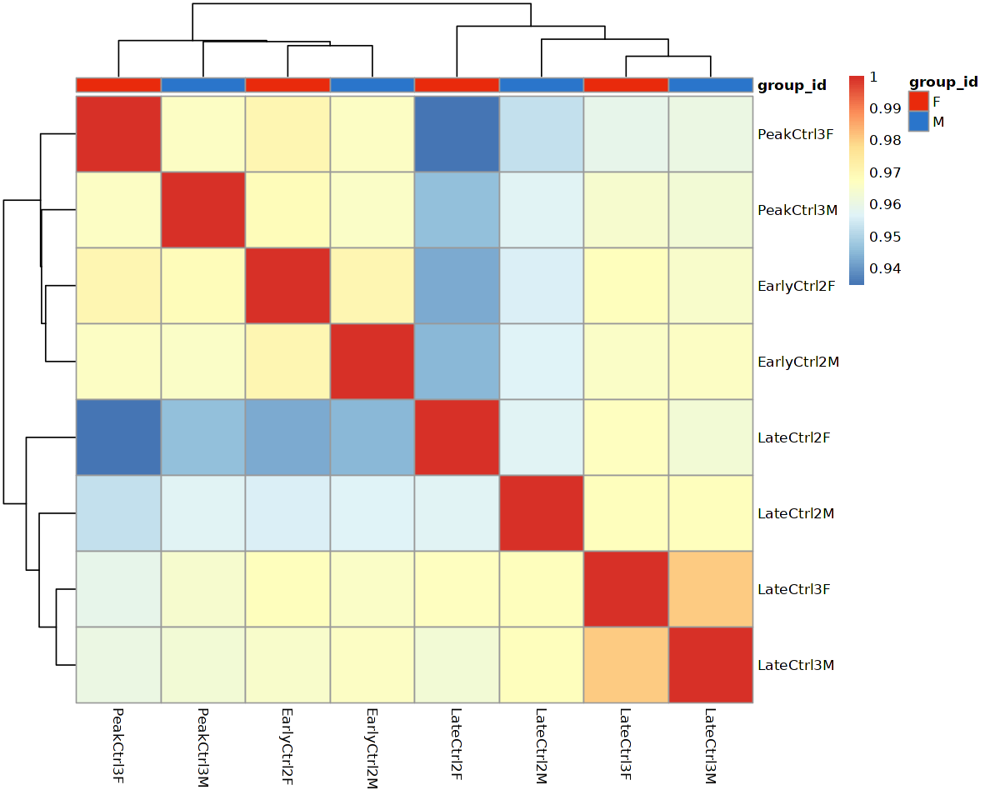

In [386]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [387]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [388]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


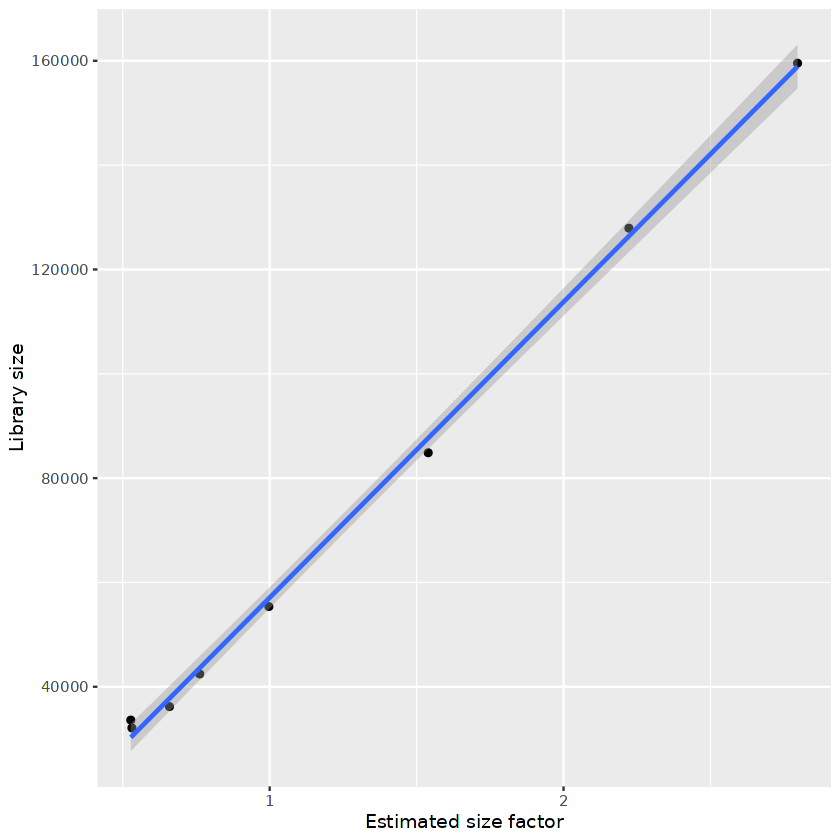

In [389]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [390]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
EarlyCtrl2F,Micro,EarlyCtrl2F,F,1.5394776
EarlyCtrl2M,Micro,EarlyCtrl2M,M,0.9972716
LateCtrl2F,Micro,LateCtrl2F,F,0.5273965
LateCtrl2M,Micro,LateCtrl2M,M,0.5312588
LateCtrl3F,Micro,LateCtrl3F,F,2.7962188
LateCtrl3M,Micro,LateCtrl3M,M,2.2224455
PeakCtrl3F,Micro,PeakCtrl3F,F,0.6589666
PeakCtrl3M,Micro,PeakCtrl3M,M,0.7617936


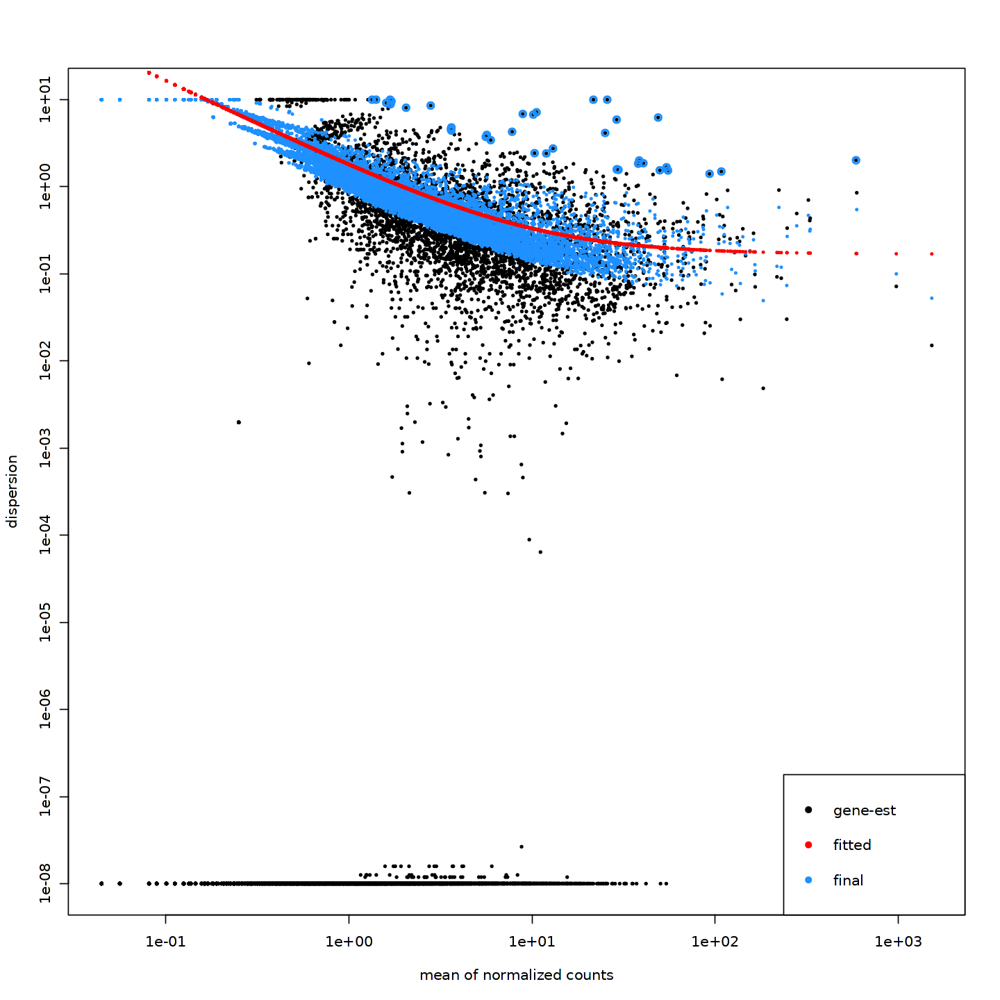

In [391]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [392]:
condition1 = "M"
condition2 = "F"

In [393]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [394]:
summary(res)


out of 12073 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 2, 0.017%
outliers [1]       : 2, 0.017%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



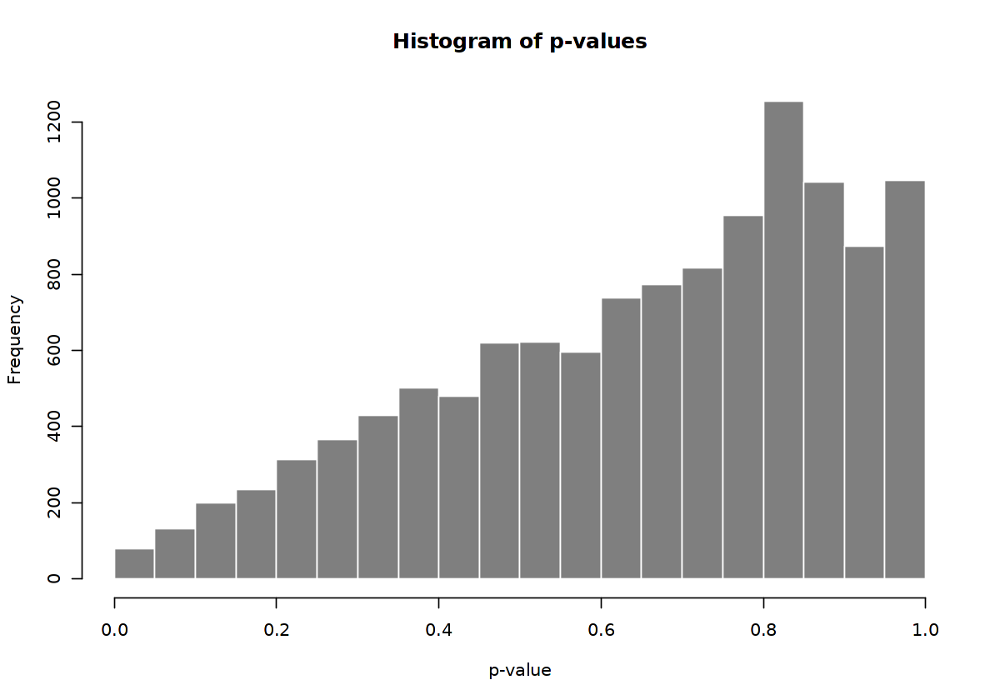

In [395]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

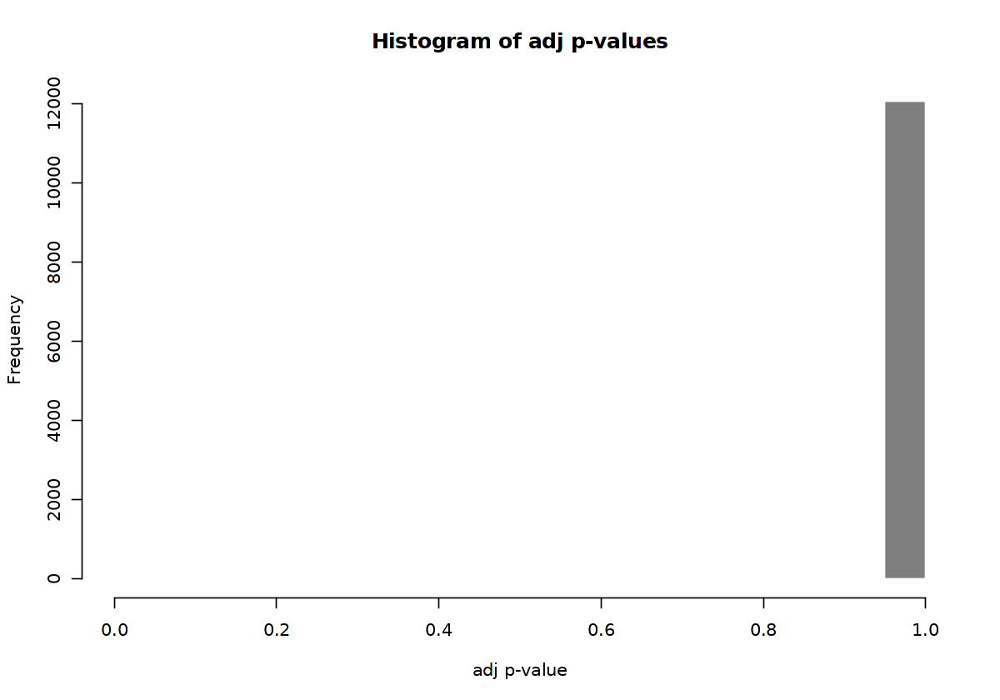

In [396]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

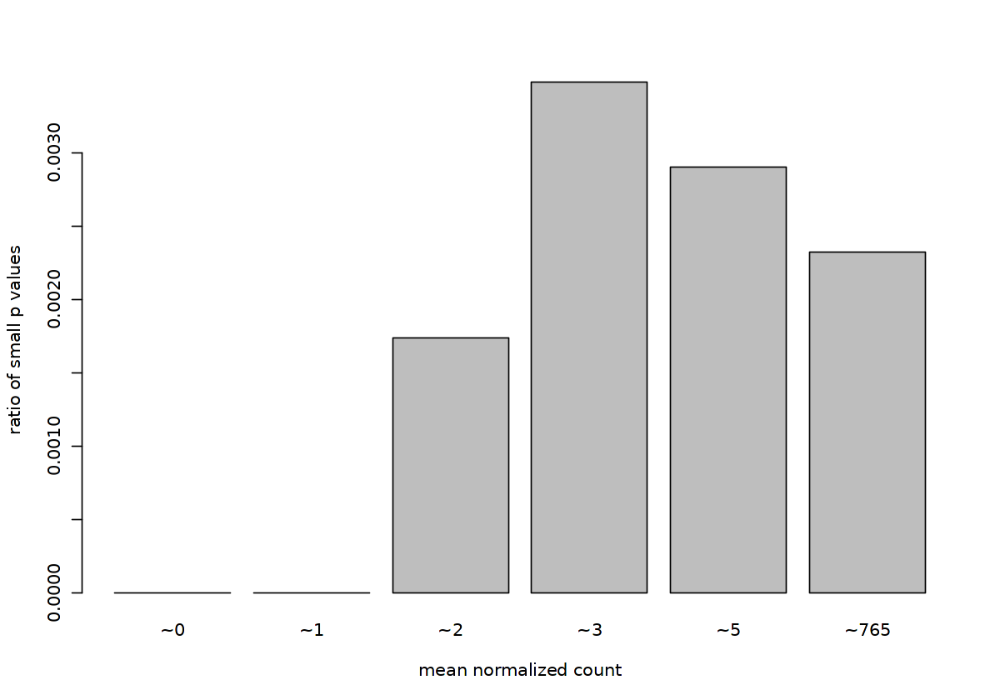

In [397]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

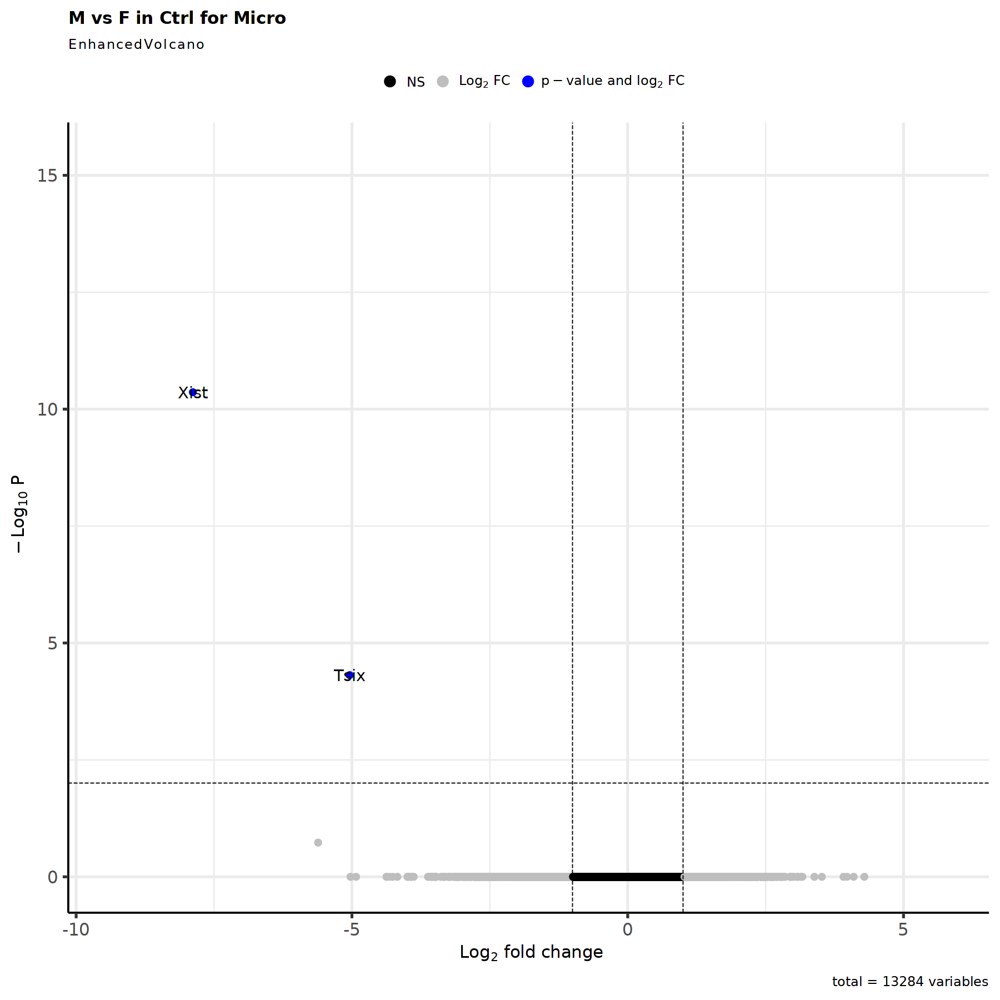

In [398]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [399]:
res <- res[complete.cases(res$padj),]

In [400]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [401]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 2 rows and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   54.1084       -7.88389  1.002020  -7.86799 3.60374e-15 4.35008e-11
Tsix   18.4251       -5.04072  0.874067  -5.76697 8.07085e-09 4.87116e-05

In [402]:
nrow(res_filtered)

[1] 2

In [403]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [404]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [405]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [406]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


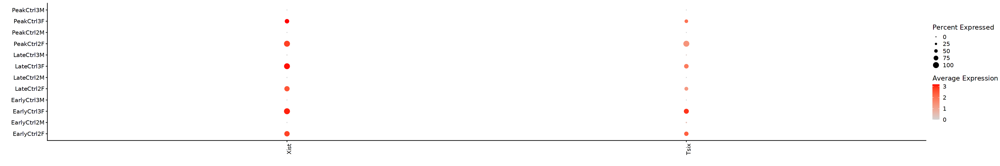

In [407]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

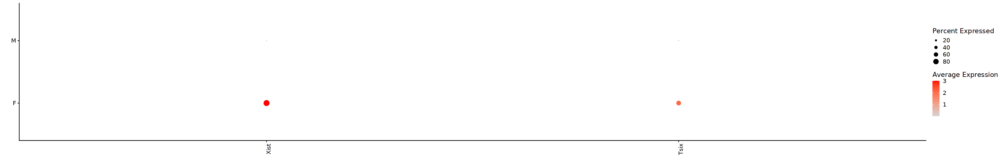

In [408]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [409]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.4 Astro

In [410]:
cluster_choice <- "Astro"

In [411]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [412]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [413]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [414]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [415]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
EarlyCtrl2F,Astro,EarlyCtrl2F,F
EarlyCtrl2M,Astro,EarlyCtrl2M,M
EarlyCtrl3F,Astro,EarlyCtrl3F,F
EarlyCtrl3M,Astro,EarlyCtrl3M,M
LateCtrl2F,Astro,LateCtrl2F,F
LateCtrl2M,Astro,LateCtrl2M,M
LateCtrl3F,Astro,LateCtrl3F,F
LateCtrl3M,Astro,LateCtrl3M,M
PeakCtrl2F,Astro,PeakCtrl2F,F


In [416]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [417]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [418]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

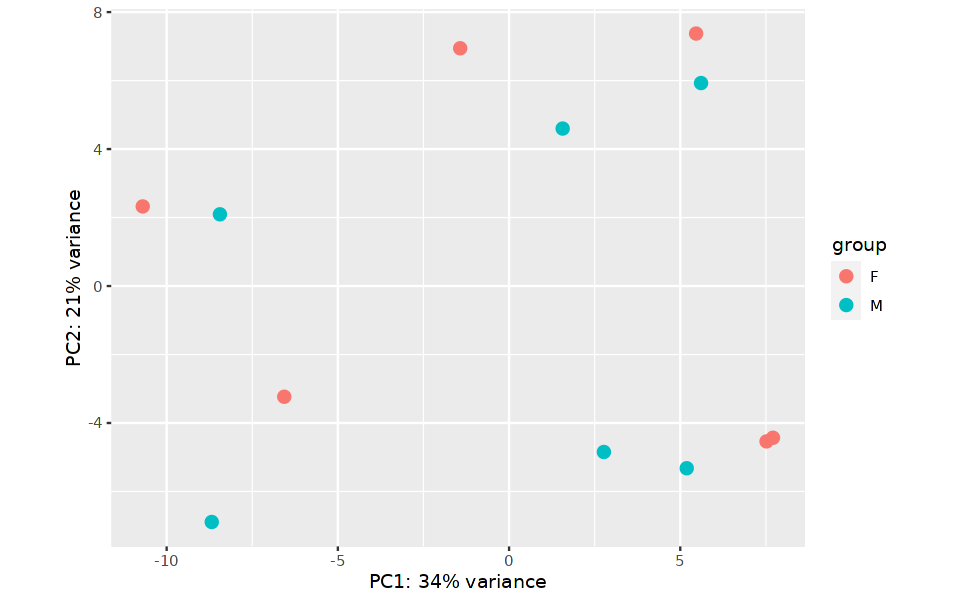

In [419]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [420]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

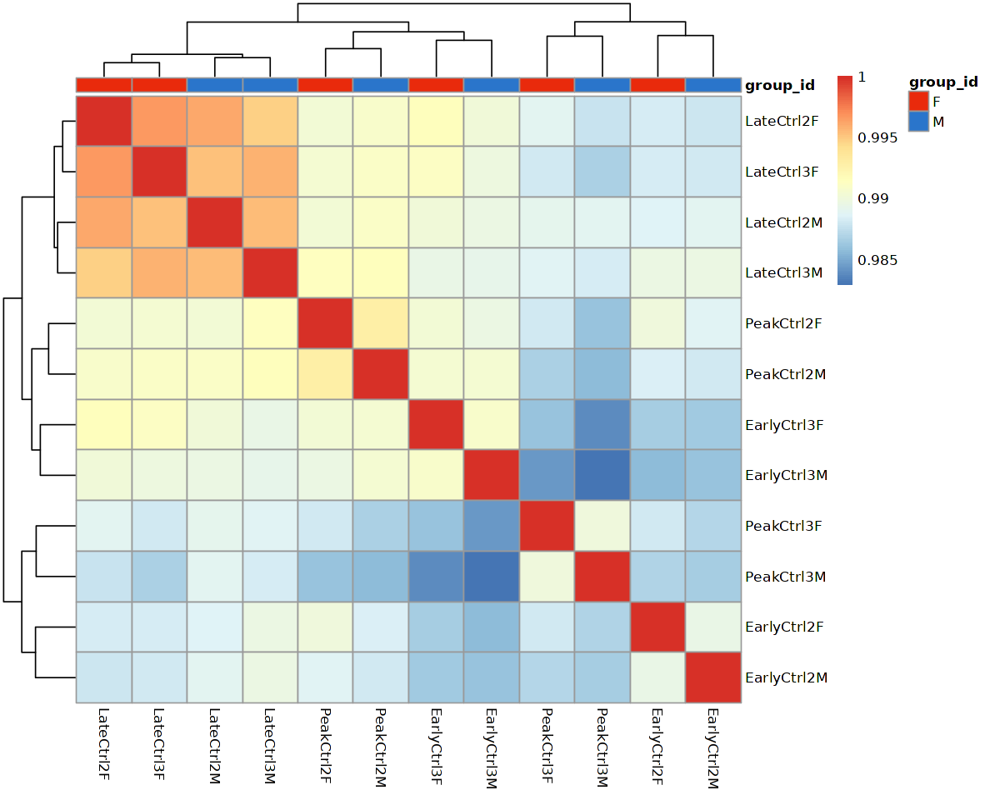

In [421]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [422]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [423]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


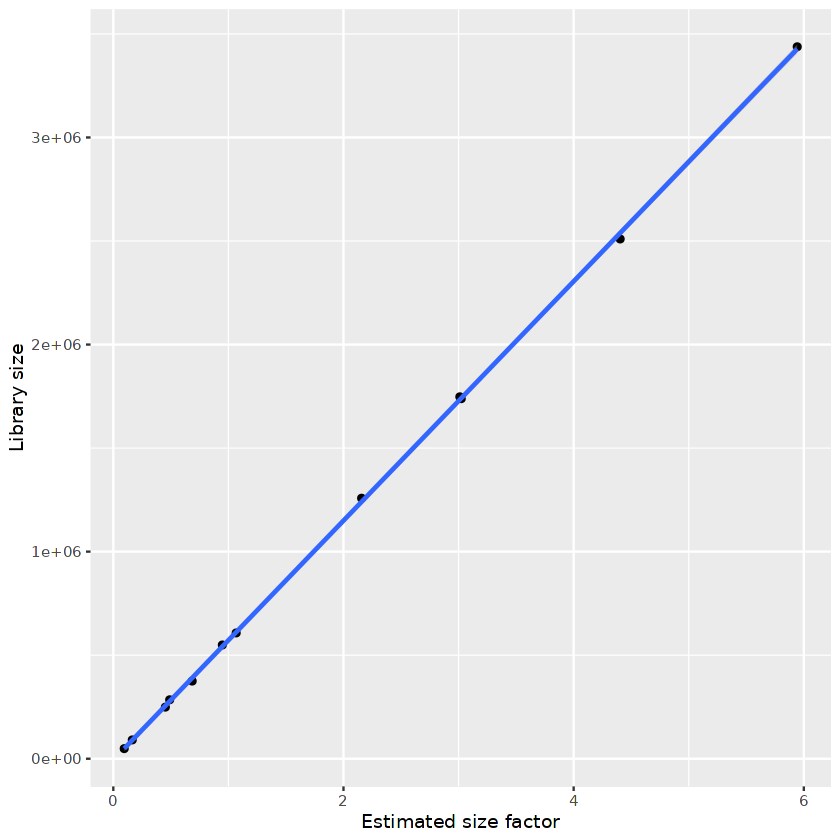

In [424]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [425]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
EarlyCtrl2F,Astro,EarlyCtrl2F,F,0.09469246
EarlyCtrl2M,Astro,EarlyCtrl2M,M,0.16468712
EarlyCtrl3F,Astro,EarlyCtrl3F,F,0.94731403
EarlyCtrl3M,Astro,EarlyCtrl3M,M,0.48970406
LateCtrl2F,Astro,LateCtrl2F,F,4.40414386
LateCtrl2M,Astro,LateCtrl2M,M,3.01097794
LateCtrl3F,Astro,LateCtrl3F,F,5.94262828
LateCtrl3M,Astro,LateCtrl3M,M,3.02325562
PeakCtrl2F,Astro,PeakCtrl2F,F,2.15745007


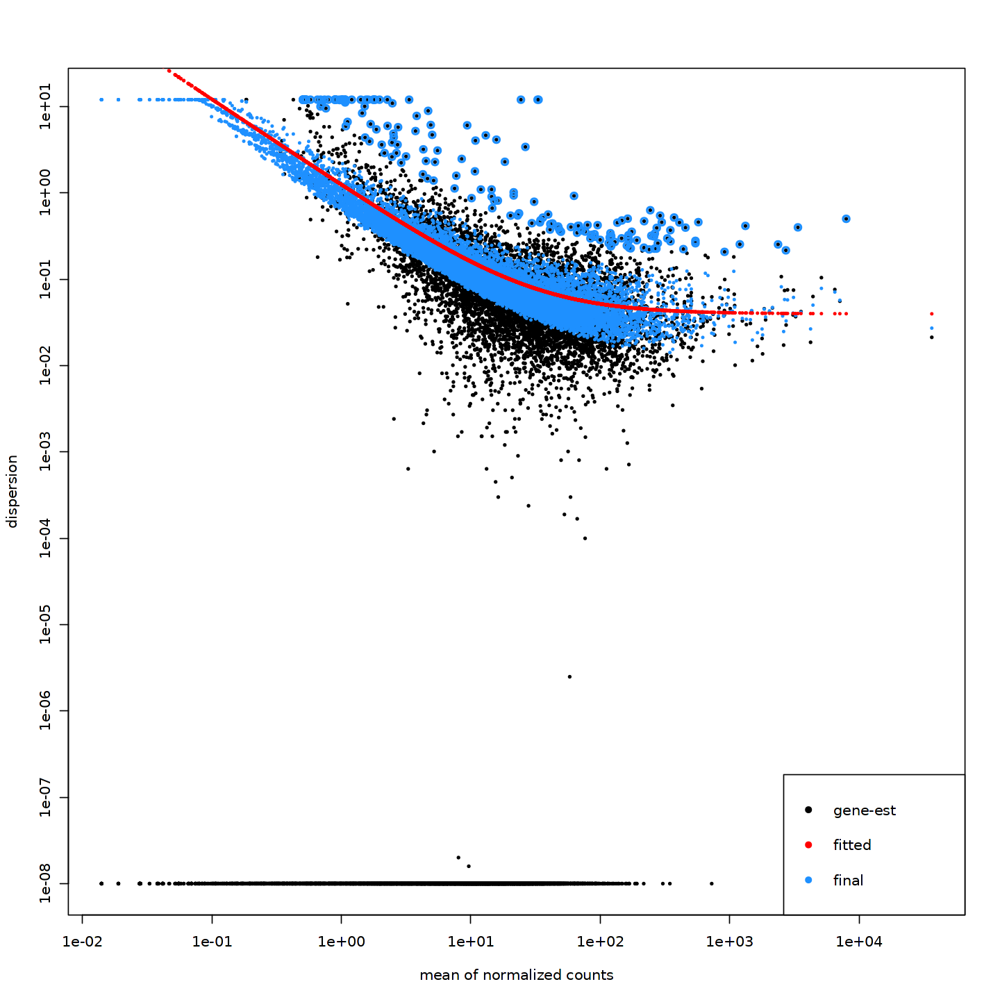

In [426]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [427]:
condition1 = "M"
condition2 = "F"

In [428]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [429]:
summary(res)


out of 13237 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 4, 0.03%
LFC < 0 (down)     : 2, 0.015%
outliers [1]       : 5, 0.038%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



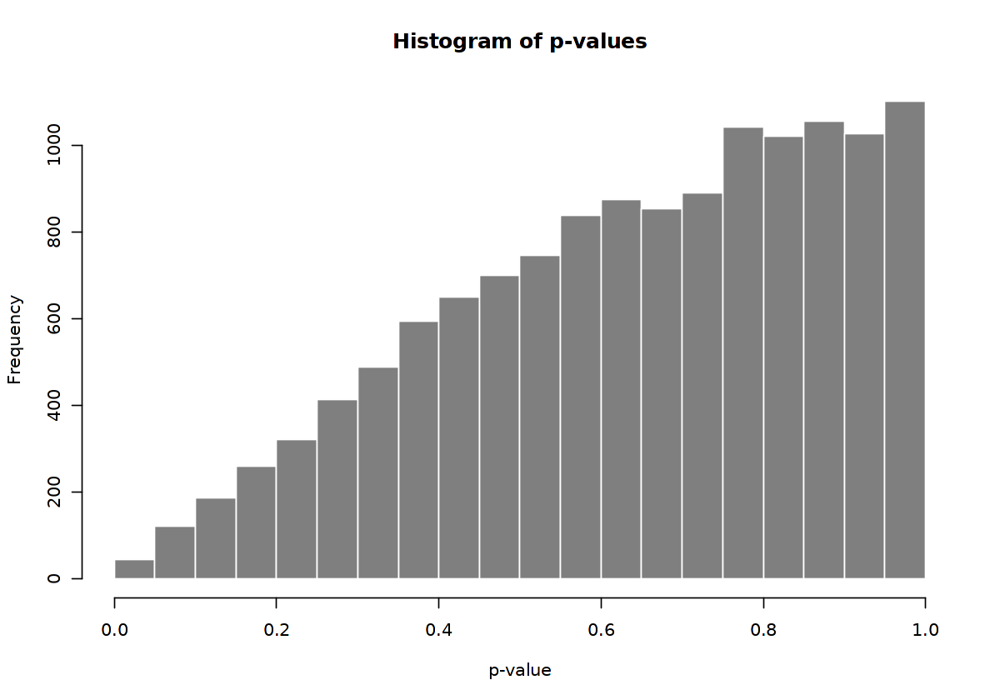

In [430]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

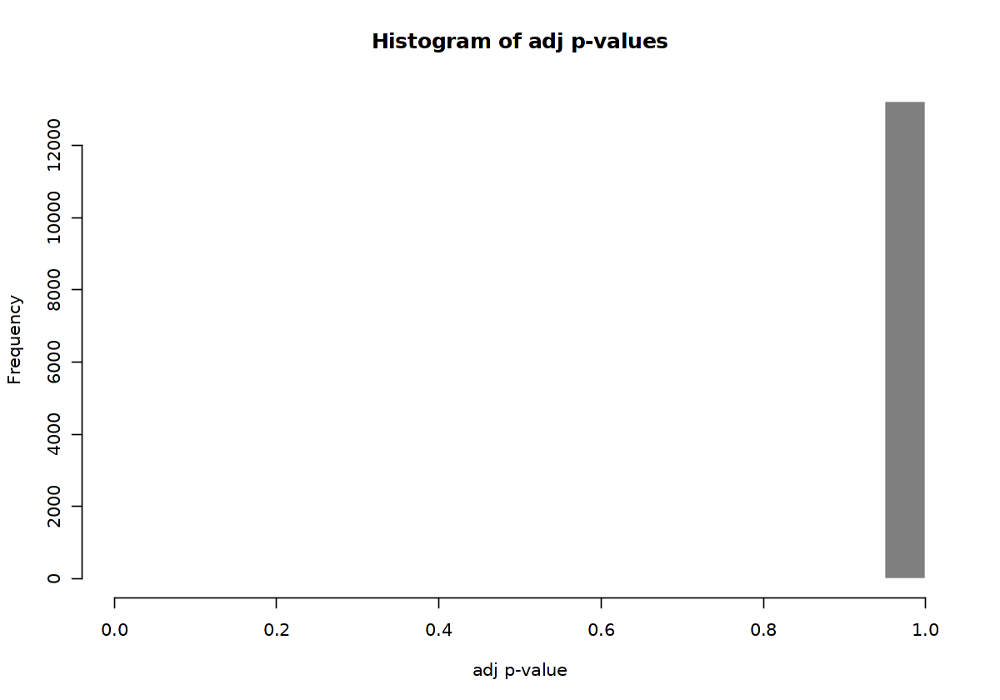

In [431]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

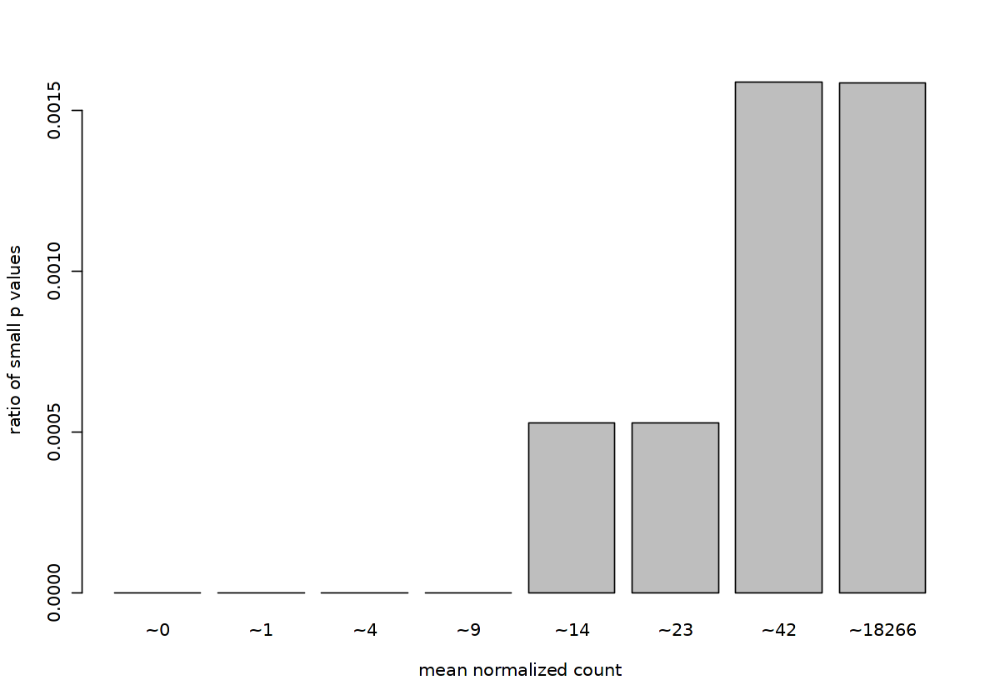

In [432]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

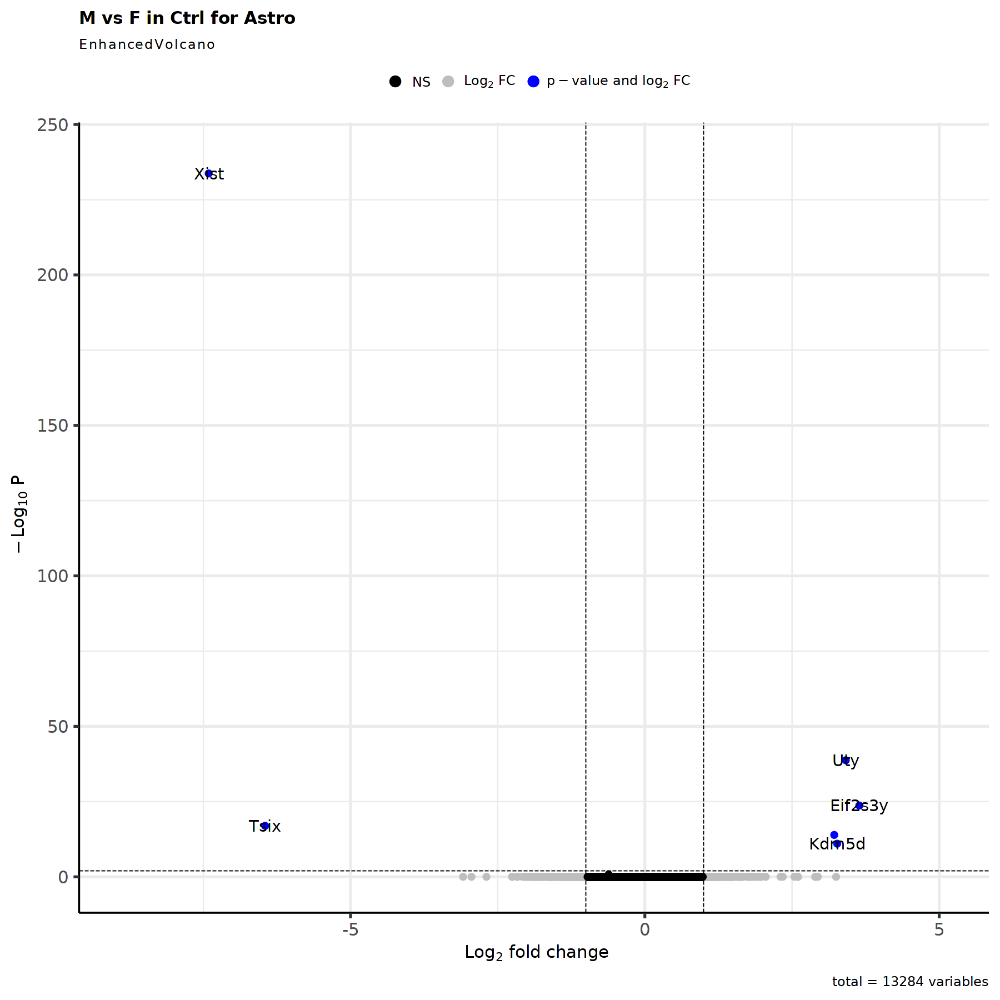

In [433]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [434]:
res <- res[complete.cases(res$padj),]

In [435]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [436]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 6 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat       pvalue         padj
        <numeric>      <numeric> <numeric> <numeric>    <numeric>    <numeric>
Xist     726.8492       -7.40991  0.224660 -32.98277 1.43454e-238 1.89818e-234
Tsix     163.1227       -6.45204  0.682704  -9.45072  3.36524e-21  1.11322e-17
Eif2s3y   42.2791        3.64264  0.331697  10.98183  4.67346e-28  2.06131e-24
Uty       53.0997        3.41278  0.247455  13.79151  2.86686e-43  1.89672e-39
Kdm5d     12.3574        3.26757  0.416712   7.84130  4.45899e-15  9.83357e-12
Ddx3y     23.2582        3.21743  0.371282   8.66572  4.48680e-18  1.18739e-14

In [437]:
nrow(res_filtered)

[1] 6

In [438]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [439]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [440]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [441]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


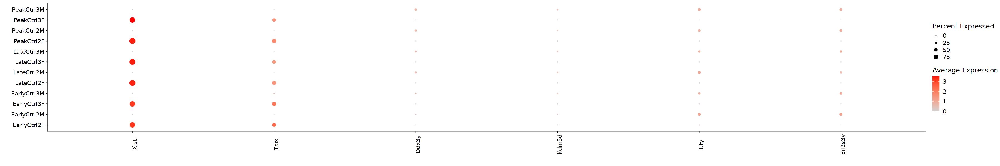

In [442]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

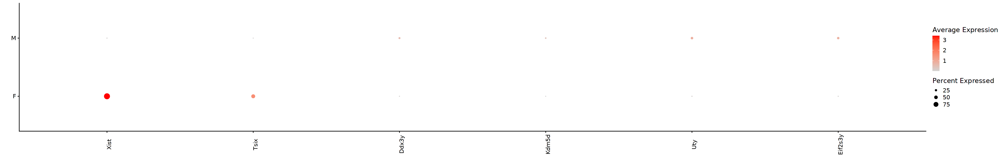

In [443]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [444]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.2.5 Summary

In [445]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

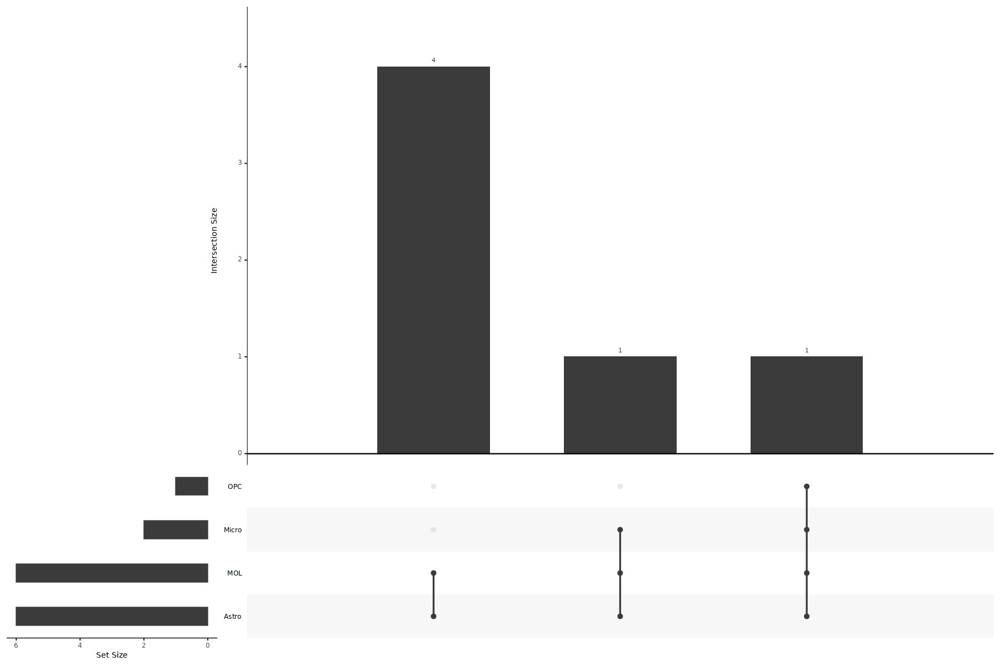

In [446]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [447]:
HVF <- unique(unlist(HVGs.list))

In [448]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [449]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [450]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [451]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [452]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [453]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [454]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [455]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


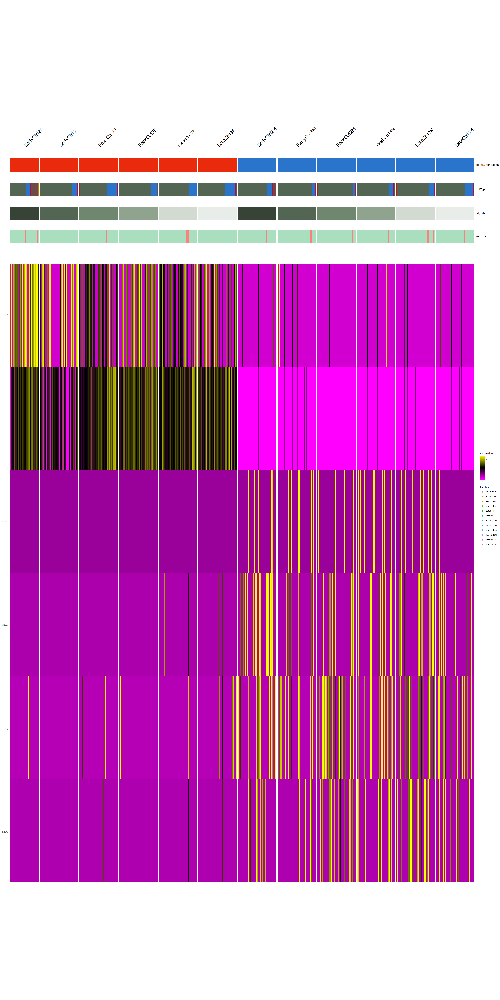

In [456]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    slot = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [457]:
sample_names <- levels(tmp$orig.ident_Sex)

In [458]:
Idents(object = tmp) <- "Sex"

In [459]:
gene_list <- HVF

In [460]:
tmp_markers <- data.frame(matrix(ncol=length(names(sub_timepoint_Sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sub_timepoint_Sex_colors)))))

In [461]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_Sex == names(sub_timepoint_Sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [462]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [463]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [464]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

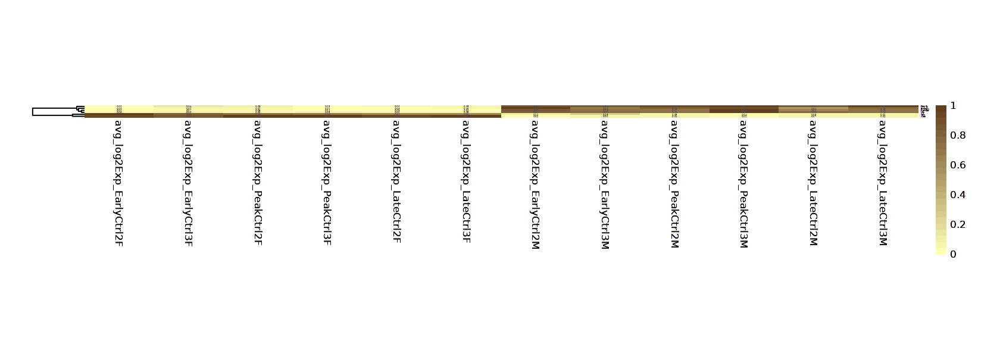

In [467]:
options(repr.plot.width=14, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [468]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [469]:
gene_list <- gene_list[ph$tree_row$order]

In [470]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [471]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [472]:
matrix <- tmp_markers_mean

In [473]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

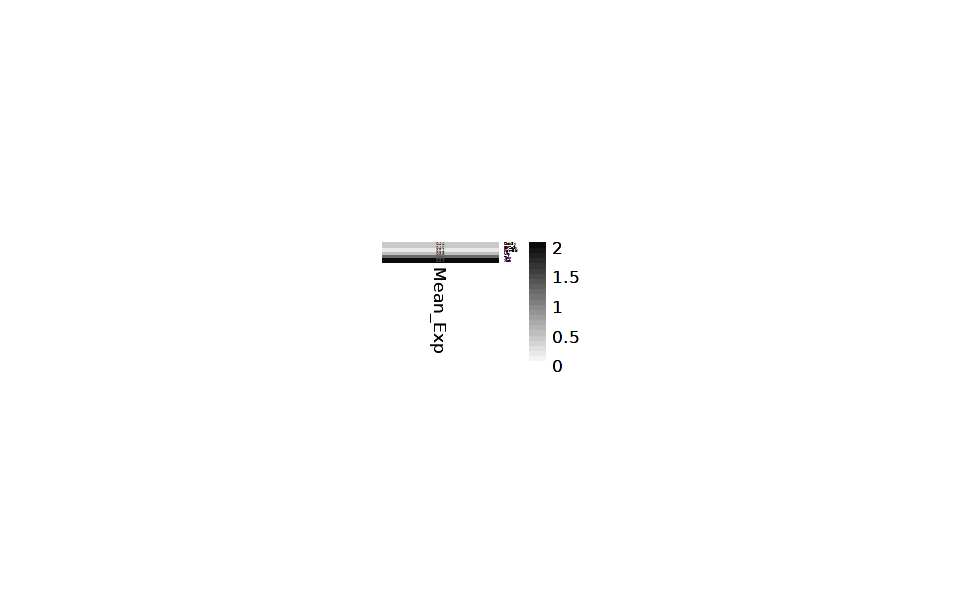

In [474]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [475]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [476]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [477]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

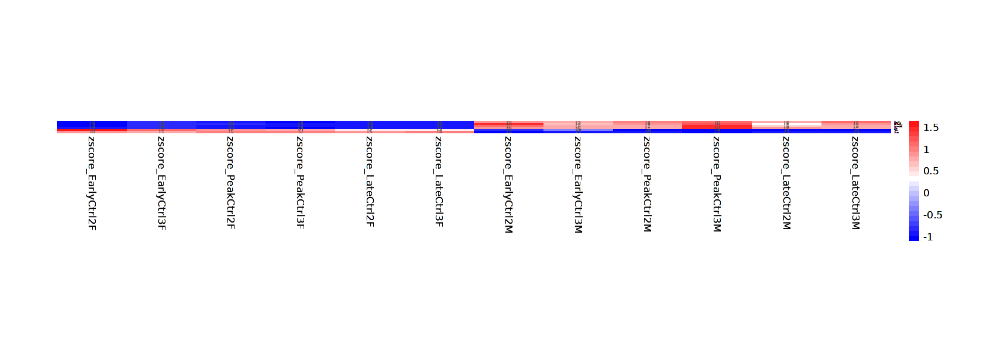

In [478]:
options(repr.plot.width=14, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [479]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [480]:
gene_list <- HVF

In [481]:
tmp_markers <- data.frame(matrix(ncol=length(names(sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sex_colors)))))

In [482]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = Sex == names(sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [483]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [484]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [485]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

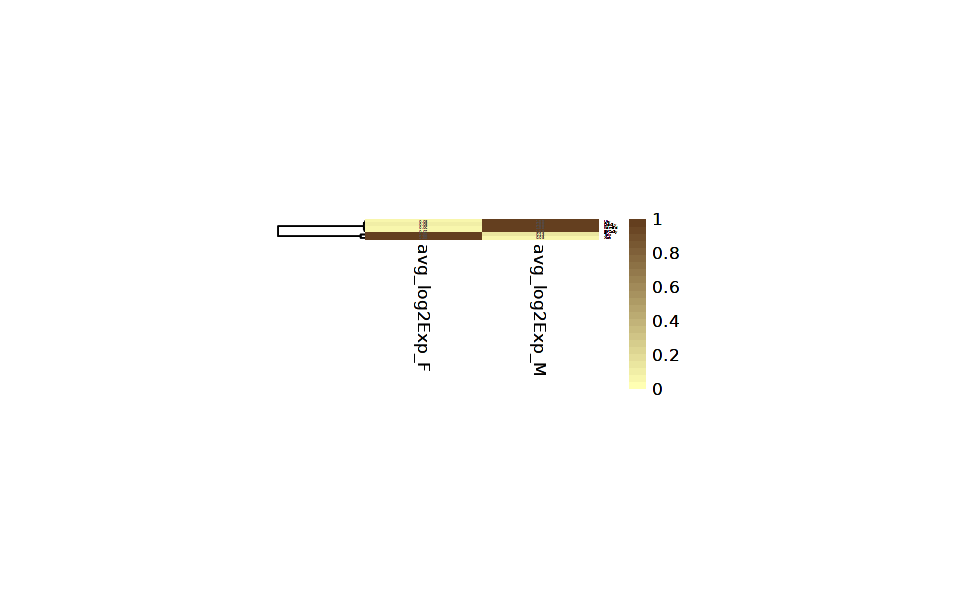

In [486]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [487]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [488]:
gene_list <- gene_list[ph$tree_row$order]

In [489]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [490]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [491]:
matrix <- tmp_markers_mean

In [492]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

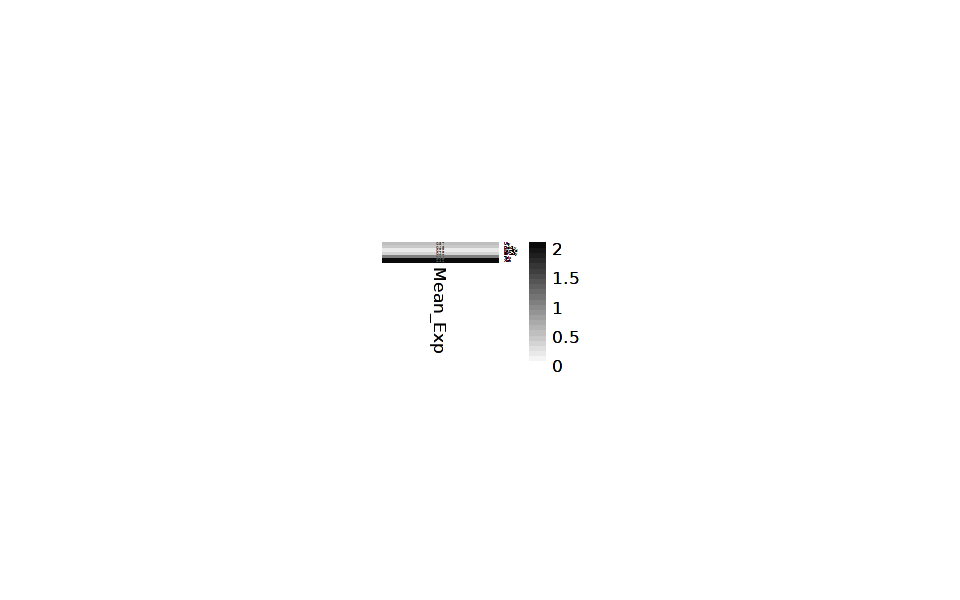

In [493]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [494]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [495]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [496]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

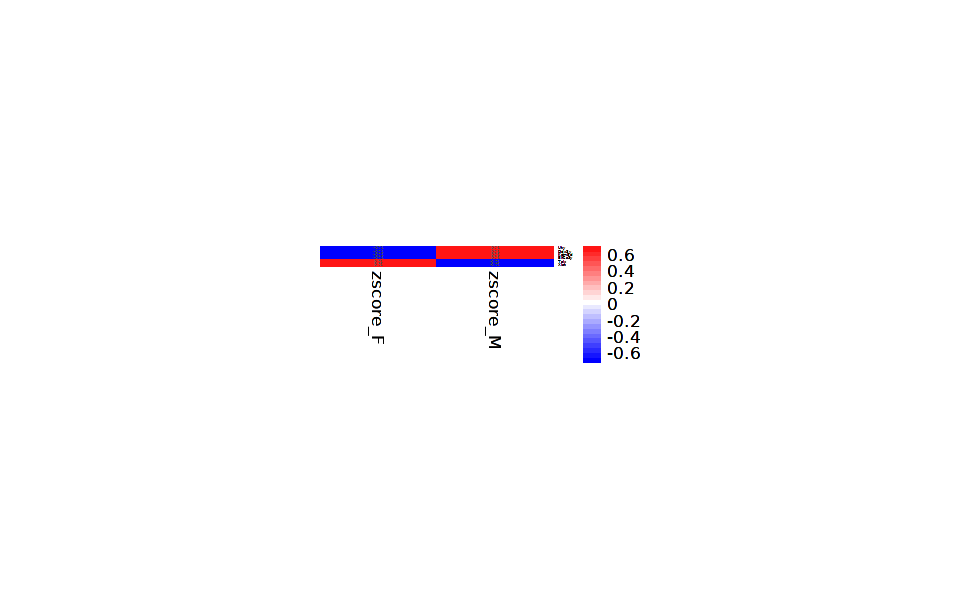

In [497]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [498]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.3 Early

In [499]:
timepoint <- "Early"
name_timepoint <- names_Early

In [500]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


In [501]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [502]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [503]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [504]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [505]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [506]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Early1F Early1M Early2F Early2M EarlyFemale3F EarlyMale3M
  OPC          4      15       0       0             2           5
  COP          0       0       0       0             0           0
  MOL       1541    2081     290     643          3187        3437
  Astro      204     204      48      36           241         285
  Epen        49      30       4      12            31          89
  Micro       29     111      44      59             5          15
  Neuron       3       1       0       0             3           2
  Peric        0       0       3       1             0           0

In [507]:
table(tmp$cellType, tmp$Sex)

        
            F    M
  OPC       6   20
  COP       0    0
  MOL    5018 6161
  Astro   493  525
  Epen     84  131
  Micro    78  185
  Neuron    6    3
  Peric     3    1

In [508]:
table(tmp$orig.ident, tmp$Sex)

              
                  F    M
  Early1       1830 2442
  Early2        389  751
  EarlyMale3      0 3833
  EarlyFemale3 3469    0

In [509]:
table(tmp$orig.ident_Sex, tmp$Sex)

               
                   F    M
  Early1F       1830    0
  Early1M          0 2442
  Early2F        389    0
  Early2M          0  751
  EarlyFemale3F 3469    0
  EarlyMale3M      0 3833

In [510]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [511]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = TRUE)

In [512]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [513]:
kids <- kids[names(kids)!="Neuron"]

In [514]:
kids
sids

OPC     COP     MOL   Astro    Epen   Micro   Peric 
  "OPC"   "COP"   "MOL" "Astro"  "Epen" "Micro" "Peric"

Early1F         Early1M         Early2F         Early2M   EarlyFemale3F     EarlyMale3M 
      "Early1F"       "Early1M"       "Early2F"       "Early2M" "EarlyFemale3F"   "EarlyMale3M"

In [515]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      Early1F       Early1M       Early2F       Early2M EarlyFemale3F   EarlyMale3M 
         1830          2442           389           751          3469          3833 

sample_id,group_id,n_cells
<fct>,<fct>,<dbl>
Early1F,F,1830
Early1M,M,2442
Early2F,F,389
Early2M,M,751
EarlyFemale3F,F,3469
EarlyMale3M,M,3833


In [516]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [517]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [518]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [519]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 7
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:66308] 0 3 4 5 6 7 8 9 10 11 ...
  .. ..@ p       : int [1:7] 0 11776 23553 33763 42702 54454 66308
  .. ..@ Dim     : int [1:2] 12368 6
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:12368] "Xkr4" "Gm1992" "Gm19938" "Mrpl15" ...
  .. .. ..$ : chr [1:6] "Early1F" "Early1M" "Early2F" "Early2M" ...
  .. ..@ x       : num [1:66308] 28 20 29 50 266 32 75 10 298 135 ...
  .. ..@ factors : list()
 $ Epen  :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:53491] 0 3 4 5 6 7 8 10 11 14 ...
  .. ..@ p       : int [1:7] 0 10905 20569 24454 31785 42098 53491
  .. ..@ Dim     : int [1:2] 12368 6
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:12368] "Xkr4" "Gm1992" "Gm19938" "Mrpl15" ...
  .. .. ..$ : chr [1:6] "Early1F" "Early1M" "Early2F" "Early2M" ...
  .. ..@ x       : num [1:53491] 18 7 7 24 9 8 25 85 33 9 ...
  .. ..@ factors : list()
 $ MOL   :Formal cl

In [520]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
            F    M
  OPC       6   20
  COP       0    0
  MOL    5018 6161
  Astro   493  525
  Epen     84  131
  Micro    78  185
  Neuron    6    3
  Peric     3    1

In [521]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Early1F Early1M Early2F Early2M EarlyFemale3F EarlyMale3M
  OPC          4      15       0       0             2           5
  COP          0       0       0       0             0           0
  MOL       1541    2081     290     643          3187        3437
  Astro      204     204      48      36           241         285
  Epen        49      30       4      12            31          89
  Micro       29     111      44      59             5          15
  Neuron       3       1       0       0             3           2
  Peric        0       0       3       1             0           0

In [522]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [523]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [524]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id) 

Joining with `by = join_by(sample_id)`


In [525]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [526]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "Epen"   "MOL"    "Micro"  "Neuron" "OPC"    "Peric"

In [527]:
HVGs.list <- list()

##### 3.2.3.1 MOL

In [528]:
cluster_choice <- "MOL"

In [529]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [530]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [531]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [532]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [533]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Early1F,MOL,Early1F,F
Early1M,MOL,Early1M,M
Early2F,MOL,Early2F,F
Early2M,MOL,Early2M,M
EarlyFemale3F,MOL,EarlyFemale3F,F
EarlyMale3M,MOL,EarlyMale3M,M


In [534]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [535]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [536]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

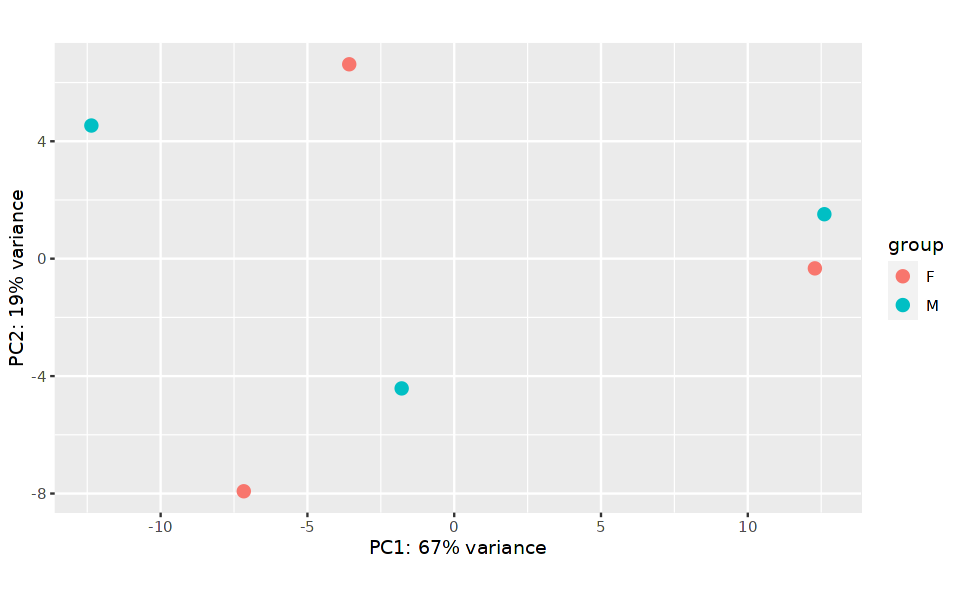

In [537]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [538]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

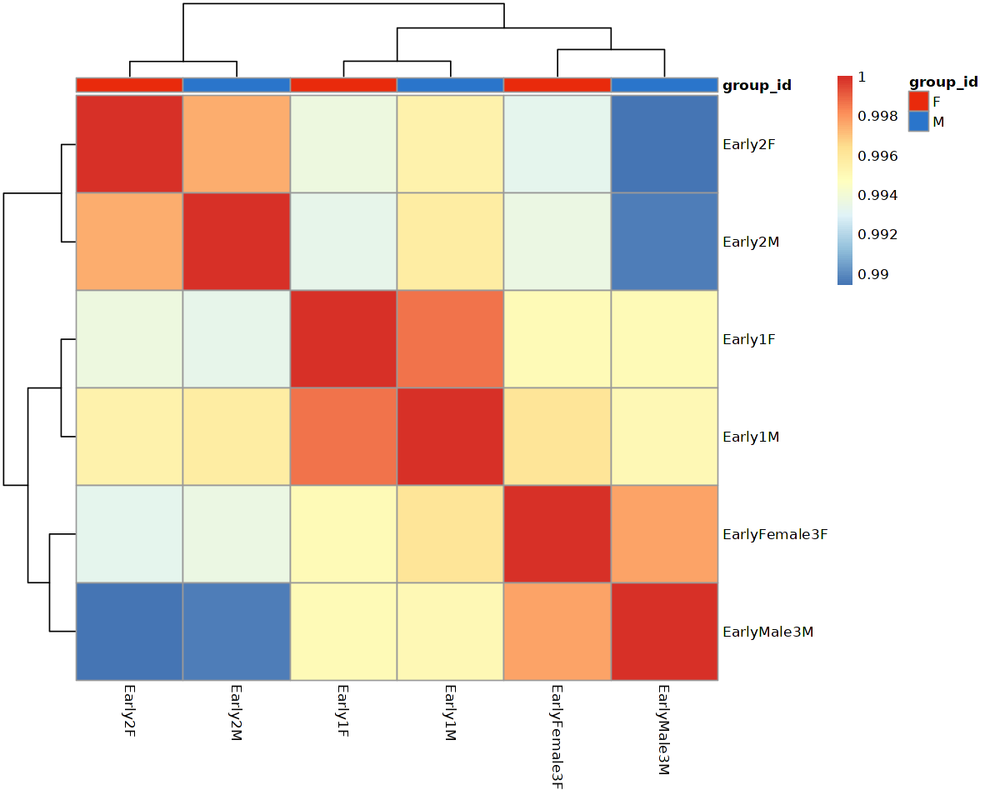

In [539]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [540]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [541]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


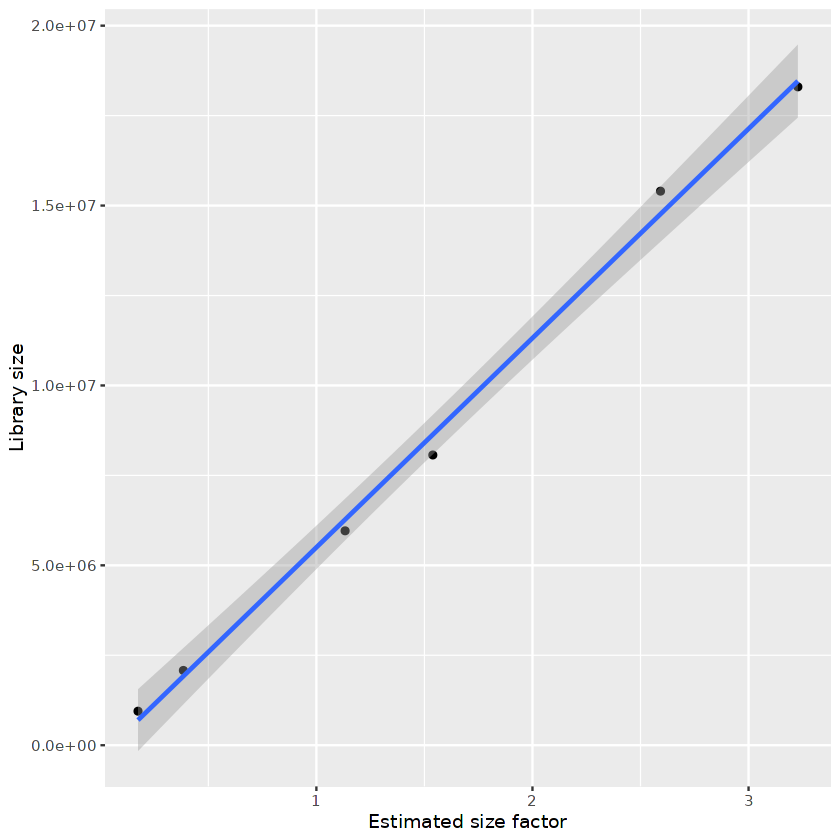

In [542]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [543]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Early1F,MOL,Early1F,F,1.1329387
Early1M,MOL,Early1M,M,1.5388681
Early2F,MOL,Early2F,F,0.1745256
Early2M,MOL,Early2M,M,0.3844397
EarlyFemale3F,MOL,EarlyFemale3F,F,2.5925557
EarlyMale3M,MOL,EarlyMale3M,M,3.2282617


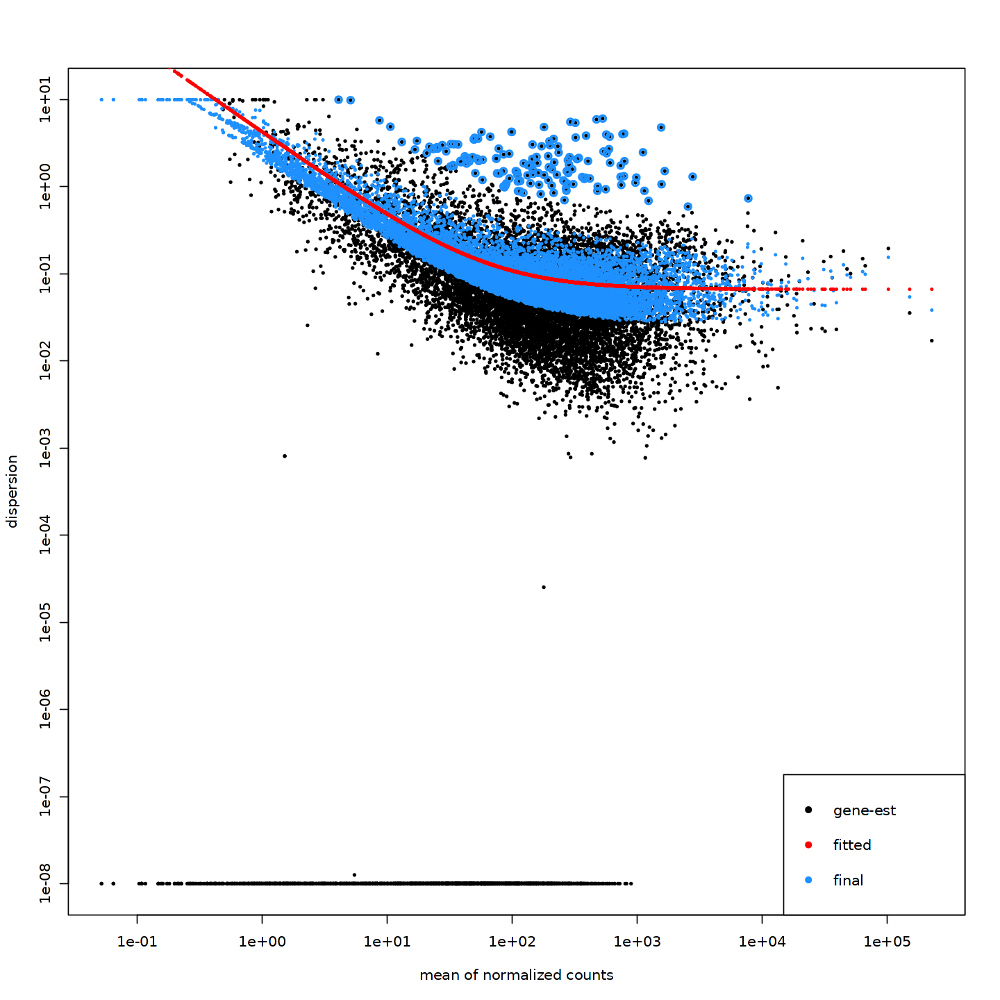

In [544]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [545]:
condition1 = "M"
condition2 = "F"

In [546]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [547]:
summary(res)


out of 12360 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.0081%
outliers [1]       : 4, 0.032%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



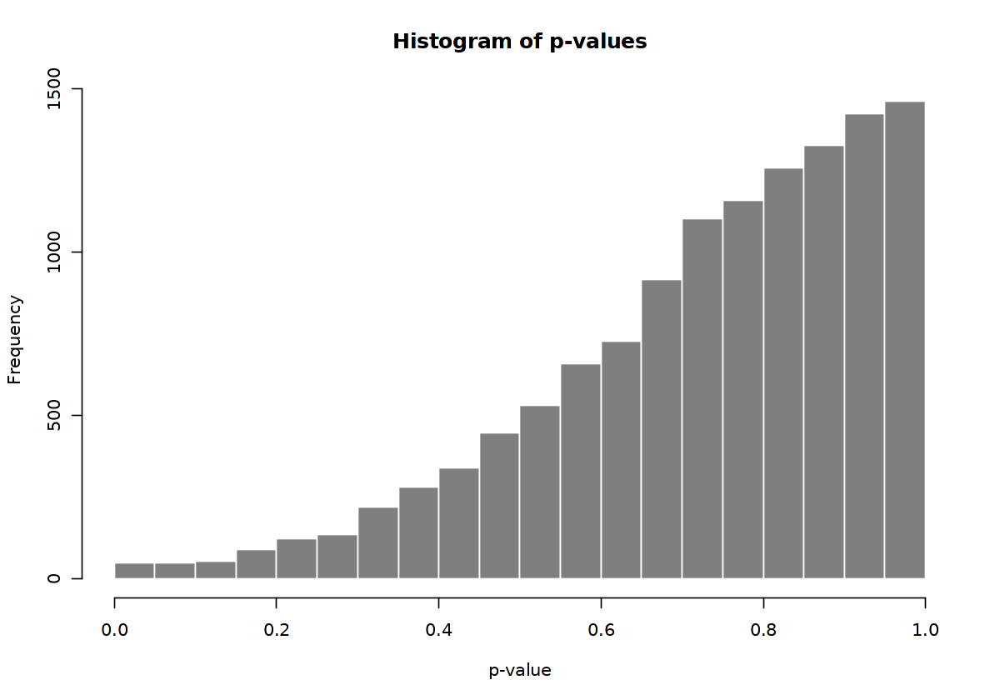

In [548]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

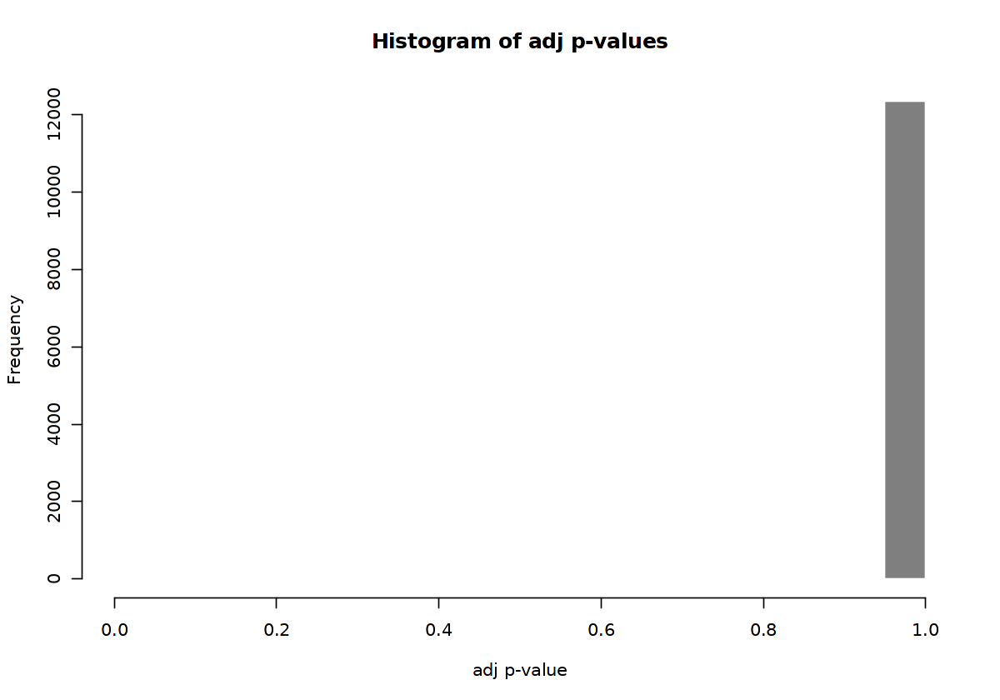

In [549]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

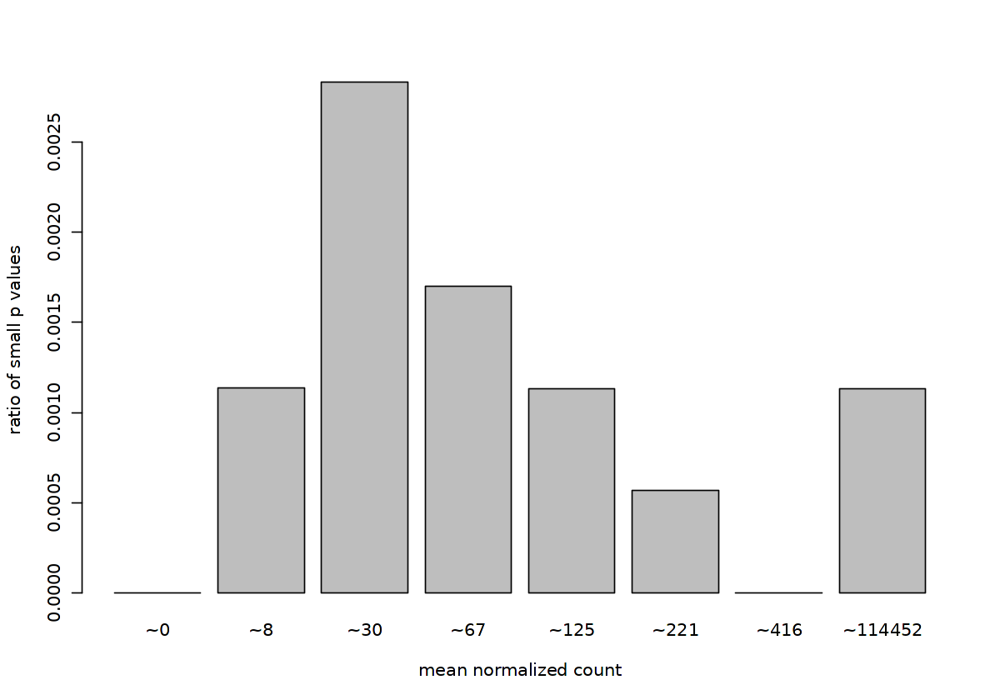

In [550]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

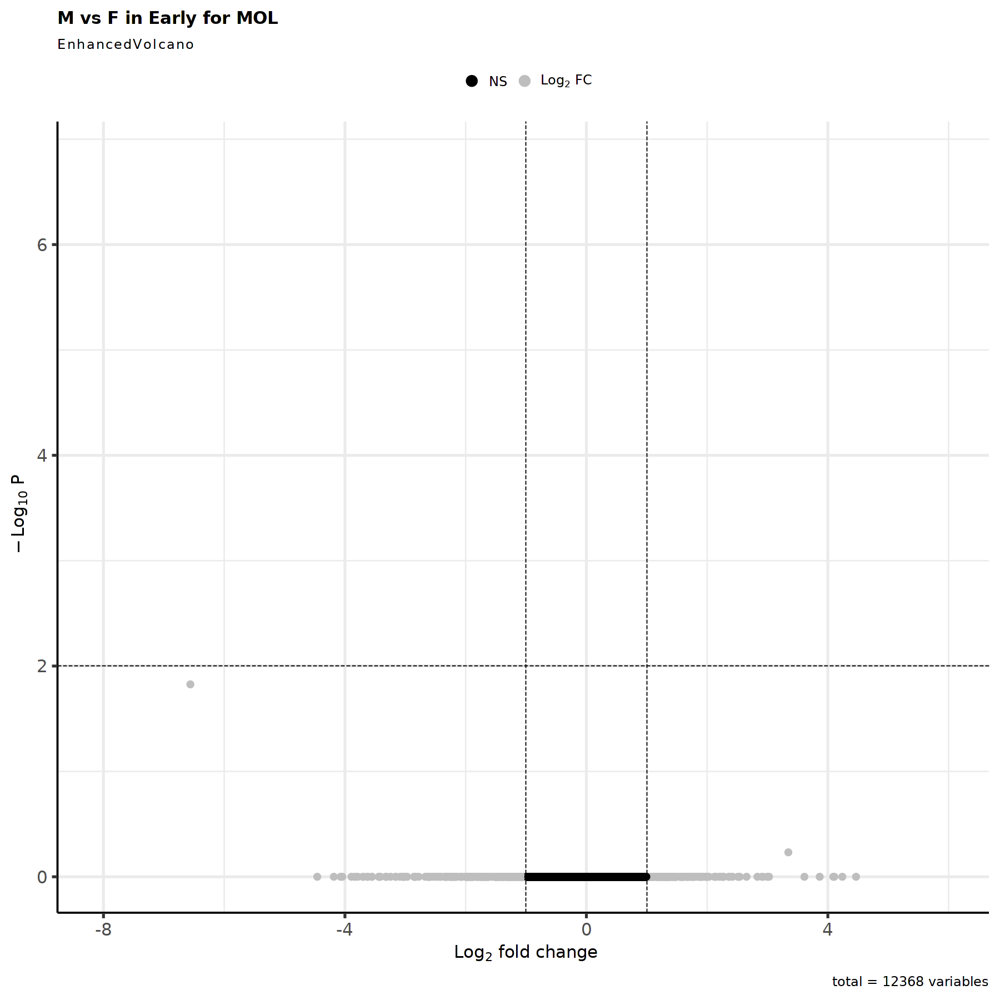

In [551]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [552]:
res <- res[complete.cases(res$padj),]

In [553]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [554]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 0 rows and 6 columns

In [555]:
nrow(res_filtered)

[1] 0

In [558]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.3.2 OPC

In [559]:
cluster_choice <- "OPC"

In [560]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Early1F       Early2F       Early2M EarlyFemale3F   EarlyMale3M 
            4             0             0             2             5

In [561]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

F  M 
 6 20

In [562]:
#Not enough cells

##### 3.2.3.3 Micro

In [563]:
cluster_choice <- "Micro"

In [564]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

EarlyFemale3F 
            5

In [565]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [566]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [567]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [568]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Early1F,Micro,Early1F,F
Early1M,Micro,Early1M,M
Early2F,Micro,Early2F,F
Early2M,Micro,Early2M,M
EarlyMale3M,Micro,EarlyMale3M,M


In [569]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [570]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [571]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

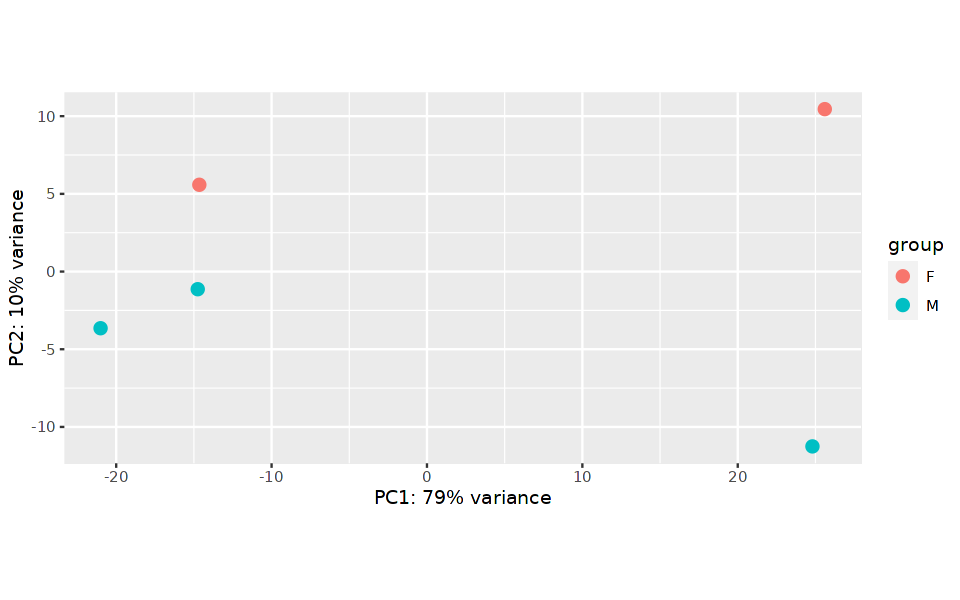

In [572]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [573]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

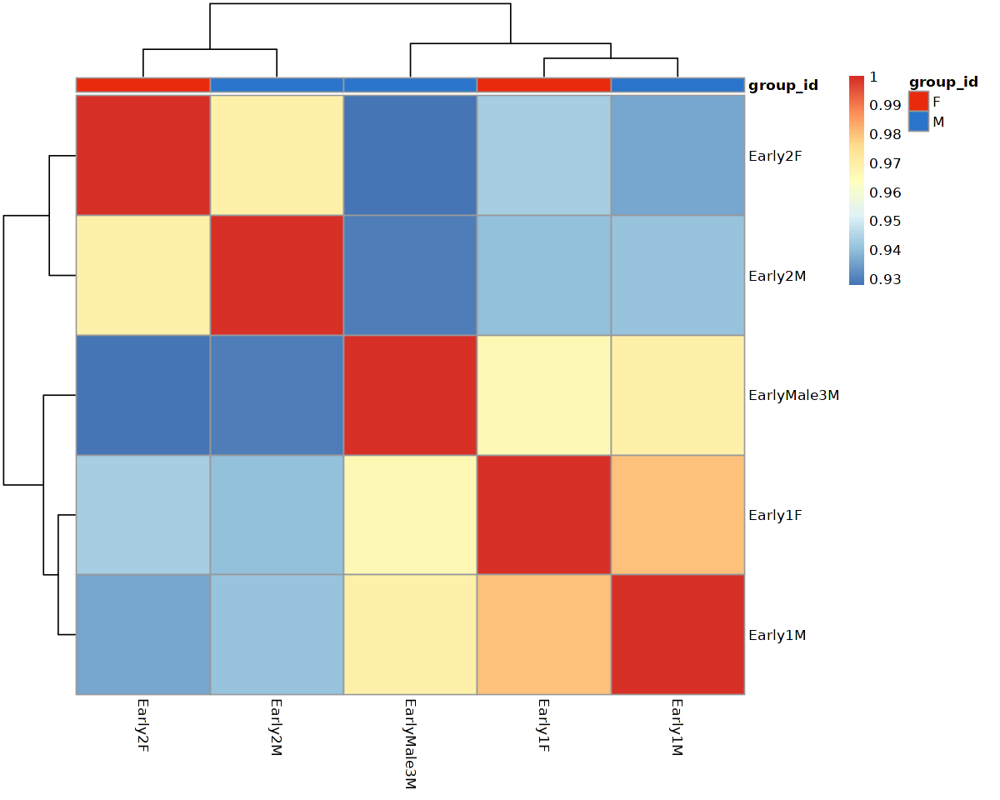

In [574]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [575]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [576]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


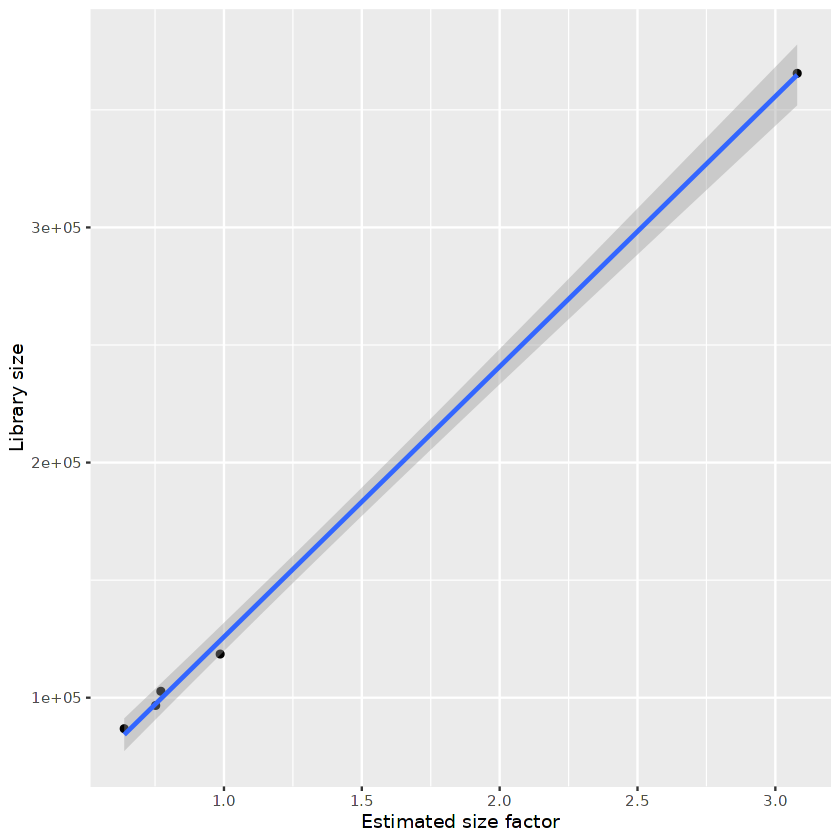

In [577]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [578]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Early1F,Micro,Early1F,F,0.9862583
Early1M,Micro,Early1M,M,3.0793159
Early2F,Micro,Early2F,F,0.7523832
Early2M,Micro,Early2M,M,0.7711389
EarlyMale3M,Micro,EarlyMale3M,M,0.6381895


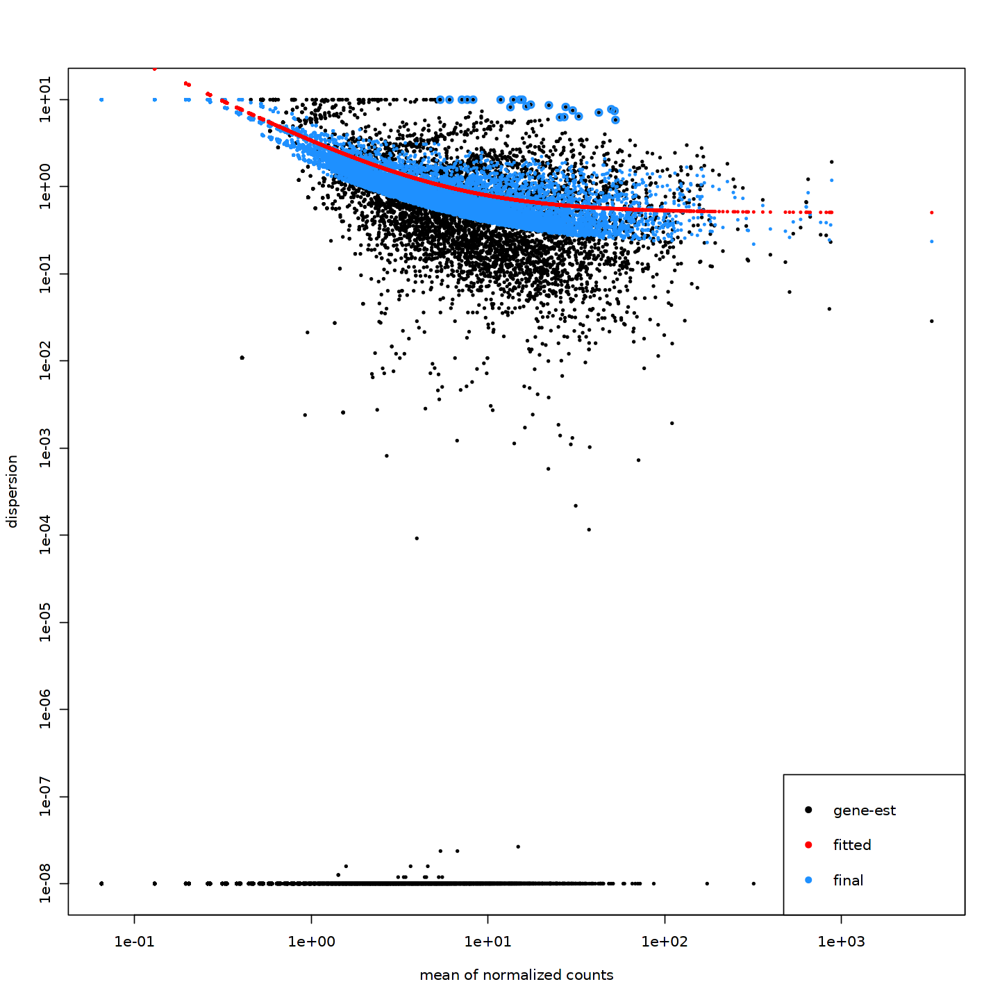

In [579]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [580]:
condition1 = "M"
condition2 = "F"

In [581]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [582]:
summary(res)


out of 11715 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 6, 0.051%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



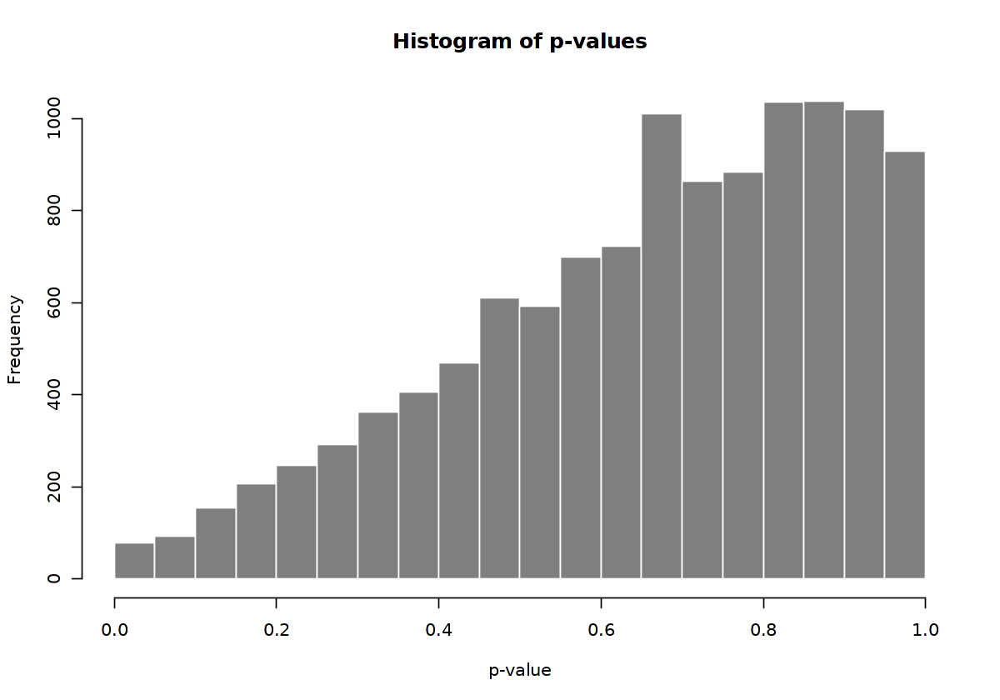

In [583]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

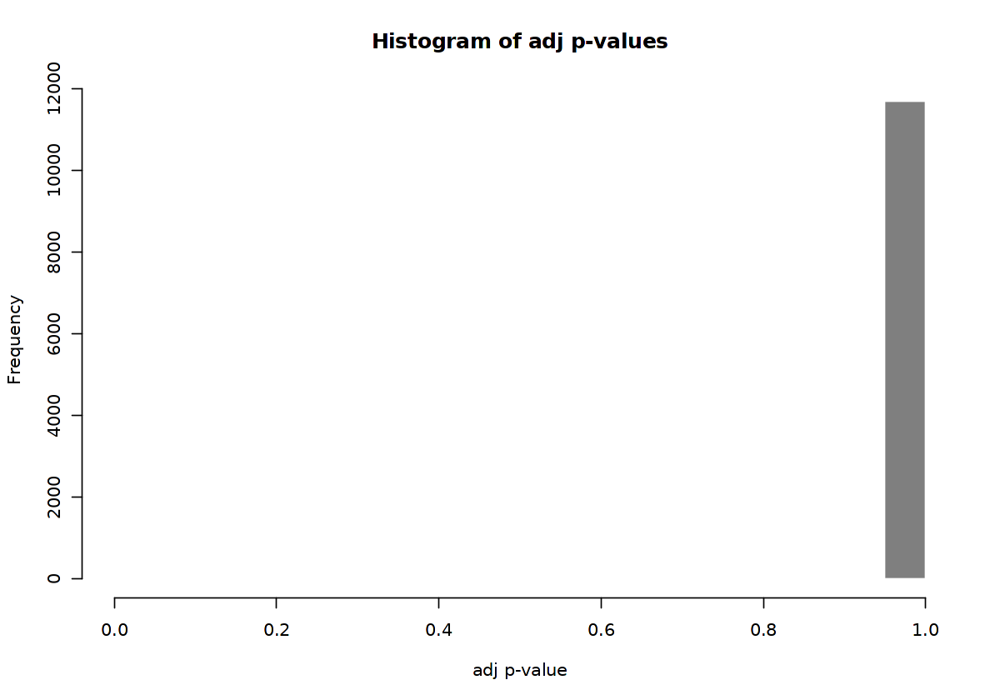

In [584]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

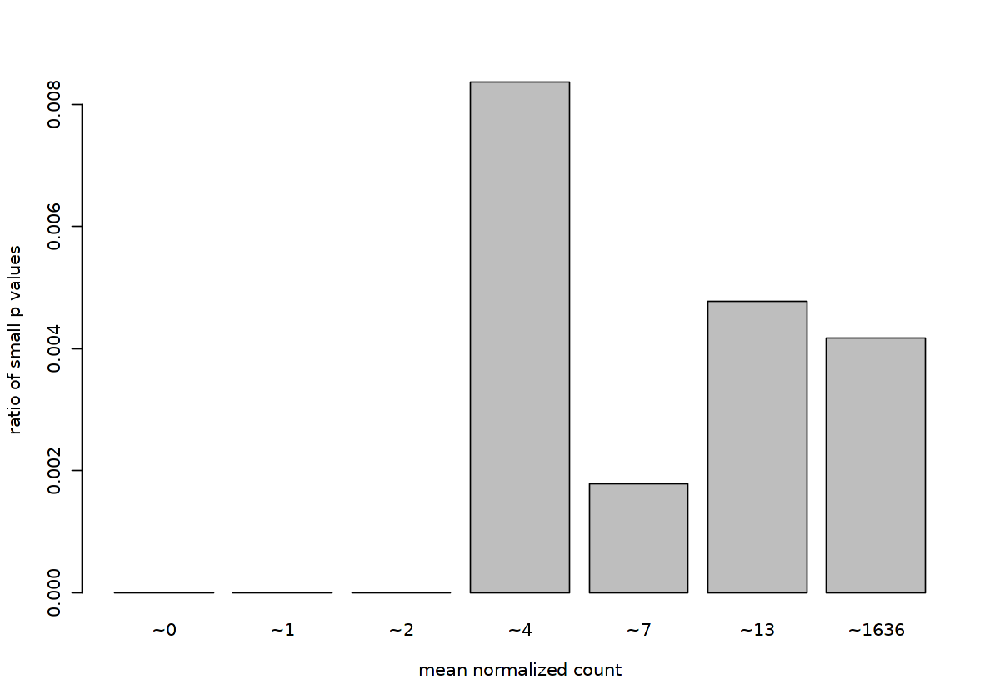

In [585]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

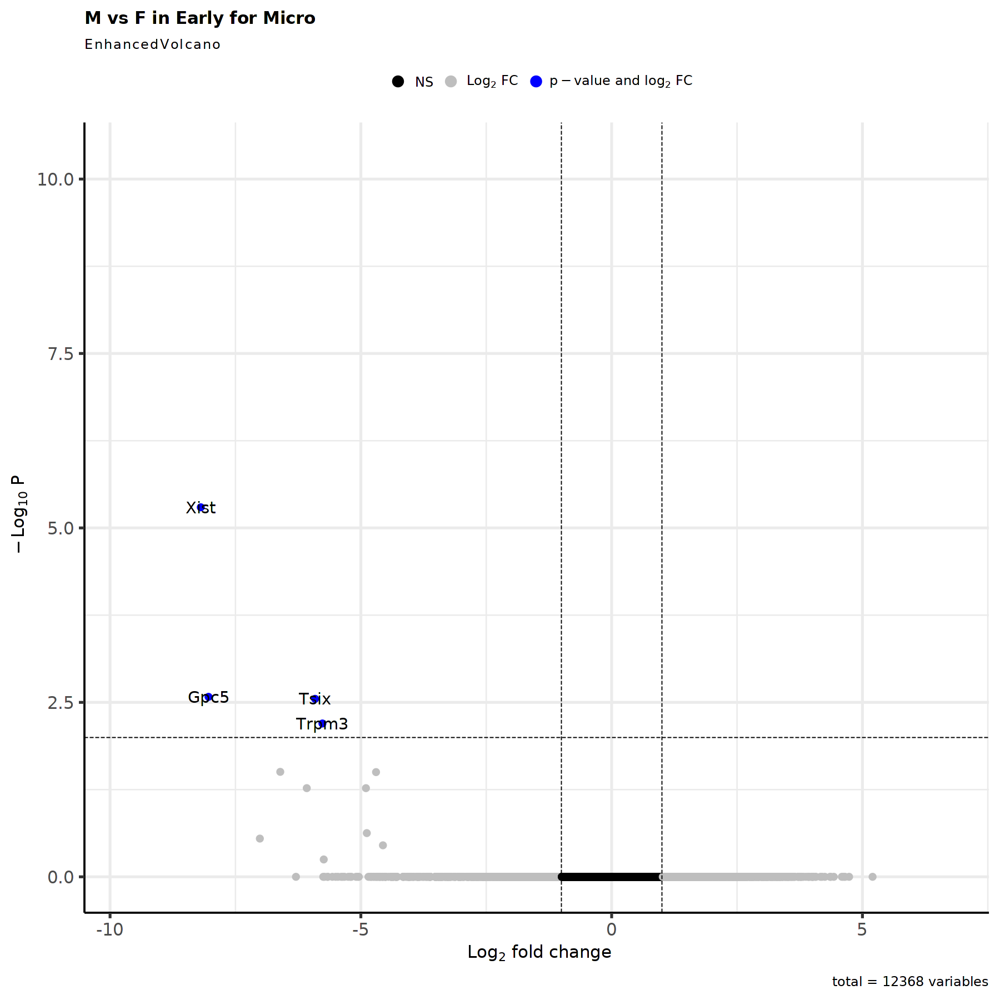

In [586]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [587]:
res <- res[complete.cases(res$padj),]

In [588]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [589]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 4 rows and 6 columns
       baseMean log2FoldChange     lfcSE      stat      pvalue        padj
      <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist    68.2364       -8.19116   1.31226  -6.24202 4.31954e-10 5.06034e-06
Gpc5    30.3603       -8.03689   1.59254  -5.04659 4.49763e-07 2.63449e-03
Tsix    28.9508       -5.91238   1.19304  -4.95572 7.20632e-07 2.81407e-03
Trpm3   30.5469       -5.76605   1.21721  -4.73711 2.16786e-06 6.34912e-03

In [590]:
nrow(res_filtered)

[1] 4

In [591]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [592]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [593]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [594]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


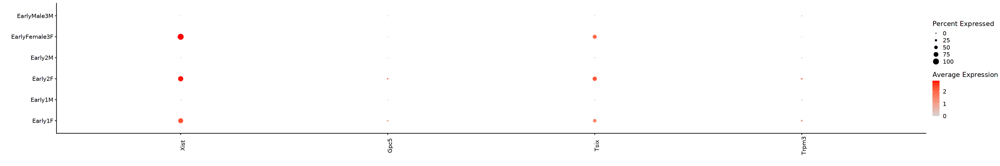

In [595]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

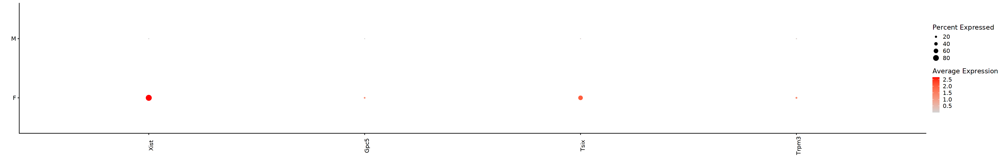

In [596]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [597]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.3.4 Astro

In [598]:
cluster_choice <- "Astro"

In [599]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [600]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [601]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [602]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [603]:
cluster_metadata

,cluster_id,sample_id,group_id
,<chr>,<chr>,<fct>
Early1F,Astro,Early1F,F
Early1M,Astro,Early1M,M
Early2F,Astro,Early2F,F
Early2M,Astro,Early2M,M
EarlyFemale3F,Astro,EarlyFemale3F,F
EarlyMale3M,Astro,EarlyMale3M,M


In [604]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [605]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id)

converting counts to integer mode



In [606]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

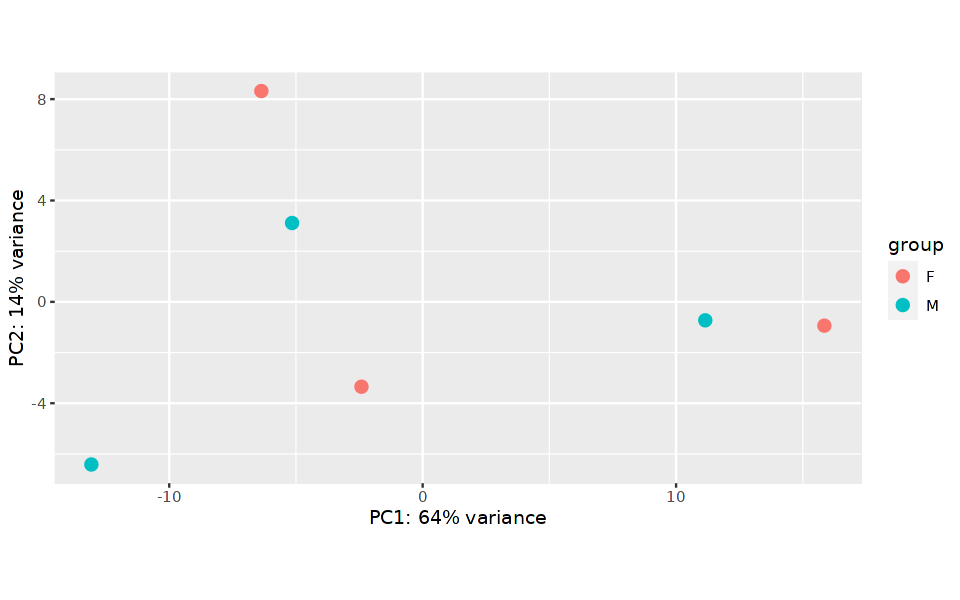

In [607]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = "group_id")

In [608]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

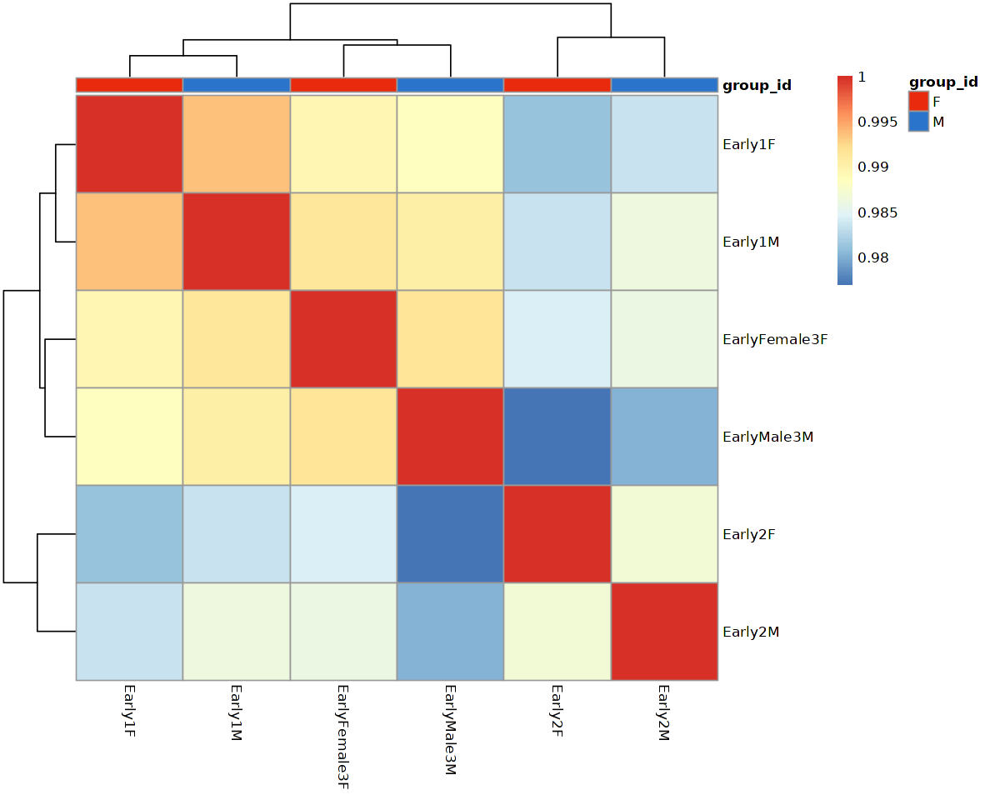

In [609]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id"), drop=F], annotation_colors = list(group_id=sex_colors))

In [610]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [611]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


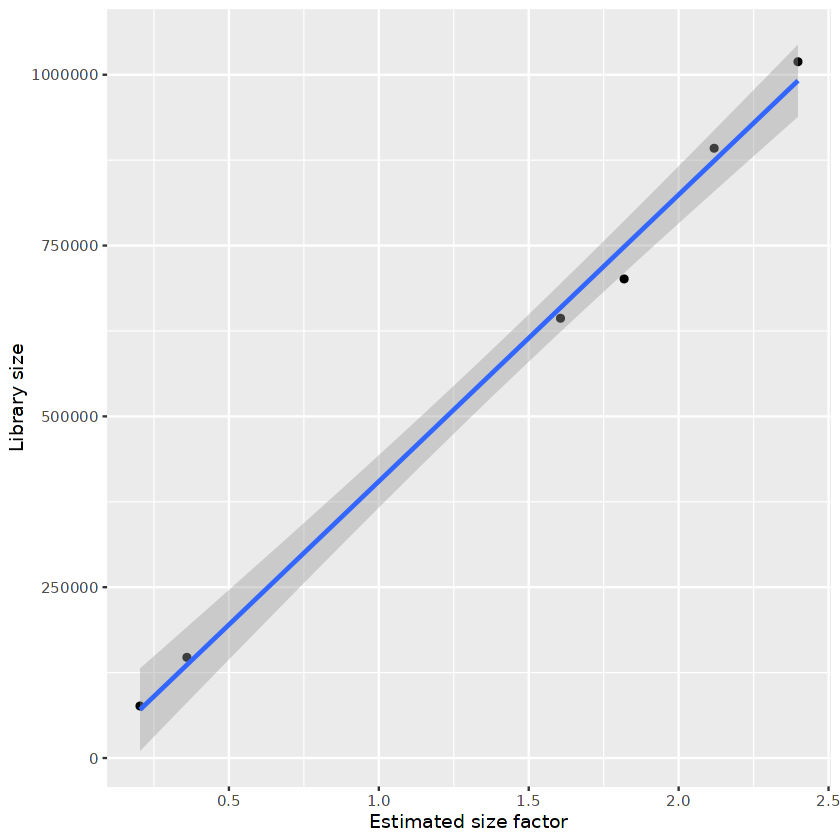

In [612]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [613]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,sizeFactor
,<chr>,<chr>,<fct>,<dbl>
Early1F,Astro,Early1F,F,1.6060159
Early1M,Astro,Early1M,M,1.8182149
Early2F,Astro,Early2F,F,0.3598583
Early2M,Astro,Early2M,M,0.2033950
EarlyFemale3F,Astro,EarlyFemale3F,F,2.1185133
EarlyMale3M,Astro,EarlyMale3M,M,2.3980514


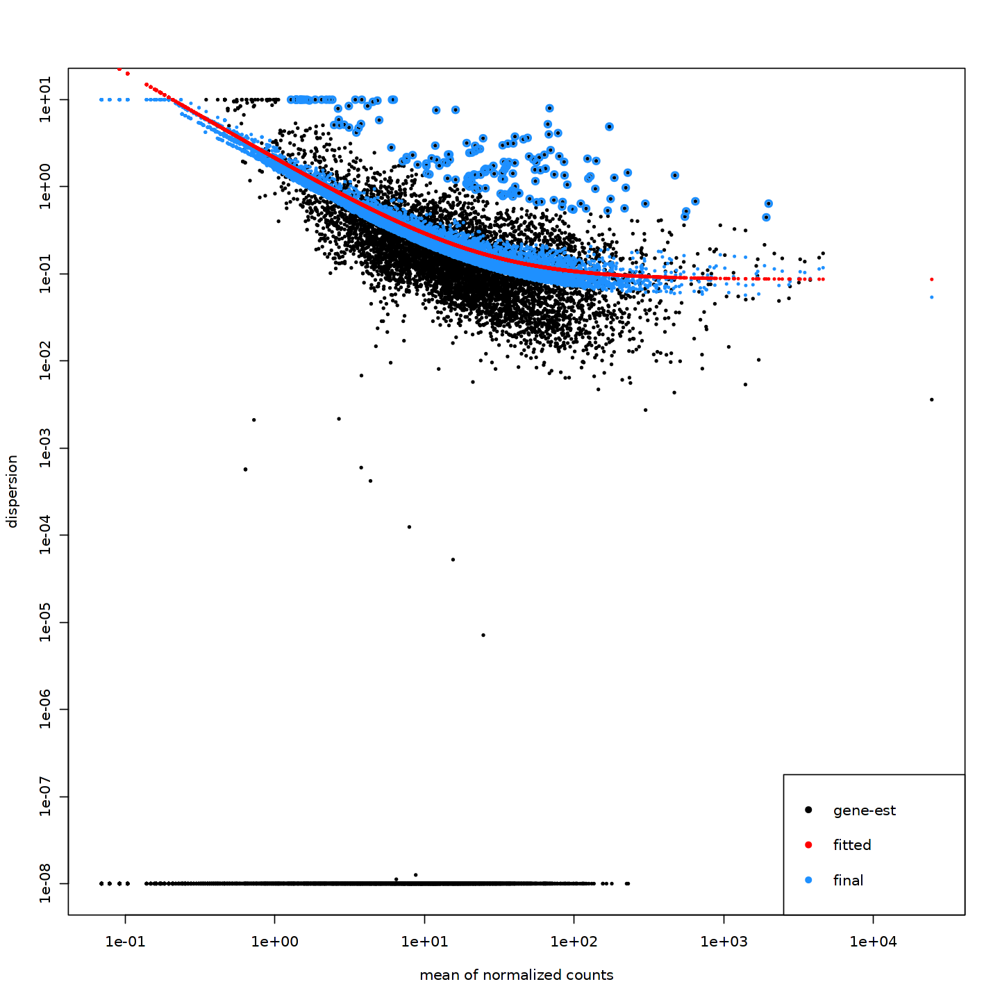

In [614]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [615]:
condition1 = "M"
condition2 = "F"

In [616]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [617]:
summary(res)


out of 12245 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 3, 0.024%
LFC < 0 (down)     : 2, 0.016%
outliers [1]       : 3, 0.024%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



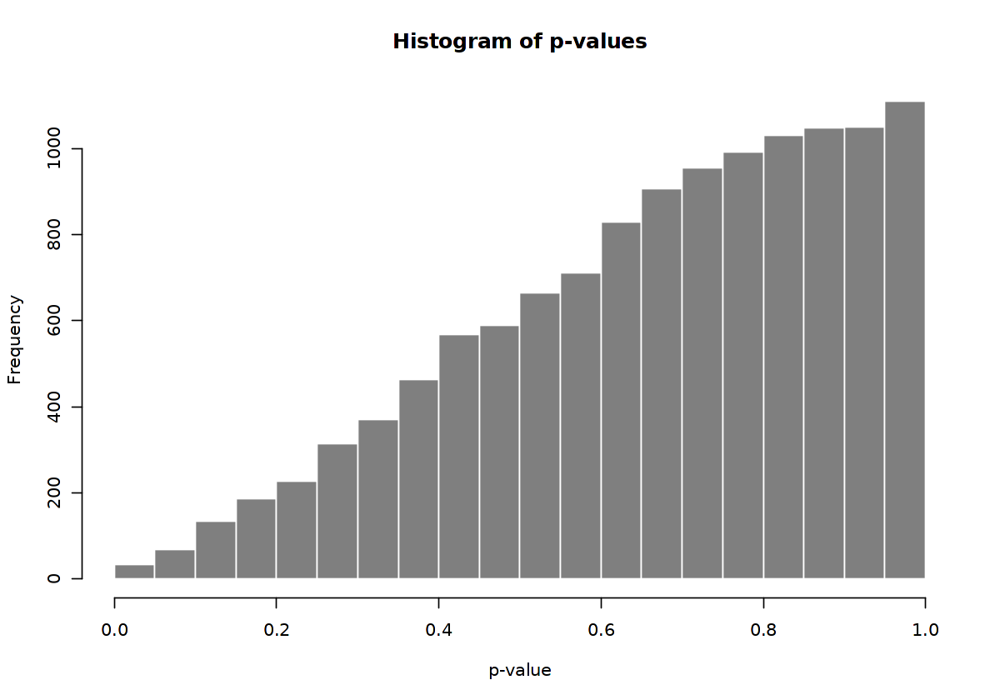

In [618]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

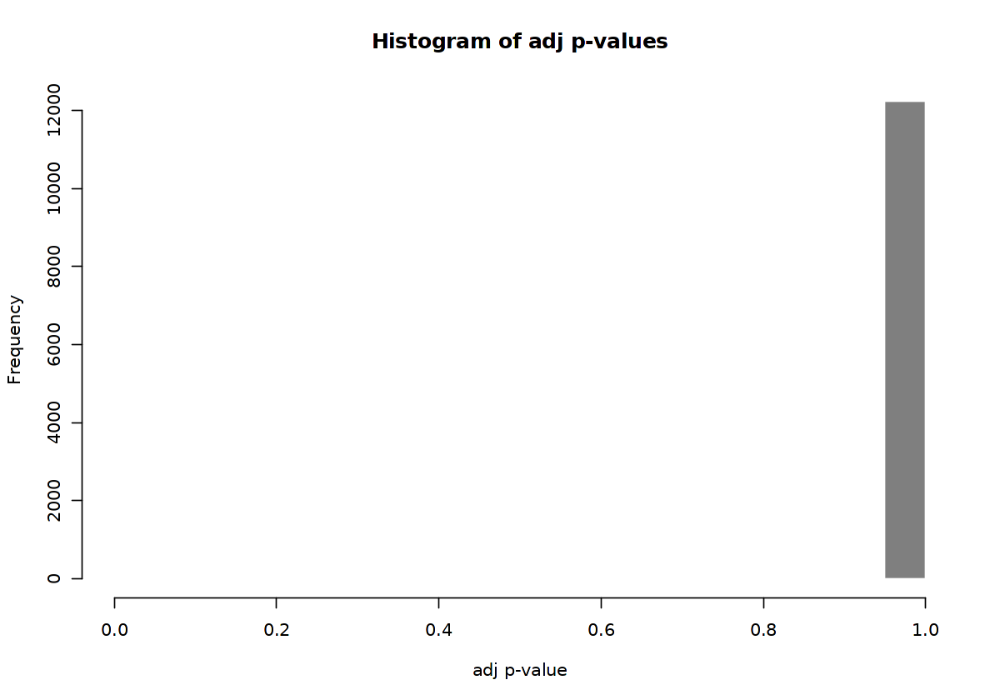

In [619]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

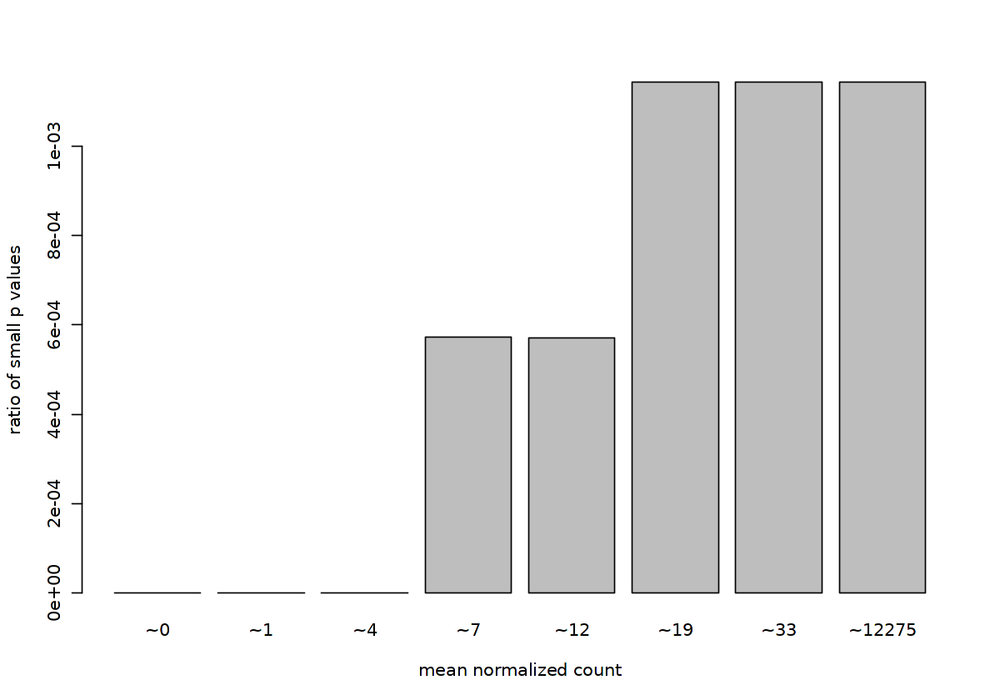

In [620]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

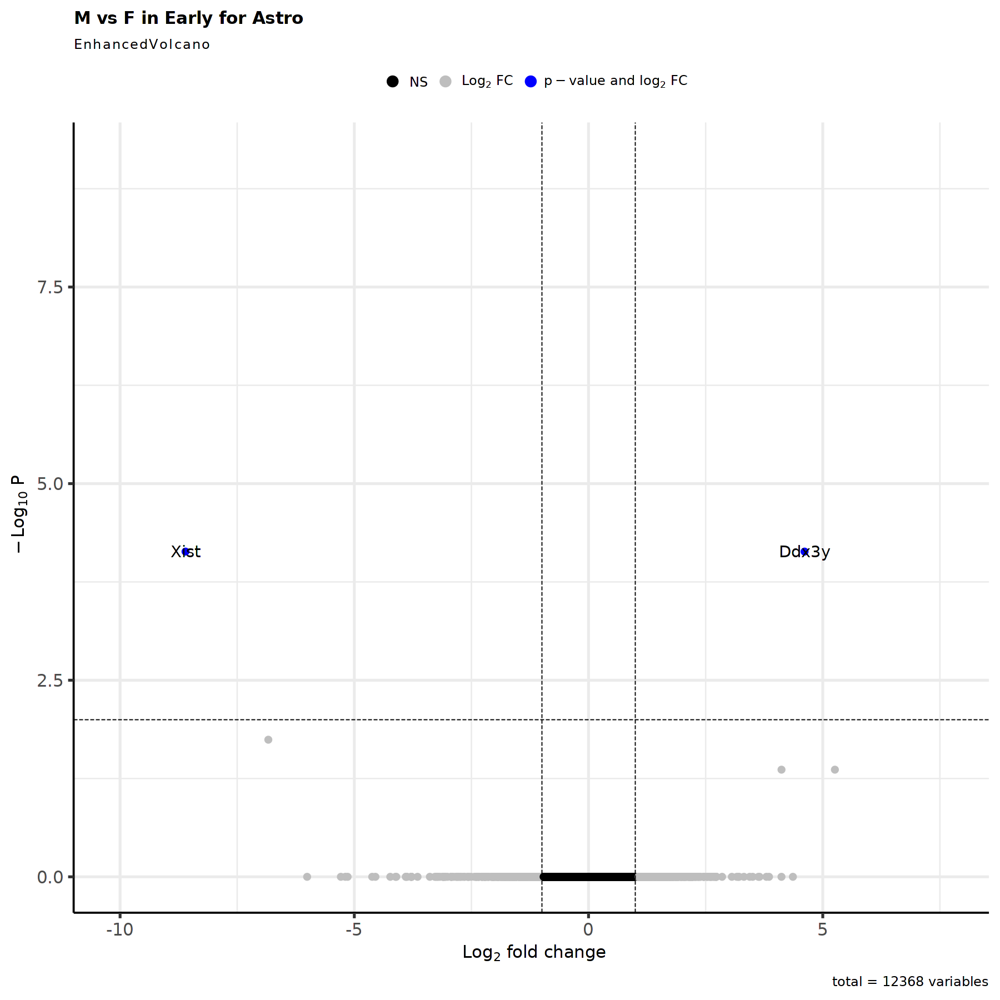

In [621]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [622]:
res <- res[complete.cases(res$padj),]

In [623]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [624]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 2 rows and 6 columns
       baseMean log2FoldChange     lfcSE      stat      pvalue        padj
      <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   471.4607       -8.60295  1.499886  -5.73573 9.70910e-09 7.31868e-05
Ddx3y   18.9007        4.61142  0.808973   5.70034 1.19567e-08 7.31868e-05

In [625]:
nrow(res_filtered)

[1] 2

In [626]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [627]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [628]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [629]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


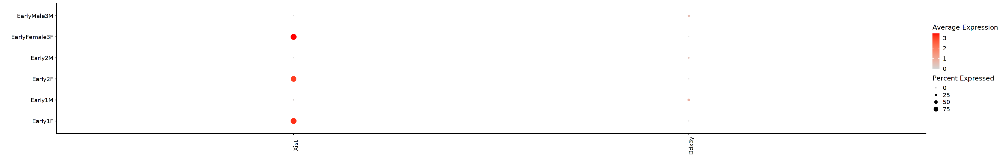

In [630]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

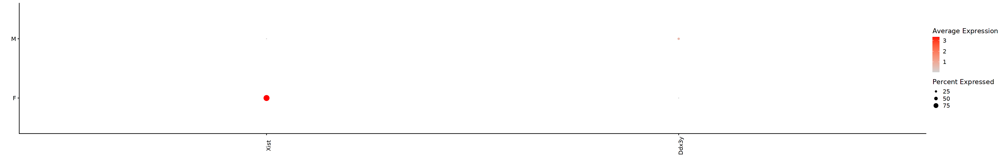

In [631]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [632]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.3.5 Summary

In [633]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

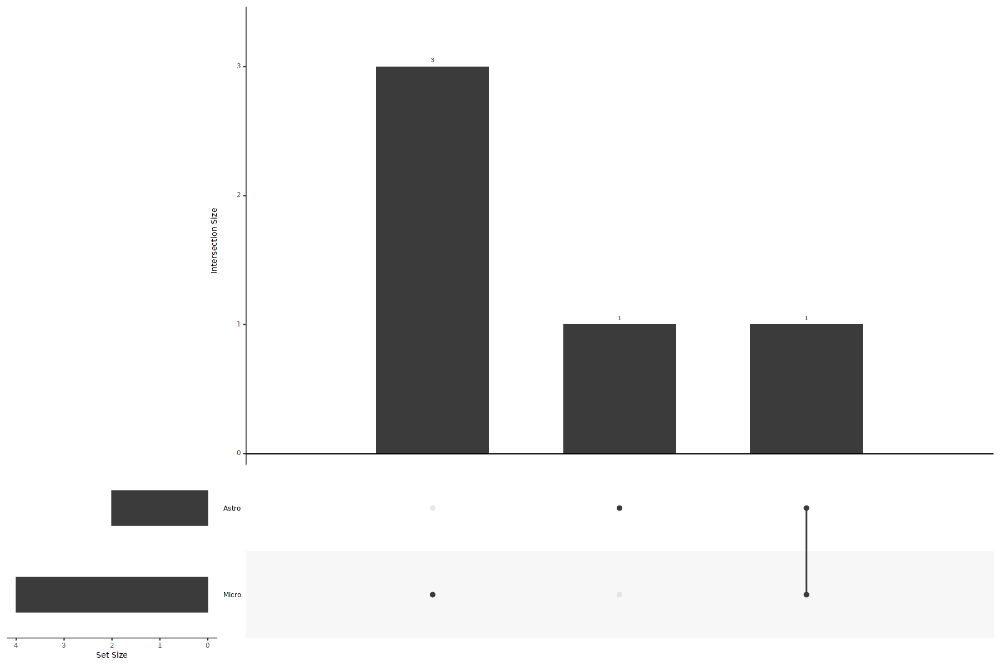

In [634]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [635]:
HVF <- unique(unlist(HVGs.list))

In [636]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [637]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [638]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [639]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [640]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [641]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [642]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [643]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


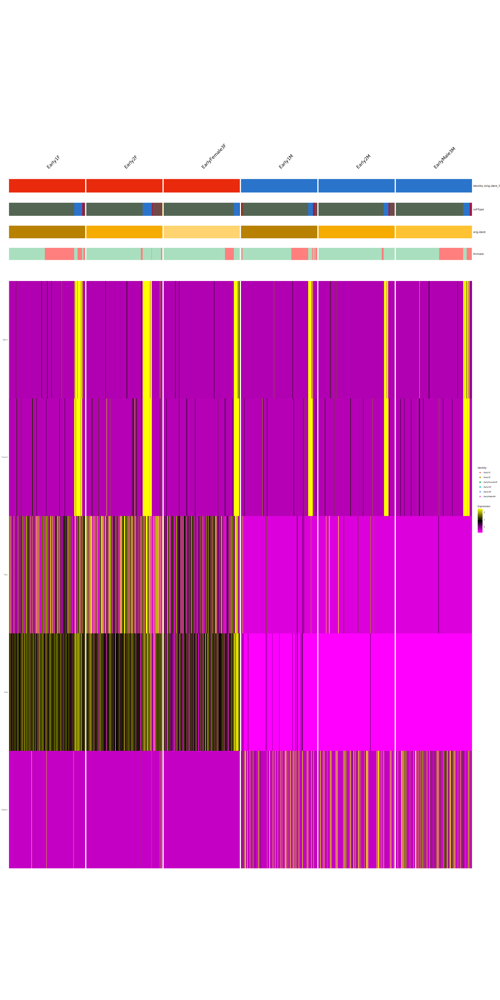

In [644]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    slot = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [645]:
sample_names <- levels(tmp$orig.ident_Sex)

In [646]:
Idents(object = tmp) <- "Sex"

In [647]:
gene_list <- HVF

In [648]:
tmp_markers <- data.frame(matrix(ncol=length(names(sub_timepoint_Sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sub_timepoint_Sex_colors)))))

In [649]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_Sex == names(sub_timepoint_Sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [650]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [651]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [652]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

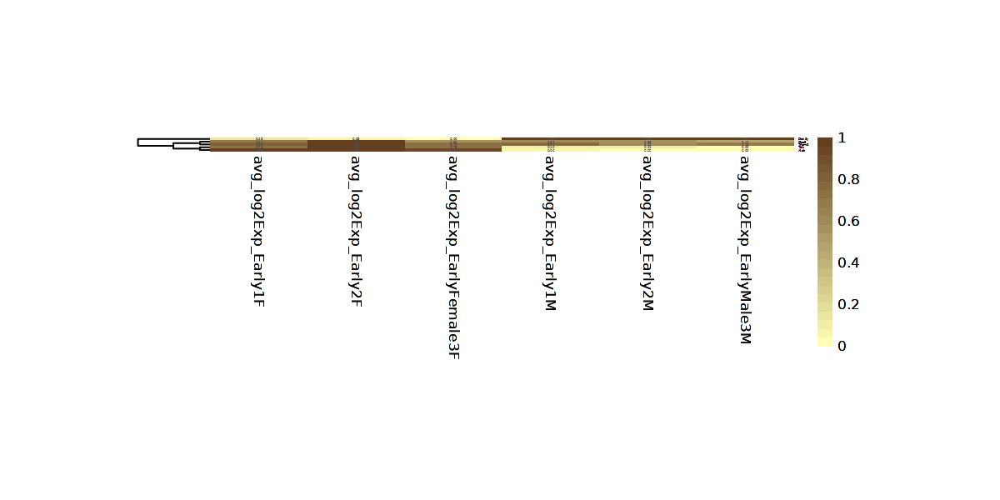

In [653]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [654]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [655]:
gene_list <- gene_list[ph$tree_row$order]

In [656]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [657]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [658]:
matrix <- tmp_markers_mean

In [659]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

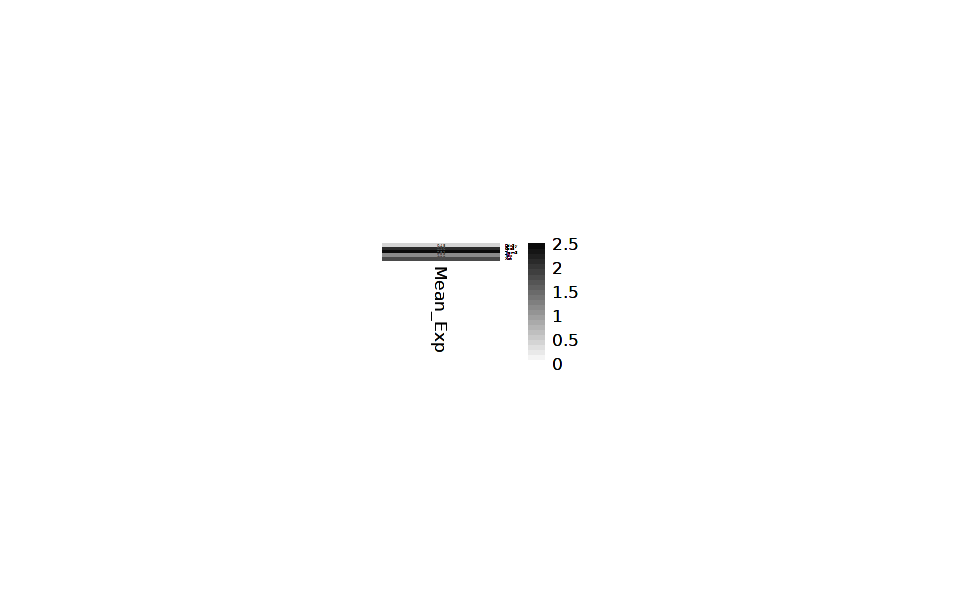

In [660]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [661]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [662]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [663]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

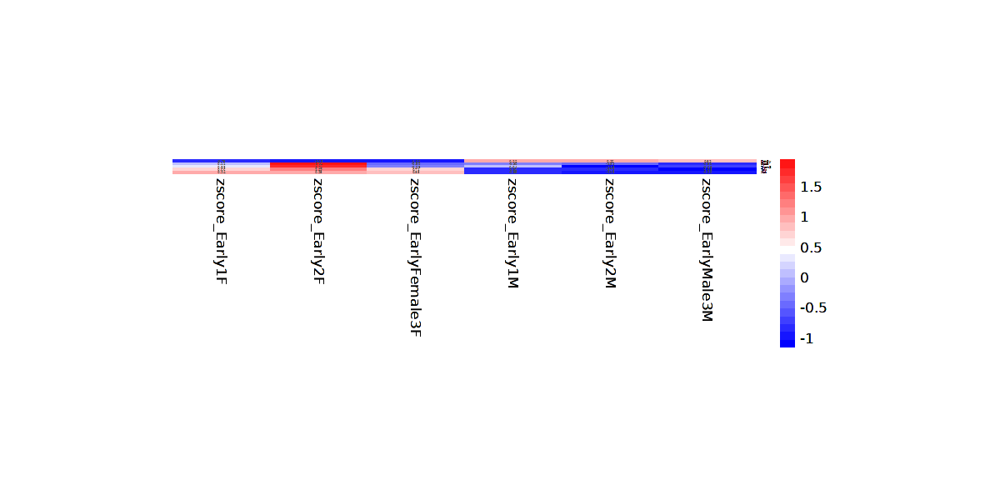

In [664]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [665]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [666]:
gene_list <- HVF

In [667]:
tmp_markers <- data.frame(matrix(ncol=length(names(sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sex_colors)))))

In [668]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = Sex == names(sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [669]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [670]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [671]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

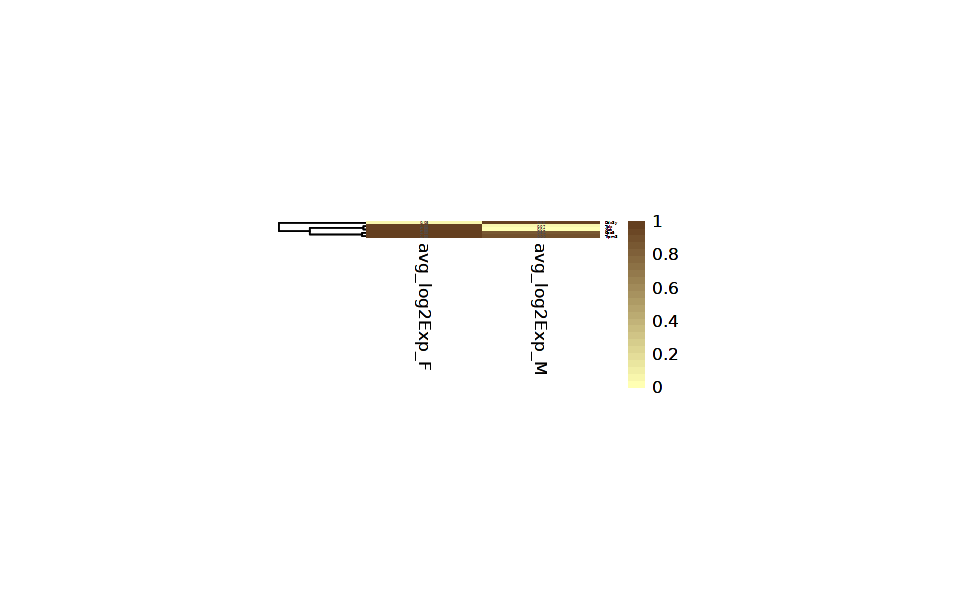

In [672]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [673]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [674]:
gene_list <- gene_list[ph$tree_row$order]

In [675]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [676]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [677]:
matrix <- tmp_markers_mean

In [678]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

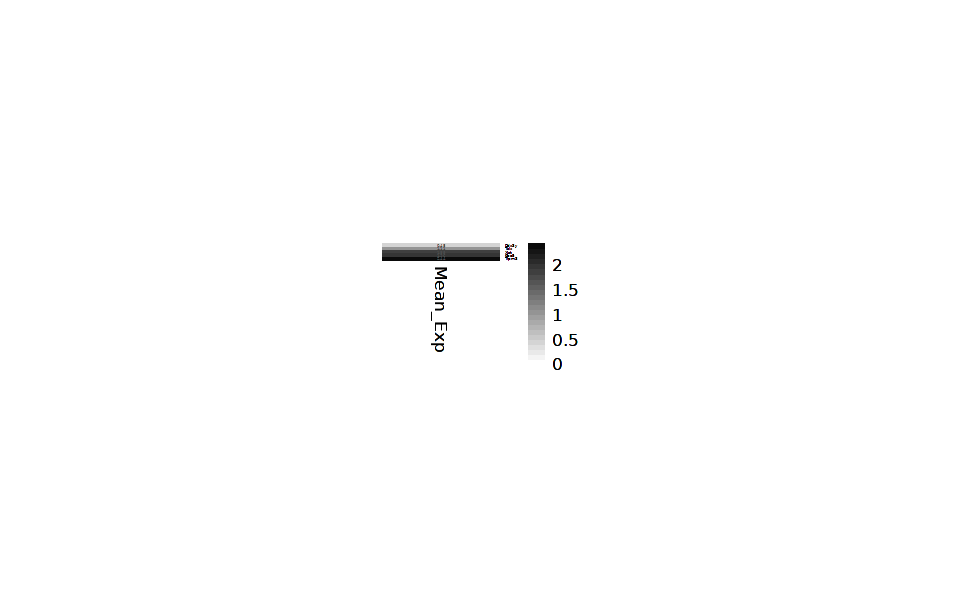

In [679]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [680]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [681]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [682]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

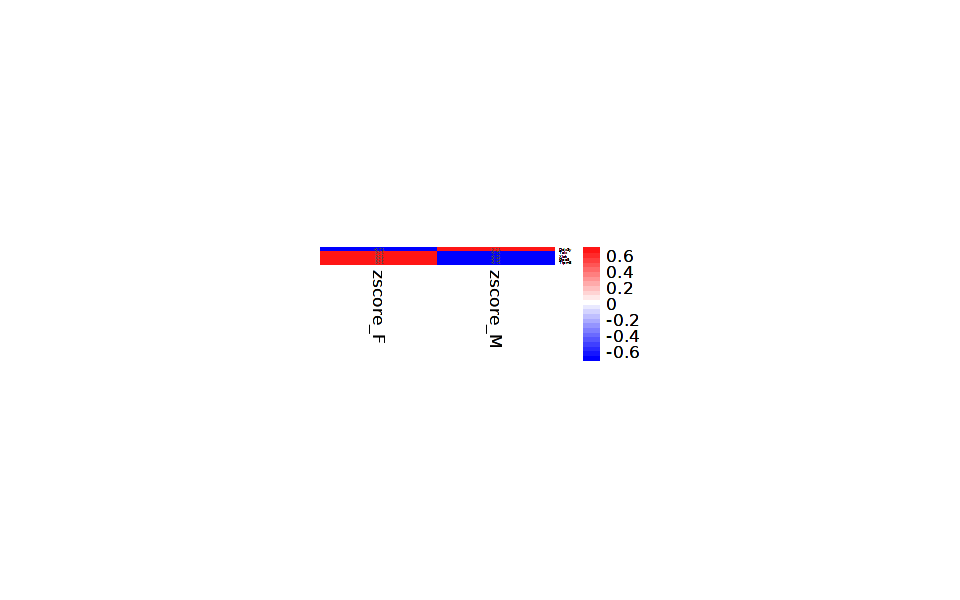

In [683]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [684]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.4 Peak

In [685]:
timepoint <- "Peak"
name_timepoint <- names_Peak

In [686]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


In [687]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [688]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [689]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [690]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [691]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [692]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Peak2F Peak2M Peak3F Peak3M PeakFemale4F PeakMale4M
  OPC         9      4     19     11          134        194
  COP         0      1      3      0           40        108
  MOL       502    839   1707   1481         4325       3126
  Astro       0     17      6      3           11          6
  Epen       11     12     52     39           30         48
  Micro      95     28    464    114           90         99
  Neuron      0      1      2      2            0          0
  Peric       0      0      0      2            0          3

In [693]:
table(tmp$cellType, tmp$Sex)

        
            F    M
  OPC     162  209
  COP      43  109
  MOL    6534 5446
  Astro    17   26
  Epen     93   99
  Micro   649  241
  Neuron    2    3
  Peric     0    5

In [694]:
table(tmp$orig.ident_Sex, tmp$Sex)

              
                  F    M
  Peak2F        617    0
  Peak2M          0  902
  Peak3F       2253    0
  Peak3M          0 1652
  PeakFemale4F 4630    0
  PeakMale4M      0 3584

In [695]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [696]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = FALSE)

In [697]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [698]:
kids <- kids[names(kids)!="Neuron"]

In [699]:
kids
sids

OPC     COP     MOL   Astro    Epen   Micro   Peric 
  "OPC"   "COP"   "MOL" "Astro"  "Epen" "Micro" "Peric"

Peak2F         Peak2M         Peak3F         Peak3M   PeakFemale4F     PeakMale4M 
      "Peak2F"       "Peak2M"       "Peak3F"       "Peak3M" "PeakFemale4F"   "PeakMale4M"

In [700]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      Peak2F       Peak2M       Peak3F       Peak3M PeakFemale4F   PeakMale4M 
         617          902         2253         1652         4630         3584 

sample_id,group_id,orig.ident,orig.ident_merge,batch,model,debrisRemoval,date_tissue_collection,nbMouse,EAE_score_mean,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_peaks,nFeature_peaks,nCount_GenePromAcc,nFeature_GenePromAcc,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,FRiP,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score1,Sex_predictions,Sex_predictions_F,Sex_predictions_M,seurat_clusters_RNA,seurat_clusters_peaks,seurat_clusters_BiMod,snn_RNA_res.2,snn_peaks_res.1.5,wsnn_res.1.7,RNA.weight.name,peaks.weight.name,⋯,zscore_Naive.Tcell_cd8,pvalue_Naive.Tcell_cd8,Immune.Tcell_cd8,ImmuneScoreGenePromAcc,ImmuneScoreScaledGenePromAcc,zscore_NaiveGenePromAcc,pvalue_NaiveGenePromAcc,ImmuneGenePromAcc,ImmuneScoreGenePromAcc.complement,ImmuneScoreScaledGenePromAcc.complement,zscore_NaiveGenePromAcc.complement,pvalue_NaiveGenePromAcc.complement,ImmuneGenePromAcc.complement,ImmuneScoreGenePromAcc.pos_reg_imm_response,ImmuneScoreScaledGenePromAcc.pos_reg_imm_response,zscore_NaiveGenePromAcc.pos_reg_imm_response,pvalue_NaiveGenePromAcc.pos_reg_imm_response,ImmuneGenePromAcc.pos_reg_imm_response,ImmuneScoreGenePromAcc.neg_reg_imm_response,ImmuneScoreScaledGenePromAcc.neg_reg_imm_response,zscore_NaiveGenePromAcc.neg_reg_imm_response,pvalue_NaiveGenePromAcc.neg_reg_imm_response,ImmuneGenePromAcc.neg_reg_imm_response,ImmuneScoreGenePromAcc.antig_proc_presen,ImmuneScoreScaledGenePromAcc.antig_proc_presen,zscore_NaiveGenePromAcc.antig_proc_presen,pvalue_NaiveGenePromAcc.antig_proc_presen,ImmuneGenePromAcc.antig_proc_presen,ImmuneScoreGenePromAcc.pos_reg_int_media,ImmuneScoreScaledGenePromAcc.pos_reg_int_media,zscore_NaiveGenePromAcc.pos_reg_int_media,pvalue_NaiveGenePromAcc.pos_reg_int_media,ImmuneGenePromAcc.pos_reg_int_media,ImmuneScoreGenePromAcc.reg_cyto_prod,ImmuneScoreScaledGenePromAcc.reg_cyto_prod,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ident,n_cells
<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<dbl>
Peak2F,F,Peak2,Peak,B1,EAE,Percoll,2021_05_03,2,3,7698,2889,30899,12136,17224,11724,18190,7807,21924,8045,9662,82680,6.261367,0.8904815,0.06261367,0.007311127,-0.006131886,S,0.013443013,0.8180678,0.89,7.252474,0.53,0.7856231,0.24430642,Singlet,0.0000000000,0.04936347,3.945,F,0.99995,0.00005,8,10,6,8,10,6,0.3858576,0.6141424,⋯,0.1856153,0.42637324,NonImmune,0.011462105,0.5958052,0.8002777,0.211774970,NonImmune,0.0146696979,0.4161308,1.33105053,0.09158619,NonImmune,-0.032606165,0.2908095,-0.8660805,0.8067770,NonImmune,-0.006774986,0.3399299,0.05452931,0.47825673,NonImmune,0.013416334,0.4392921,1.6075530,0.053966560,NonImmune,0.011334952,0.4173613,1.2827599,9.978810e-02,NonImmune,-0.026287194,0.2371402,-0.5702657,0.71575126,NonImmune,0.006346254,0.3943955,0.5035230,0.3072983,NonImmune,0.032648011,0.3883471,0.88841552,0.18715864,NonImmune,F,617
Peak2M,M,Peak2,Peak,B1,EAE,Percoll,2021_05_03,2,3,8470,3002,34600,13766,19333,13386,20990,8658,

In [701]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [702]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [703]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [704]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 8
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:33587] 4 5 6 7 8 9 10 12 14 15 ...
  .. ..@ p       : int [1:6] 0 8971 14617 16561 25085 33587
  .. ..@ Dim     : int [1:2] 13860 5
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:13860] "Xkr4" "Gm1992" "Gm19938" "Rp1" ...
  .. .. ..$ : chr [1:5] "Peak2M" "Peak3F" "Peak3M" "PeakFemale4F" ...
  .. ..@ x       : num [1:33587] 2 4 4 27 6 8 2 21 6 2 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:33426] 0 6 9 11 12 14 15 18 26 28 ...
  .. ..@ p       : int [1:5] 0 3323 8355 20415 33426
  .. ..@ Dim     : int [1:2] 13860 4
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:13860] "Xkr4" "Gm1992" "Gm19938" "Rp1" ...
  .. .. ..$ : chr [1:4] "Peak2M" "Peak3F" "PeakFemale4F" "PeakMale4M"
  .. ..@ x       : num [1:33426] 3 2 3 25 4 2 1 1 1 2 ...
  .. ..@ factors : list()
 $ Epen  :Formal class 'dgCMatrix' [package "Matrix

In [705]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
            F    M
  OPC     162  209
  COP      43  109
  MOL    6534 5446
  Astro    17   26
  Epen     93   99
  Micro   649  241
  Neuron    2    3
  Peric     0    5

In [706]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Peak2F Peak2M Peak3F Peak3M PeakFemale4F PeakMale4M
  OPC         9      4     19     11          134        194
  COP         0      1      3      0           40        108
  MOL       502    839   1707   1481         4325       3126
  Astro       0     17      6      3           11          6
  Epen       11     12     52     39           30         48
  Micro      95     28    464    114           90         99
  Neuron      0      1      2      2            0          0
  Peric       0      0      0      2            0          3

In [707]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [708]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [709]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACC_sce)$sample_id, colData(MORNAATACC_sce)$debrisRemoval, sep="_"))

In [710]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [711]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [712]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [713]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [714]:
HVGs.list <- list()

##### 3.2.4.1 MOL

In [715]:
cluster_choice <- "MOL"

In [716]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [717]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [718]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [719]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [720]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Peak2F,MOL,Peak2F,F,Percoll
Peak2M,MOL,Peak2M,M,Percoll
Peak3F,MOL,Peak3F,F,Percoll
Peak3M,MOL,Peak3M,M,Percoll
PeakFemale4F,MOL,PeakFemale4F,F,Debris
PeakMale4M,MOL,PeakMale4M,M,Debris


In [721]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [722]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [723]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

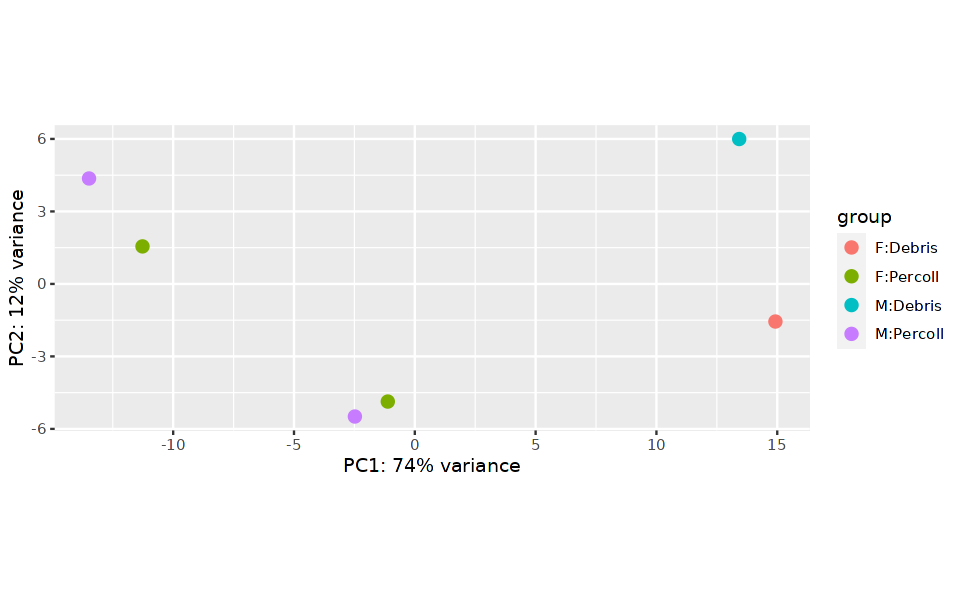

In [724]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [725]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

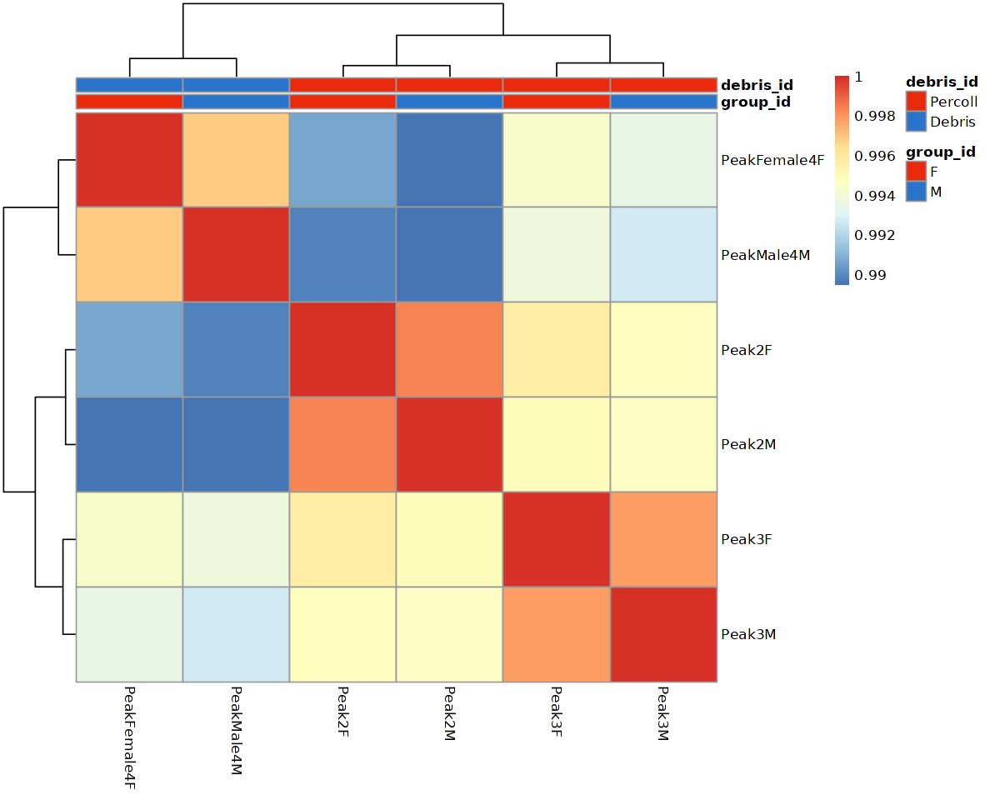

In [726]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [727]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [728]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


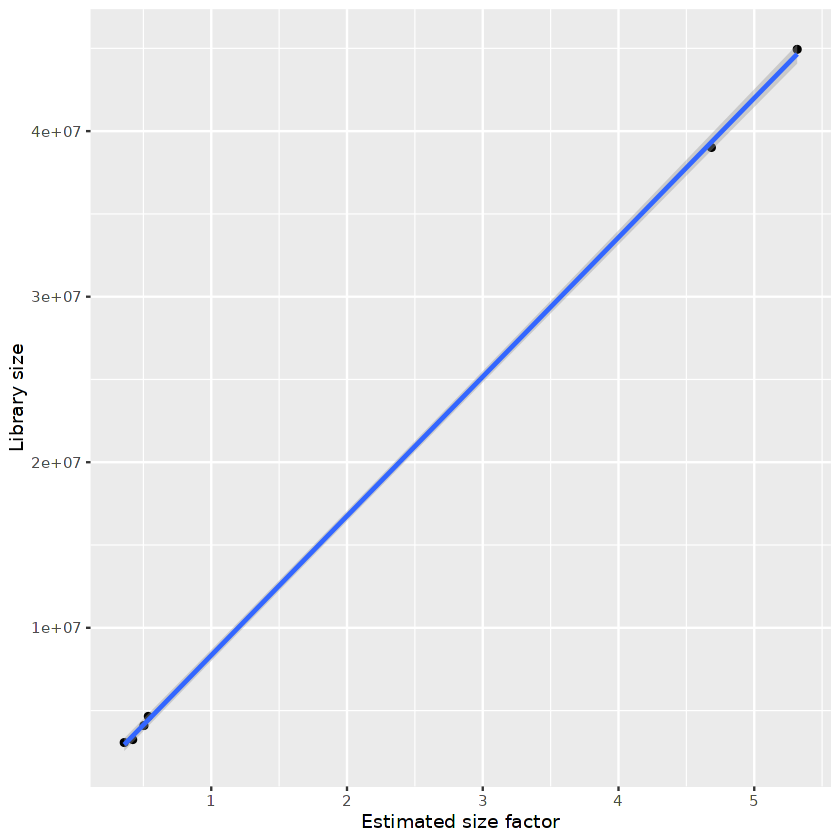

In [729]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [730]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Peak2F,MOL,Peak2F,F,Percoll,0.3587921
Peak2M,MOL,Peak2M,M,Percoll,0.5362411
Peak3F,MOL,Peak3F,F,Percoll,0.5041417
Peak3M,MOL,Peak3M,M,Percoll,0.4213419
PeakFemale4F,MOL,PeakFemale4F,F,Debris,5.3165614
PeakMale4M,MOL,PeakMale4M,M,Debris,4.6843690


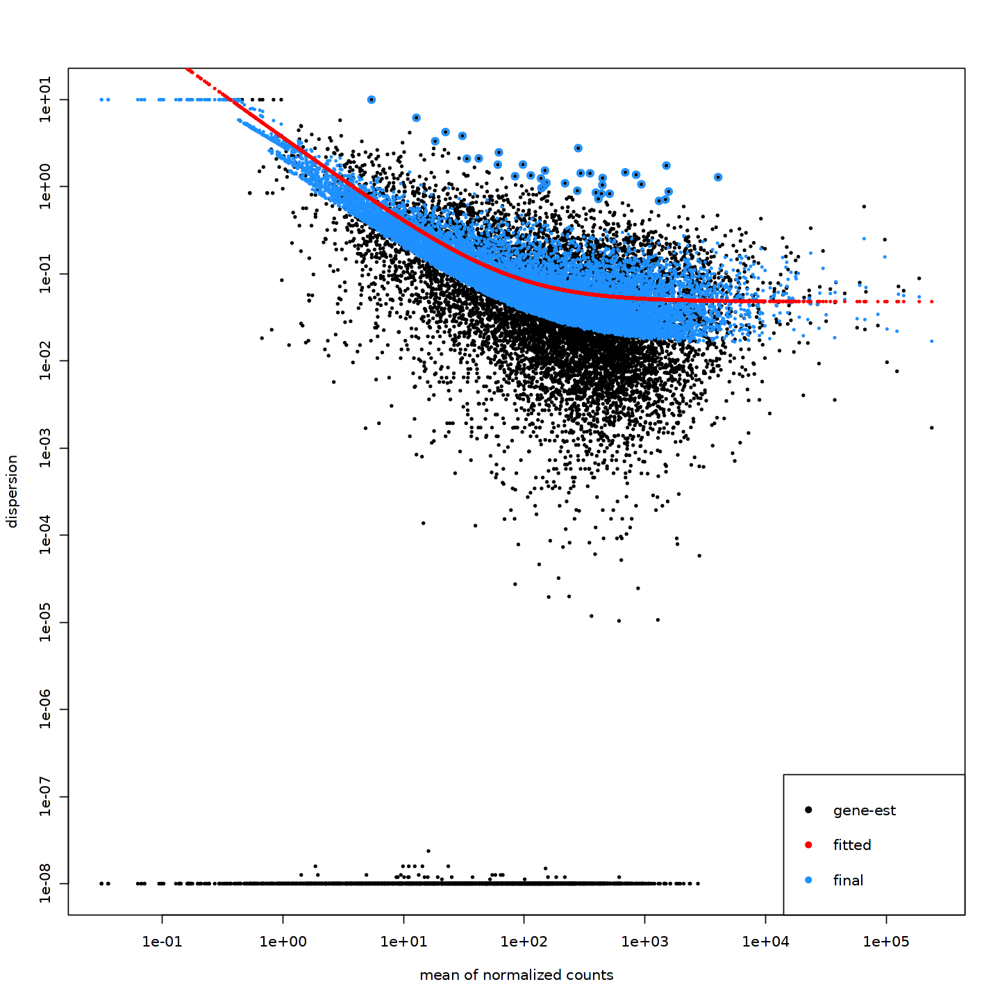

In [731]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [732]:
condition1 = "M"
condition2 = "F"

In [733]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [734]:
summary(res)


out of 13858 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 5, 0.036%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



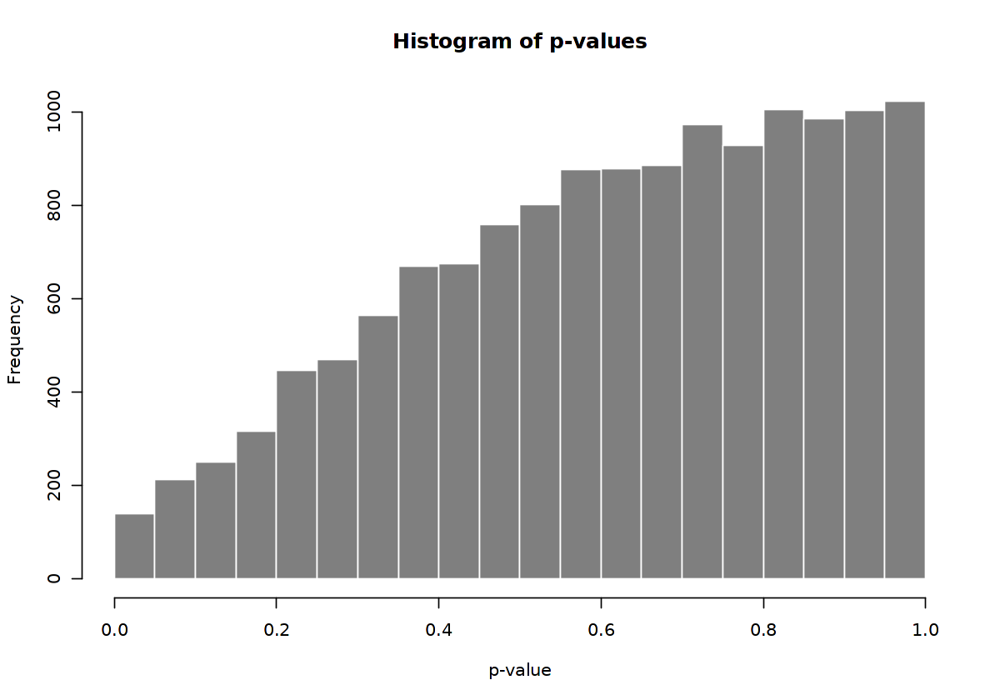

In [735]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

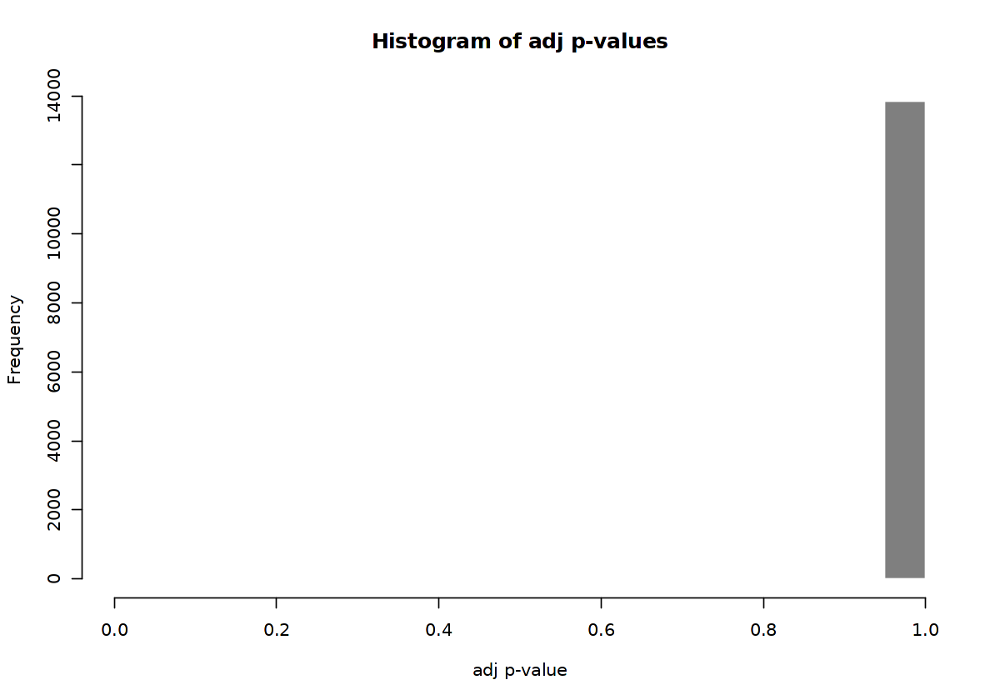

In [736]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

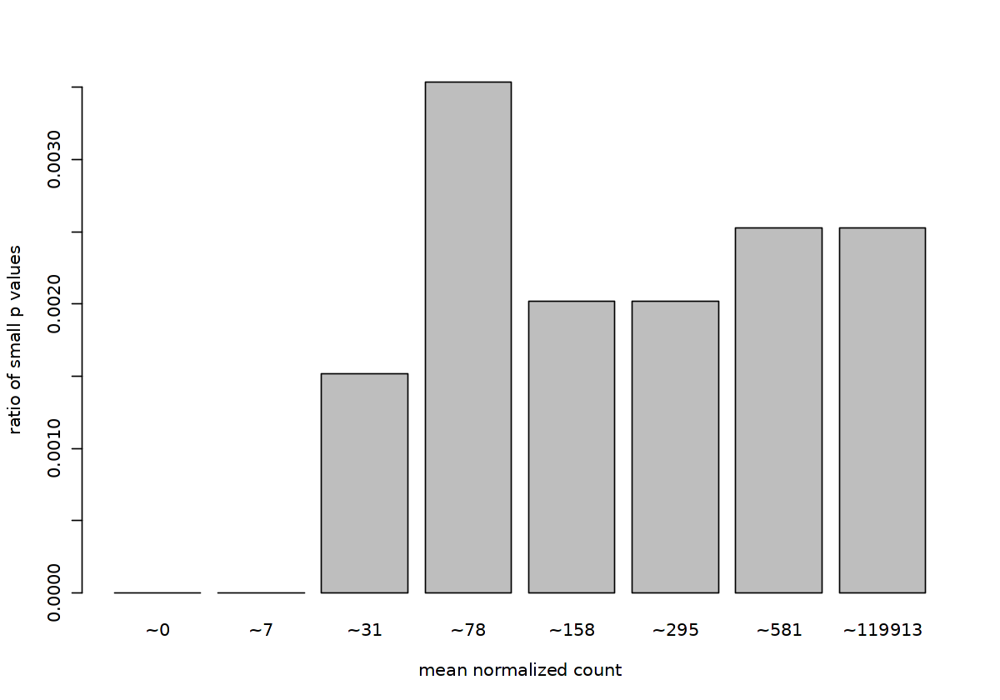

In [737]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

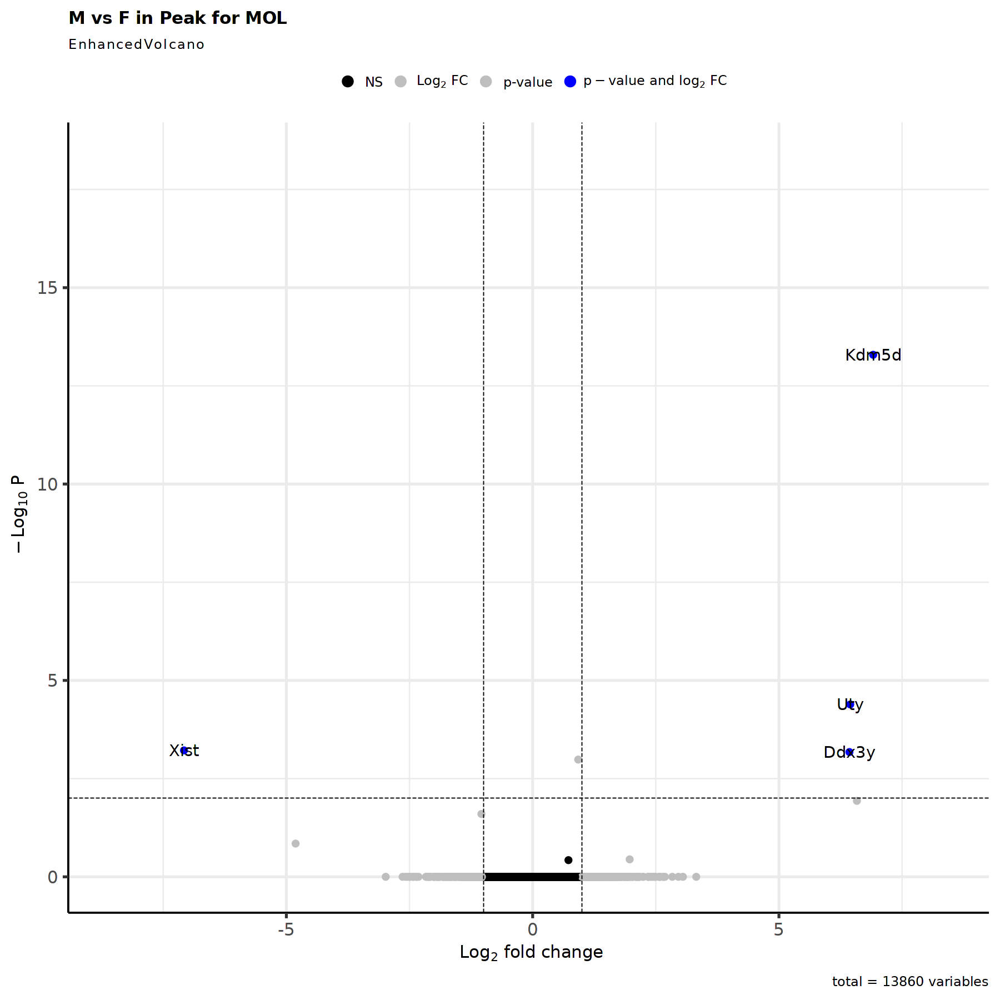

In [738]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [739]:
res <- res[complete.cases(res$padj),]

In [740]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [741]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 4 rows and 6 columns
       baseMean log2FoldChange     lfcSE      stat      pvalue        padj
      <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   4050.028       -7.07803  1.341122  -5.27769 1.30821e-07 6.04305e-04
Kdm5d   136.229        6.91364  0.795781   8.68787 3.69290e-18 5.11762e-14
Uty     510.483        6.44752  1.107886   5.81966 5.89678e-09 4.08588e-05
Ddx3y   444.218        6.43096  1.235126   5.20672 1.92205e-07 6.65894e-04

In [742]:
nrow(res_filtered)

[1] 4

In [743]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [744]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [745]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [746]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


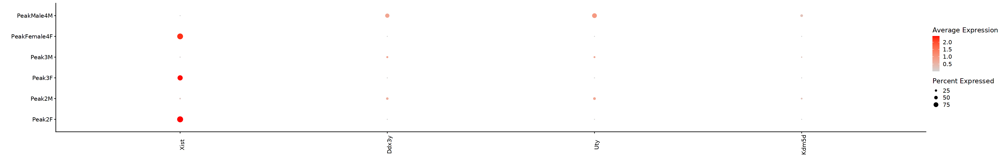

In [747]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

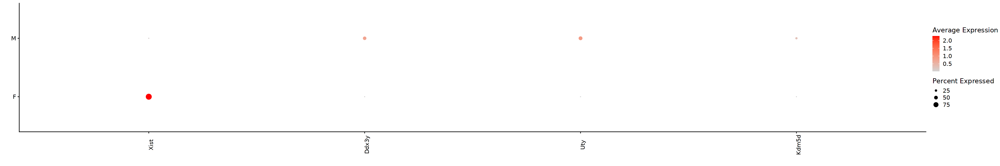

In [748]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [749]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.4.2 OPC

In [750]:
cluster_choice <- "OPC"

In [751]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Peak2M 
     4

In [752]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [753]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [754]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [755]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Peak2F,OPC,Peak2F,F,Percoll
Peak3F,OPC,Peak3F,F,Percoll
Peak3M,OPC,Peak3M,M,Percoll
PeakFemale4F,OPC,PeakFemale4F,F,Debris
PeakMale4M,OPC,PeakMale4M,M,Debris


In [756]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [757]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [758]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

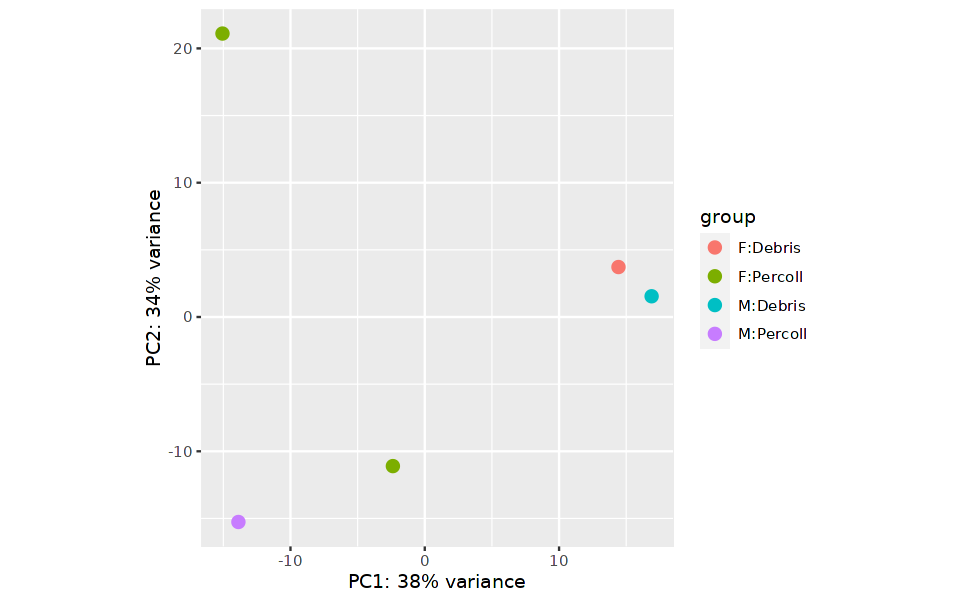

In [759]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [760]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

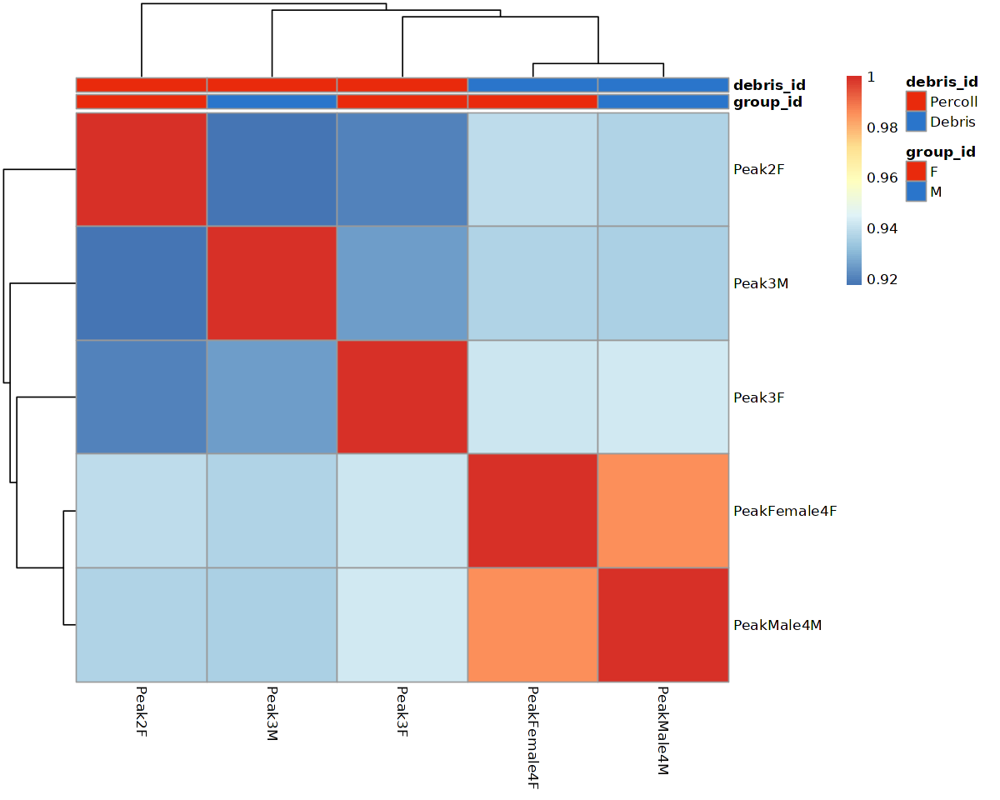

In [761]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [762]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [763]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


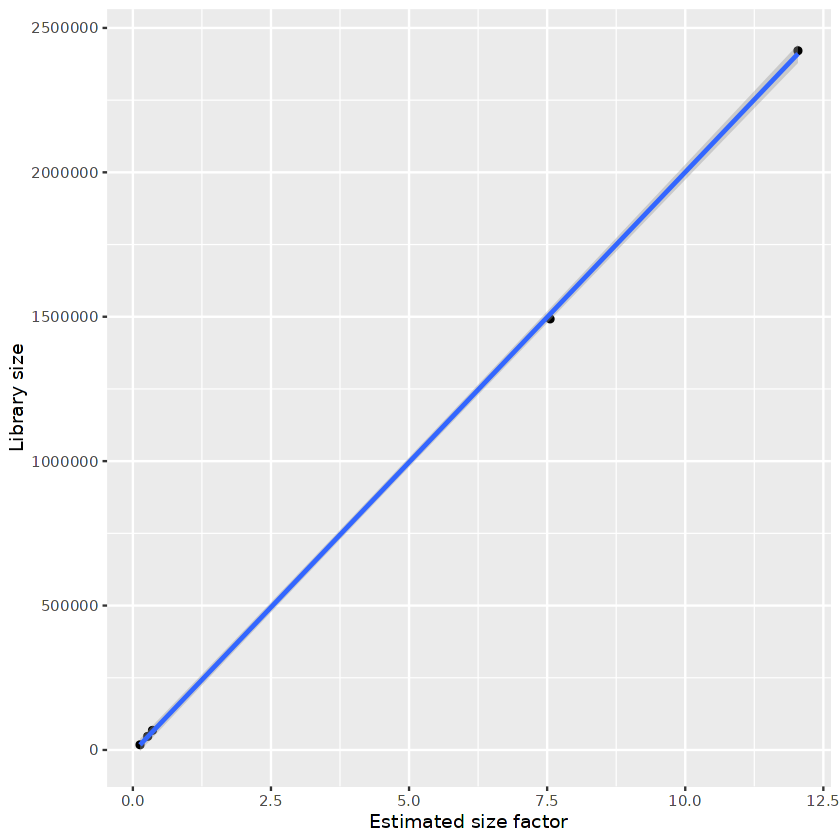

In [764]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [765]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Peak2F,OPC,Peak2F,F,Percoll,0.3546000
Peak3F,OPC,Peak3F,F,Percoll,0.2686546
Peak3M,OPC,Peak3M,M,Percoll,0.1290201
PeakFemale4F,OPC,PeakFemale4F,F,Debris,7.5533936
PeakMale4M,OPC,PeakMale4M,M,Debris,12.0405545


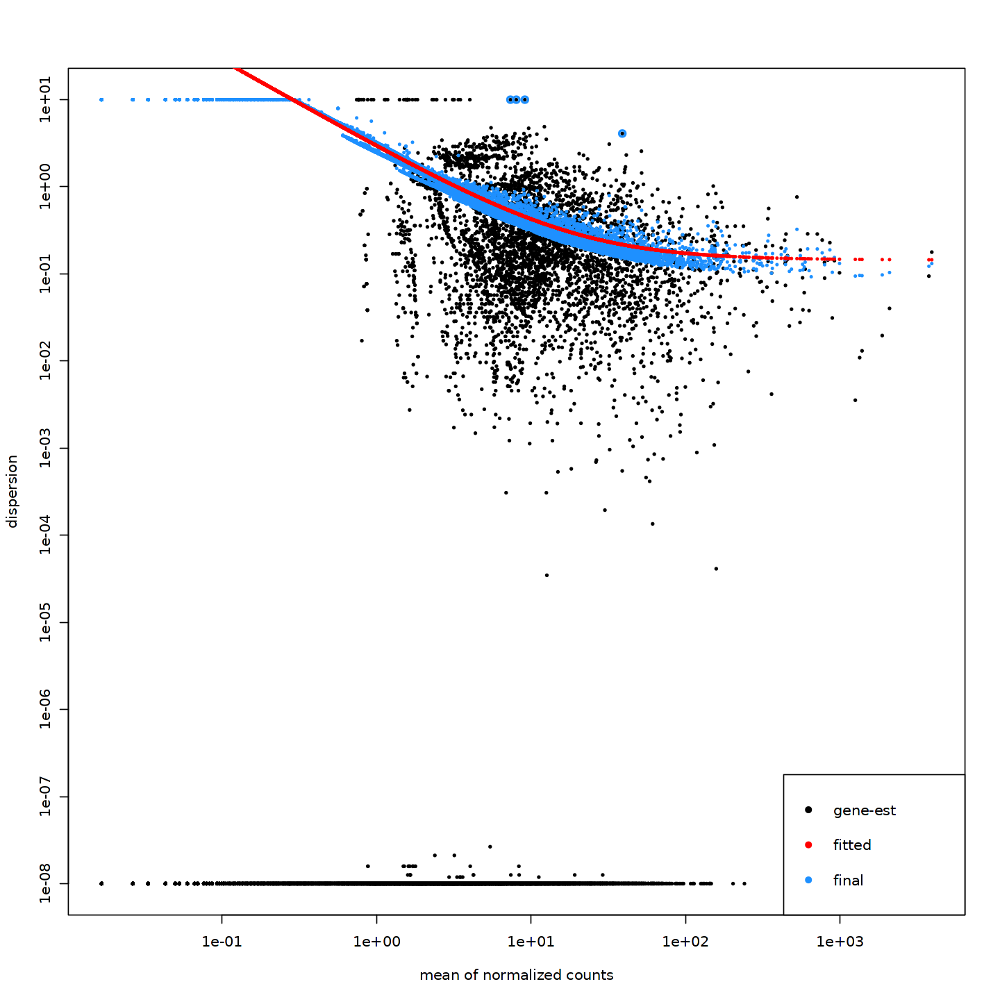

In [766]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [767]:
condition1 = "M"
condition2 = "F"

In [768]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [769]:
summary(res)


out of 13633 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 0, 0%
LFC < 0 (down)     : 1, 0.0073%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



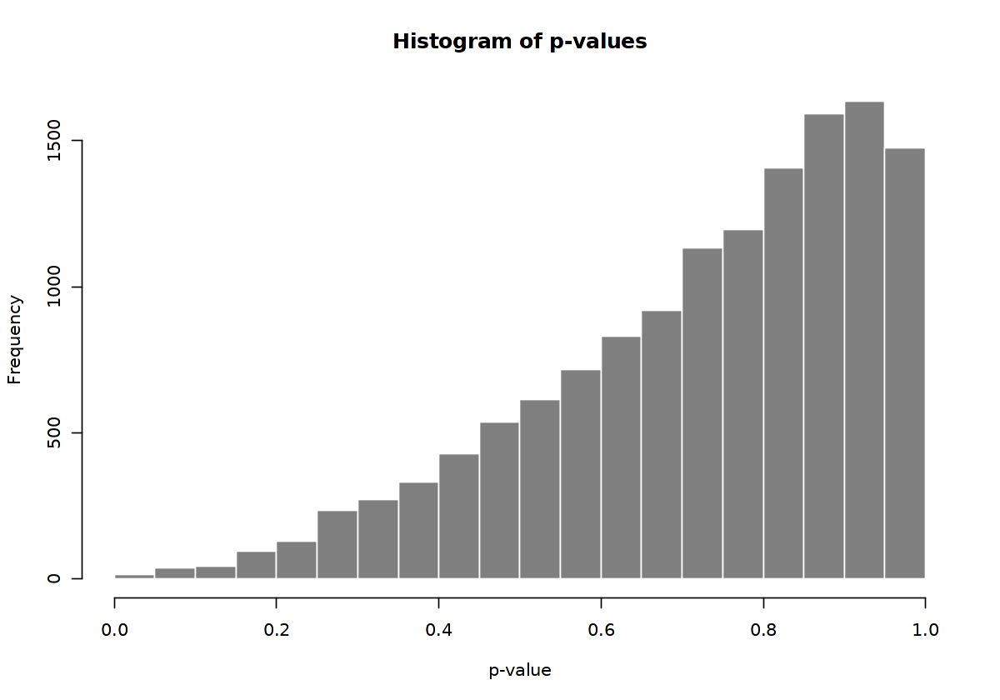

In [770]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

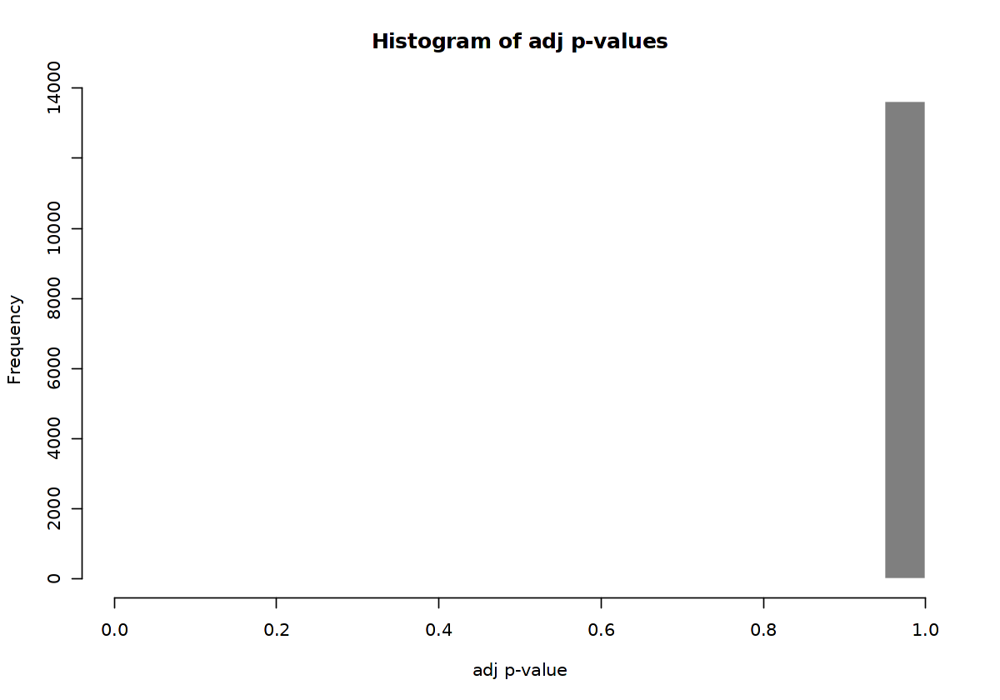

In [771]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

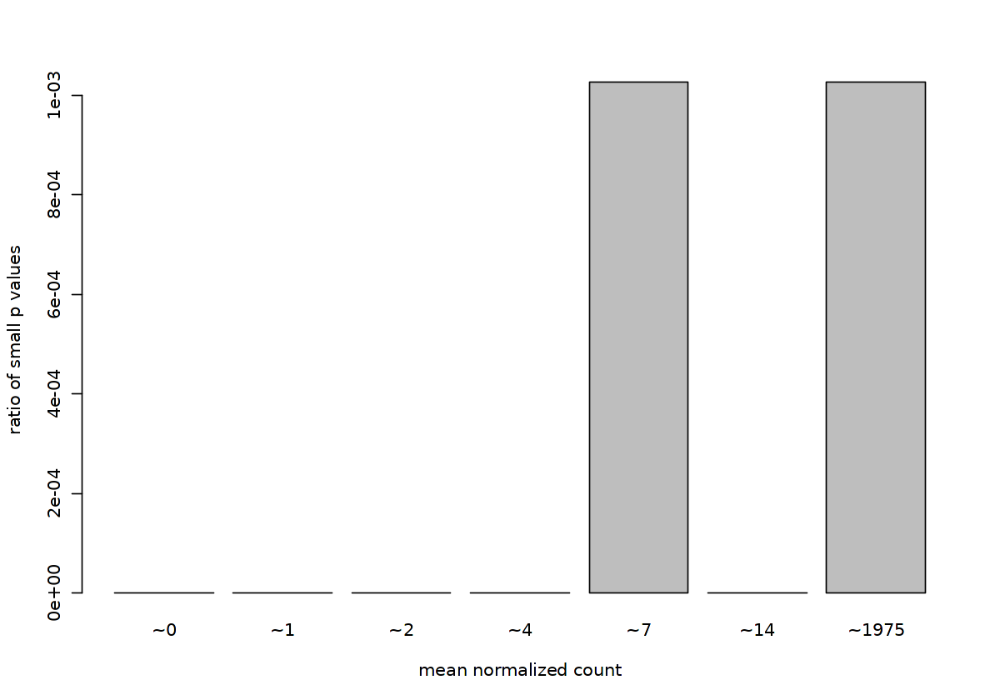

In [772]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

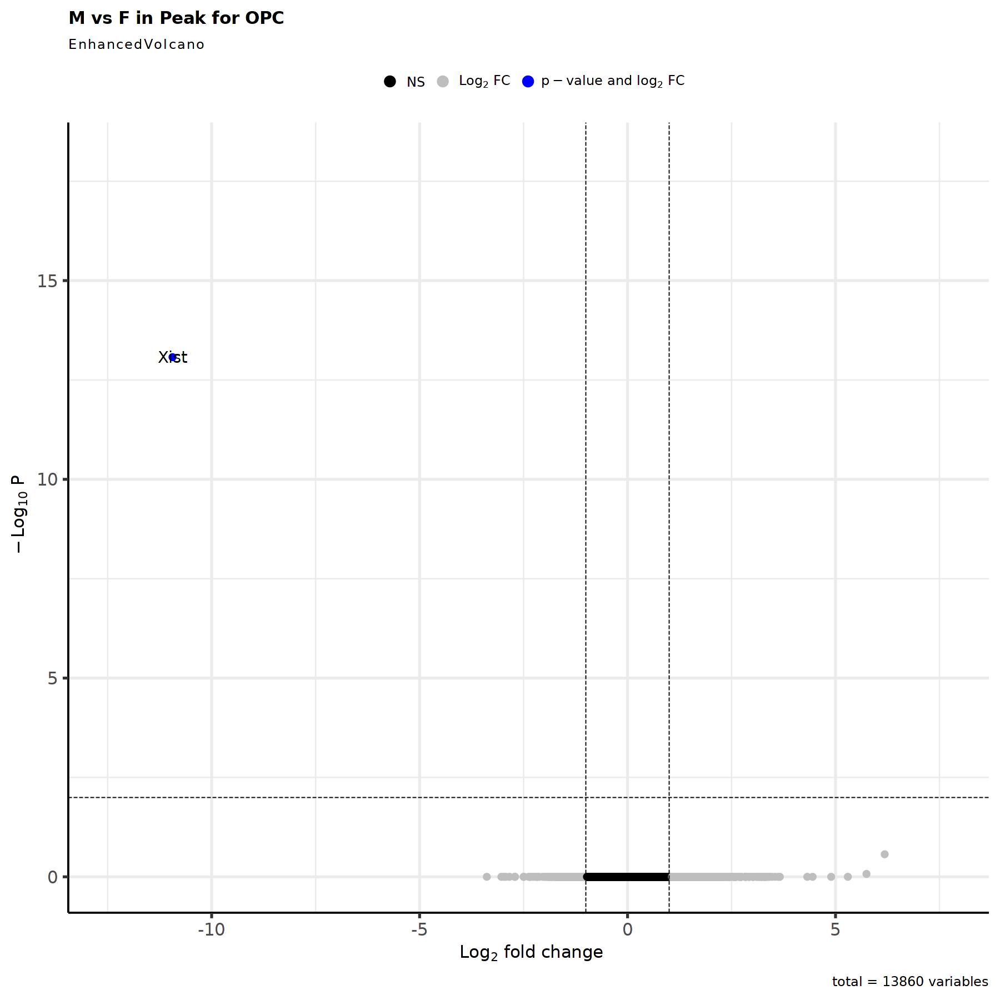

In [773]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [774]:
res <- res[complete.cases(res$padj),]

In [775]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [776]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat      pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   155.238        -10.941   1.26792  -8.62913 6.18221e-18 8.42821e-14

In [777]:
nrow(res_filtered)

[1] 1

In [778]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [779]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [780]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [781]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


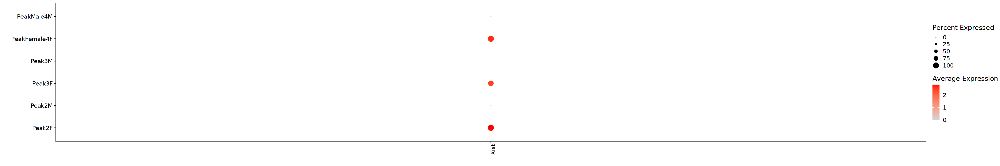

In [782]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

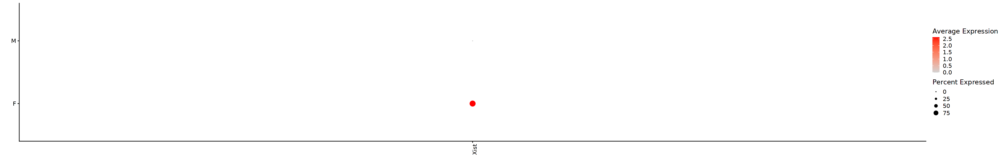

In [783]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [784]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.4.3 Micro

In [785]:
cluster_choice <- "Micro"

In [786]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [787]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [788]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [789]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [790]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Peak2F,Micro,Peak2F,F,Percoll
Peak2M,Micro,Peak2M,M,Percoll
Peak3F,Micro,Peak3F,F,Percoll
Peak3M,Micro,Peak3M,M,Percoll
PeakFemale4F,Micro,PeakFemale4F,F,Debris
PeakMale4M,Micro,PeakMale4M,M,Debris


In [791]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [792]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [793]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

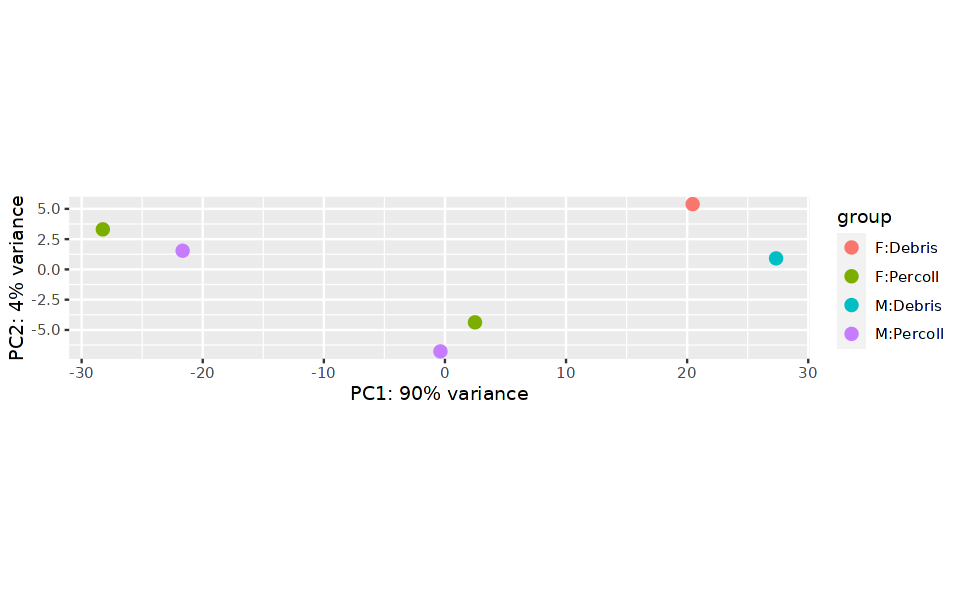

In [794]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [795]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

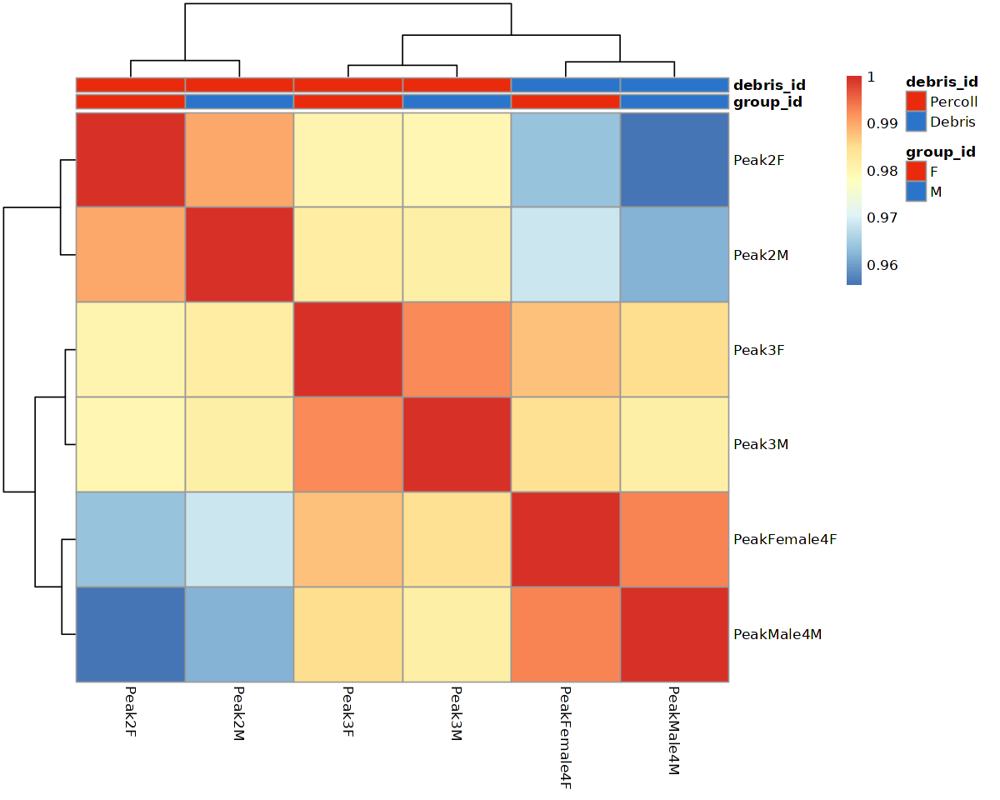

In [796]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [797]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [798]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


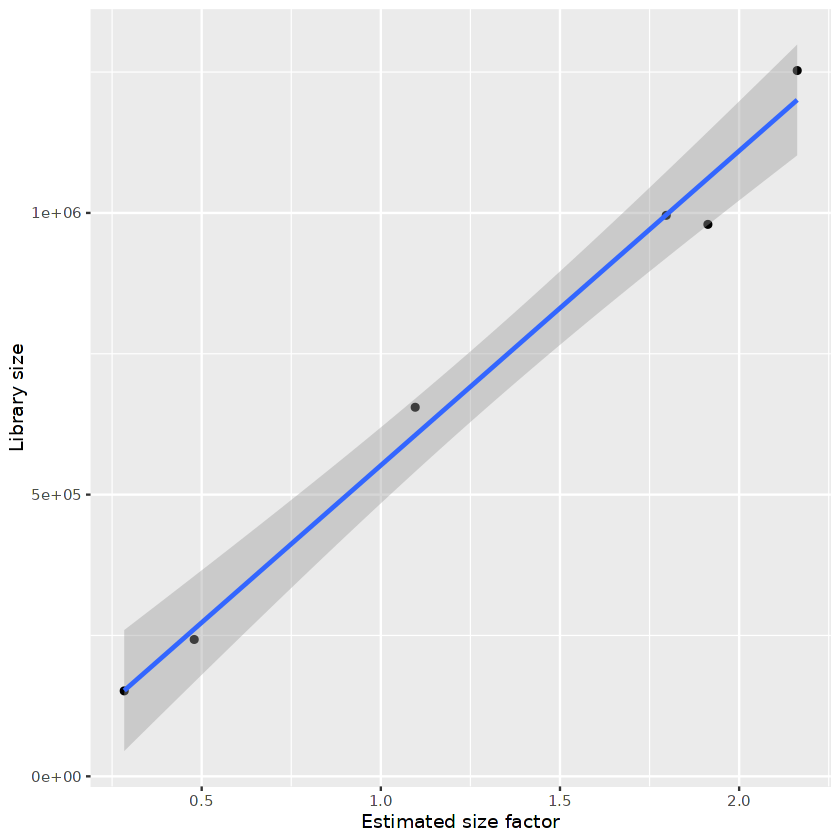

In [799]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [800]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Peak2F,Micro,Peak2F,F,Percoll,1.0959041
Peak2M,Micro,Peak2M,M,Percoll,0.2837704
Peak3F,Micro,Peak3F,F,Percoll,1.9127815
Peak3M,Micro,Peak3M,M,Percoll,0.4791338
PeakFemale4F,Micro,PeakFemale4F,F,Debris,1.7965625
PeakMale4M,Micro,PeakMale4M,M,Debris,2.1620893


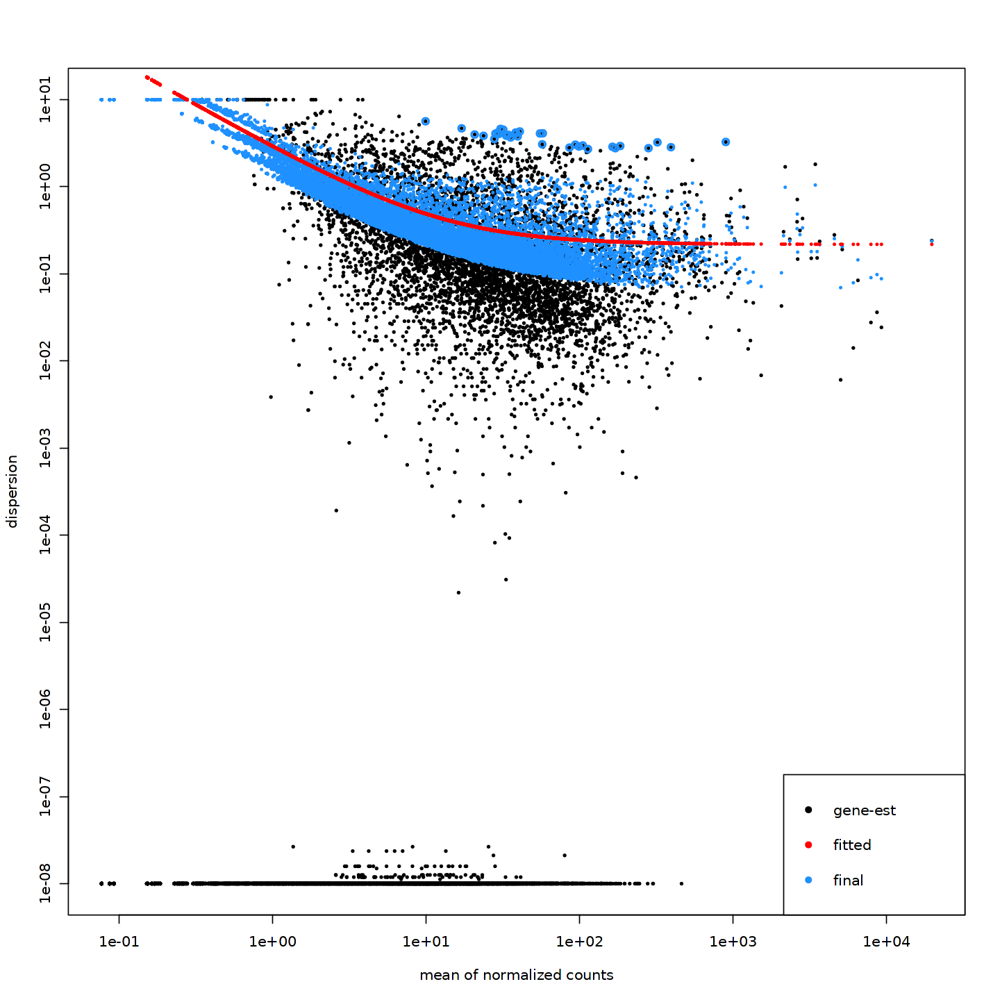

In [801]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [802]:
condition1 = "M"
condition2 = "F"

In [803]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [804]:
summary(res)


out of 13601 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 1, 0.0074%
LFC < 0 (down)     : 2, 0.015%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



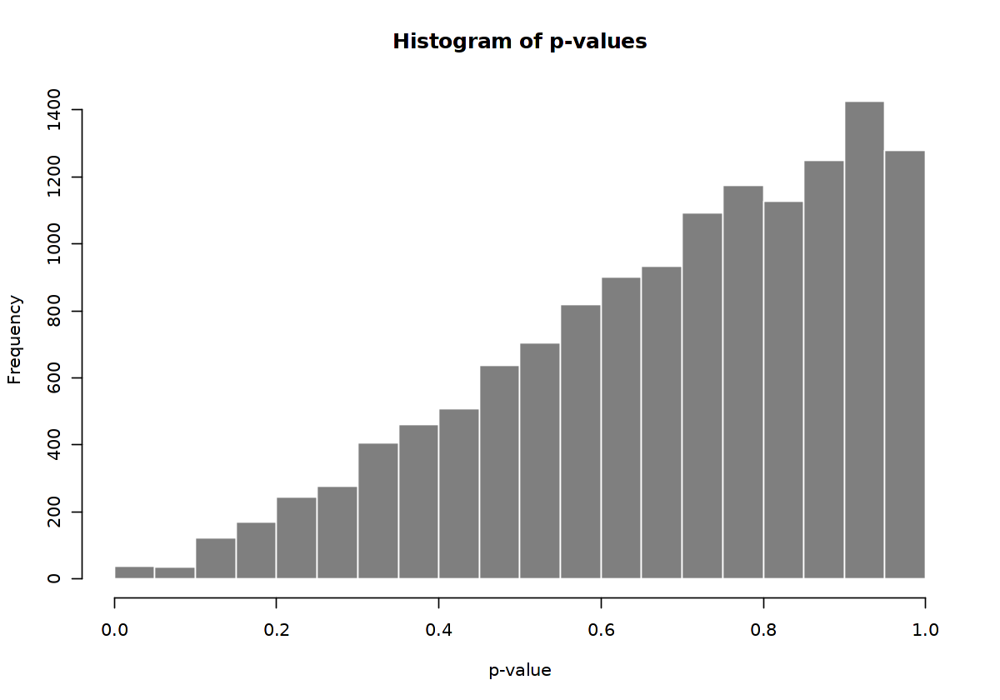

In [805]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

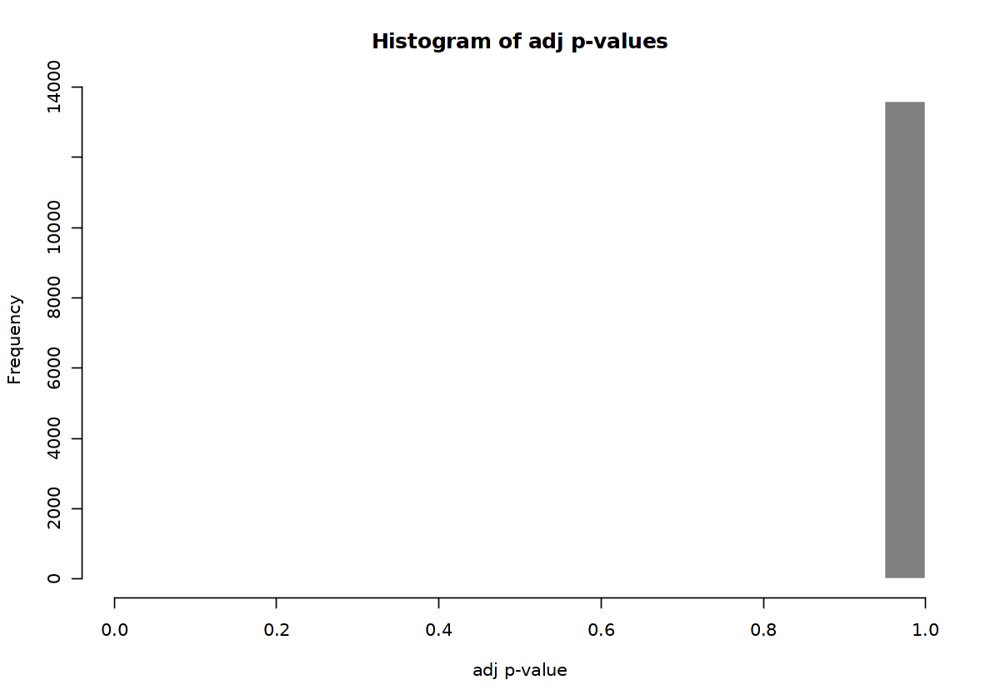

In [806]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

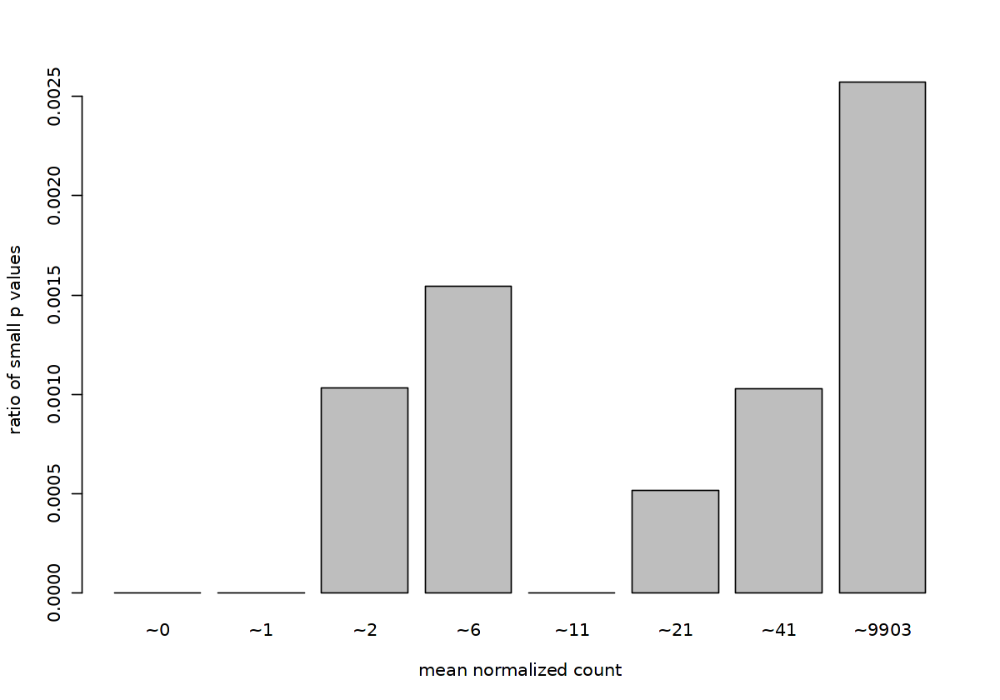

In [807]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

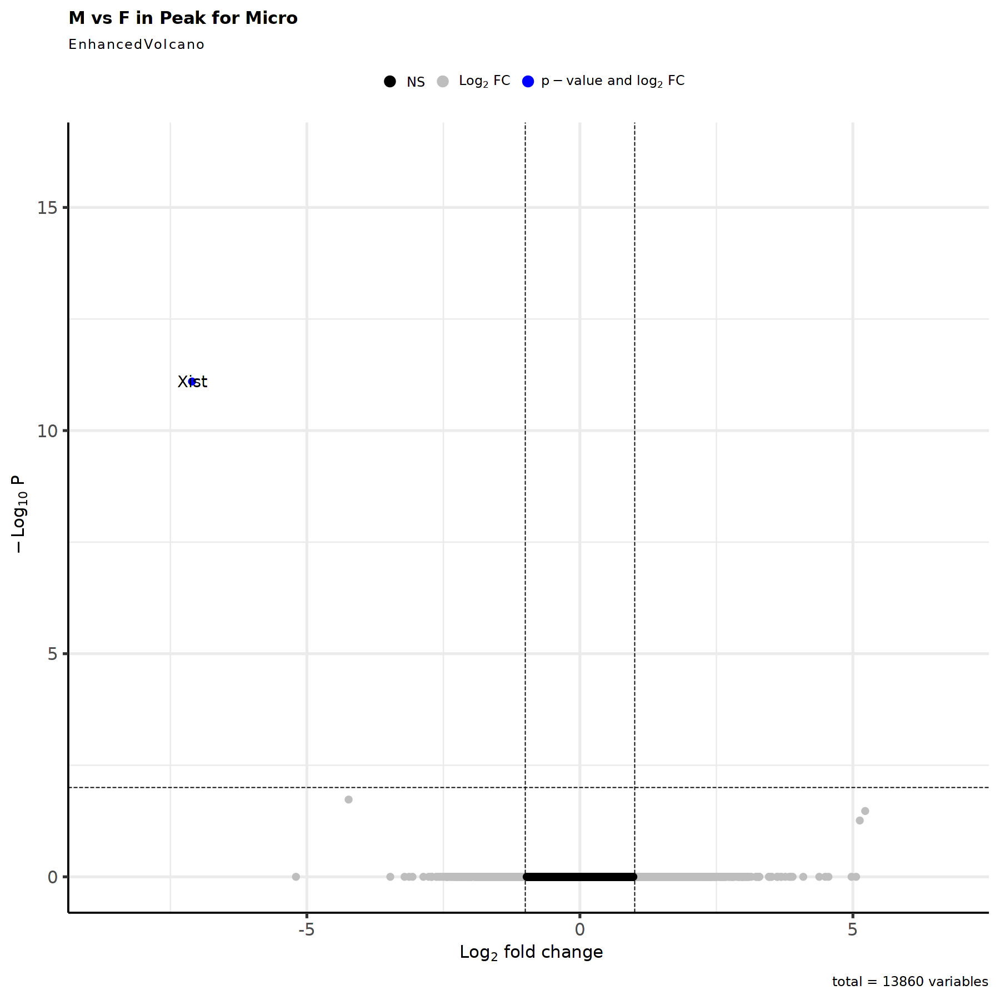

In [808]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [809]:
res <- res[complete.cases(res$padj),]

In [810]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [811]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 1 row and 6 columns
      baseMean log2FoldChange     lfcSE      stat     pvalue        padj
     <numeric>      <numeric> <numeric> <numeric>  <numeric>   <numeric>
Xist   302.396       -7.10311   0.87775   -8.0924 5.8501e-16 7.95672e-12

In [812]:
nrow(res_filtered)

[1] 1

In [813]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [814]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [815]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [816]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


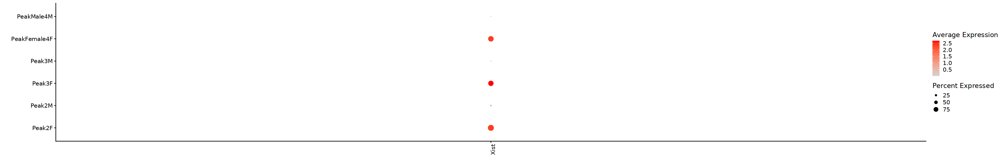

In [817]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

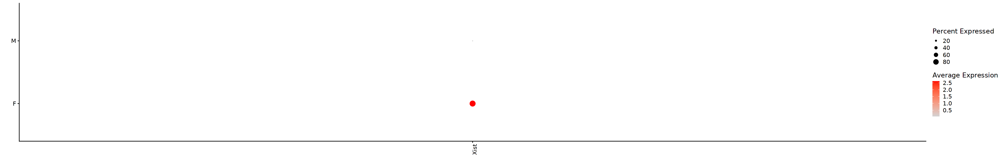

In [818]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [819]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.4.4 Astro

In [820]:
cluster_choice <- "Astro"

In [821]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Peak2F Peak3M 
     0      3

In [822]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

F  M 
17 26

In [823]:
#Not enough cells

##### 3.2.4.5 Summary

In [824]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

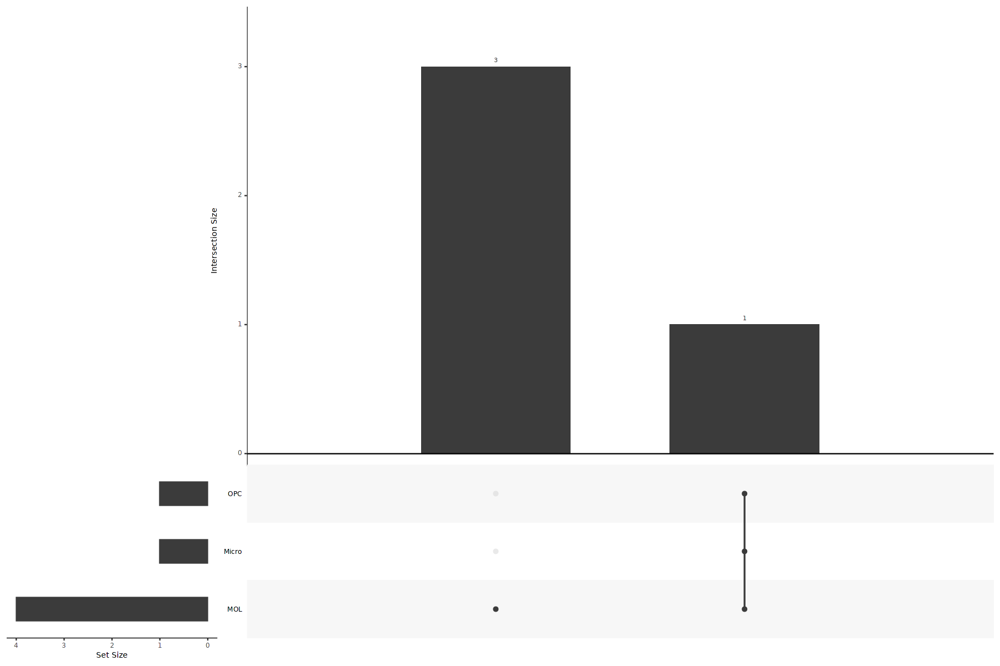

In [825]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [826]:
HVF <- unique(unlist(HVGs.list))

In [827]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [828]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [829]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [830]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [831]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [832]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [833]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [834]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


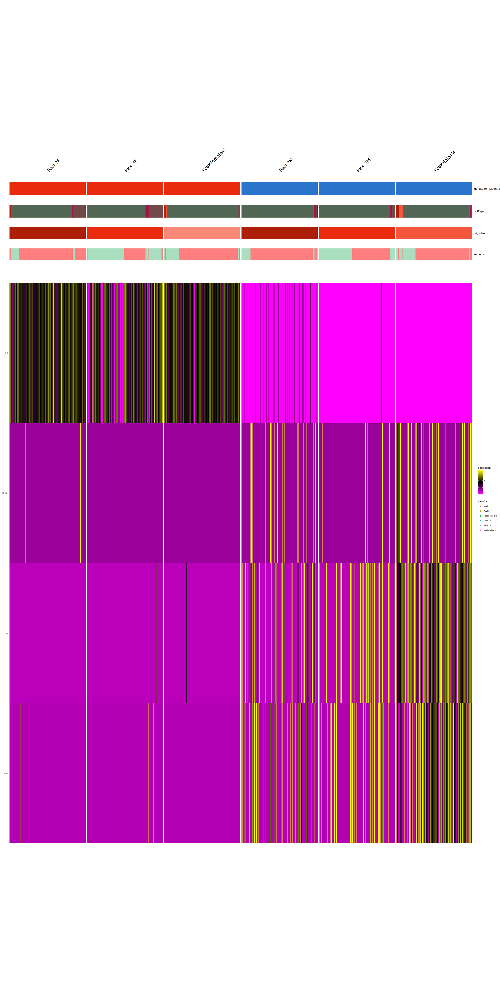

In [835]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    slot = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [836]:
sample_names <- levels(tmp$orig.ident_Sex)

In [837]:
Idents(object = tmp) <- "Sex"

In [838]:
gene_list <- HVF

In [839]:
tmp_markers <- data.frame(matrix(ncol=length(names(sub_timepoint_Sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sub_timepoint_Sex_colors)))))

In [840]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_Sex == names(sub_timepoint_Sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [841]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [842]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [843]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

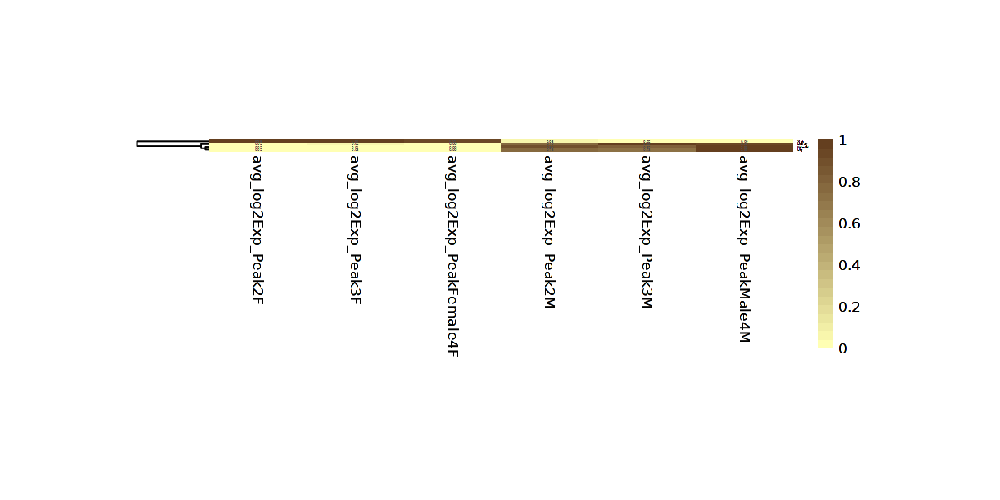

In [844]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [845]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [846]:
gene_list <- gene_list[ph$tree_row$order]

In [847]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [848]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [849]:
matrix <- tmp_markers_mean

In [850]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

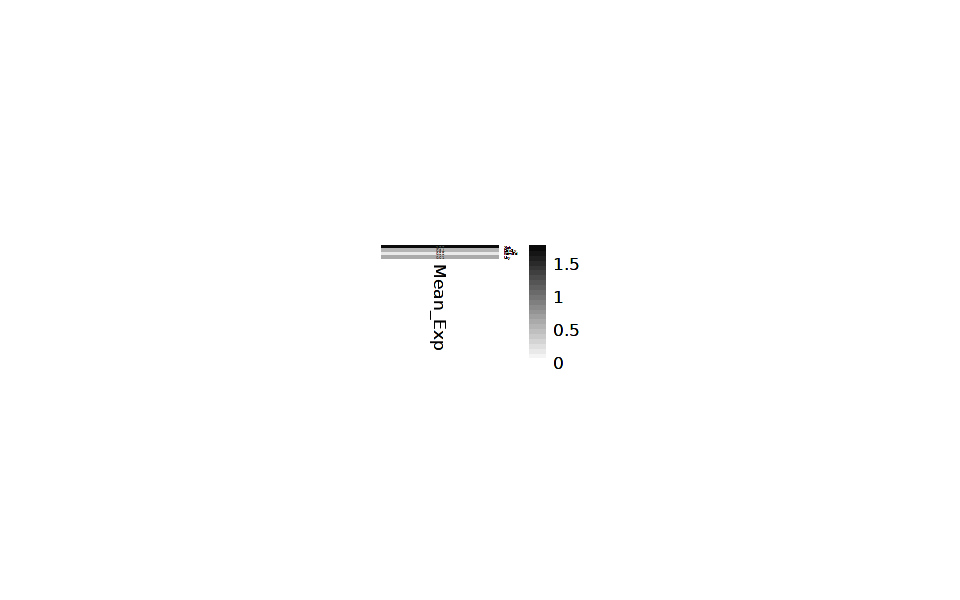

In [851]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [852]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [853]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [854]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

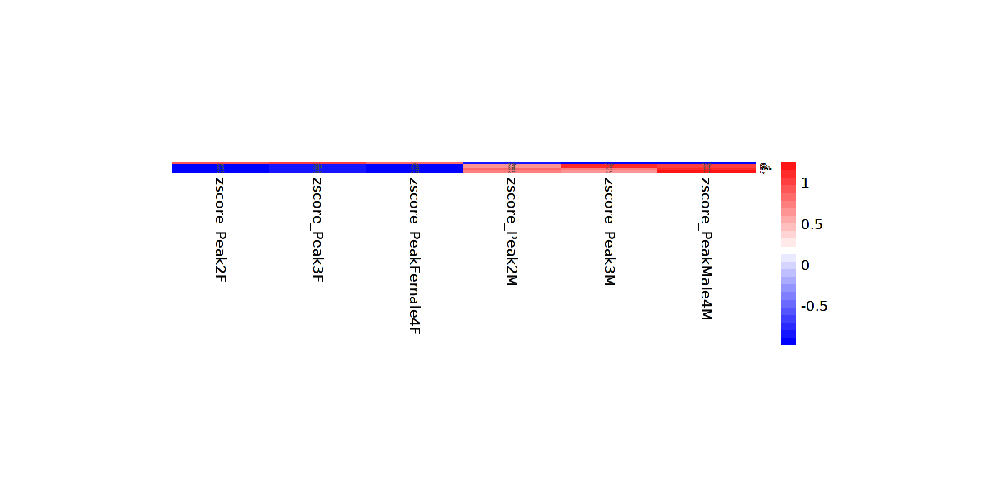

In [855]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [856]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [857]:
gene_list <- HVF

In [858]:
tmp_markers <- data.frame(matrix(ncol=length(names(sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sex_colors)))))

In [859]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = Sex == names(sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [860]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [861]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [862]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

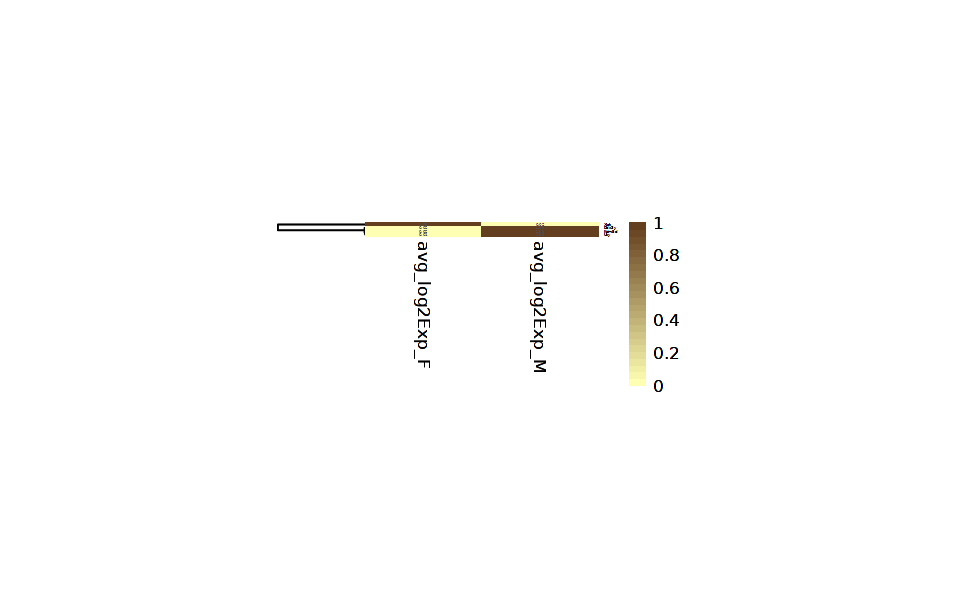

In [863]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [864]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [865]:
gene_list <- gene_list[ph$tree_row$order]

In [866]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [867]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [868]:
matrix <- tmp_markers_mean

In [869]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

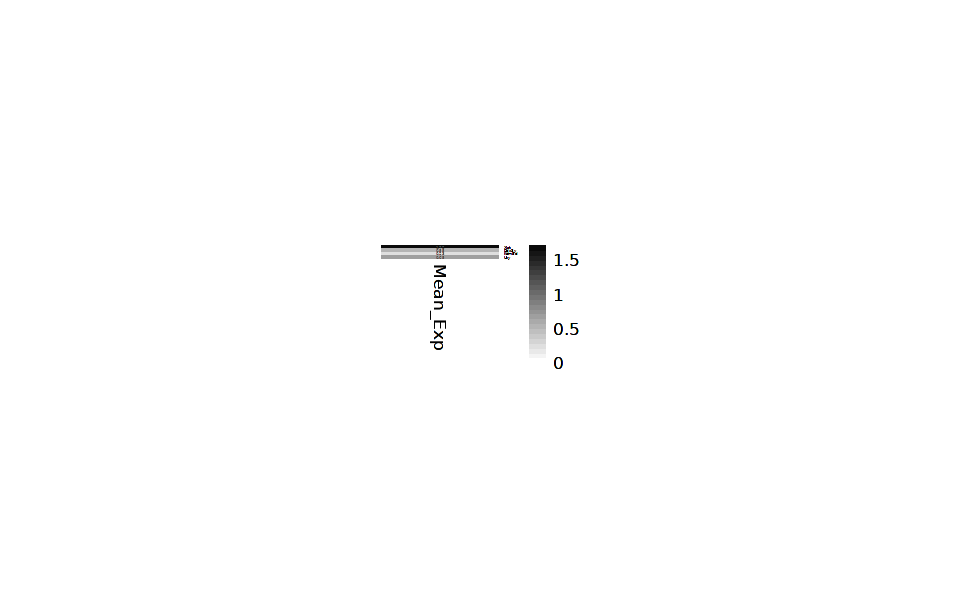

In [870]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [871]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [872]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [873]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

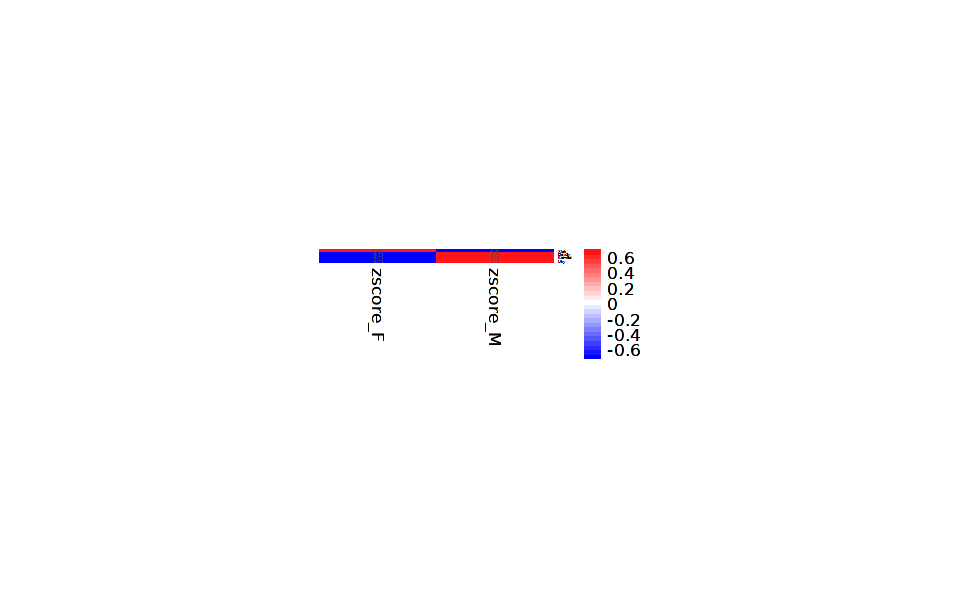

In [874]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [875]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

#### 3.2.5 Late

In [876]:
timepoint <- "Late"
name_timepoint <- names_Late

In [877]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == timepoint)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


In [878]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [879]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [880]:
timepoint_Sex_colors <- c(rep(sex_colors["F"], length(name_timepoint)),rep(sex_colors["M"], length(name_timepoint)))
df_timepoint_Sex <- expand.grid(name_timepoint, names(sex_colors))
names(timepoint_Sex_colors) <- paste0(df_timepoint_Sex[,1],df_timepoint_Sex[,2])

In [881]:
tmp$orig.ident_Sex <- paste0(tmp$orig.ident,tmp$Sex)
tmp$orig.ident_Sex <- factor(paste0(tmp$orig.ident,tmp$Sex), levels=names(table(tmp$orig.ident_Sex)))

In [882]:
tmp$orig.ident <- factor(tmp$orig.ident, levels=name_timepoint)
tmp$cellType <- factor(tmp$cellType, levels=names(cellType_colors))
tmp$Sex <- factor(tmp$Sex, levels=names(sex_colors))

In [883]:
table(tmp$cellType, tmp$orig.ident_Sex)

        
         Late1F Late1M Late2F Late2M Late3F Late3M LateFemale4F LateMale4M
  OPC         2      5     12     65      9     12          512        203
  COP         0      2      0     10      4      8          313        260
  MOL      1460   3028    597    802   1280   2696         9083       4494
  Astro       7      6      6      0      5     13           20          7
  Epen        5      3      5      2      2     13           66         39
  Micro      26     23     67    134    128    237          148         83
  Neuron      5      3      0      0      0      3            2          1
  Peric       0      0      1      2      0      1            2          0

In [884]:
table(tmp$cellType, tmp$Sex)

        
             F     M
  OPC      535   285
  COP      317   280
  MOL    12420 11020
  Astro     38    26
  Epen      78    57
  Micro    369   477
  Neuron     7     7
  Peric      3     3

In [885]:
table(tmp$orig.ident_Sex, tmp$Sex)

              
                   F     M
  Late1F        1505     0
  Late1M           0  3070
  Late2F         688     0
  Late2M           0  1015
  Late3F        1428     0
  Late3M           0  2983
  LateFemale4F 10146     0
  LateMale4M       0  5087

In [886]:
MORNAATACC_sce <- as.SingleCellExperiment(tmp, assay="RNA")

In [887]:
MORNAATACC_sce <- prepSCE(MORNAATACC_sce, kid = "cellType", gid = "Sex", sid = "orig.ident_Sex", drop = FALSE)

In [888]:
kids <- purrr::set_names(levels(MORNAATACC_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACC_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [889]:
kids <- kids[names(kids)!="Neuron"]

In [890]:
kids
sids

OPC     COP     MOL   Astro    Epen   Micro   Peric 
  "OPC"   "COP"   "MOL" "Astro"  "Epen" "Micro" "Peric"

Late1F         Late1M         Late2F         Late2M         Late3F         Late3M 
      "Late1F"       "Late1M"       "Late2F"       "Late2M"       "Late3F"       "Late3M" 
  LateFemale4F     LateMale4M 
"LateFemale4F"   "LateMale4M"

In [891]:
## Determine the number of cells per sample
table(MORNAATACC_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACC_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACC_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACC_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      Late1F       Late1M       Late2F       Late2M       Late3F       Late3M LateFemale4F 
        1505         3070          688         1015         1428         2983        10146 
  LateMale4M 
        5087 

sample_id,group_id,orig.ident,orig.ident_merge,batch,model,debrisRemoval,date_tissue_collection,nbMouse,EAE_score_mean,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nCount_peaks,nFeature_peaks,nCount_GenePromAcc,nFeature_GenePromAcc,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,FRiP,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score1,Sex_predictions,Sex_predictions_F,Sex_predictions_M,seurat_clusters_RNA,seurat_clusters_peaks,seurat_clusters_BiMod,snn_RNA_res.2,snn_peaks_res.1.5,wsnn_res.1.7,RNA.weight.name,peaks.weight.name,⋯,zscore_Naive.Tcell_cd8,pvalue_Naive.Tcell_cd8,Immune.Tcell_cd8,ImmuneScoreGenePromAcc,ImmuneScoreScaledGenePromAcc,zscore_NaiveGenePromAcc,pvalue_NaiveGenePromAcc,ImmuneGenePromAcc,ImmuneScoreGenePromAcc.complement,ImmuneScoreScaledGenePromAcc.complement,zscore_NaiveGenePromAcc.complement,pvalue_NaiveGenePromAcc.complement,ImmuneGenePromAcc.complement,ImmuneScoreGenePromAcc.pos_reg_imm_response,ImmuneScoreScaledGenePromAcc.pos_reg_imm_response,zscore_NaiveGenePromAcc.pos_reg_imm_response,pvalue_NaiveGenePromAcc.pos_reg_imm_response,ImmuneGenePromAcc.pos_reg_imm_response,ImmuneScoreGenePromAcc.neg_reg_imm_response,ImmuneScoreScaledGenePromAcc.neg_reg_imm_response,zscore_NaiveGenePromAcc.neg_reg_imm_response,pvalue_NaiveGenePromAcc.neg_reg_imm_response,ImmuneGenePromAcc.neg_reg_imm_response,ImmuneScoreGenePromAcc.antig_proc_presen,ImmuneScoreScaledGenePromAcc.antig_proc_presen,zscore_NaiveGenePromAcc.antig_proc_presen,pvalue_NaiveGenePromAcc.antig_proc_presen,ImmuneGenePromAcc.antig_proc_presen,ImmuneScoreGenePromAcc.pos_reg_int_media,ImmuneScoreScaledGenePromAcc.pos_reg_int_media,zscore_NaiveGenePromAcc.pos_reg_int_media,pvalue_NaiveGenePromAcc.pos_reg_int_media,ImmuneGenePromAcc.pos_reg_int_media,ImmuneScoreGenePromAcc.reg_cyto_prod,ImmuneScoreScaledGenePromAcc.reg_cyto_prod,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ident,n_cells
<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<dbl>
Late1F,F,Late1,Late,B2,EAE,Percoll,2021_05_31,2,2.25,4582,1961,22366,9726,13102,9514,20344,7895,31144,10748,12417,111039,4.321257,0.8993248,0.04321257,-0.004744399,-0.009085713,G1,0.004341314,0.8742711,0.93,4.309839,0.02,0.4206910,0.00000000,Singlet,0.0000000000,0.03470100,7.895,F,0.99995,0.00005,19,9,0,19,9,0,0.1165958,0.8834042,⋯,1.64618867,0.04986246,Immune,0.022130392,0.7874937,3.0509168,0.001140719,Immune,0.038734986,0.5671964,2.85080452,0.002180438,Immune,-0.023799009,0.3328632,-0.398403040,0.6548334,NonImmune,0.030874823,0.4856630,1.56590993,0.05868485,NonImmune,0.003417641,0.3929807,1.0647229,0.14350066,NonImmune,0.017646737,0.4459568,1.59264425,0.05562001,NonImmune,0.0305701161,0.4221282,1.80663509,0.03540960,Immune,0.0154245955,0.4240964,0.7950987,0.2132780,NonImmune,-0.024946233,0.2599198,-0.41265441,0.66007009,NonImmune,F,1505
Late1M,M,Late1,Late,B2,EAE,Percoll,2021_05_31,2,2.25,9776,3323,32337,12178,18126,11631,20768,8552

In [892]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACC_sce <- MORNAATACC_sce[rowSums(counts(MORNAATACC_sce) > 1) >= 10, ]

In [893]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACC_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACC_sce)), groupings = groups, fun = "sum") 

In [894]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [895]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 8
 $ Astro :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:49171] 0 6 7 8 10 12 13 15 17 20 ...
  .. ..@ p       : int [1:8] 0 7443 13621 19312 26595 34061 41853 49171
  .. ..@ Dim     : int [1:2] 14396 7
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14396] "Xkr4" "Gm1992" "Gm19938" "Rp1" ...
  .. .. ..$ : chr [1:7] "Late1F" "Late1M" "Late2F" "Late3F" ...
  .. ..@ x       : num [1:49171] 3 5 7 4 3 18 5 2 4 2 ...
  .. ..@ factors : list()
 $ COP   :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:57051] 10 12 13 27 34 42 45 50 54 58 ...
  .. ..@ p       : int [1:7] 0 2569 13044 20663 29862 43504 57051
  .. ..@ Dim     : int [1:2] 14396 6
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:14396] "Xkr4" "Gm1992" "Gm19938" "Rp1" ...
  .. .. ..$ : chr [1:6] "Late1M" "Late2M" "Late3F" "Late3M" ...
  .. ..@ x       : num [1:57051] 1 12 2 1 1 4 2 1 1 1 ...
  .. ..@ factors : list()
 $ Epen  :Formal class 'dgCMatrix'

In [896]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)

        
             F     M
  OPC      535   285
  COP      317   280
  MOL    12420 11020
  Astro     38    26
  Epen      78    57
  Micro    369   477
  Neuron     7     7
  Peric      3     3

In [897]:
options(width = 100)
table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)

        
         Late1F Late1M Late2F Late2M Late3F Late3M LateFemale4F LateMale4M
  OPC         2      5     12     65      9     12          512        203
  COP         0      2      0     10      4      8          313        260
  MOL      1460   3028    597    802   1280   2696         9083       4494
  Astro       7      6      6      0      5     13           20          7
  Epen        5      3      5      2      2     13           66         39
  Micro      26     23     67    134    128    237          148         83
  Neuron      5      3      0      0      0      3            2          1
  Peric       0      0      1      2      0      1            2          0

In [898]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [899]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [900]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACC_sce)$sample_id, colData(MORNAATACC_sce)$debrisRemoval, sep="_"))

In [901]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [902]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [903]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [904]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "Astro"  "COP"    "Epen"   "MOL"    "Micro"  "Neuron" "OPC"

In [905]:
HVGs.list <- list()

##### 3.2.5.1 MOL

In [906]:
cluster_choice <- "MOL"

In [907]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [908]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [909]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [910]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [911]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Late1F,MOL,Late1F,F,Percoll
Late1M,MOL,Late1M,M,Percoll
Late2F,MOL,Late2F,F,Percoll
Late2M,MOL,Late2M,M,Percoll
Late3F,MOL,Late3F,F,Percoll
Late3M,MOL,Late3M,M,Percoll
LateFemale4F,MOL,LateFemale4F,F,Debris
LateMale4M,MOL,LateMale4M,M,Debris


In [912]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [913]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [914]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

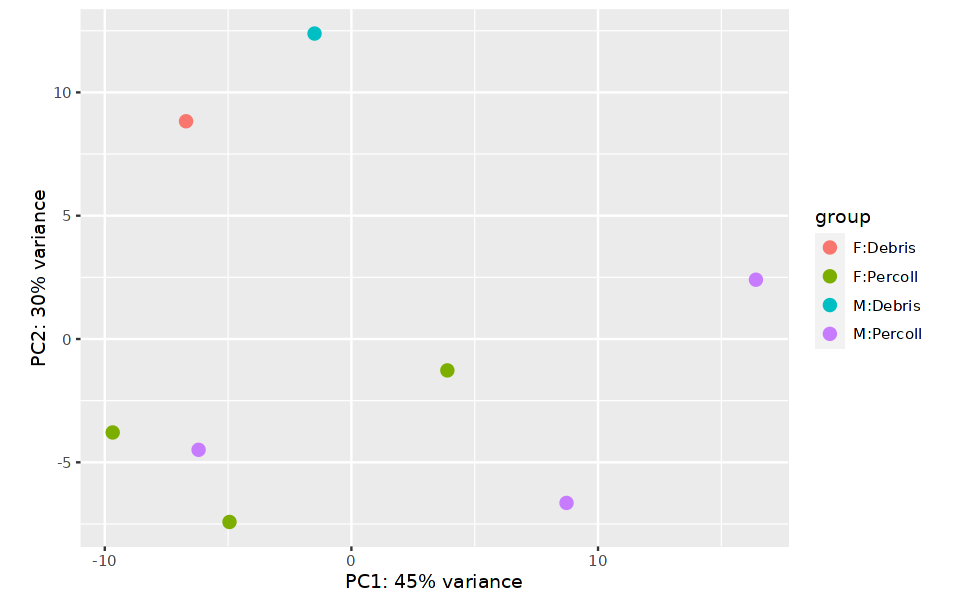

In [915]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [916]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

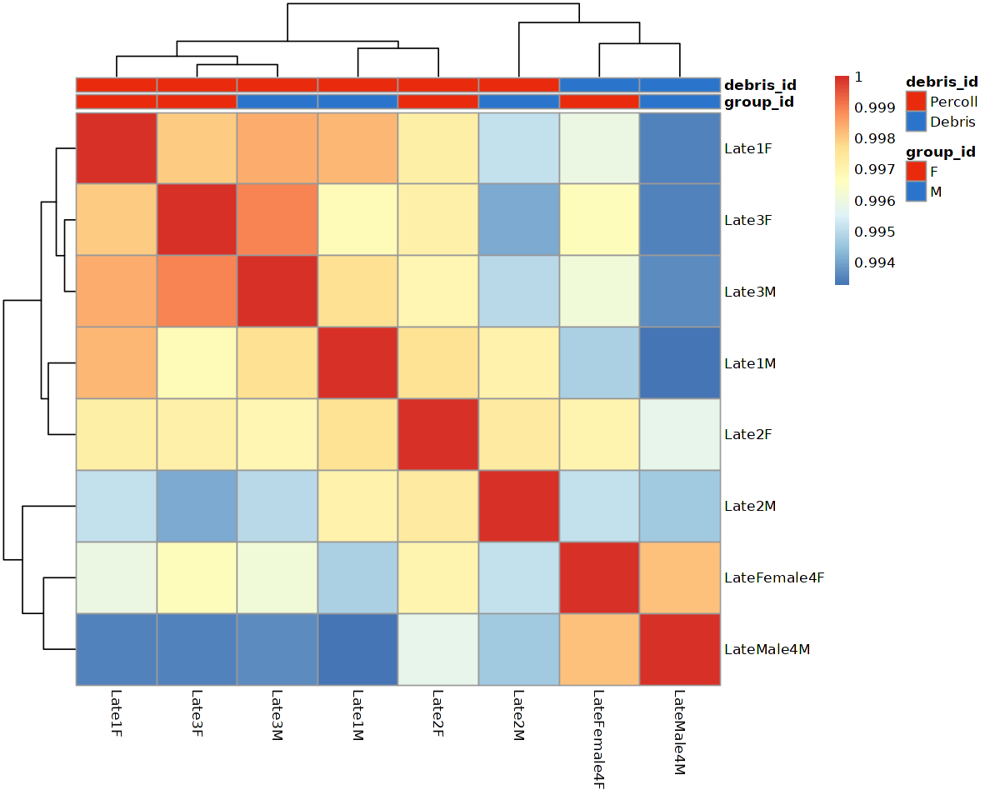

In [917]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [918]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [919]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


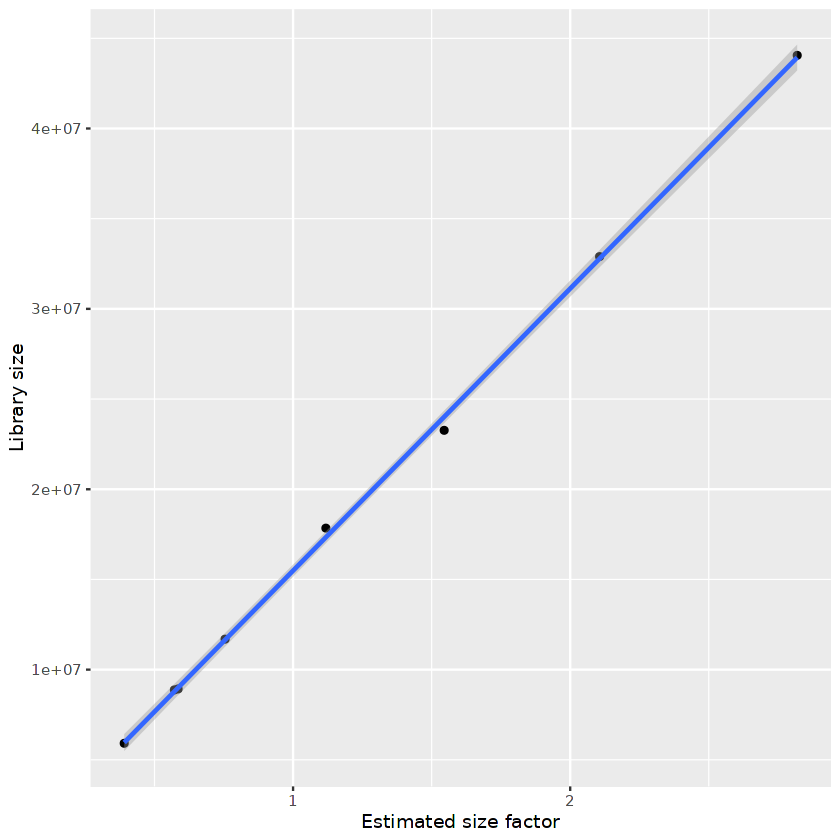

In [920]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [921]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Late1F,MOL,Late1F,F,Percoll,0.7546937
Late1M,MOL,Late1M,M,Percoll,1.5452481
Late2F,MOL,Late2F,F,Percoll,0.3906923
Late2M,MOL,Late2M,M,Percoll,0.5850483
Late3F,MOL,Late3F,F,Percoll,0.5718763
Late3M,MOL,Late3M,M,Percoll,1.1183602
LateFemale4F,MOL,LateFemale4F,F,Debris,2.8191861
LateMale4M,MOL,LateMale4M,M,Debris,2.1061077


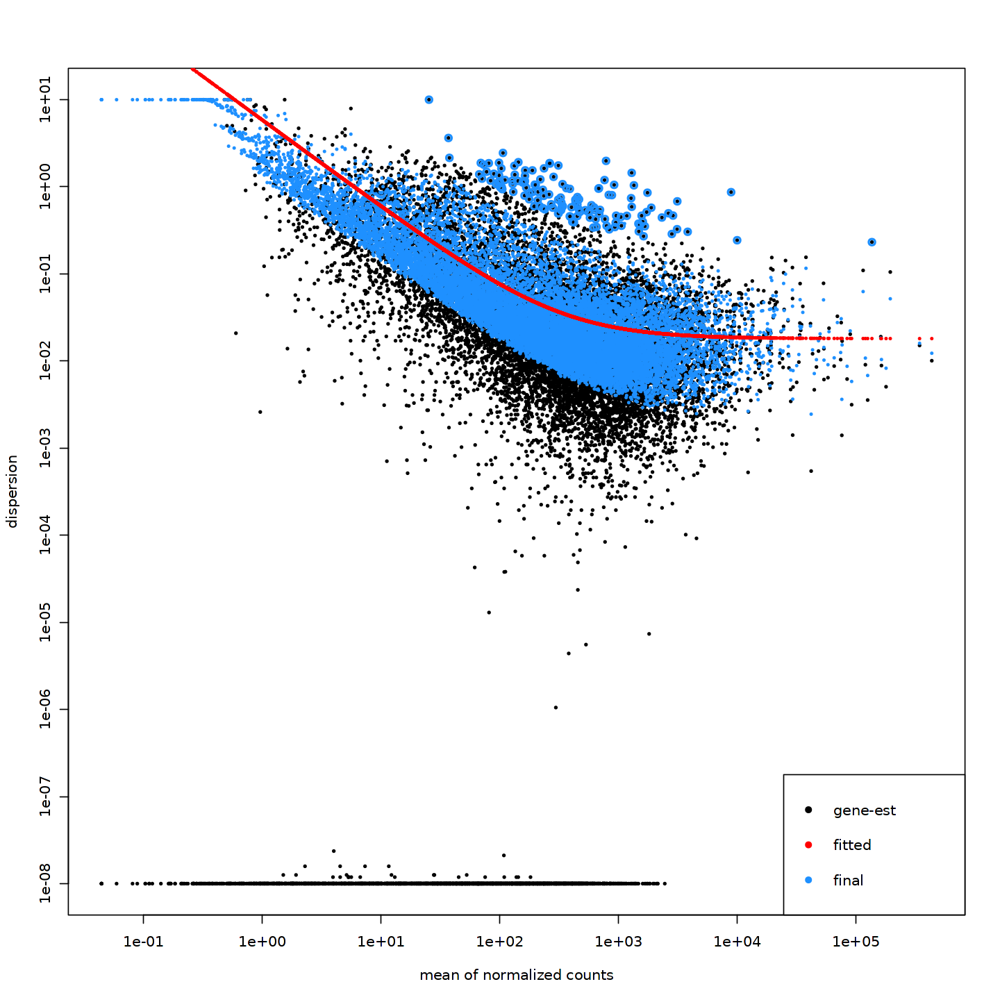

In [922]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [923]:
condition1 = "M"
condition2 = "F"

In [924]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [925]:
summary(res)


out of 14394 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 3, 0.021%
LFC < 0 (down)     : 3, 0.021%
outliers [1]       : 2, 0.014%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



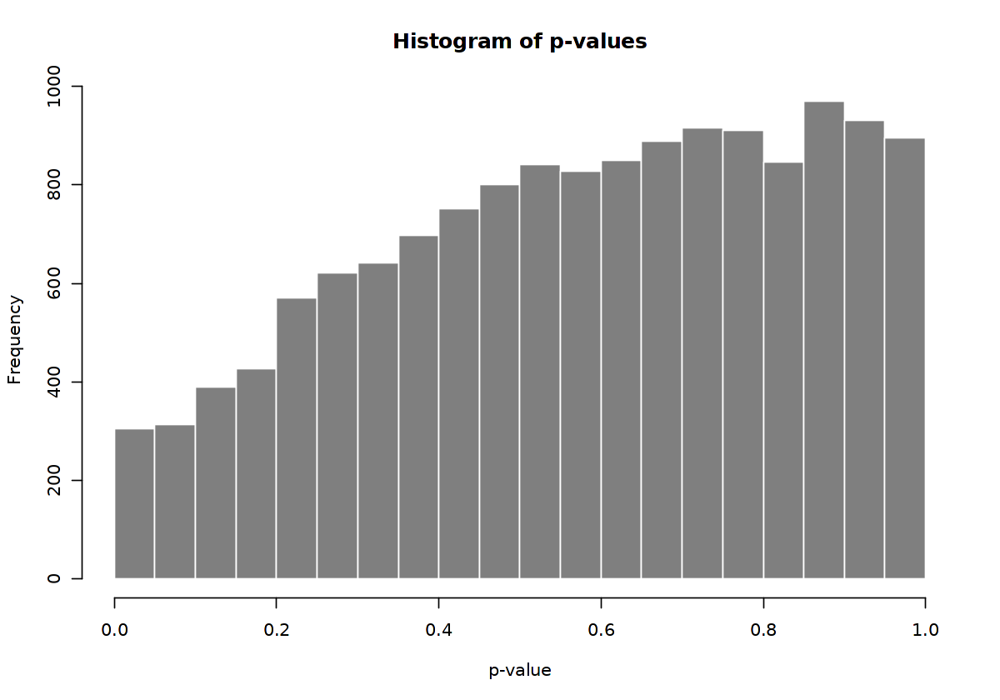

In [926]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

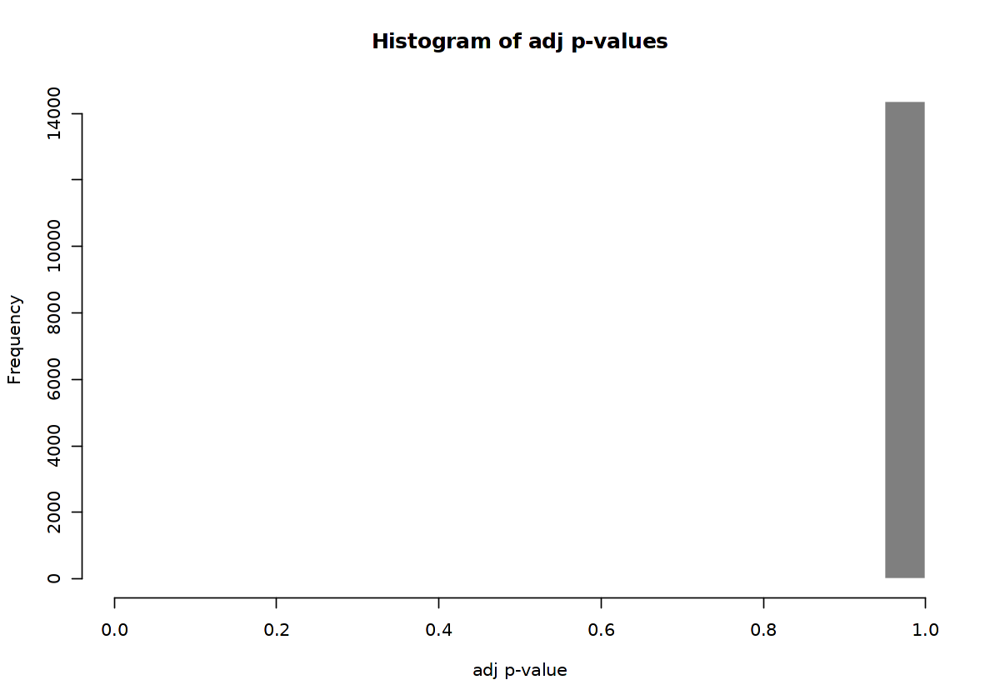

In [927]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

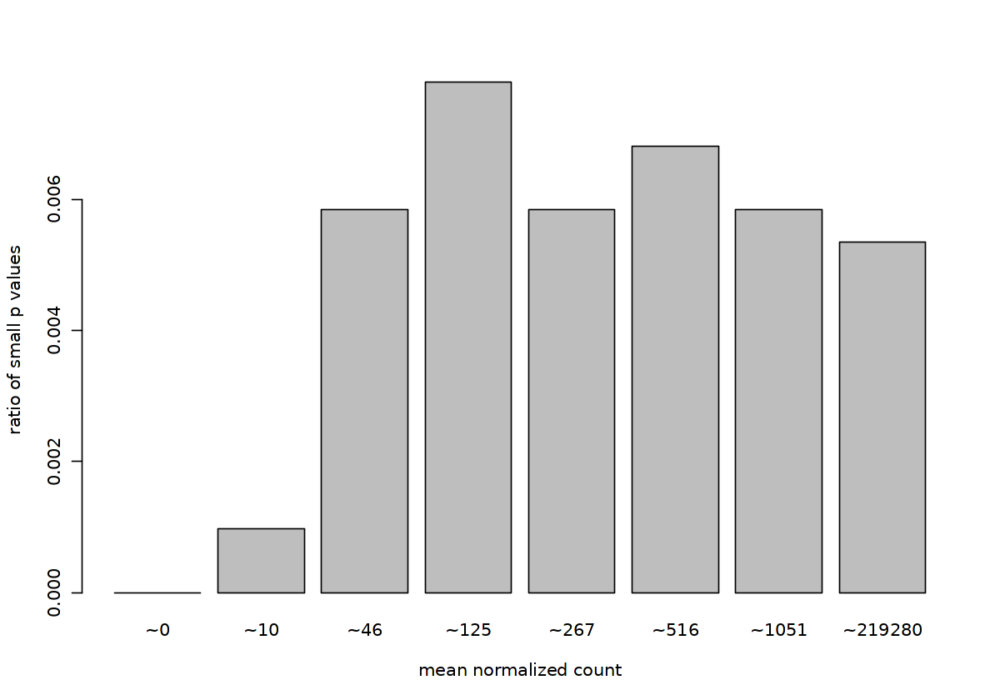

In [928]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

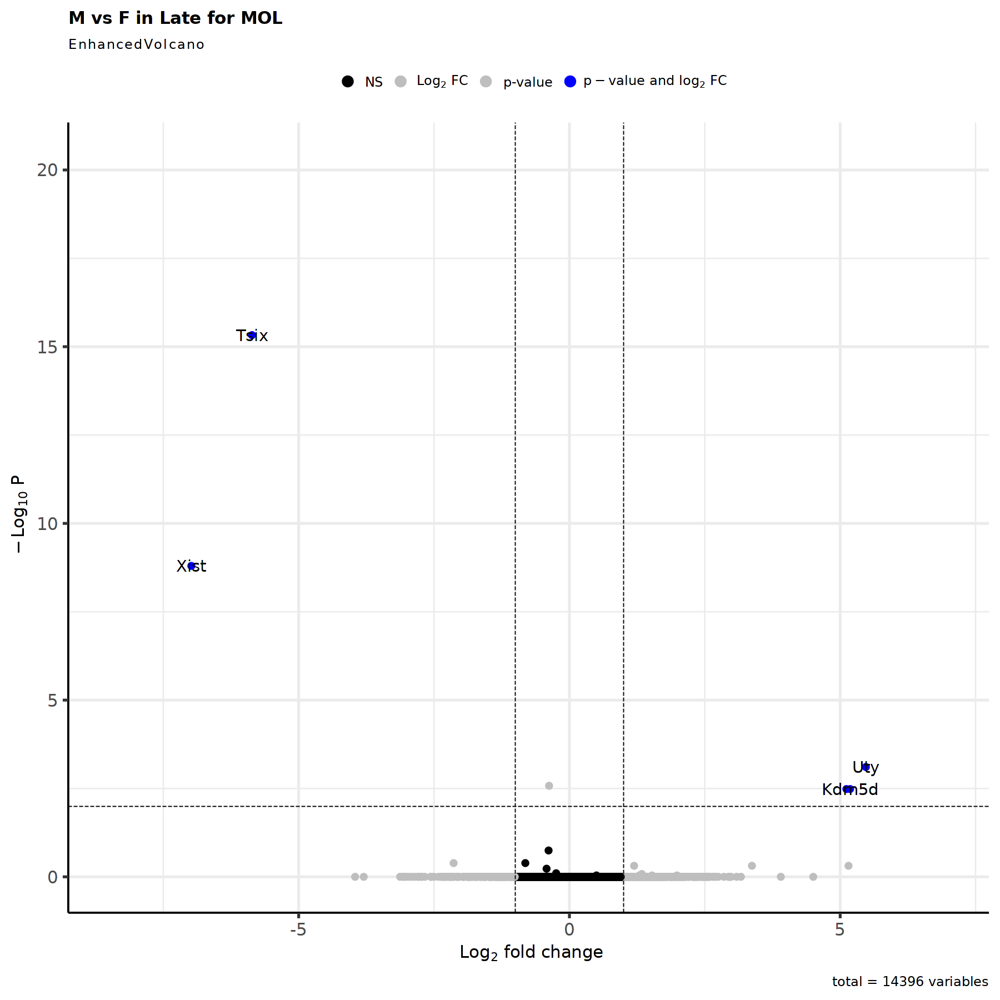

In [929]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [930]:
res <- res[complete.cases(res$padj),]

In [931]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [932]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 5 rows and 6 columns
       baseMean log2FoldChange     lfcSE      stat      pvalue        padj
      <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist   8915.768       -6.98219  0.951896  -7.33503 2.21666e-13 1.59511e-09
Tsix   1128.502       -5.86194  0.636491  -9.20978 3.26803e-20 4.70334e-16
Uty    1353.380        5.47430  1.045258   5.23727 1.62965e-07 7.81798e-04
Kdm5d   339.330        5.18296  1.073216   4.82938 1.36962e-06 3.28527e-03
Ddx3y   922.002        5.11447  1.052470   4.85950 1.17685e-06 3.28527e-03

In [933]:
nrow(res_filtered)

[1] 5

In [934]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [935]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [936]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [937]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


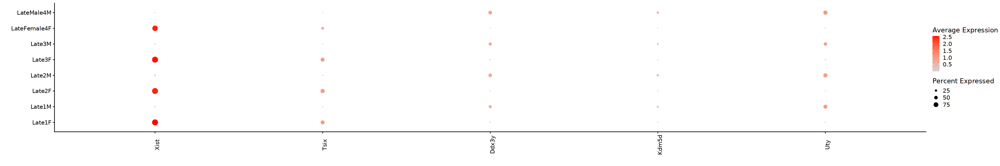

In [938]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

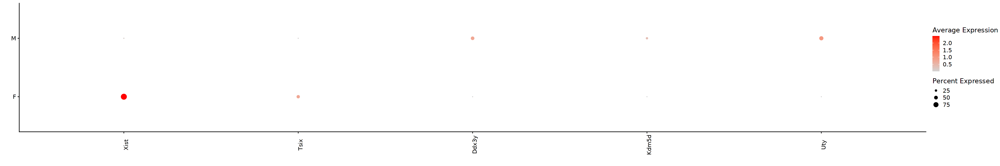

In [939]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [940]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.5.2 OPC

In [941]:
cluster_choice <- "OPC"

In [942]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Late1F Late1M 
     2      5

In [943]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [944]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [945]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [946]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Late2F,OPC,Late2F,F,Percoll
Late2M,OPC,Late2M,M,Percoll
Late3F,OPC,Late3F,F,Percoll
Late3M,OPC,Late3M,M,Percoll
LateFemale4F,OPC,LateFemale4F,F,Debris
LateMale4M,OPC,LateMale4M,M,Debris


In [947]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [948]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [949]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

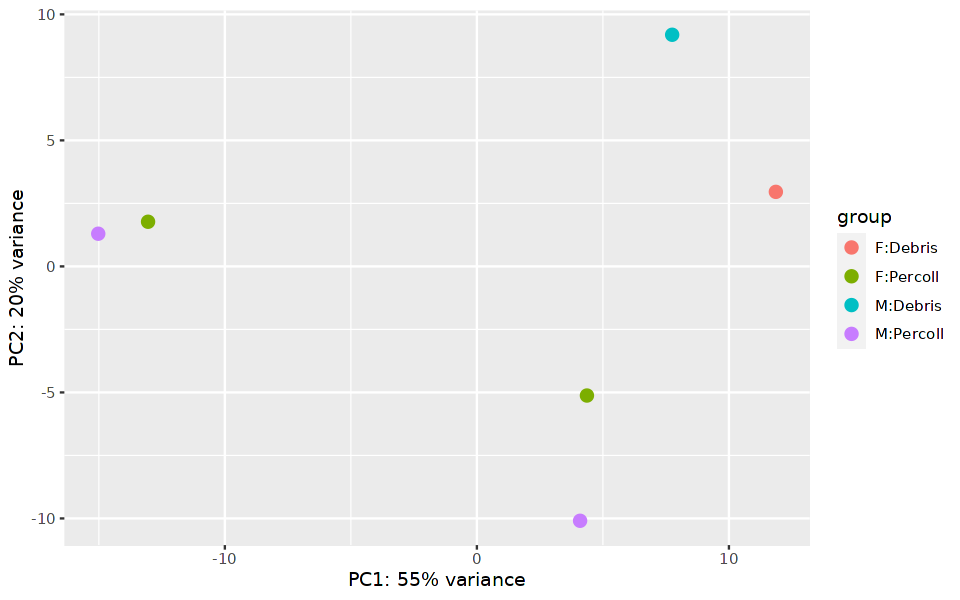

In [950]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [951]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

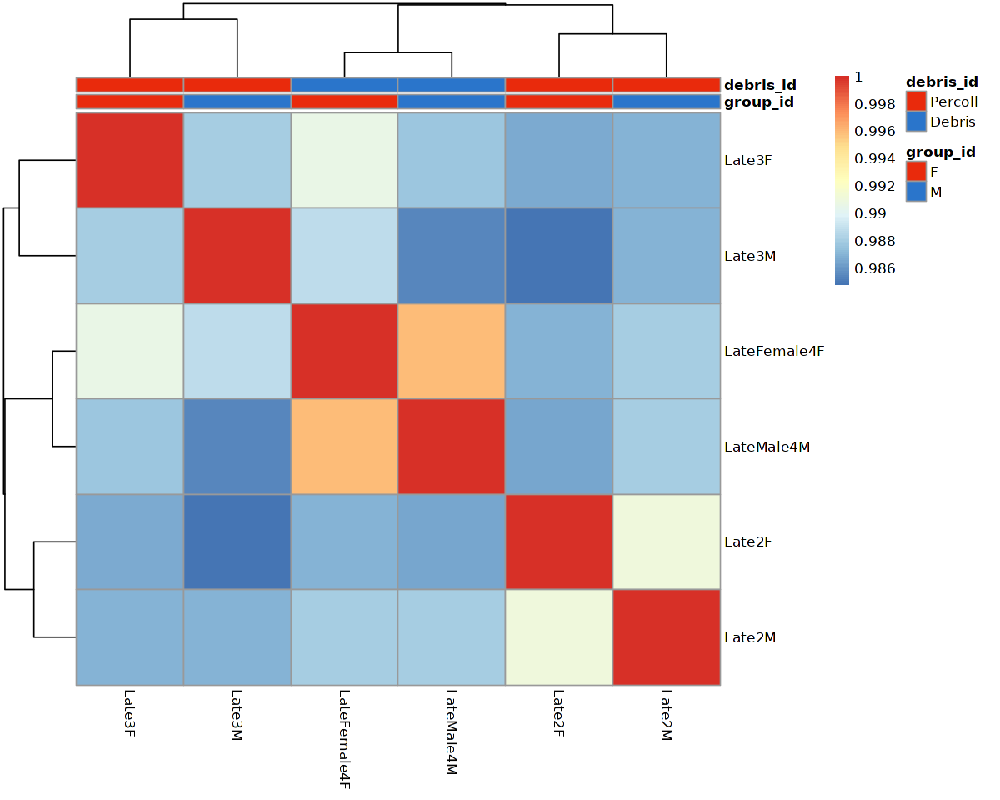

In [952]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [953]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [954]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


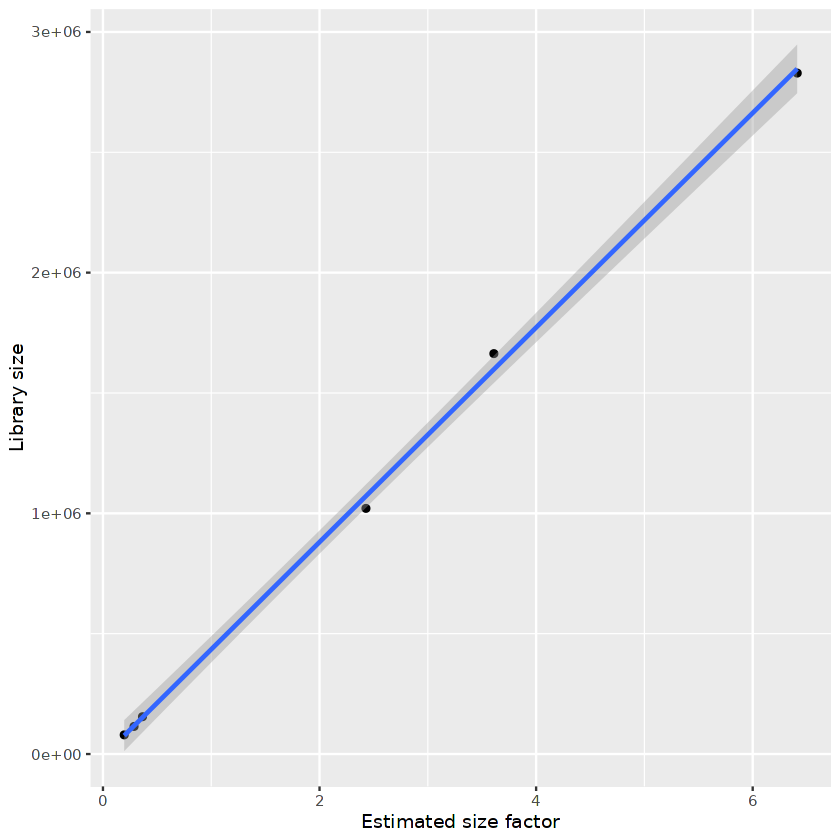

In [955]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [956]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Late2F,OPC,Late2F,F,Percoll,0.3651033
Late2M,OPC,Late2M,M,Percoll,2.4285662
Late3F,OPC,Late3F,F,Percoll,0.1963094
Late3M,OPC,Late3M,M,Percoll,0.2871297
LateFemale4F,OPC,LateFemale4F,F,Debris,6.4111420
LateMale4M,OPC,LateMale4M,M,Debris,3.6098838


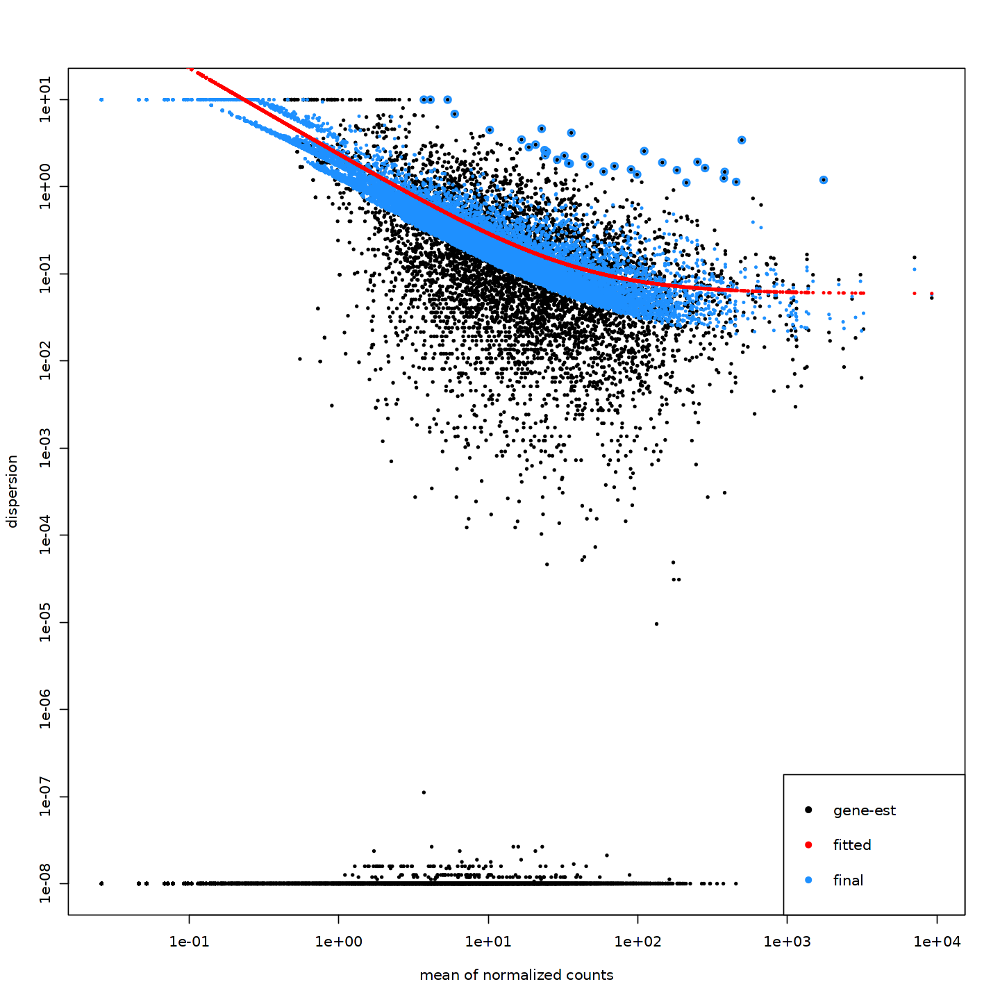

In [957]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [958]:
condition1 = "M"
condition2 = "F"

In [959]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [960]:
summary(res)


out of 14126 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2, 0.014%
LFC < 0 (down)     : 2, 0.014%
outliers [1]       : 0, 0%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



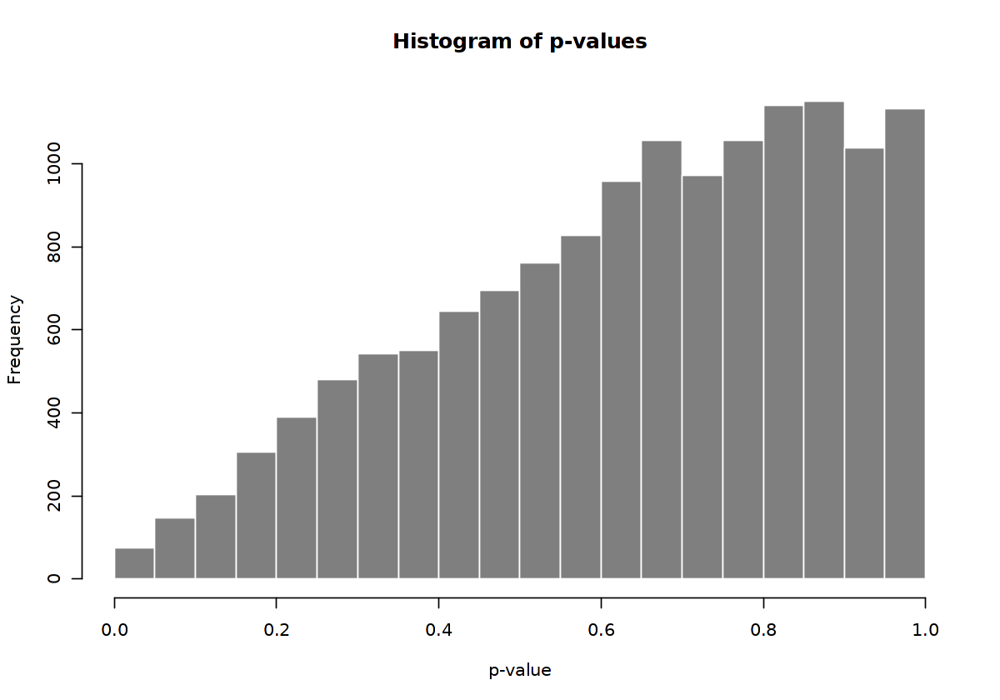

In [961]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

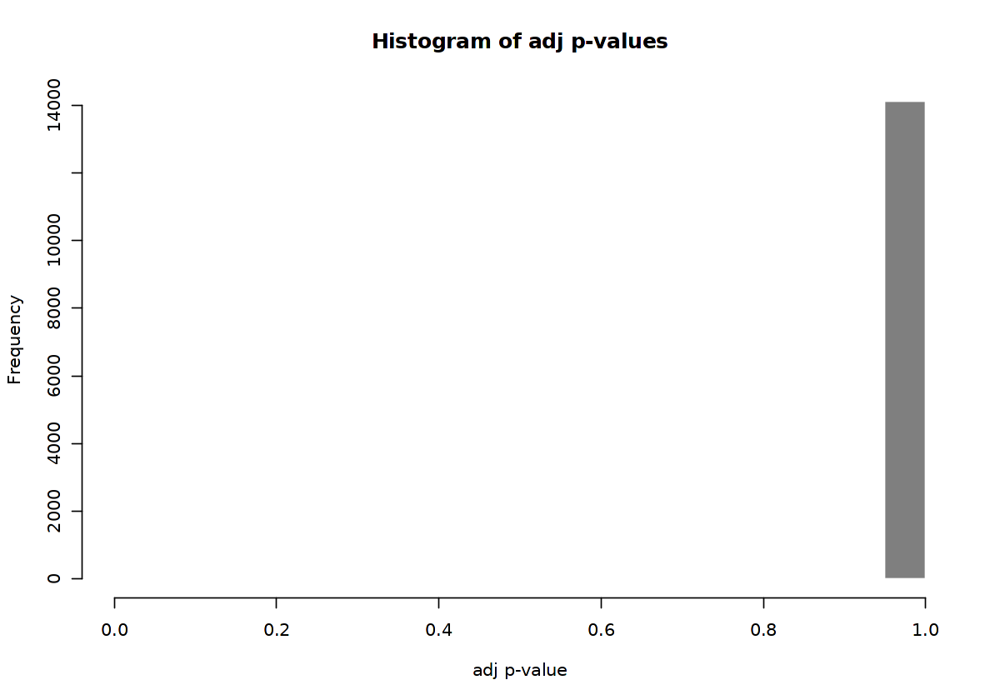

In [962]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

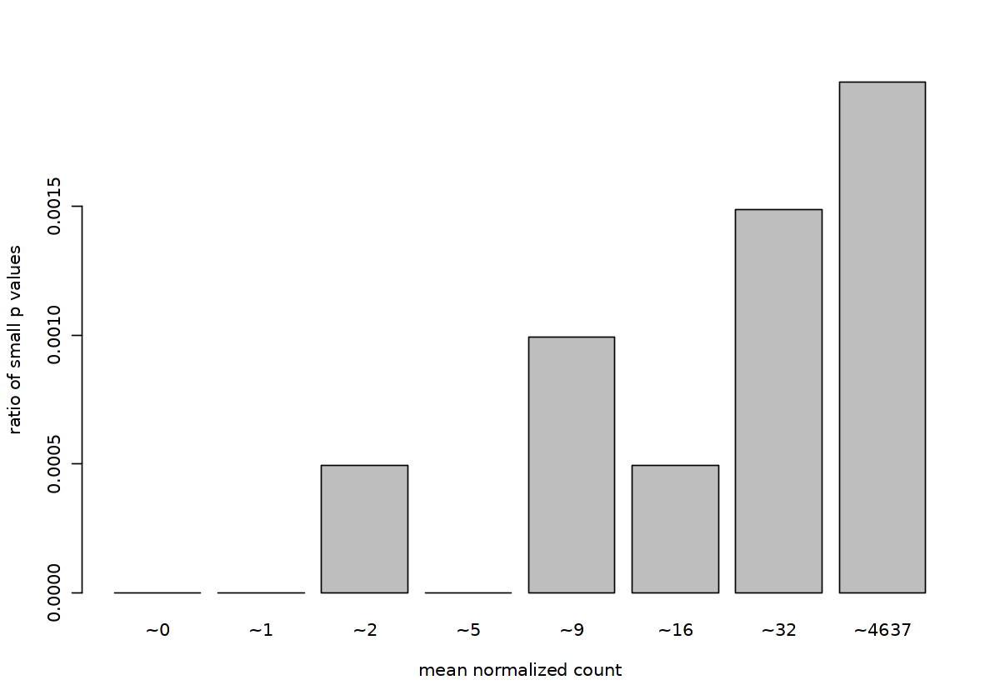

In [963]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

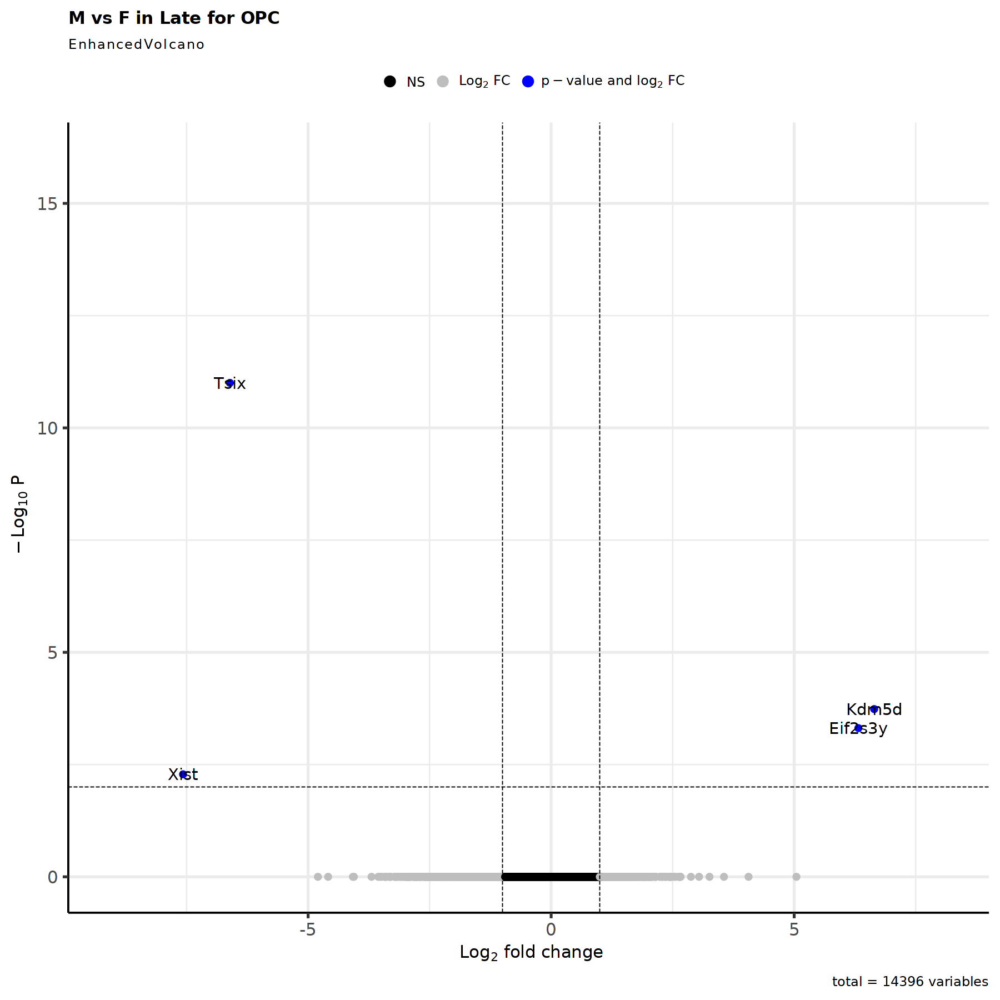

In [964]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [965]:
res <- res[complete.cases(res$padj),]

In [966]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [967]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 4 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Xist     281.5249       -7.57308   1.57296  -4.81454 1.47541e-06 5.21041e-03
Kdm5d     11.1757        6.64537   1.19380   5.56658 2.59783e-08 1.83485e-04
Tsix      38.6832       -6.60869   0.81895  -8.06971 7.04656e-16 9.95397e-12
Eif2s3y   16.4005        6.32000   1.18784   5.32058 1.03436e-07 4.87044e-04

In [968]:
nrow(res_filtered)

[1] 4

In [969]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [970]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [971]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [972]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


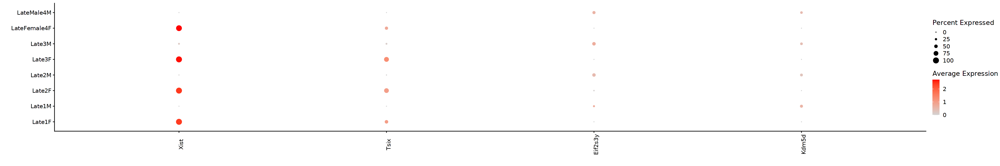

In [973]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

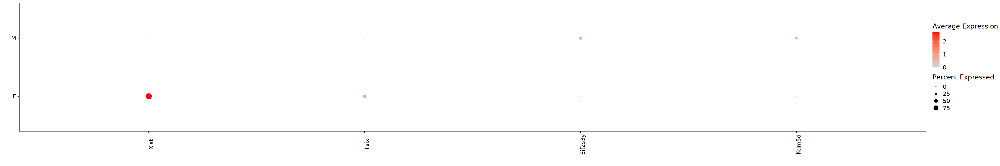

In [974]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [975]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.5.3 Micro

In [976]:
cluster_choice <- "Micro"

In [977]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

named integer(0)

In [978]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

named integer(0)

In [979]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [980]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

#new_sample_levels <- levels(cluster_metadata$sample_id)[levels(cluster_metadata$sample_id) %in% sample_keep]
#cluster_metadata$sample_id <- droplevels(cluster_metadata$sample_id)
#levels(cluster_metadata$sample_id) <- new_sample_levels

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [981]:
cluster_metadata

,cluster_id,sample_id,group_id,debris_id
,<chr>,<chr>,<fct>,<chr>
Late1F,Micro,Late1F,F,Percoll
Late1M,Micro,Late1M,M,Percoll
Late2F,Micro,Late2F,F,Percoll
Late2M,Micro,Late2M,M,Percoll
Late3F,Micro,Late3F,F,Percoll
Late3M,Micro,Late3M,M,Percoll
LateFemale4F,Micro,LateFemale4F,F,Debris
LateMale4M,Micro,LateMale4M,M,Debris


In [982]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [983]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [984]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

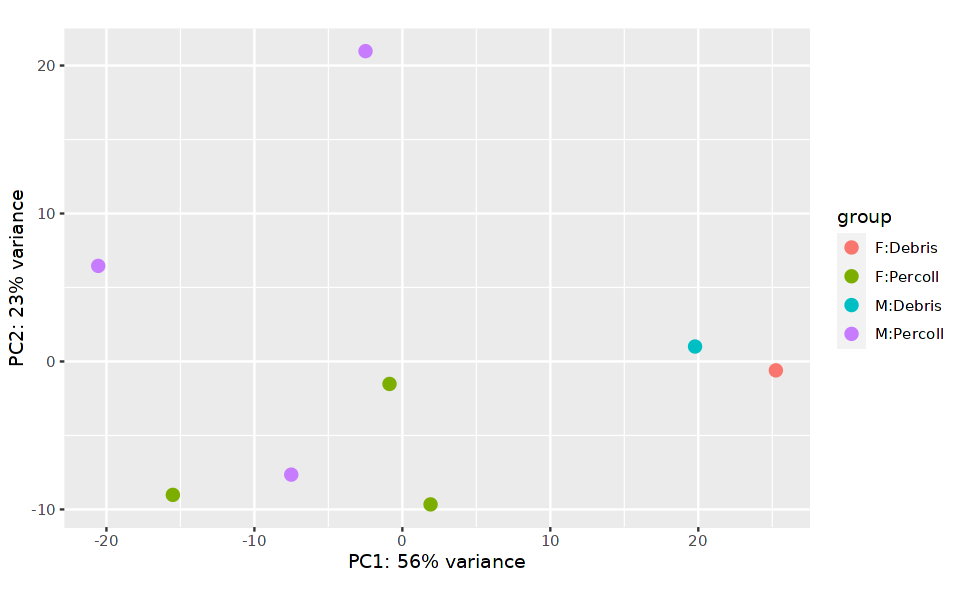

In [985]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [986]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

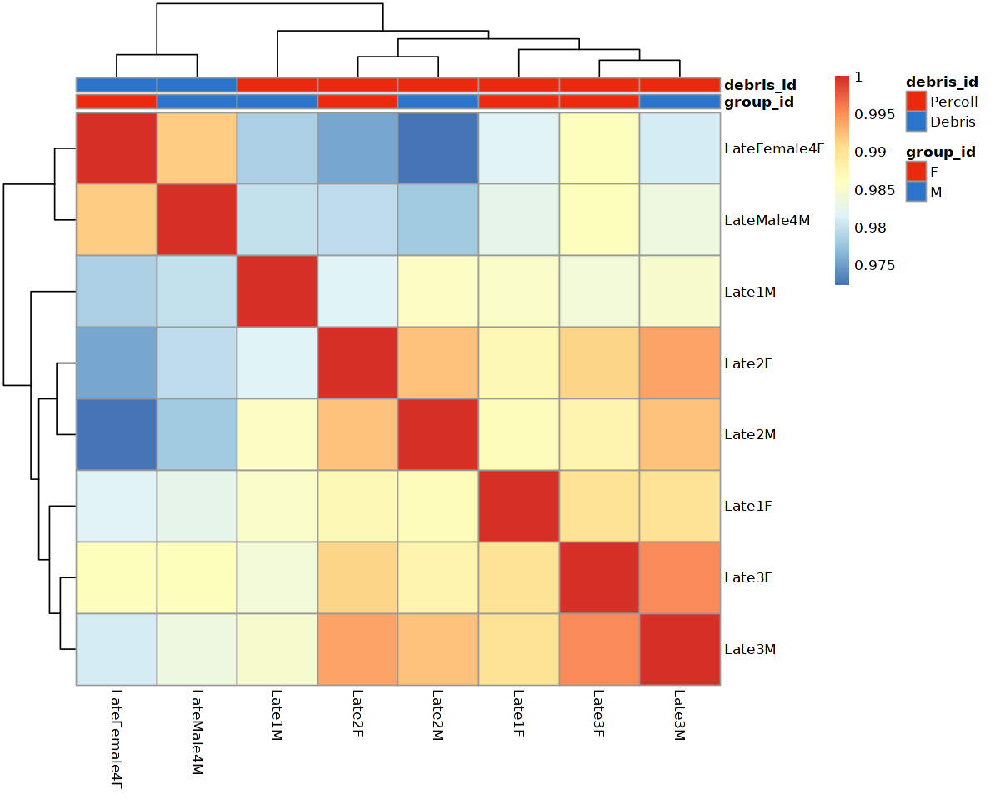

In [987]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=sex_colors, debris_id=debris_colors))

In [988]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [989]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


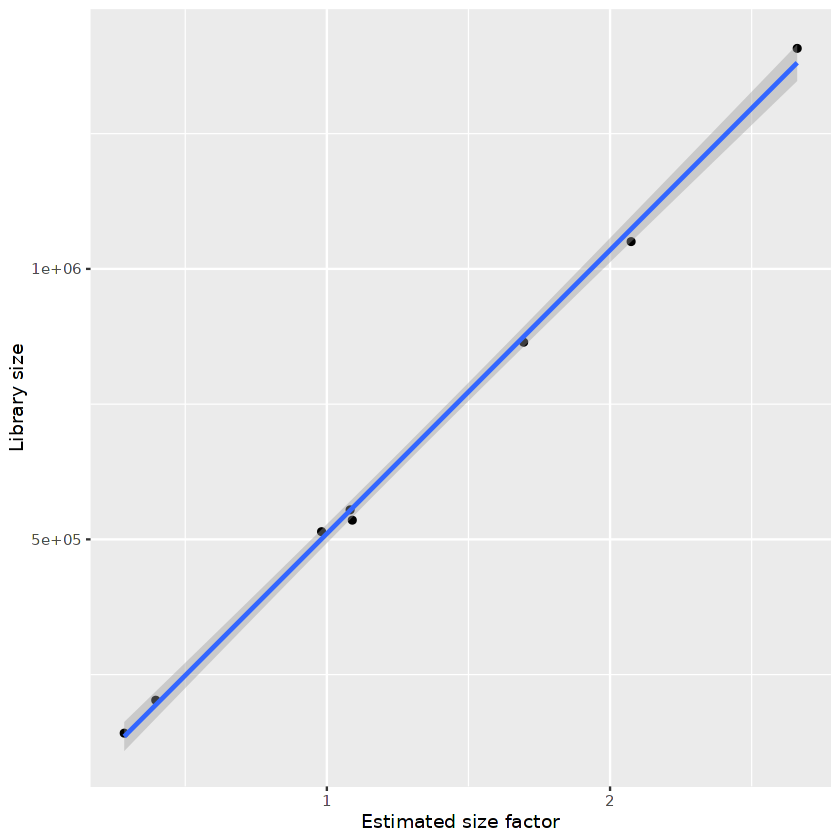

In [990]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [991]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Late1F,Micro,Late1F,F,Percoll,0.3958437
Late1M,Micro,Late1M,M,Percoll,0.2844656
Late2F,Micro,Late2F,F,Percoll,1.0820879
Late2M,Micro,Late2M,M,Percoll,2.0743468
Late3F,Micro,Late3F,F,Percoll,1.6948472
Late3M,Micro,Late3M,M,Percoll,2.6608370
LateFemale4F,Micro,LateFemale4F,F,Debris,1.0898289
LateMale4M,Micro,LateMale4M,M,Debris,0.9812858


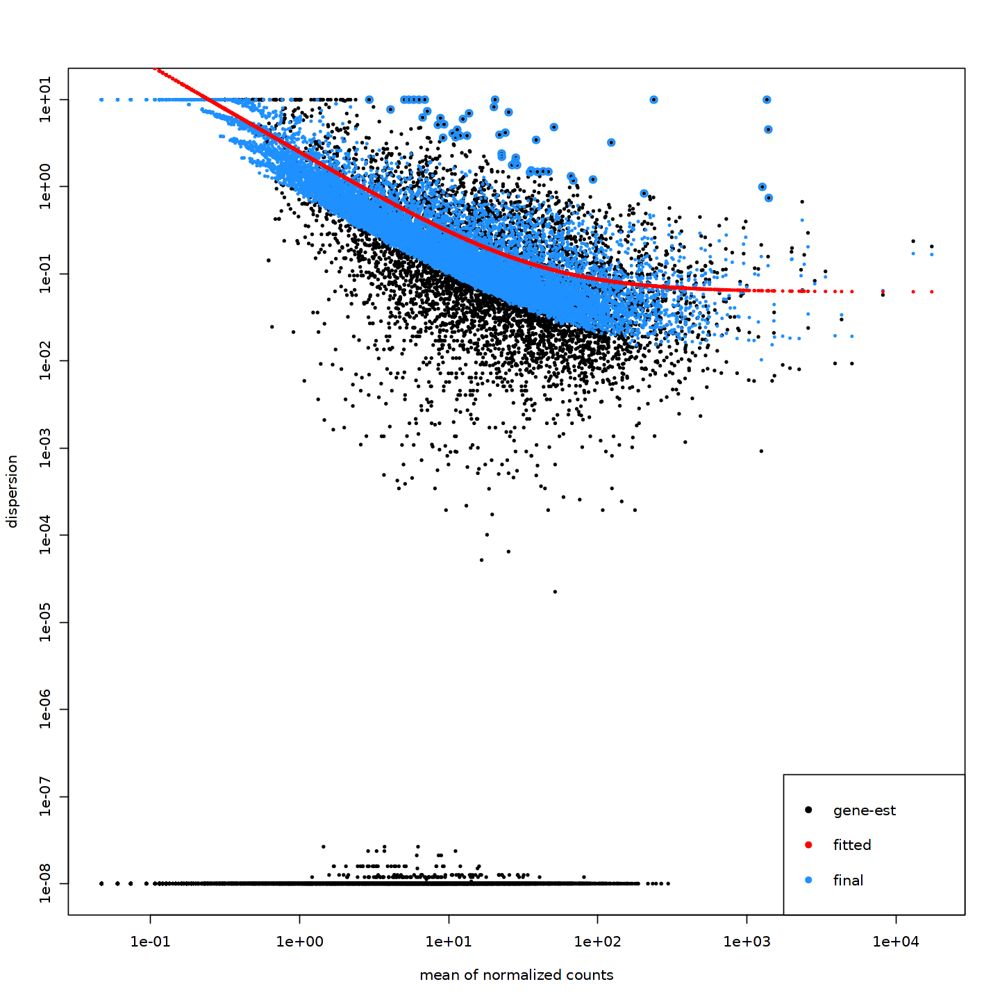

In [992]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

In [993]:
condition1 = "M"
condition2 = "F"

In [994]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [995]:
summary(res)


out of 13955 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 7, 0.05%
LFC < 0 (down)     : 4, 0.029%
outliers [1]       : 2, 0.014%
low counts [2]     : 5402, 39%
(mean count < 6)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



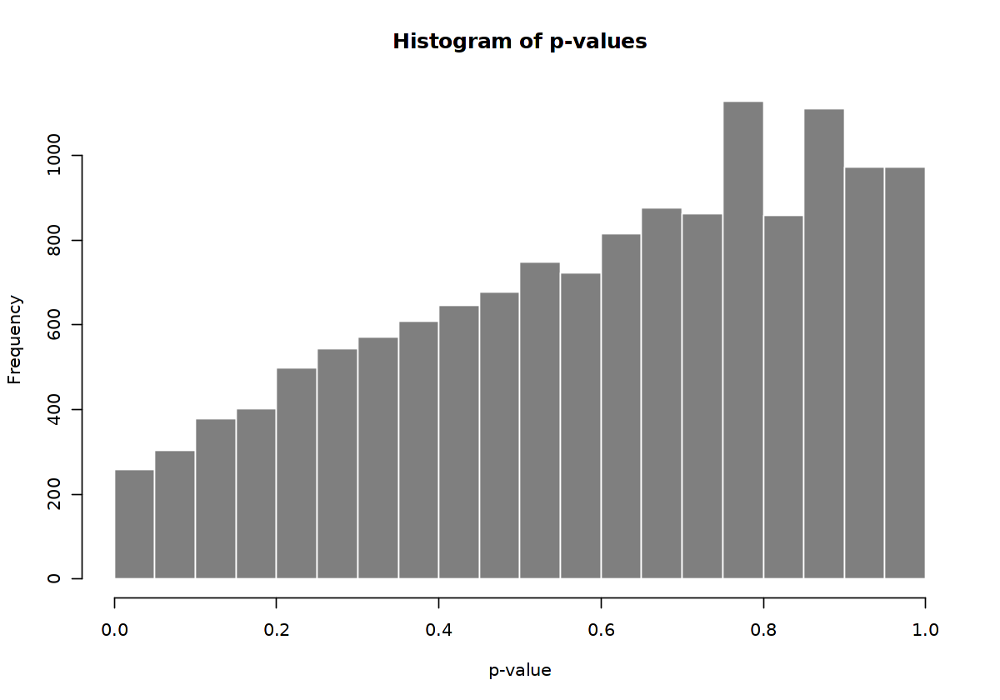

In [996]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

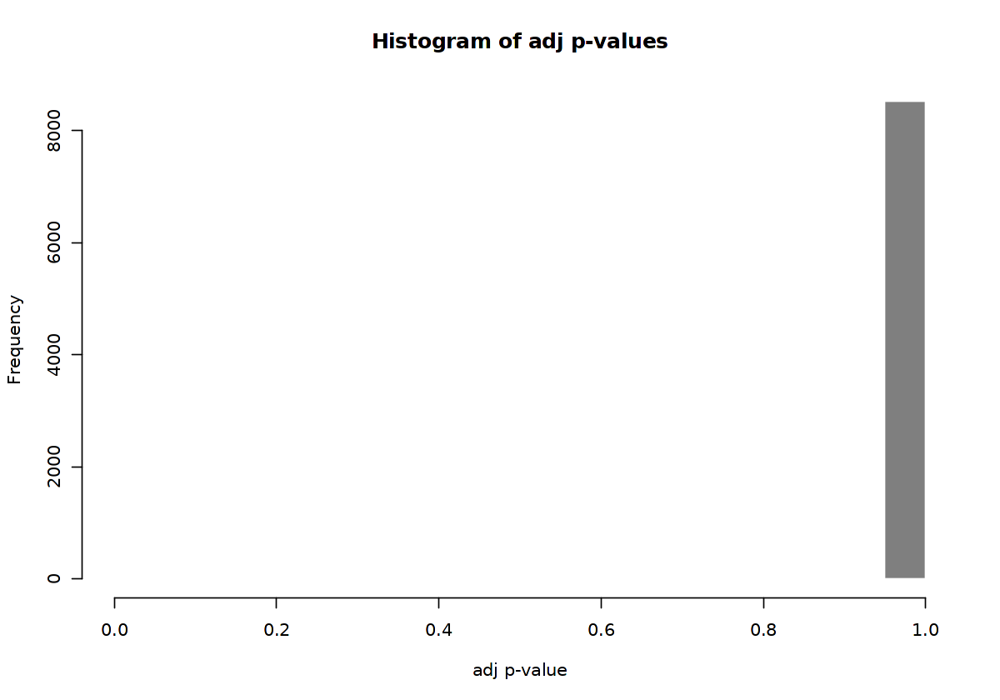

In [997]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

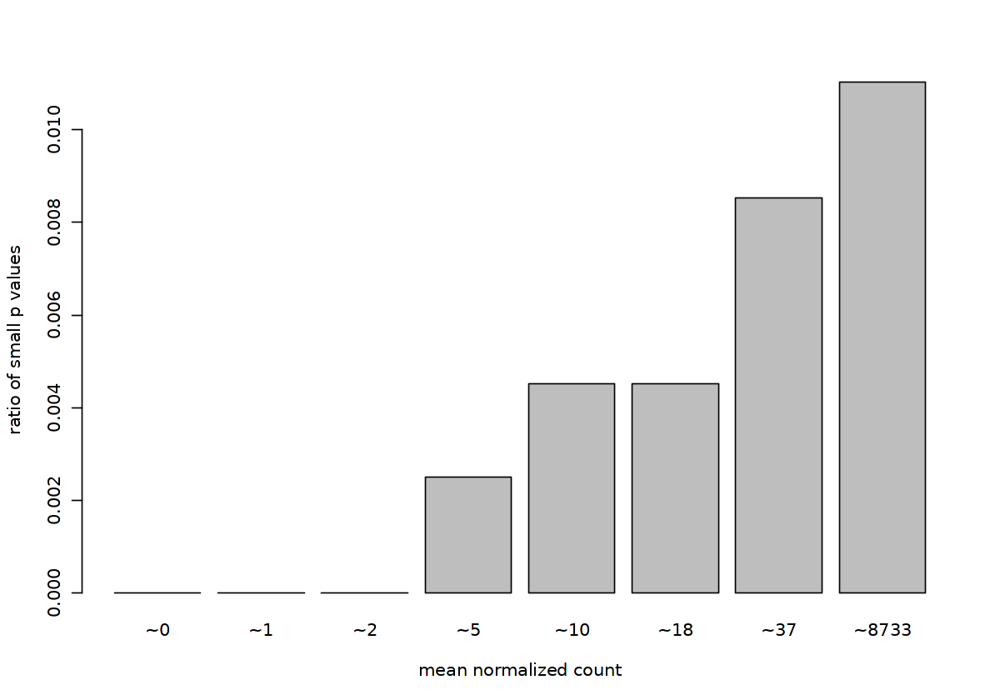

In [998]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

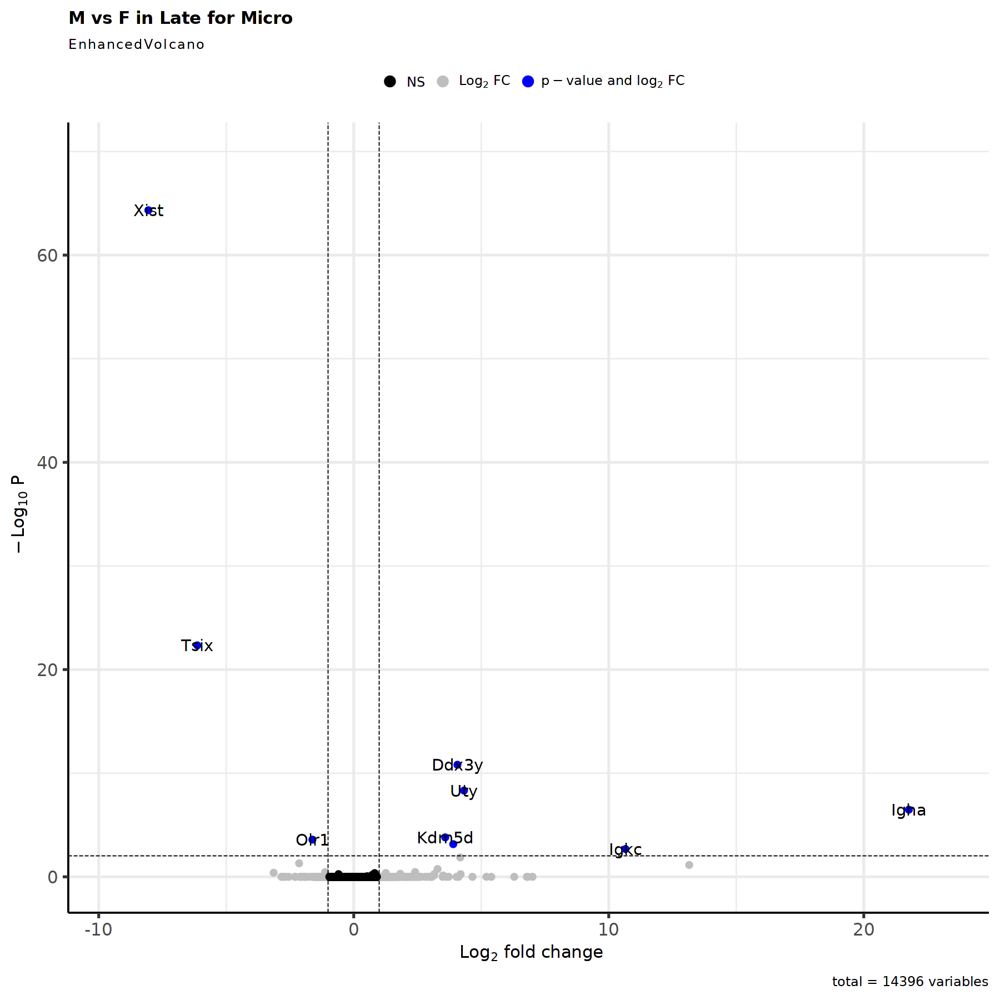

In [999]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0('M vs F in ',timepoint,' for ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [1000]:
res <- res[complete.cases(res$padj),]

In [1001]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [1002]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id M vs F 
Wald test p-value: group id M vs F 
DataFrame with 9 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Igha    1364.5766       21.76647  3.419198   6.36596 1.94075e-10 3.31907e-07
Igkc    1395.0759       10.65620  2.250767   4.73448 2.19623e-06 2.08666e-03
Xist     369.3250       -8.05277  0.458714 -17.55513 5.43465e-69 4.64717e-65
Tsix      49.1200       -6.13307  0.573456 -10.69493 1.07502e-26 4.59624e-23
Uty       45.1317        4.32190  0.615690   7.01960 2.22501e-12 4.75652e-09
Ddx3y     55.1024        4.06579  0.520094   7.81741 5.39198e-15 1.53690e-11
Eif2s3y   17.8491        3.90185  0.784576   4.97320 6.58575e-07 7.03935e-04
Kdm5d     11.4192        3.58739  0.675618   5.30980 1.09748e-07 1.56409e-04
Olr1      37.3223       -1.62158  0.312526  -5.18865 2.11829e-07 2.58764e-04

In [1003]:
nrow(res_filtered)

[1] 9

In [1004]:
top.genes.number <- ifelse(nrow(res_filtered)>100, 100, nrow(res_filtered))

In [1005]:
res_top <- res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),][1:top.genes.number,]
res_top <- res_top[order(res_top$log2FoldChange, decreasing=FALSE),]

In [1006]:
tmp_sub <- subset(tmp, subset = cellType == cluster_choice)

In [1007]:
tmp_sub <- NormalizeData(tmp_sub, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


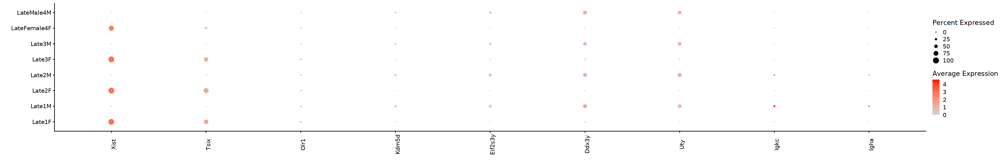

In [1008]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "orig.ident_Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

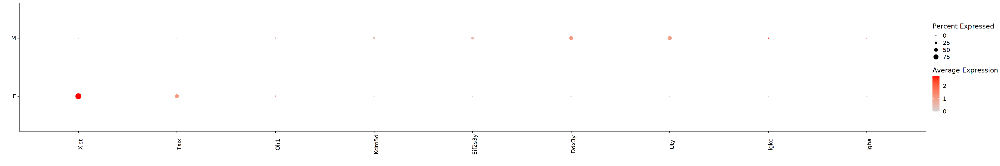

In [1009]:
options(repr.plot.width=30, repr.plot.height=5)
plot <- DotPlot(tmp_sub, assay = "RNA", group.by = "Sex", scale=FALSE, cols = c("lightgrey", "red"), dot.scale = 5, features = rownames(res_top))
plot + theme(axis.text.x = element_text(angle = 90)) + labs(x = "", y= "")

In [1010]:
HVGs.list[[cluster_choice]] <- rownames(res_filtered)

##### 3.2.5.4 Astro

In [1011]:
cluster_choice <- "Astro"

In [1012]:
table_sample_low <- table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(timepoint_Sex_colors)[!names(timepoint_Sex_colors) %in% names(table_sample_low)]

Late2M Late3F 
     0      5

In [1013]:
table_group_low <-table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,][table(MORNAATACC_sce$cluster_id, MORNAATACC_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(sex_colors)[!names(sex_colors) %in% names(table_group_low)]

M 
26

In [1014]:
#Not enough cells

##### 3.2.5.5 Summary

In [1015]:
listInput_upset <- HVGs.list
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

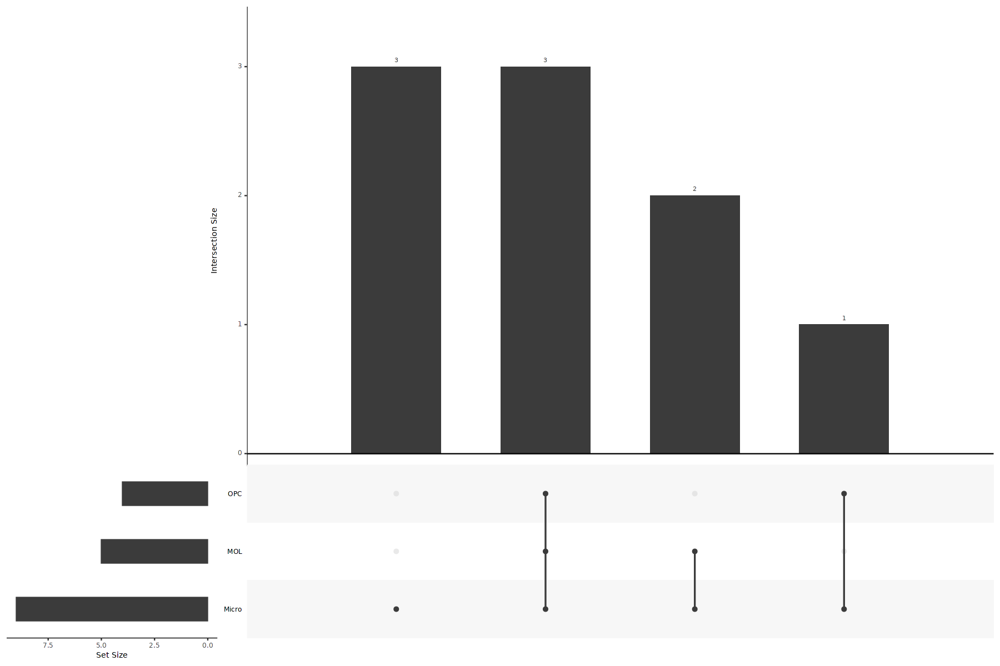

In [1016]:
options(repr.plot.width=15, repr.plot.height=10)
upset(fromList(listInput_upset), order.by = "freq")

In [1017]:
HVF <- unique(unlist(HVGs.list))

In [1018]:
table_sample_low <- table(MORNAATACC_sce$sample_id)[table(MORNAATACC_sce$sample_id) <= 5]
table_group_low <- table(MORNAATACC_sce$group_id)[table(MORNAATACC_sce$group_id) <= 30]

In [1019]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [1020]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_Sex %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [1021]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [1022]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [1023]:
sub_timepoint_Sex_colors <- timepoint_Sex_colors[names(timepoint_Sex_colors) %in% names(table(tmp$orig.ident_Sex))]

In [1024]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = name_timepoint[!name_timepoint %in% names(table_sample_low)])
tmp$orig.ident_Sex <- factor(x = tmp$orig.ident_Sex, levels = names(sub_timepoint_Sex_colors)[!names(sub_timepoint_Sex_colors) %in% names(table_group_low)])

In [1025]:
Idents(object = tmp) <- "orig.ident_Sex"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


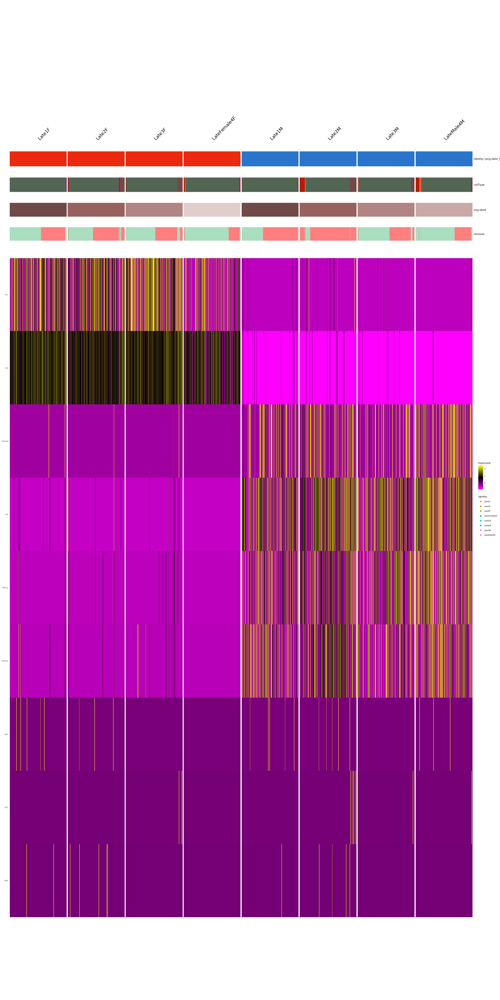

In [1026]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVF,
    cells = NULL,
    group.by = "orig.ident_Sex",
    additional.group.by = c("cellType", "orig.ident", "Immune"),
    additional.group.sort.by = c("cellType", "orig.ident", "Immune"),
    cols.use = list(orig.ident_Sex=sub_timepoint_Sex_colors, cellType=cellType_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    slot = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 8))

In [1027]:
sample_names <- levels(tmp$orig.ident_Sex)

In [1028]:
Idents(object = tmp) <- "Sex"

In [1029]:
gene_list <- HVF

In [1030]:
tmp_markers <- data.frame(matrix(ncol=length(names(sub_timepoint_Sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sub_timepoint_Sex_colors)))))

In [1031]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_Sex == names(sub_timepoint_Sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [1032]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [1033]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [1034]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

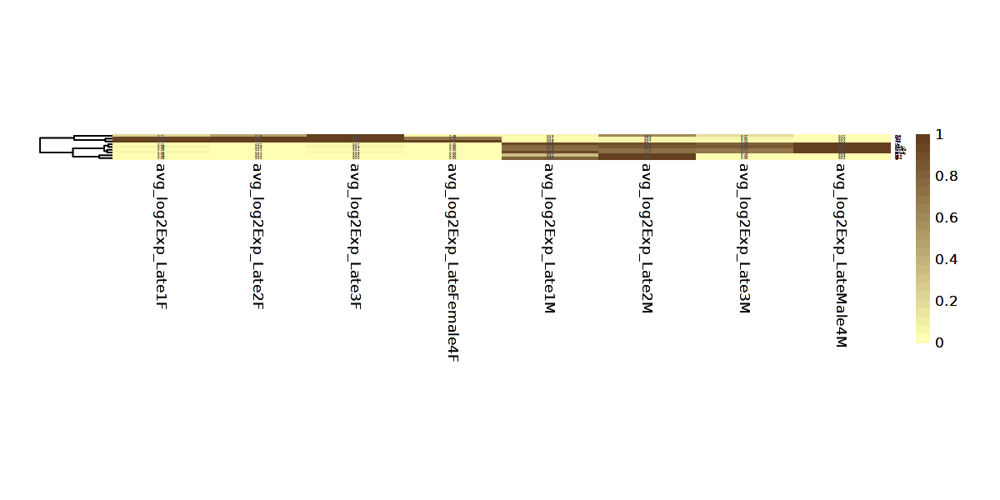

In [1035]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [1036]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [1037]:
gene_list <- gene_list[ph$tree_row$order]

In [1038]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [1039]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [1040]:
matrix <- tmp_markers_mean

In [1041]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

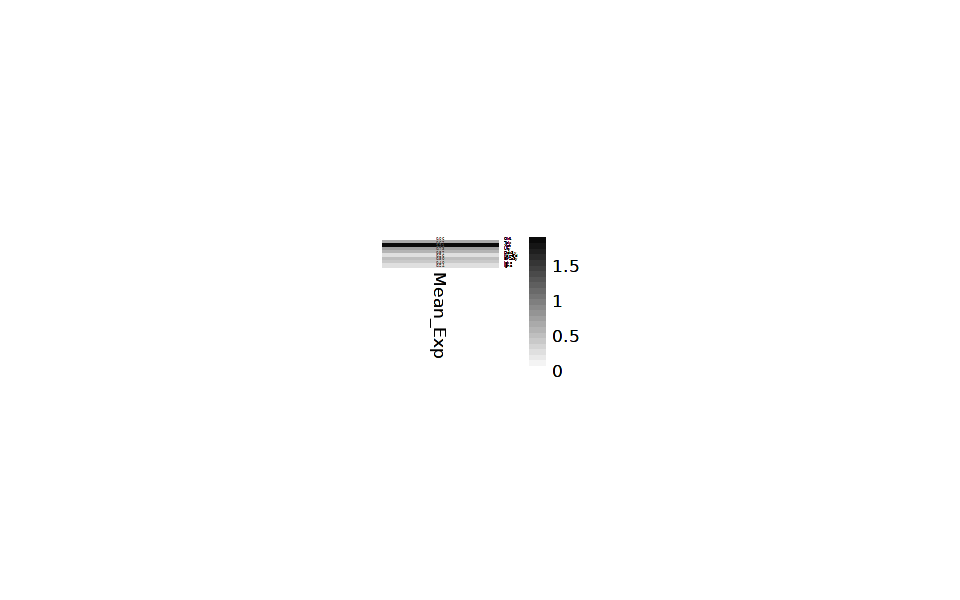

In [1042]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1043]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [1044]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sub_timepoint_Sex_colors))
matrix <- tmp_markers_zscore

In [1045]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

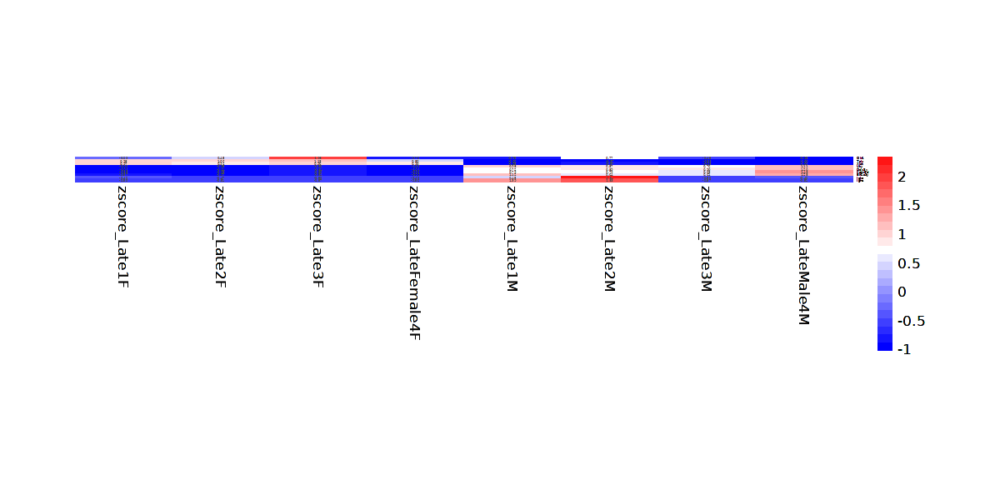

In [1046]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1047]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_sep_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

In [1048]:
gene_list <- HVF

In [1049]:
tmp_markers <- data.frame(matrix(ncol=length(names(sex_colors)), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", names(sex_colors)))))

In [1050]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = Sex == names(sex_colors)[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [1051]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [1052]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [1053]:
plot_height <- ifelse(as.integer(nrow(matrix)/20) < 5, 5, as.integer(nrow(matrix)/20))

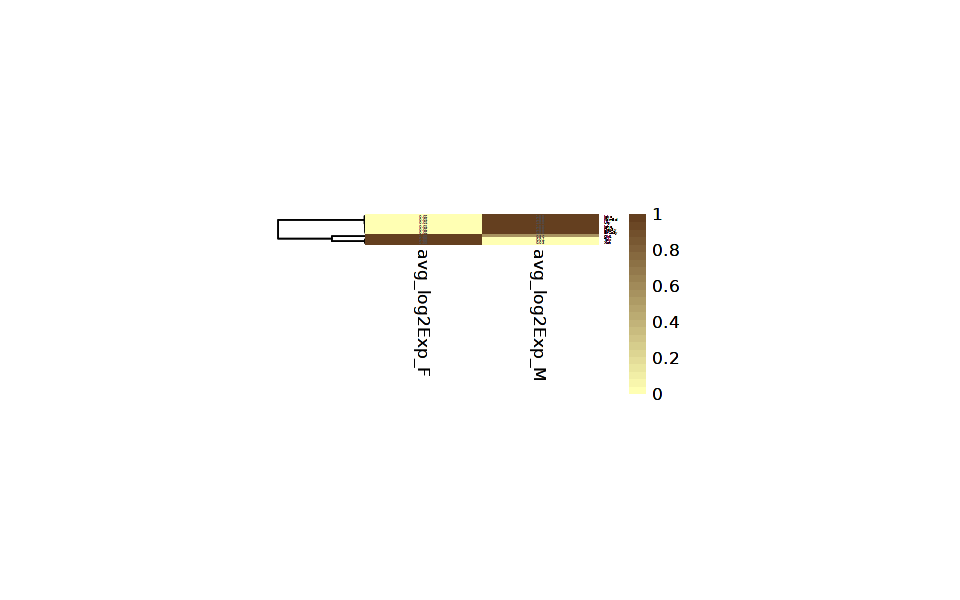

In [1054]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [1055]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [1056]:
gene_list <- gene_list[ph$tree_row$order]

In [1057]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [1058]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [1059]:
matrix <- tmp_markers_mean

In [1060]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

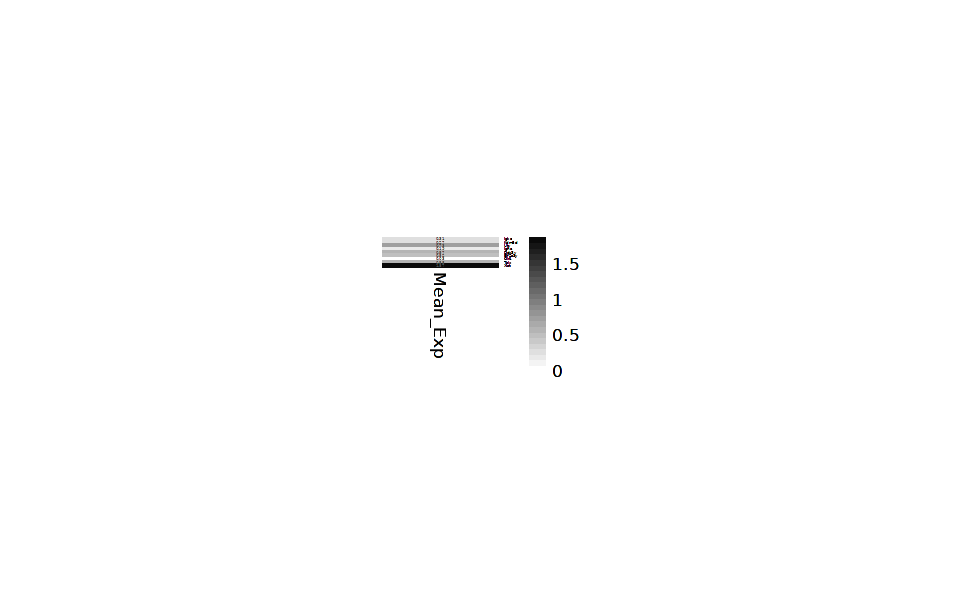

In [1061]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1062]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [1063]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", names(sex_colors))
matrix <- tmp_markers_zscore

In [1064]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

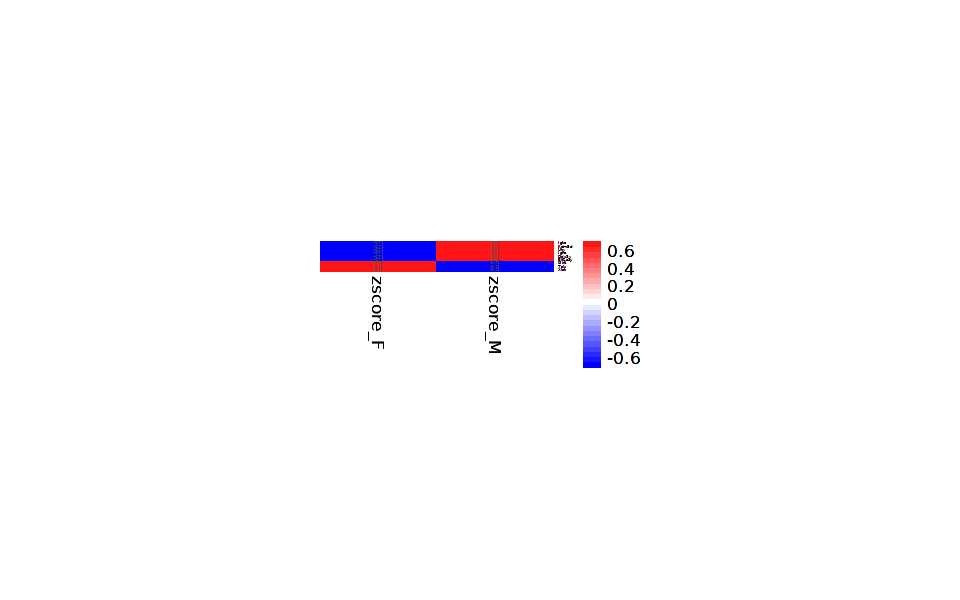

In [1065]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1066]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_",timepoint,"_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2

### 3.3 Overall

In [1067]:
tmp <- subset(MORNAATACC, subset = cellType %in% c("MOL", "COP", "OPC"))

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ to umappeaks_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ to umapbimod_"


In [1068]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [1069]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [1070]:
tmp$cellType_Sex <- paste0(tmp$cellType,"_",tmp$Sex)

In [1071]:
sample_names <- c('MOL_M','MOL_F','COP_M','COP_F','OPC_M','OPC_F')

In [1072]:
tmp$cellType_Sex <- factor(x = tmp$cellType_Sex, levels = sample_names)

In [1076]:
#Gene list from MOL and OPC
#gene_list <- c('Tsix','Xist','Uty','Hcn1','Kdm5d','Ddx3y','Eif2s3y')
gene_list <- unique(unlist(c(HVGs.list[["MOL"]],HVGs.list[["OPC"]])))

In [1078]:
Idents(object = tmp) <- "cellType_Sex"

In [1079]:
tmp_markers <- data.frame(matrix(ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [1080]:
for (i in 1:length(colnames(tmp_markers))){
    tmp_markers[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = cellType_Sex == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [1081]:
matrix <- tmp_markers/do.call(pmax, tmp_markers)

In [1082]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [1083]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

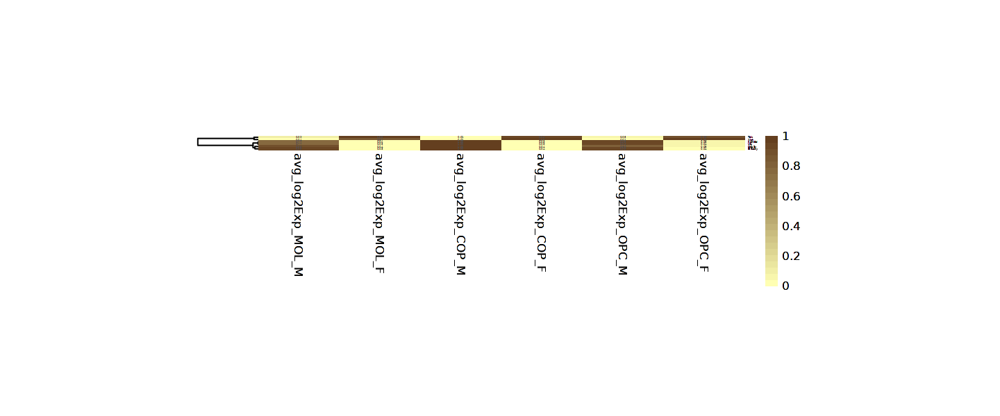

In [1084]:
options(repr.plot.width=12, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

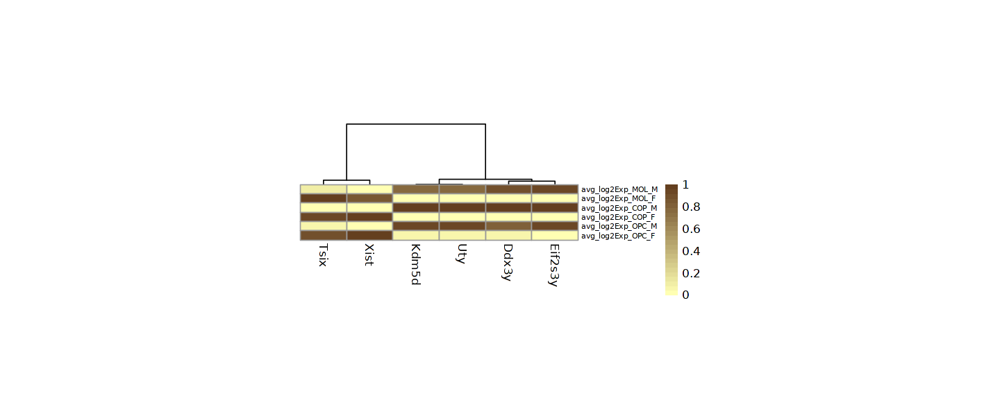

In [1085]:
options(repr.plot.width=12, repr.plot.height=plot_height)
pheatmap(t(matrix), cellheight = 8, cellwidth = 40, fontsize_number = 6, fontsize_row=6, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=TRUE, cluster_rows=FALSE)

In [1086]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_pseudobulk.pdf"), width=8, height=plot_height)

png 
  2

In [1087]:
gene_list <- gene_list[ph$tree_row$order]

In [1088]:
tmp_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [1089]:
tmp_markers_mean[rownames(tmp_markers),"Mean_Exp"] <- rowMeans(tmp_markers)

In [1090]:
matrix <- tmp_markers_mean

In [1091]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

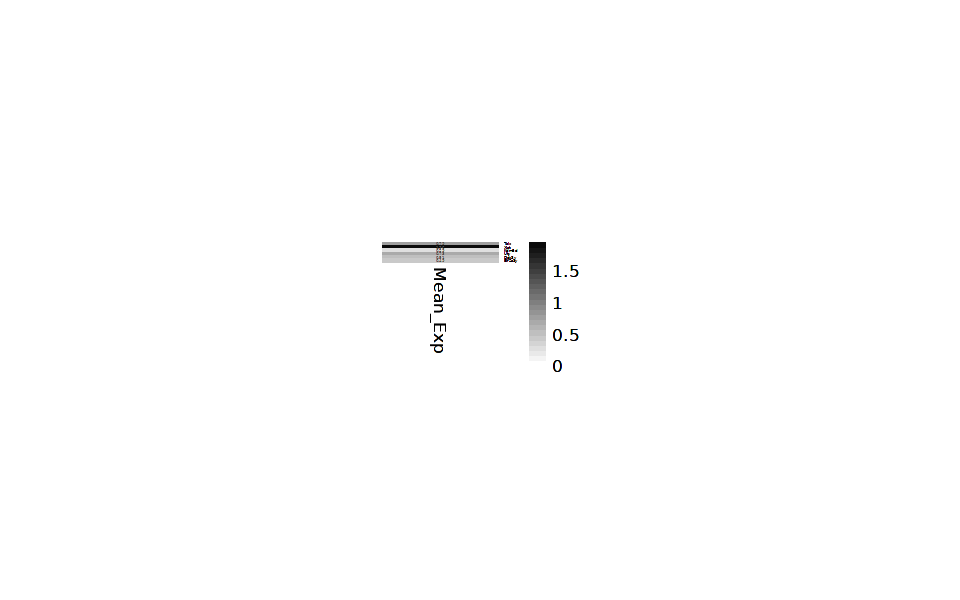

In [1092]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1093]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [1094]:
tmp_markers_zscore <- t(apply(tmp_markers[gene_list,], 1, scale))
colnames(tmp_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_markers_zscore

In [1095]:
paletteLength <- 50
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(min(matrix), max(matrix), length.out=floor(paletteLength/2)))

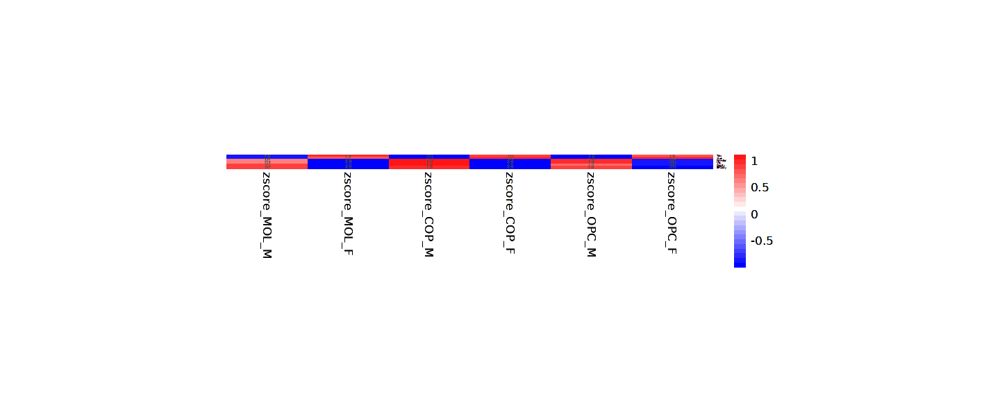

In [1096]:
options(repr.plot.width=12, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = T, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [1097]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Sex_pseudobulk_zscore.pdf"), width=8, height=plot_height)

png 
  2